## RNN Music Generation
### AMTX5005
#### Steve Ailemen 2024

In [9]:
#!pip install mido
#!pip install pandas
#!pip install torch
#!pip install pretty_midi

### Initial Setup
#### Task 1: Loading libraries and other dependencies

In [16]:
# Import necessary libraries and dependencies
import time
import os
import mido as md
from mido import MidiFile, MidiTrack, Message
import pretty_midi as pd
import logging
from logging.handlers import RotatingFileHandler
import json
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader
from torch.nn import utils as rnn_utils
from torch.nn.utils import rnn as rnn_utils
import torch.nn.functional as F
from torch.nn.utils.rnn import pad_sequence
from torch.utils.data import TensorDataset
import glob
from tqdm import tqdm
import numpy as np
import math
from sklearn.model_selection import train_test_split
from collections import Counter
import matplotlib.pyplot as plt
import random
import csv
import pandas as pdp
import warnings
import shutil
import gc

# Print a message to confirm that libraries are loaded
print("All require libraries are loaded.")

All require libraries are loaded.


#### Task 2: Set up Logging

In [19]:
# Path to save logs
log_file = 'midi_processing.log'

# Set up the logger with a custom name (e.g., 'midi_parser_logger')
logger = logging.getLogger('midi_parser_logger')

# Set the root log level to INFO (to capture important messages)
logger.setLevel(logging.INFO)

# Set up rotating log handler (max size: 5MB, keep 5 backup files)
log_handler = RotatingFileHandler(log_file, maxBytes=5 * 1024 * 1024, backupCount=10)
log_handler.setLevel(logging.DEBUG)  # Detailed logs to file

# Formatter for log messages
formatter = logging.Formatter('%(asctime)s - %(levelname)s - %(message)s')
log_handler.setFormatter(formatter)

# Add the handler to the logger
logger.addHandler(log_handler)

# Set up console logging (to show only important messages in Jupyter)
console_handler = logging.StreamHandler()

# Only log WARNING and ERROR messages to console (INFO and below won't show up)
console_handler.setLevel(logging.WARNING)
console_handler.setFormatter(formatter)
logger.addHandler(console_handler)

# Log a message to confirm logging is set up
logger.info("Logging is set up and ready to use.")


### Task 3: Load MIDI files

In [28]:
#Loading MIDI Files from Folder and Print First 20 Files (Handling .mid and .midi extensions)
def load_midi_files(folder_path):
    try:
        # Check if folder exists
        if not os.path.exists(folder_path):
            logger.error(f"Folder '{folder_path}' not found.")
            return []

        # Get all MIDI files in the folder (both .mid and .midi extensions)
        midi_files = glob.glob(os.path.join(folder_path, '*.mid')) + glob.glob(os.path.join(folder_path, '*.midi'))
        
        if not midi_files:
            logger.warning(f"No MIDI files found in the folder '{folder_path}'.")
        
        # Log the number of files found
        logger.info(f"Found {len(midi_files)} MIDI files in '{folder_path}'.")

        # Print first 20 MIDI files
        if len(midi_files) > 0:
            logger.info("First 20 MIDI files:\n")
            for i, midi_file in enumerate(midi_files[:20]):  # Limit to first 20 files
                logger.info(f"{i+1}: {midi_file}")
        
        return midi_files

    except Exception as e:
        logger.error(f"An error occurred while loading MIDI files: {e}")
        print(f"Error: {e}")
        return []

folder_path = 'MIDI_folder' 
midi_files = load_midi_files(folder_path)
midi_files [:10]

['MIDI_folder/Who_Is_There_Like_You.mid',
 'MIDI_folder/Tell_Me_The_Reason.mid',
 'MIDI_folder/There-Is-No-god-SteveAilemen.mid',
 'MIDI_folder/How-Many-Miles-More-SteveAilemen.mid',
 'MIDI_folder/You Are The One I Love-SteveAilemen.mid',
 'MIDI_folder/I_Said_It_Before.mid',
 'MIDI_folder/BrazillianSamba-SteveAilemen.midi',
 'MIDI_folder/SheriffRegae2-SteveAilemen.midi',
 'MIDI_folder/Bosanova-SteveAilemen.midi',
 'MIDI_folder/HappyRegae-SteveAilemen.midi']

### Task 4: Create CSV dataframe of General MIDI program IDs

In [31]:
#  Define the General MIDI instruments (program numbers and their names)
gm_instruments = [
    # PIANO (1-8)
    (0, "Acoustic Grand"),
    (1, "Bright Acoustic"),
    (2, "Electric Grand"),
    (3, "Honky-Tonk"),
    (4, "Electric Piano 1"),
    (5, "Electric Piano 2"),
    (6, "Harpsichord"),
    (7, "Clav"),
    
    # CHROMATIC PERCUSSION (9-16)
    (8, "Celesta"),
    (9, "Glockenspiel"),
    (10, "Music Box"),
    (11, "Vibraphone"),
    (12, "Marimba"),
    (13, "Xylophone"),
    (14, "Tubular Bells"),
    (15, "Dulcimer"),
    
    # ORGAN (17-24)
    (16, "Drawbar Organ"),
    (17, "Percussive Organ"),
    (18, "Rock Organ"),
    (19, "Church Organ"),
    (20, "Reed Organ"),
    (21, "Accordion"),
    (22, "Harmonica"),
    (23, "Tango Accordion"),
    
    # GUITAR (25-32)
    (24, "Acoustic Guitar(nylon)"),
    (25, "Acoustic Guitar(steel)"),
    (26, "Electric Guitar(jazz)"),
    (27, "Electric Guitar(clean)"),
    (28, "Electric Guitar(muted)"),
    (29, "Overdriven Guitar"),
    (30, "Distortion Guitar"),
    (31, "Guitar Harmonics"),
    
    # BASS (33-40)
    (32, "Acoustic Bass"),
    (33, "Electric Bass(finger)"),
    (34, "Electric Bass(pick)"),
    (35, "Fretless Bass"),
    (36, "Slap Bass 1"),
    (37, "Slap Bass 2"),
    (38, "Synth Bass 1"),
    (39, "Synth Bass 2"),
    
    # STRINGS (41-48)
    (40, "Violin"),
    (41, "Viola"),
    (42, "Cello"),
    (43, "Contrabass"),
    (44, "Tremolo Strings"),
    (45, "Pizzicato Strings"),
    (46, "Orchestral Strings"),
    (47, "Timpani"),
    
    # ENSEMBLE (49-56)
    (48, "String Ensemble 1"),
    (49, "String Ensemble 2"),
    (50, "SynthStrings 1"),
    (51, "SynthStrings 2"),
    (52, "Choir Aahs"),
    (53, "Voice Oohs"),
    (54, "Synth Voice"),
    (55, "Orchestra Hit"),
    
    # BRASS (57-64)  # Updated based on your correction
    (56, "Trumpet"),
    (57, "Trombone"),
    (58, "Tuba"),
    (59, "Muted Trumpet"),
    (60, "French Horn"),
    (61, "Brass Section"),
    (62, "SynthBrass 1"),
    (63, "SynthBrass 2"),
    
    # REED (65-72)
    (64, "Soprano Sax"),
    (65, "Alto Sax"),
    (66, "Tenor Sax"),  # Corrected spelling
    (67, "Baritone Sax"),
    (68, "Oboe"),
    (69, "English Horn"),
    (70, "Bassoon"),
    (71, "Clarinet"),
    
    # PIPE (73-80)
    (72, "Piccolo"),
    (73, "Flute"),
    (74, "Recorder"),
    (75, "Pan Flute"),
    (76, "Blown Bottle"),
    (77, "Shakuhachi"),
    (78, "Whistle"),
    (79, "Ocarina"),
    
    # SYNTH LEAD (81-88)
    (80, "Lead 1 (square)"),
    (81, "Lead 2 (sawtooth)"),
    (82, "Lead 3 (calliope)"),
    (83, "Lead 4 (chiff)"),
    (84, "Lead 5 (charang)"),
    (85, "Lead 6 (voice)"),
    (86, "Lead 7 (fifths)"),
    (87, "Lead 8 (bass+lead)"),
    
    # SYNTH PAD (89-96)
    (88, "Pad 1 (new age)"),
    (89, "Pad 2 (warm)"),
    (90, "Pad 3 (polysynth)"),
    (91, "Pad 4 (choir)"),
    (92, "Pad 5 (bowed)"),
    (93, "Pad 6 (metallic)"),
    (94, "Pad 7 (halo)"),
    (95, "Pad 8 (sweep)"),
    
    # SYNTH EFFECTS (97-104)
    (96, "FX 1 (rain)"),
    (97, "FX 2 (soundtrack)"),
    (98, "FX 3 (crystal)"),
    (99, "FX 4 (atmosphere)"),
    (100, "FX 5 (brightness)"),
    (101, "FX 6 (goblins)"),
    (102, "FX 7 (echoes)"),
    (103, "FX 8 (sci-fi)"),
    
    # ETHNIC (105-112)
    (104, "Sitar"),
    (105, "Banjo"),
    (106, "Shamisen"),
    (107, "Koto"),
    (108, "Kalimba"),
    (109, "Bagpipe"),
    (110, "Fiddle"),
    (111, "Shanai"),
    
    # PERCUSSIVE (113-120)
    (112, "Tinkle Bell"),
    (113, "Agogo"),
    (114, "Steel Drums"),
    (115, "Woodblock"),
    (116, "Taiko Drum"),
    (117, "Melodic Tom"),
    (118, "Synth Drum"),
    (119, "Reverse Cymbal"),
    
    # SOUND EFFECTS (121-128)
    (120, "Guitar Fret Noise"),
    (121, "Breath Noise"),
    (122, "Seashore"),
    (123, "Bird Tweet"),
    (124, "Telephone Ring"),
    (125, "Helicopter"),
    (126, "Applause"),
    (127, "Gunshot")
]

#  Convert the list of instruments into a pandas DataFrame
print("Creating DataFrame with General MIDI instruments...")
df = pdp.DataFrame(gm_instruments, columns=["Program Number", "Instrument Name"])

#  Save the DataFrame to a CSV file
csv_file = 'gm_instruments.csv'
df.to_csv(csv_file, index=False)

#  Verify and log the output
print(f"CSV file '{csv_file}' has been created successfully.")
print("Here are the first 5 entries in the CSV file:")
print(df.head())

Creating DataFrame with General MIDI instruments...
CSV file 'gm_instruments.csv' has been created successfully.
Here are the first 5 entries in the CSV file:
   Program Number   Instrument Name
0               0    Acoustic Grand
1               1   Bright Acoustic
2               2    Electric Grand
3               3        Honky-Tonk
4               4  Electric Piano 1


### General MIDI Isnstruments DataFrame

In [34]:
# Load the CSV file containing General MIDI instrument mappings
csv_file = 'gm_instruments.csv'

# Read the CSV into a DataFrame
gm_df = pdp.read_csv(csv_file)

# This automatically renders the DataFrame in Jupyter Notebooks or JupyterLab
gm_df


,Program Number,Instrument Name
0,0,Acoustic Grand
1,1,Bright Acoustic
2,2,Electric Grand
3,3,Honky-Tonk
4,4,Electric Piano 1
...,...,...
123,123,Bird Tweet
124,124,Telephone Ring
125,125,Helicopter
126,126,Applause


### Task 5: File Preview

In [37]:
midi_folder = 'MIDI_folder'  

# Get a list of all MIDI files in the folder
midi_files = [f for f in os.listdir(midi_folder) if f.endswith(('.mid', '.midi'))]

# Limit to the first 20 MIDI files
first_20_files = midi_files[:20]

# Print the first 20 song filenames
print("First 20 songs in the dataset:")
for idx, midi_file in enumerate(first_20_files, 1):
    print(f"{idx}. {midi_file}")

First 20 songs in the dataset:
1. BrazillianSamba-SteveAilemen.midi
2. SheriffRegae2-SteveAilemen.midi
3. Bosanova-SteveAilemen.midi
4. HappyRegae-SteveAilemen.midi
5. BreathlessHit-SteveAilemen.midi
6. HL_SteveAilemen.midi
7. Feliz-SteveAilemen.midi
8. AwesomeGod-SteveAilemen.midi
9. HiLife-1-SteveAilemen.midi
10. Halleljah_Soukous_SteveDeRock.midi
11. Chillout2-SteveAilemen.midi
12. Makossa-Medley-SteveAilemen.midi
13. Who_Is_There_Like_You.mid
14. Omame-Retro-SteveAilemen.midi
15. R&BSoulBalad-SteveAilemen.midi
16. Je_Kijoba_Re_De_SteveDeRock.midi
17. Tell_Me_The_Reason.mid
18. SchlagerFox-SteveAilemen.midi
19. Chillout1-SteveAilemen.midi
20. GermanRock-SteveAilemen.midi


### Task 6.1:Parse MIDI data (Extract Sustain Pedal, Pitch Bend, and Control Changes)

In [40]:

# Function to parse a single MIDI file and extract useful information
def parse_midi_file(midi_file_path):
    try:
        # Load the MIDI file using mido
        midi_file = MidiFile(midi_file_path)
        
        # Initialize a list to store parsed track data
        parsed_tracks = []
        
        # Iterate through the tracks in the MIDI file
        for i, track in enumerate(midi_file.tracks):
            track_data = {
                'track_name': None,
                'program_changes': [],
                'notes': [],
                'events': [],
                'tempo_changes': [],
                'time_signatures': [],
                'sustain_pedal': [],
                'pitch_bend': [],
                'control_changes': []
            }
            
            logger.info(f"Parsing track {i + 1}: {track.name}")
            
            # Iterate through the messages in each track
            for msg in track:
                if msg.type == 'track_name':
                    track_data['track_name'] = msg.name
                elif msg.type == 'program_change':
                    track_data['program_changes'].append(msg.program)
                elif msg.type == 'note_on' or msg.type == 'note_off':
                    track_data['notes'].append({
                        'note': msg.note,
                        'velocity': msg.velocity,
                        'time': msg.time,
                        'type': msg.type
                    })
                elif msg.type == 'set_tempo':
                    track_data['tempo_changes'].append(msg.tempo)
                elif msg.type == 'time_signature':
                    track_data['time_signatures'].append({
                        'numerator': msg.numerator,
                        'denominator': msg.denominator,
                        'clocks_per_click': msg.clocks_per_click,
                        'notated_32nd_notes_per_beat': msg.notated_32nd_notes_per_beat
                    })
                elif msg.type == 'control_change':
                    # Capture sustain pedal (CC 64) and other control changes
                    if msg.control == 64:  # Sustain Pedal
                        track_data['sustain_pedal'].append({'value': msg.value, 'time': msg.time})
                    else:
                        track_data['control_changes'].append({
                            'control': msg.control,
                            'value': msg.value,
                            'time': msg.time
                        })
                elif msg.type == 'pitchbend':
                    # Capture pitch bend (range: -8192 to 8191, where 0 is the center)
                    track_data['pitch_bend'].append({
                        'value': msg.pitch,
                        'time': msg.time
                    })
                
                # Add all events to the track's event log (for completeness)
                track_data['events'].append(msg)
            
            # Store parsed track data
            parsed_tracks.append(track_data)
        
        # Log the completion of MIDI file parsing
        logger.info(f"Parsing complete. {len(parsed_tracks)} tracks parsed.")
        
        # Return parsed track data for further processing
        return parsed_tracks
    
    except Exception as e:
        logger.error(f"Error occurred while parsing the MIDI file: {e}")
        raise


# Function to parse all MIDI files in a folder
def parse_midi_files_in_folder(folder_path):
    # List to store parsed data for all MIDI files
    all_parsed_data = []
    
    # Get all MIDI files in the folder (supporting both .mid and .midi extensions)
    midi_files = glob.glob(os.path.join(folder_path, "*.mid")) + glob.glob(os.path.join(folder_path, "*.midi"))
    
    # Loop through each MIDI file and parse it
    for midi_file_path in midi_files:
        logger.info(f"Parsing MIDI file: {midi_file_path}")
        try:
            parsed_data = parse_midi_file(midi_file_path)  # Parse each file
            all_parsed_data.append({
                'file_name': os.path.basename(midi_file_path),
                'parsed_data': parsed_data
            })
        except Exception as e:
            logger.error(f"Failed to parse {midi_file_path}: {e}")
    
    # Return all parsed data from all files
    return all_parsed_data

# Example usage of the parsing function for a folder
folder_path = 'MIDI_folder'  # The folder containing your MIDI files
all_parsed_data = parse_midi_files_in_folder(folder_path)

# Output the parsed data for verification
logger.info(f"Parsed MIDI Data for all files: {all_parsed_data}")


#### Task 7: Parse MIDI Files (Etract track names, notes and program changes)

In [43]:
# Logger setup 
logger = logging.getLogger('midi_parser_logger')

def parse_midi_file(midi_file_path):
    """
    Parse a MIDI file and extract relevant information such as track names, notes, and program changes.
    
    Args:
    midi_file_path (str): Path to the MIDI file.
    
    Returns:
    dict: A dictionary with track information.
    """
    logger.info(f"Parsing MIDI file: {midi_file_path}")
    
    try:
        midi_data = MidiFile(midi_file_path)
        track_info = []

        # Iterate through all tracks in the MIDI file
        for i, track in enumerate(midi_data.tracks):
            logger.info(f"Processing track {i + 1}: {track.name}")

            track_data = {
                'track_name': track.name,
                'program_changes': [],
                'notes': [],
                'other_messages': []
            }

            # Iterate through each message in the track
            for msg in track:
                if msg.type == 'program_change':
                    track_data['program_changes'].append({
                        'channel': msg.channel,
                        'program': msg.program
                    })
                elif msg.type == 'note_on' or msg.type == 'note_off':
                    track_data['notes'].append({
                        'note': msg.note,
                        'velocity': msg.velocity,
                        'time': msg.time,
                        'type': msg.type
                    })
                else:
                    track_data['other_messages'].append({
                        'type': msg.type,
                        'data': msg.dict()
                    })

            # Store the extracted information for the track
            track_info.append(track_data)

        logger.info(f"Successfully parsed {len(midi_data.tracks)} tracks from the MIDI file.")
        return track_info

    except Exception as e:
        logger.error(f"An error occurred while parsing the MIDI file: {e}")
        return None

def process_all_midi_files(midi_folder_path):
    """
    Process all MIDI files in the specified folder and extract track information.

    Args:
    midi_folder_path (str): Path to the folder containing MIDI files.
    
    Returns:
    list: A list of dictionaries containing track information for each MIDI file.
    """
    all_tracks_info = []
    
    # Check if the folder exists
    if not os.path.isdir(midi_folder_path):
        logger.error(f"Directory {midi_folder_path} does not exist.")
        return all_tracks_info

    # Get a list of all MIDI files in the folder
    midi_files = [f for f in os.listdir(midi_folder_path) if f.endswith('.mid') or f.endswith('.midi')]

    if not midi_files:
        logger.error("No MIDI files found in the specified folder.")
        return all_tracks_info

    # Process each MIDI file in the folder
    for midi_file in midi_files:
        midi_file_path = os.path.join(midi_folder_path, midi_file)
        logger.info(f"Processing MIDI file: {midi_file}")

        track_info = parse_midi_file(midi_file_path)

        if track_info:
            all_tracks_info.append({
                'midi_file': midi_file,
                'tracks': track_info
            })
        else:
            logger.error(f"Failed to parse MIDI file: {midi_file}")

    logger.info(f"Processed {len(all_tracks_info)} MIDI files.")
    return all_tracks_info

# Example usage
midi_folder_path = 'MIDI_folder'  # Path to the folder containing your MIDI files
all_tracks_info = process_all_midi_files(midi_folder_path)

# Log the extracted track information (for debugging purposes)
if all_tracks_info:
    for midi_file_data in all_tracks_info:
        logger.info(f"Track information for file: {midi_file_data['midi_file']}")
        for idx, track in enumerate(midi_file_data['tracks']):
            logger.info(f"Track {idx + 1} Info: {track}")
else:
    logger.error("No track information was extracted.")

#### Task 7.1: Set up logging for MIDI processing

In [46]:
log_file = 'midi_processing.log'

# Set up the logger with a custom name (e.g., 'midi_parser_logger')
logger = logging.getLogger('midi_parser_logger')

# Set the root log level to INFO (to capture important messages)
logger.setLevel(logging.INFO)

# Set up rotating log handler (max size: 5MB, keep 5 backup files)
log_handler = RotatingFileHandler(log_file, maxBytes=5 * 1024 * 1024, backupCount=5)
log_handler.setLevel(logging.DEBUG)  # Detailed logs to file

# Formatter for log messages
formatter = logging.Formatter('%(asctime)s - %(levelname)s - %(message)s')
log_handler.setFormatter(formatter)

# Add the handler to the logger
logger.addHandler(log_handler)

# Set up console logging (to show only important messages in Jupyter)
console_handler = logging.StreamHandler()

# Only log WARNING and ERROR messages to console (INFO and below won't show up)
console_handler.setLevel(logging.WARNING)
console_handler.setFormatter(formatter)
logger.addHandler(console_handler)

# Log a message to confirm logging is set up
logger.info("Logging is set up and ready to use.")

#### Task 7.2: Process MIDI Files

In [49]:
def get_program_for_track(track_name):
    """
    Map track names to their corresponding program numbers (instruments) from the dataframe.
    """
    # Assuming you have a pre-loaded dataframe containing track names and their corresponding program numbers
    try:
        program_mapping = {
            "Acoustic Grand": 0,
            "Electric Guitar (jazz)": 27,
            "Synth Bass 2": 33,
            # Add other track names and program numbers as required
        }
        
        # Return the program number based on the track name, or None if not found
        return program_mapping.get(track_name, None)

    except Exception as e:
        logger.error(f"Error in get_program_for_track: {str(e)}")
        return None


def process_midi_file(file_path):
    """
    Process a MIDI file, checking for common edge cases and logging relevant information.
    """
    try:
        logger.info(f"Parsing MIDI file: {file_path}")
        
        midi_file = md.MidiFile(file_path)
        num_tracks = len(midi_file.tracks)
        
        logger.info(f"Successfully parsed {num_tracks} tracks from the MIDI file.")
        
        for i, track in enumerate(midi_file.tracks):
            logger.info(f"Processing track {i + 1}: {track.name}")
            
            if not track.name:
                logger.warning(f"Track {i + 1} has no name.")
            
            # Fetch program number from dataframe based on track name
            program_number = get_program_for_track(track.name)
            
            if program_number is not None:
                for msg in track:
                    if msg.type == 'program_change':
                        msg.program = program_number  # Update program change
                        logger.info(f"Assigned program {program_number} to track {track.name}.")
                        break  # Exit once program change is updated
            else:
                # Optionally log that no program change was applied
                logger.info(f"No program change applied for track {track.name} (no match found).")
            
            # Handle invalid data types (example: non-note events)
            for msg in track:
                if msg.type not in ['note_on', 'note_off', 'program_change', 'control_change']:
                    logger.warning(f"Track {i + 1} contains an unsupported message type: {msg.type}.")
            
        logger.info(f"Finished processing {file_path}.")
    
    except Exception as e:
        logger.error(f"Error processing {file_path}: {str(e)}")
        raise


def test_with_midi_files(midi_folder_path):
    """
    Test the MIDI processing pipeline with a variety of MIDI files from the specified folder.
    """
    logger.info("Starting the test suite for MIDI file processing...")
    
    # List all files in the MIDI folder
    midi_files = [f for f in os.listdir(midi_folder_path) if f.endswith('.midi') or f.endswith('.mid')]
    
    # Select a random subset of files for testing to ensure variety
    test_files = random.sample(midi_files, min(len(midi_files), 5))  # Test with up to 5 files
    
    for midi_file in test_files:
        file_path = os.path.join(midi_folder_path, midi_file)
        process_midi_file(file_path)
    
    logger.info("Test suite for MIDI file processing completed.")

#### Task 7.3 Data Augmentation

In [52]:
# Ensure the augmented folder exists
augmented_folder = './MIDI_folder/augmented'
if not os.path.exists(augmented_folder):
    os.makedirs(augmented_folder)

def clip_value(value):
    """Clip the value to ensure it's within the valid MIDI range (0-127)."""
    return max(0, min(127, value))

def process_and_augment_midi(file_path, output_path):
    """
    Process and augment a MIDI file, saving the augmented version.
    """
    try:
        # Load the MIDI file
        midi_file = md.MidiFile(file_path)
        
        # Create a new MidiFile to store the augmented content
        augmented_midi = md.MidiFile()

        # Iterate through each track in the original MIDI file
        for track in midi_file.tracks:
            new_track = md.MidiTrack()

            # Add a track name (optional, based on original track)
            if track.name:
                new_track.name = track.name
            
            # Add augmented messages (no copying of MidiFile here)
            for msg in track:
                # Apply clipping to the velocity or any other message that may have an invalid value
                if msg.type in ['note_on', 'note_off']:
                    msg.velocity = clip_value(msg.velocity)  # Clip the velocity
                elif msg.type == 'control_change':
                    msg.value = clip_value(msg.value)  # Clip the control change value
                
                # If you are applying other augmentations, apply the same clipping logic where needed
                if msg.type == 'note_on' or msg.type == 'note_off':
                    # For example, augmenting note values or velocities, ensure they stay within bounds
                    msg.note = clip_value(msg.note)  # Clip the note value as well if modified

                # Add the message to the new track
                new_track.append(msg)

            # Add the new track to the augmented MIDI file
            augmented_midi.tracks.append(new_track)

        # Save the augmented MIDI to the new folder
        augmented_midi.save(output_path)
        print(f"Augmented MIDI file saved: {output_path}")

    except Exception as e:
        print(f"Error processing {file_path}: {str(e)}")

def process_all_midi_files(midi_folder_path, augmented_folder_path):
    """
    Process all MIDI files in the folder, augmenting and saving them to the 'augmented' folder.
    """
    midi_files = [f for f in os.listdir(midi_folder_path) if f.endswith('.midi') or f.endswith('.mid')]
    
    for midi_file in midi_files:
        input_path = os.path.join(midi_folder_path, midi_file)
        output_path = os.path.join(augmented_folder_path, midi_file)  # Same name, save in 'augmented'
        
        # Process and augment the MIDI file
        process_and_augment_midi(input_path, output_path)

# Run the augmentation process
process_all_midi_files('./MIDI_folder', augmented_folder)

Augmented MIDI file saved: ./MIDI_folder/augmented/BrazillianSamba-SteveAilemen.midi
Augmented MIDI file saved: ./MIDI_folder/augmented/SheriffRegae2-SteveAilemen.midi
Augmented MIDI file saved: ./MIDI_folder/augmented/Bosanova-SteveAilemen.midi
Augmented MIDI file saved: ./MIDI_folder/augmented/HappyRegae-SteveAilemen.midi
Augmented MIDI file saved: ./MIDI_folder/augmented/BreathlessHit-SteveAilemen.midi
Augmented MIDI file saved: ./MIDI_folder/augmented/HL_SteveAilemen.midi
Augmented MIDI file saved: ./MIDI_folder/augmented/Feliz-SteveAilemen.midi
Augmented MIDI file saved: ./MIDI_folder/augmented/AwesomeGod-SteveAilemen.midi
Augmented MIDI file saved: ./MIDI_folder/augmented/HiLife-1-SteveAilemen.midi
Augmented MIDI file saved: ./MIDI_folder/augmented/Halleljah_Soukous_SteveDeRock.midi
Augmented MIDI file saved: ./MIDI_folder/augmented/Chillout2-SteveAilemen.midi
Augmented MIDI file saved: ./MIDI_folder/augmented/Makossa-Medley-SteveAilemen.midi
Augmented MIDI file saved: ./MIDI_fol

#### Further Data Augmentation (Time Stretching)

In [55]:
def time_stretch(midi_file, stretch_factor):
    """
    Apply time stretching to the MIDI file by adjusting the delta time of each note.
    """
    for track in midi_file.tracks:
        for msg in track:
            if msg.type in ['note_on', 'note_off']:
                msg.time = int(msg.time * stretch_factor)  # Adjust delta time based on stretch_factor
    return midi_file

def apply_time_stretching(midi_file_path, output_path):
    try:
        midi_file = md.MidiFile(midi_file_path)
        
        # Random stretch factor between 0.8 and 1.2
        stretch_factor = random.uniform(0.8, 1.2)
        
        # Apply time stretching
        augmented_midi = time_stretch(midi_file, stretch_factor)
        
        # Save the augmented MIDI file
        augmented_midi.save(output_path)
        print(f"Time Stretching applied: {output_path}")
    except Exception as e:
        print(f"Error processing {midi_file_path}: {str(e)}")

def process_time_stretching(midi_folder_path, augmented_folder_path):
    midi_files = [f for f in os.listdir(midi_folder_path) if f.endswith('.midi') or f.endswith('.mid')]
    
    for midi_file in midi_files:
        input_path = os.path.join(midi_folder_path, midi_file)
        output_path = os.path.join(augmented_folder_path, f"time_stretch_{midi_file}")  # Save with time_stretch prefix
        apply_time_stretching(input_path, output_path)

# Run Time Stretching augmentation
process_time_stretching('./MIDI_folder', './MIDI_folder/augmented')


Time Stretching applied: ./MIDI_folder/augmented/time_stretch_BrazillianSamba-SteveAilemen.midi
Time Stretching applied: ./MIDI_folder/augmented/time_stretch_SheriffRegae2-SteveAilemen.midi
Time Stretching applied: ./MIDI_folder/augmented/time_stretch_Bosanova-SteveAilemen.midi
Time Stretching applied: ./MIDI_folder/augmented/time_stretch_HappyRegae-SteveAilemen.midi
Time Stretching applied: ./MIDI_folder/augmented/time_stretch_BreathlessHit-SteveAilemen.midi
Time Stretching applied: ./MIDI_folder/augmented/time_stretch_HL_SteveAilemen.midi
Time Stretching applied: ./MIDI_folder/augmented/time_stretch_Feliz-SteveAilemen.midi
Time Stretching applied: ./MIDI_folder/augmented/time_stretch_AwesomeGod-SteveAilemen.midi
Time Stretching applied: ./MIDI_folder/augmented/time_stretch_HiLife-1-SteveAilemen.midi
Time Stretching applied: ./MIDI_folder/augmented/time_stretch_Halleljah_Soukous_SteveDeRock.midi
Time Stretching applied: ./MIDI_folder/augmented/time_stretch_Chillout2-SteveAilemen.midi


#### Further Data Augmentation (Pitch Shifting)

In [58]:
def pitch_shift(midi_file, shift_amount):
    """
    Apply pitch shifting to the MIDI file by adjusting the note values.
    Skip channel 10 (drums) to avoid shifting percussion notes.
    """
    for track in midi_file.tracks:
        for msg in track:
            if msg.type in ['note_on', 'note_off']:
                # Skip pitch shifting for channel 10 (drums)
                if msg.channel == 9:  # Channel 10 in MIDI is 9 (0-based index)
                    continue
                
                new_note = msg.note + shift_amount  # Shift the note by shift_amount
                if 0 <= new_note <= 127:  # Ensure the new note is within the valid MIDI range
                    msg.note = new_note
    return midi_file

def apply_pitch_shifting(midi_file_path, output_path):
    try:
        midi_file = md.MidiFile(midi_file_path)
        
        # Random pitch shift between -2 and +2 semitones
        shift_amount = random.randint(-2, 2)
        
        # Apply pitch shifting
        augmented_midi = pitch_shift(midi_file, shift_amount)
        
        # Save the augmented MIDI file
        augmented_midi.save(output_path)
        print(f"Pitch Shifting applied: {output_path}")
    except Exception as e:
        print(f"Error processing {midi_file_path}: {str(e)}")

def process_pitch_shifting(midi_folder_path, augmented_folder_path):
    midi_files = [f for f in os.listdir(midi_folder_path) if f.endswith('.midi') or f.endswith('.mid')]
    
    for midi_file in midi_files:
        input_path = os.path.join(midi_folder_path, midi_file)
        output_path = os.path.join(augmented_folder_path, f"pitch_shift_{midi_file}")  # Save with pitch_shift prefix
        apply_pitch_shifting(input_path, output_path)

# Run Pitch Shifting augmentation
process_pitch_shifting('./MIDI_folder', './MIDI_folder/augmented')


Pitch Shifting applied: ./MIDI_folder/augmented/pitch_shift_BrazillianSamba-SteveAilemen.midi
Pitch Shifting applied: ./MIDI_folder/augmented/pitch_shift_SheriffRegae2-SteveAilemen.midi
Pitch Shifting applied: ./MIDI_folder/augmented/pitch_shift_Bosanova-SteveAilemen.midi
Pitch Shifting applied: ./MIDI_folder/augmented/pitch_shift_HappyRegae-SteveAilemen.midi
Pitch Shifting applied: ./MIDI_folder/augmented/pitch_shift_BreathlessHit-SteveAilemen.midi
Pitch Shifting applied: ./MIDI_folder/augmented/pitch_shift_HL_SteveAilemen.midi
Pitch Shifting applied: ./MIDI_folder/augmented/pitch_shift_Feliz-SteveAilemen.midi
Pitch Shifting applied: ./MIDI_folder/augmented/pitch_shift_AwesomeGod-SteveAilemen.midi
Pitch Shifting applied: ./MIDI_folder/augmented/pitch_shift_HiLife-1-SteveAilemen.midi
Pitch Shifting applied: ./MIDI_folder/augmented/pitch_shift_Halleljah_Soukous_SteveDeRock.midi
Pitch Shifting applied: ./MIDI_folder/augmented/pitch_shift_Chillout2-SteveAilemen.midi
Pitch Shifting applied

#### Further Data Augmentation (Track Time Offset)

In [61]:
def apply_track_time_offset(midi_file, offset_ticks):
    """
    Apply a time offset to the entire track by shifting all events in each track.
    """
    for track in midi_file.tracks:
        for msg in track:
            msg.time += offset_ticks  # Apply offset to each message's time

    return midi_file

def process_track_time_offset(midi_folder_path, augmented_folder_path):
    midi_files = [f for f in os.listdir(midi_folder_path) if f.endswith('.midi') or f.endswith('.mid')]
    
    for midi_file in midi_files:
        input_path = os.path.join(midi_folder_path, midi_file)
        output_path = os.path.join(augmented_folder_path, f"time_offset_{midi_file}")  # Save with time_offset prefix
        
        # Random time offset between 0 and 500 ticks
        offset_ticks = random.randint(0, 500)
        
        try:
            midi_file = md.MidiFile(input_path)
            augmented_midi = apply_track_time_offset(midi_file, offset_ticks)
            augmented_midi.save(output_path)
            print(f"Track Time Offset applied: {output_path}")
        except Exception as e:
            print(f"Error processing {input_path}: {str(e)}")

# Run Track Time Offset augmentation
process_track_time_offset('./MIDI_folder', './MIDI_folder/augmented')


Track Time Offset applied: ./MIDI_folder/augmented/time_offset_BrazillianSamba-SteveAilemen.midi
Track Time Offset applied: ./MIDI_folder/augmented/time_offset_SheriffRegae2-SteveAilemen.midi
Track Time Offset applied: ./MIDI_folder/augmented/time_offset_Bosanova-SteveAilemen.midi
Track Time Offset applied: ./MIDI_folder/augmented/time_offset_HappyRegae-SteveAilemen.midi
Track Time Offset applied: ./MIDI_folder/augmented/time_offset_BreathlessHit-SteveAilemen.midi
Track Time Offset applied: ./MIDI_folder/augmented/time_offset_HL_SteveAilemen.midi
Track Time Offset applied: ./MIDI_folder/augmented/time_offset_Feliz-SteveAilemen.midi
Track Time Offset applied: ./MIDI_folder/augmented/time_offset_AwesomeGod-SteveAilemen.midi
Track Time Offset applied: ./MIDI_folder/augmented/time_offset_HiLife-1-SteveAilemen.midi
Track Time Offset applied: ./MIDI_folder/augmented/time_offset_Halleljah_Soukous_SteveDeRock.midi
Track Time Offset applied: ./MIDI_folder/augmented/time_offset_Chillout2-SteveAi

### Visualization

Visualizing original MIDI file: BrazillianSamba-SteveAilemen.midi


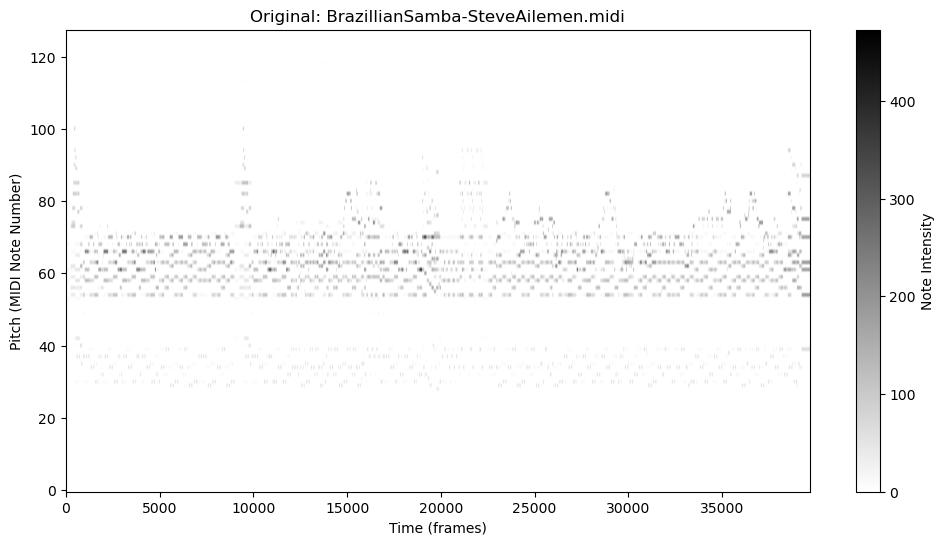

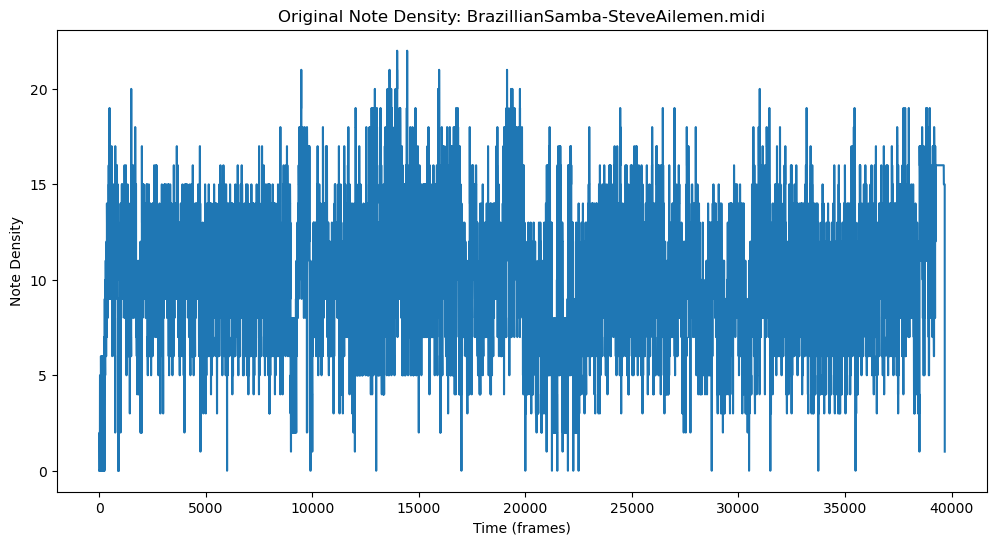

Visualizing augmented MIDI file: BrazillianSamba-SteveAilemen.midi


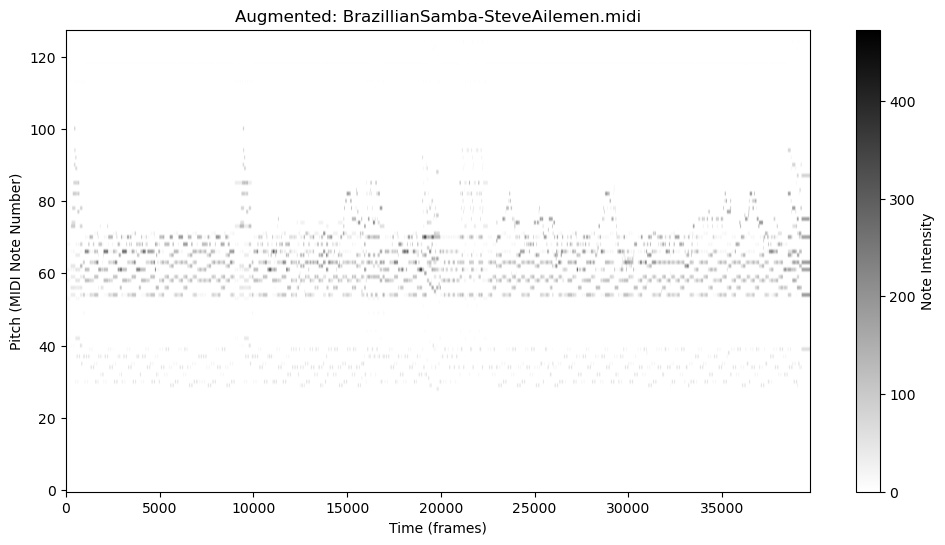

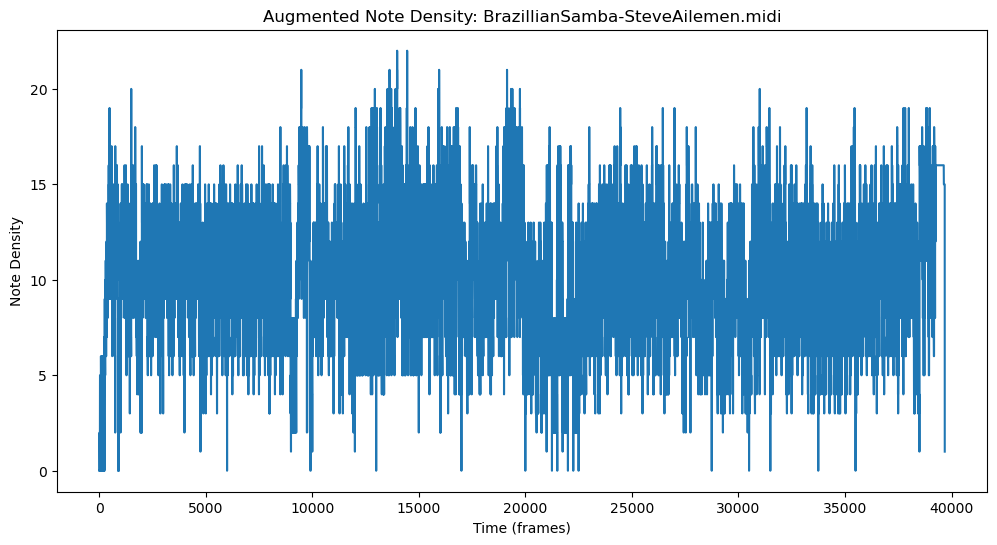

Visualizing original MIDI file: SheriffRegae2-SteveAilemen.midi


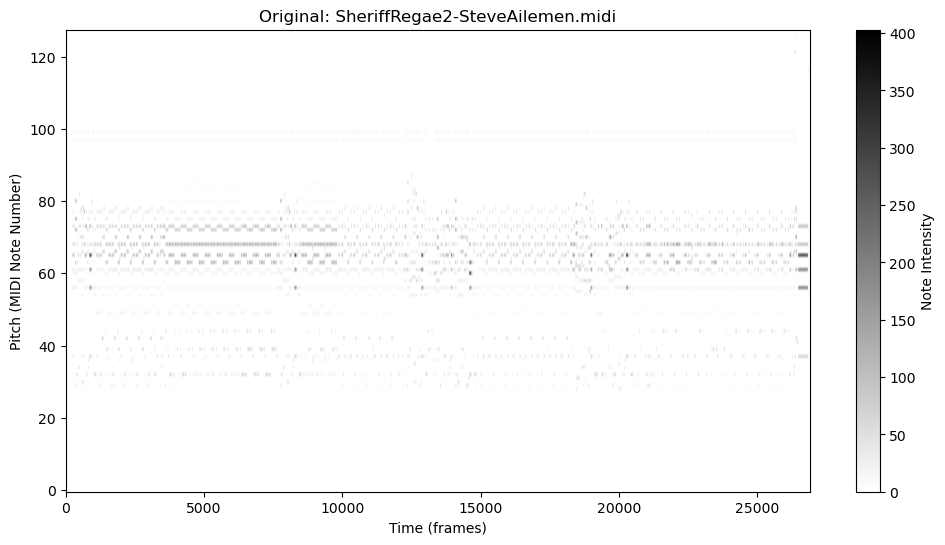

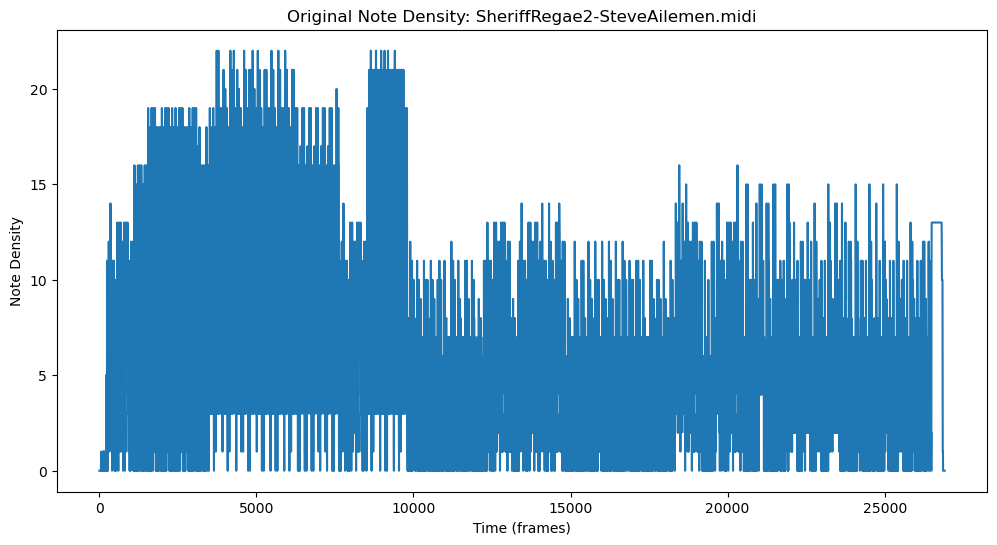

Visualizing augmented MIDI file: SheriffRegae2-SteveAilemen.midi


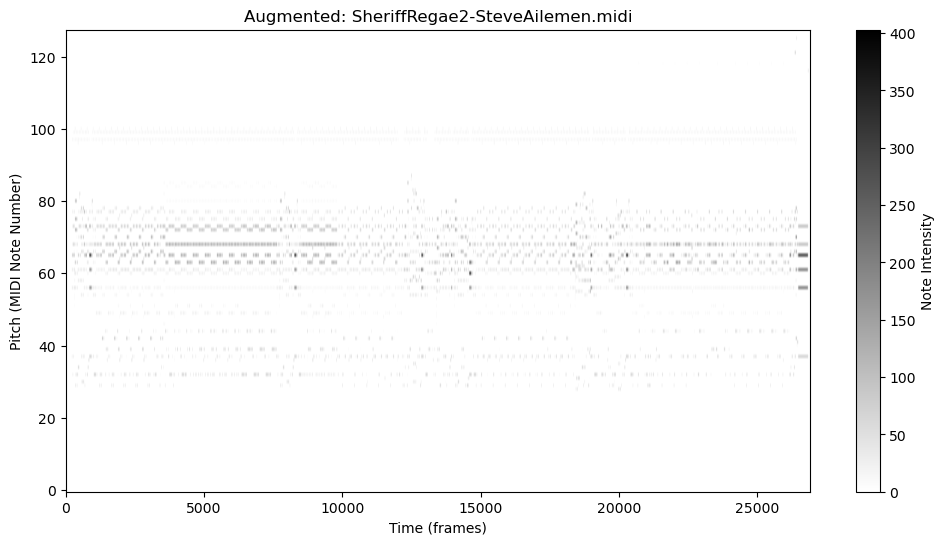

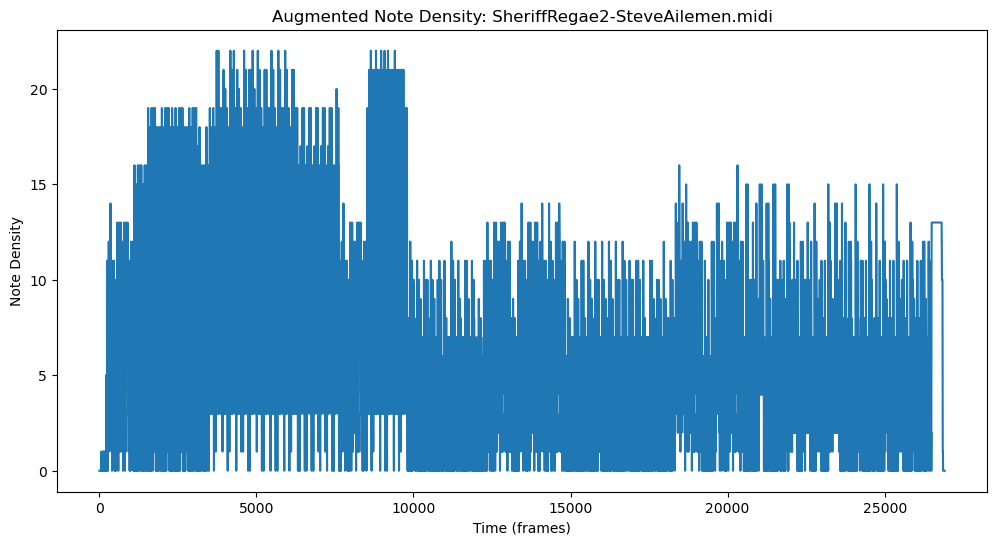

Visualizing original MIDI file: Bosanova-SteveAilemen.midi


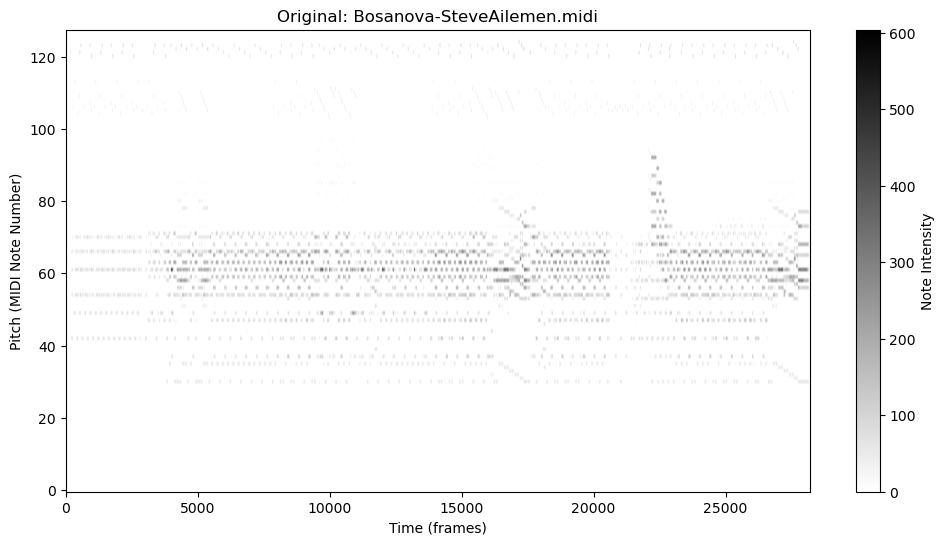

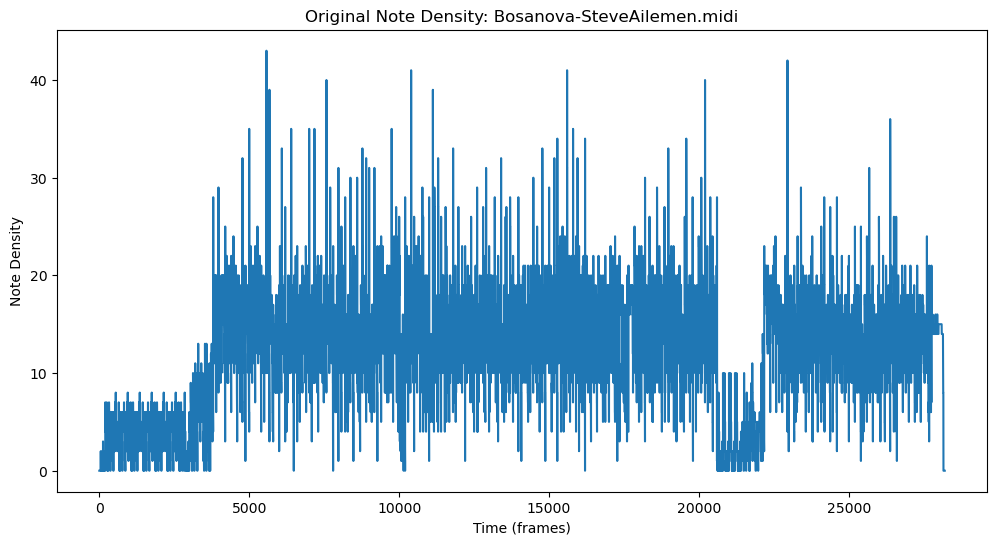

Visualizing augmented MIDI file: Bosanova-SteveAilemen.midi


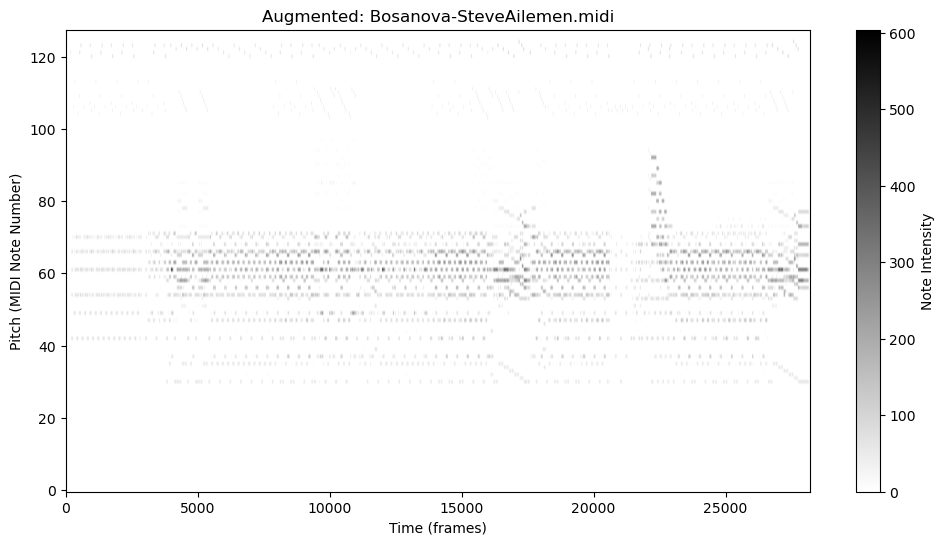

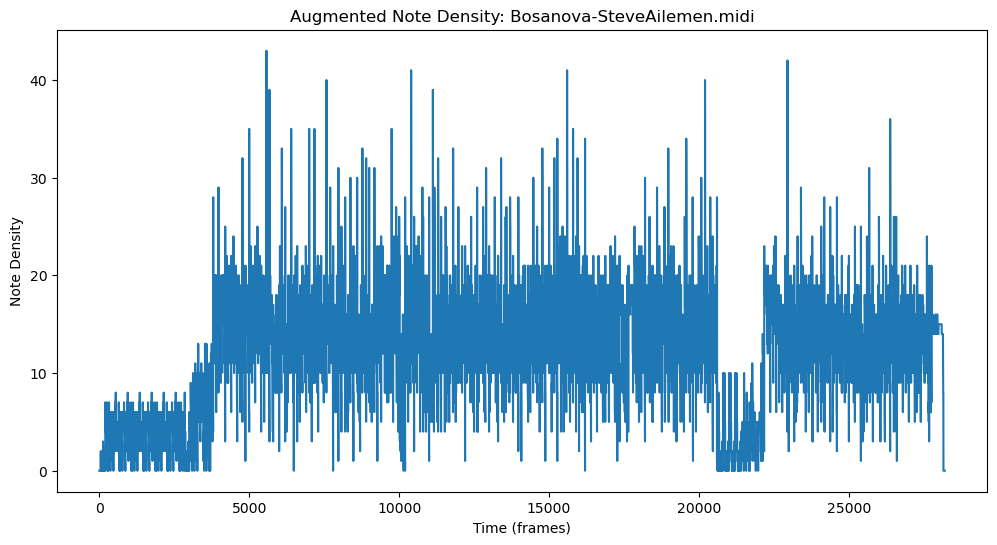

Visualizing original MIDI file: HappyRegae-SteveAilemen.midi


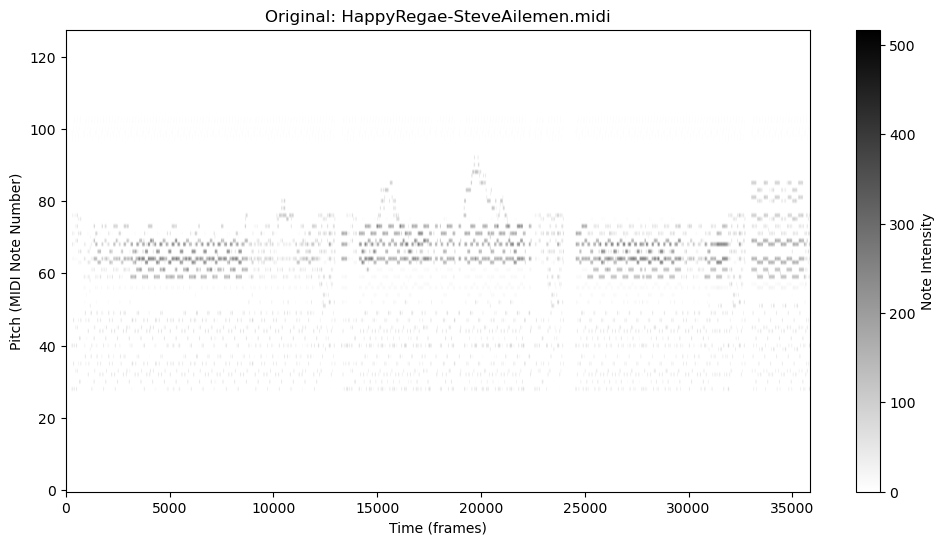

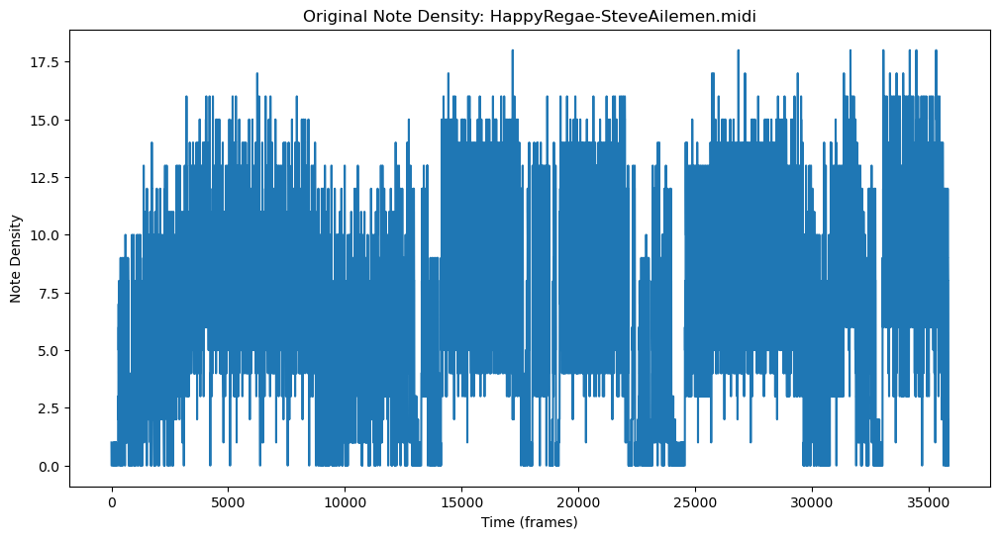

Visualizing augmented MIDI file: HappyRegae-SteveAilemen.midi


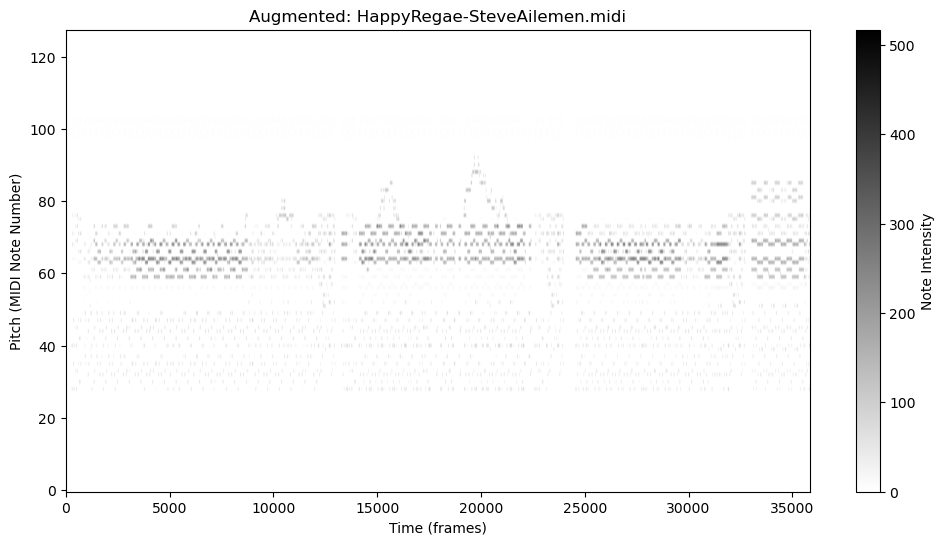

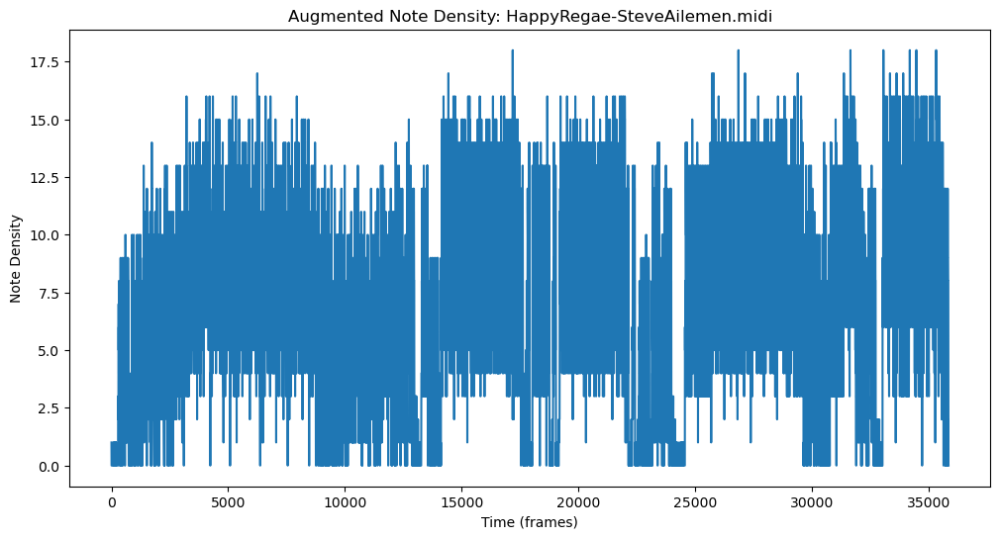

Visualizing original MIDI file: BreathlessHit-SteveAilemen.midi


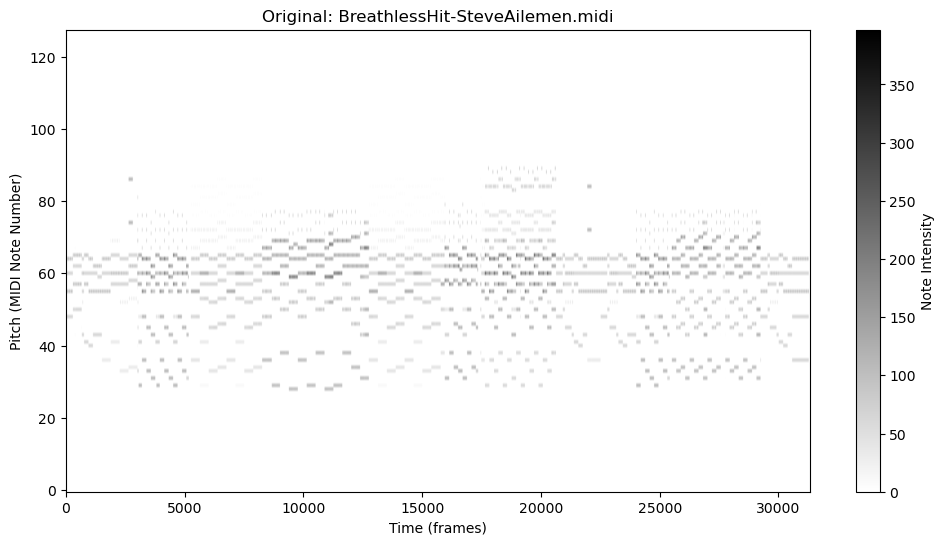

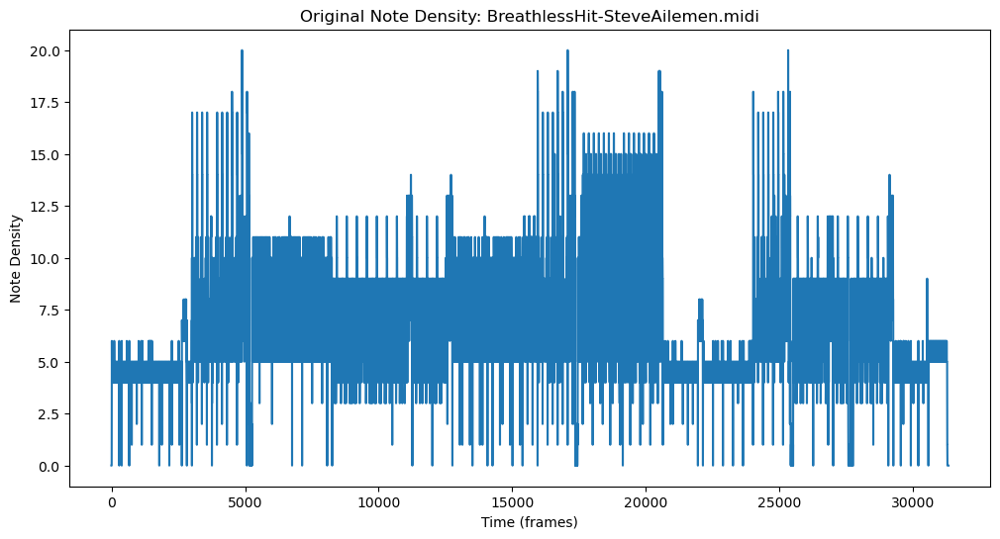

Visualizing augmented MIDI file: BreathlessHit-SteveAilemen.midi


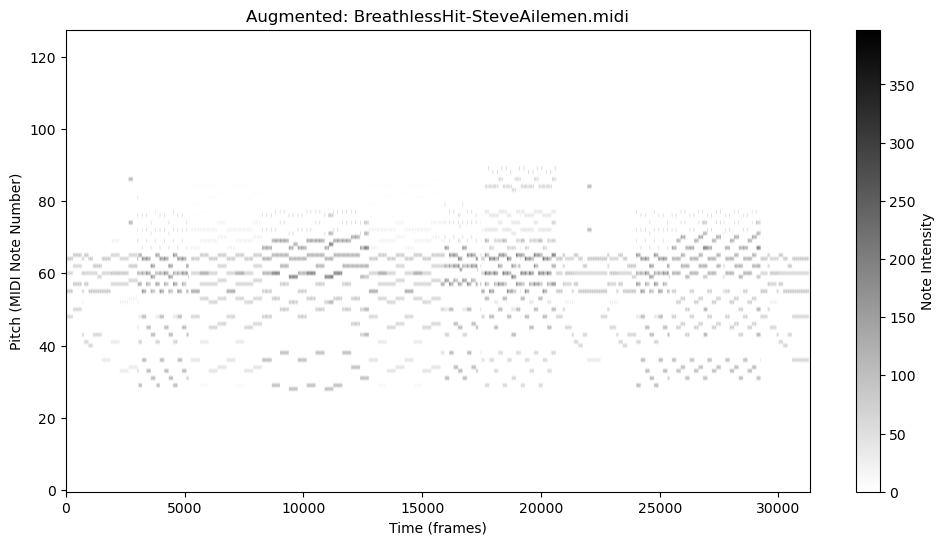

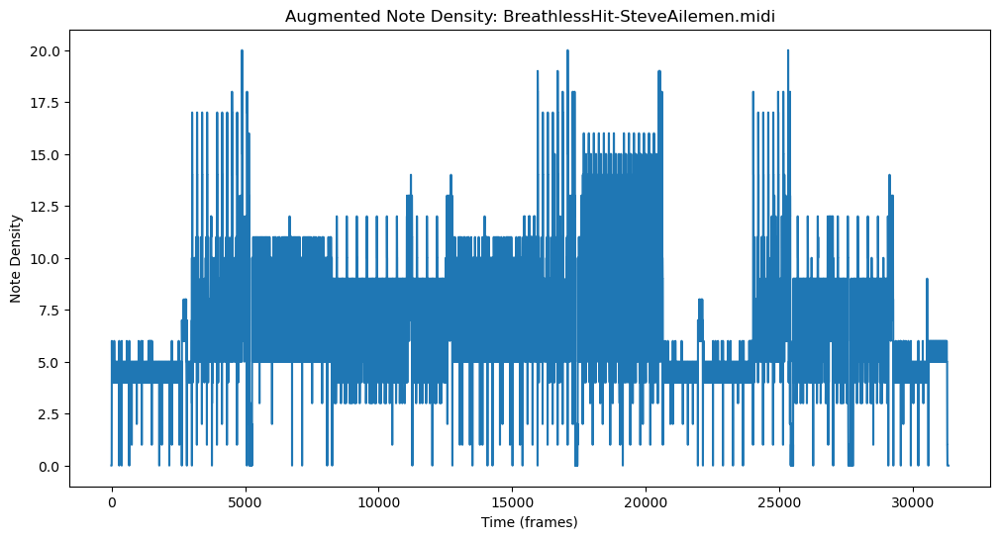

Visualizing original MIDI file: HL_SteveAilemen.midi


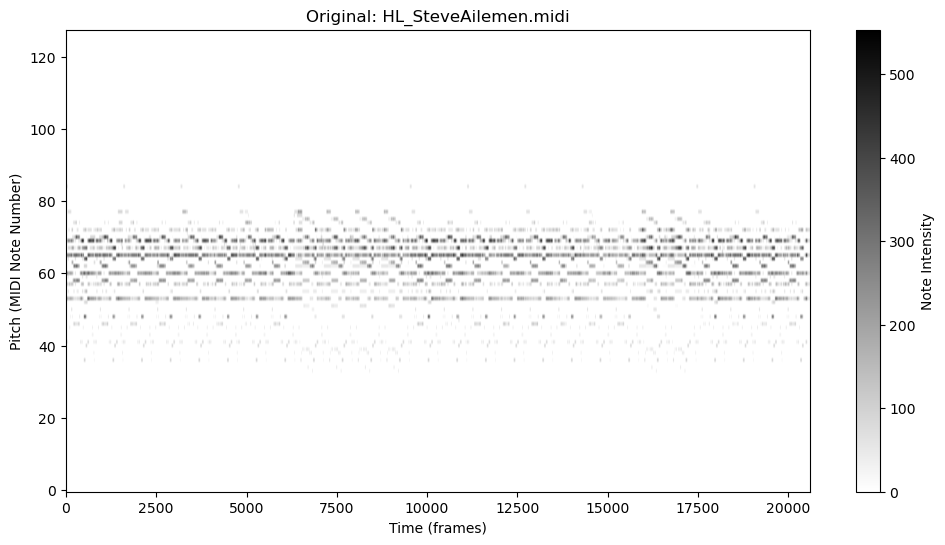

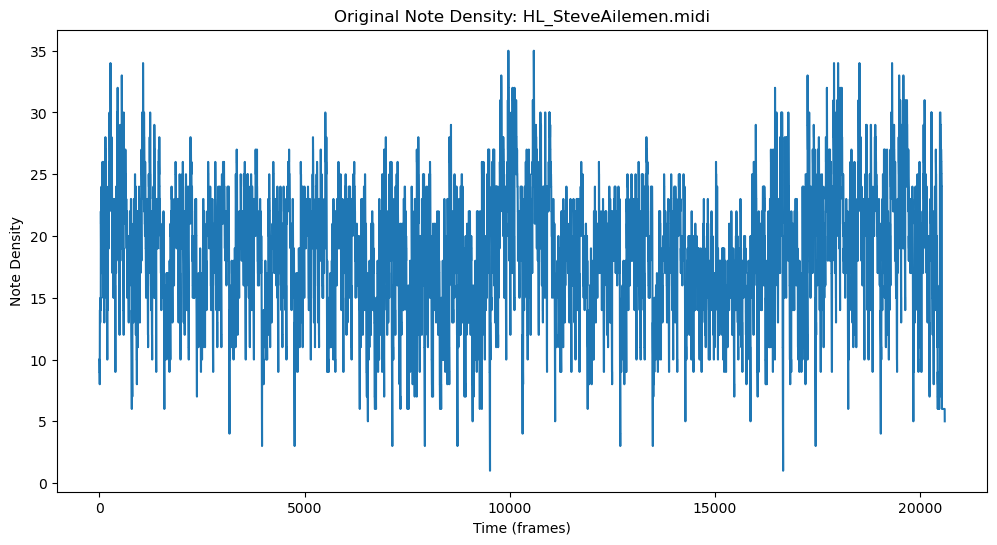

Visualizing augmented MIDI file: HL_SteveAilemen.midi


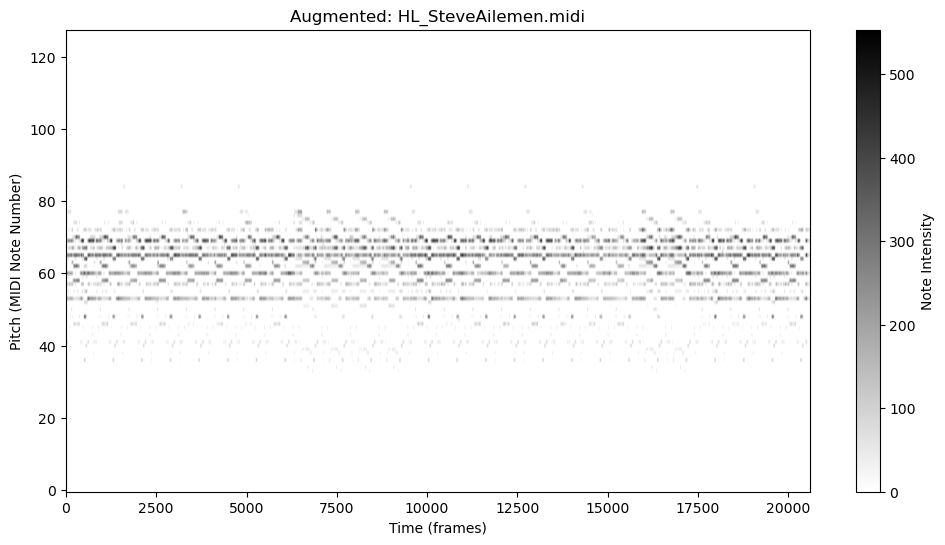

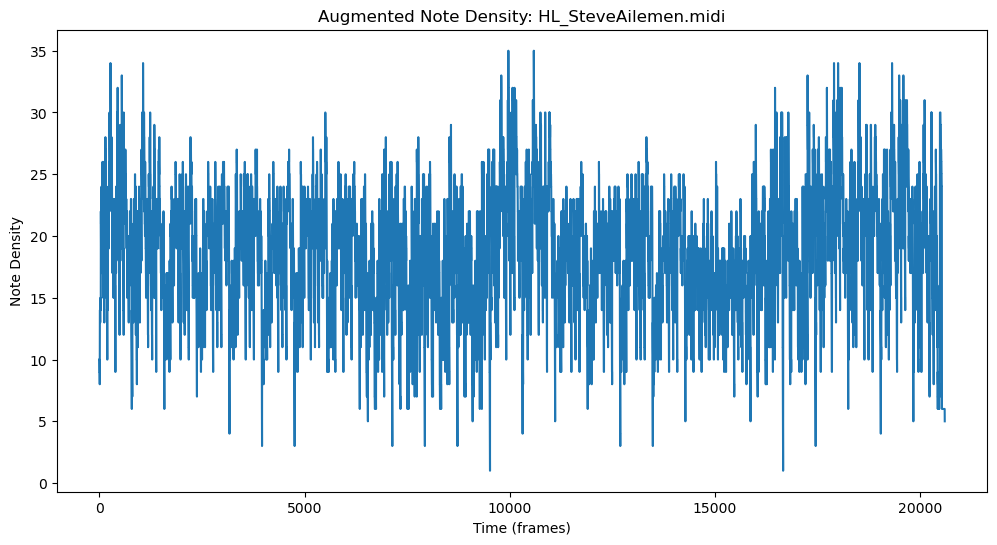

Visualizing original MIDI file: Feliz-SteveAilemen.midi


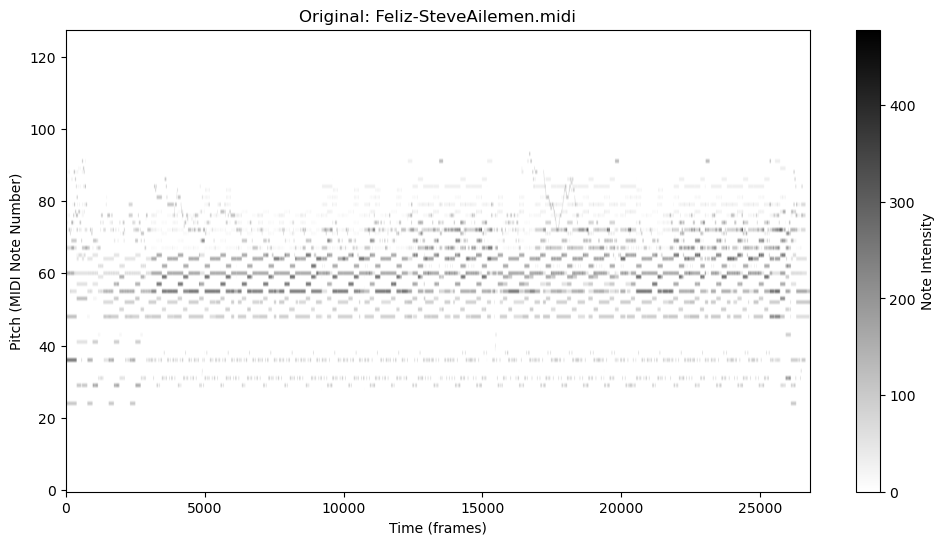

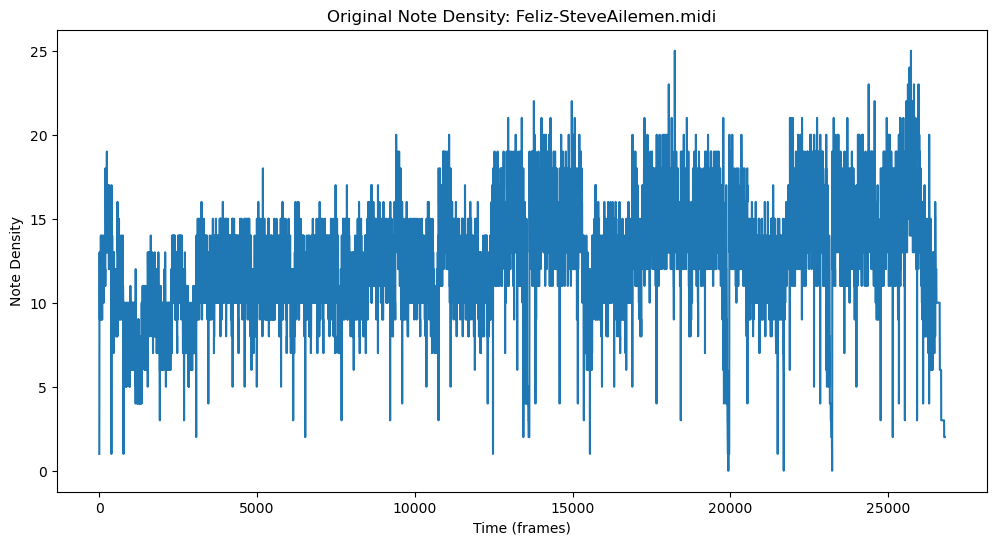

Visualizing augmented MIDI file: Feliz-SteveAilemen.midi


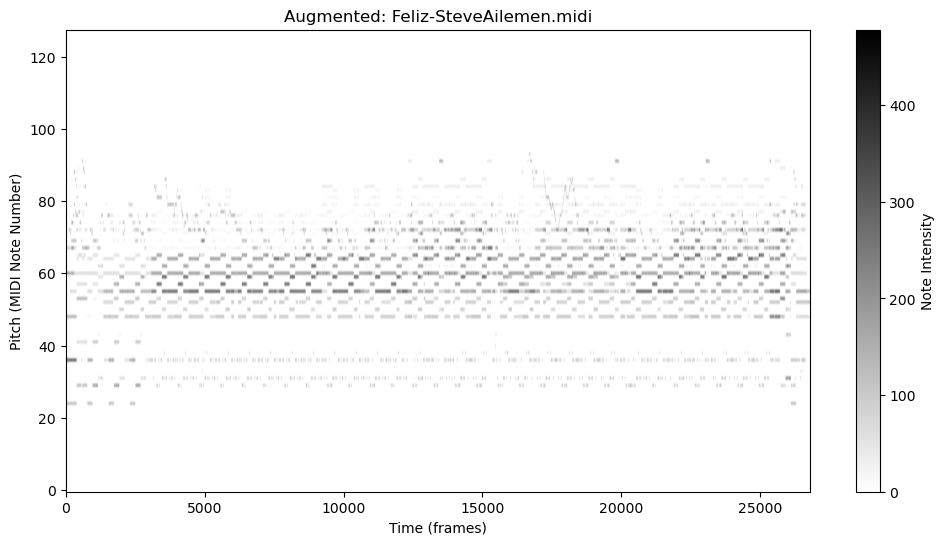

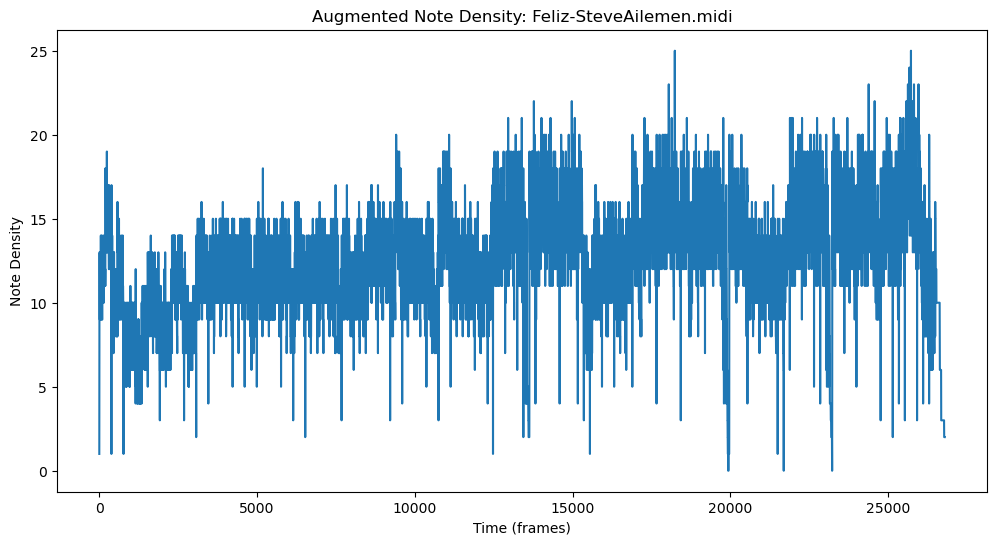

Visualizing original MIDI file: AwesomeGod-SteveAilemen.midi


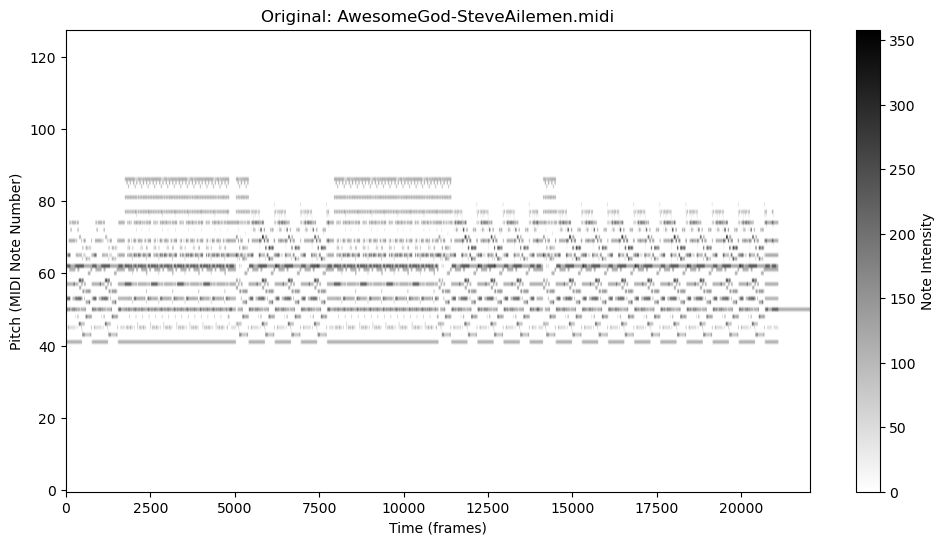

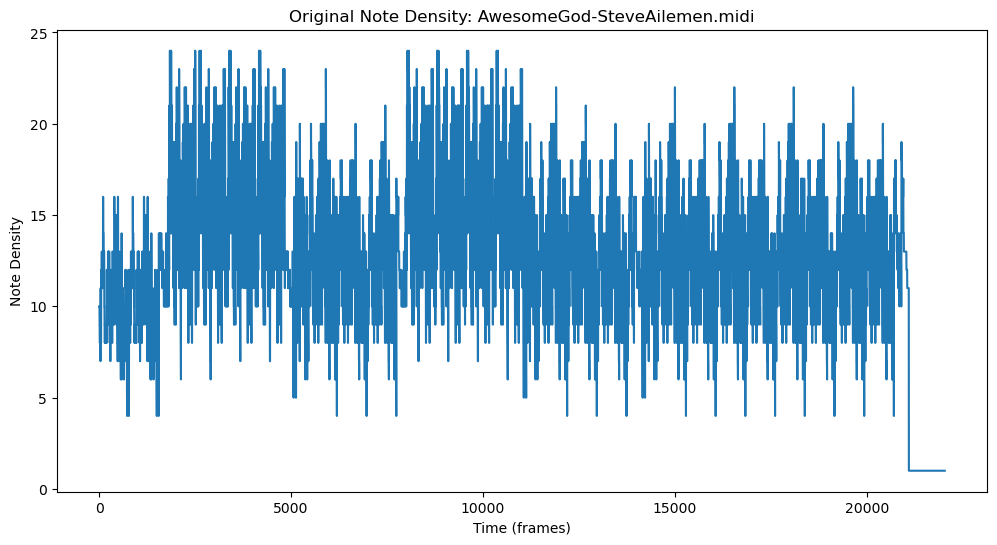

Visualizing augmented MIDI file: AwesomeGod-SteveAilemen.midi


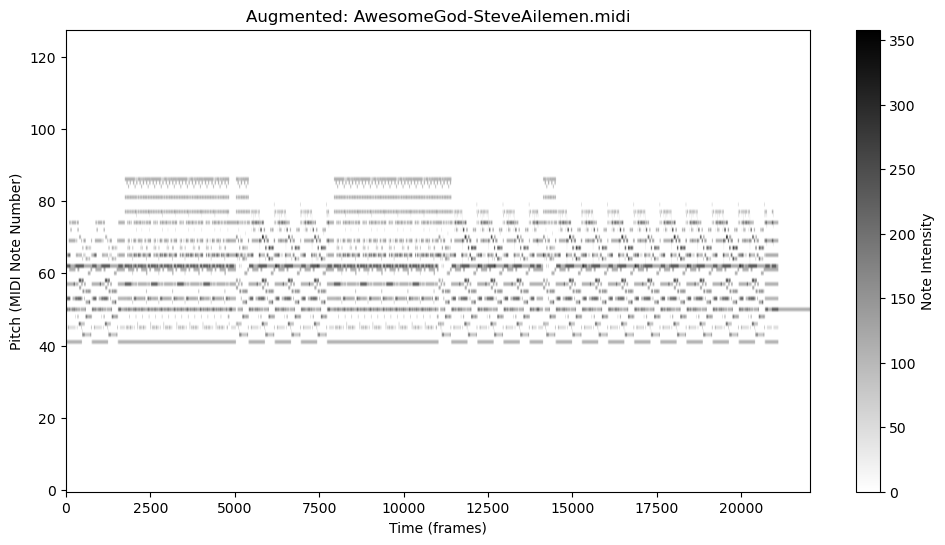

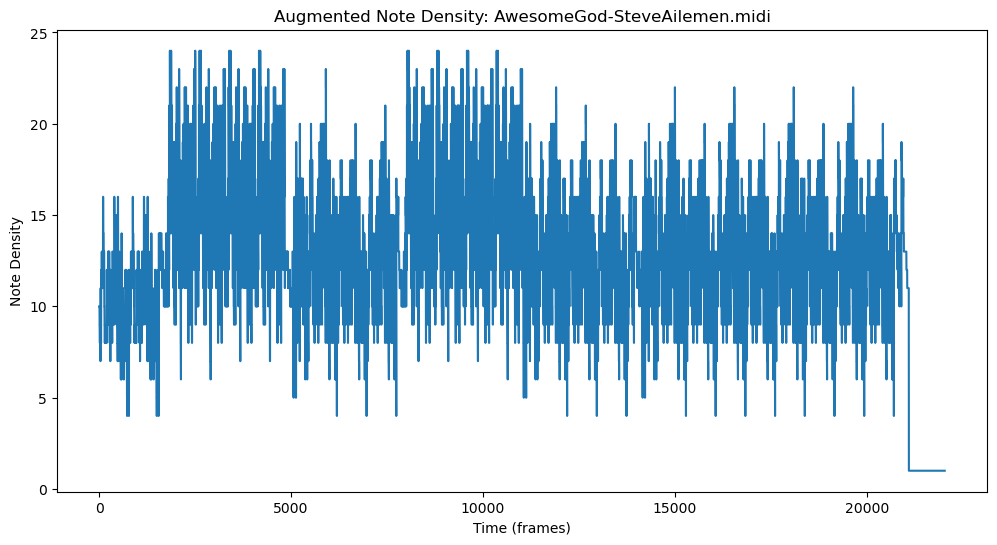

Visualizing original MIDI file: HiLife-1-SteveAilemen.midi


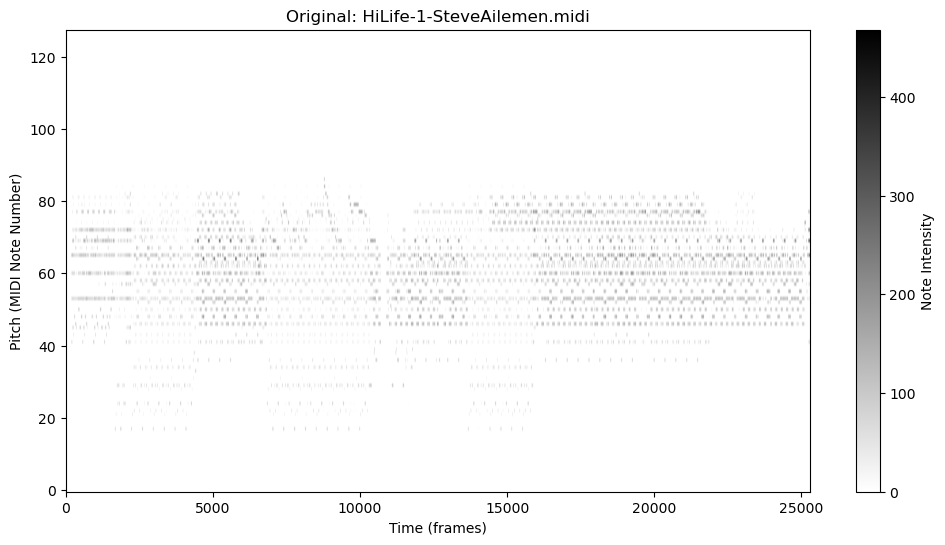

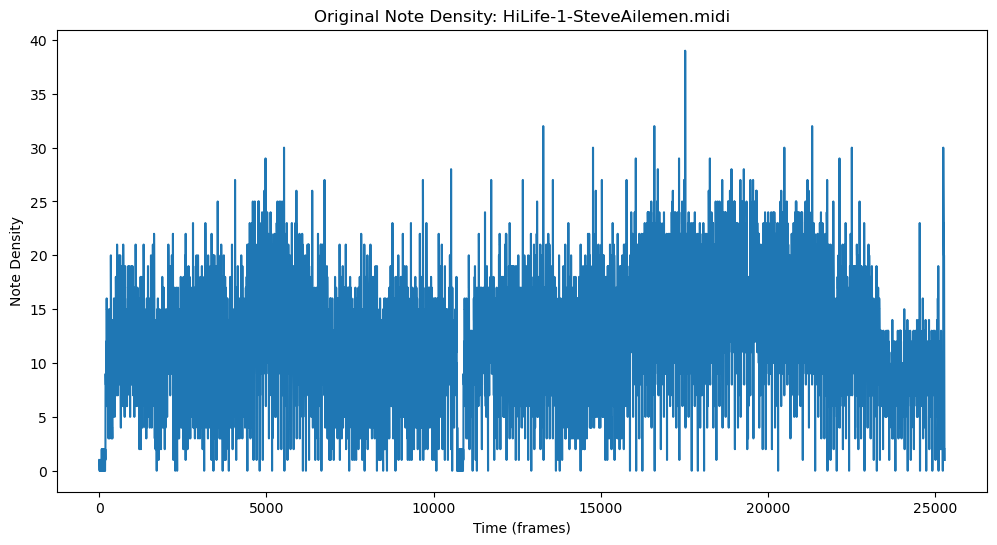

Visualizing augmented MIDI file: HiLife-1-SteveAilemen.midi


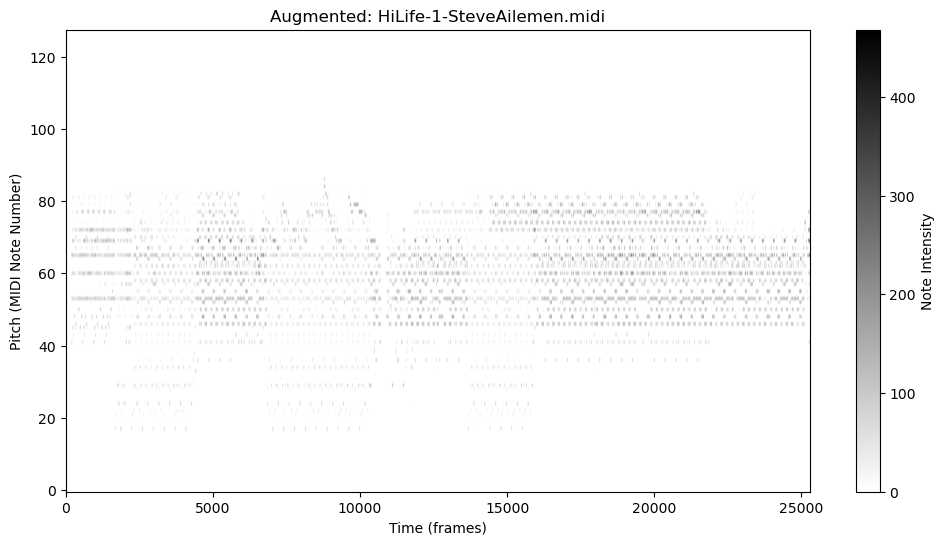

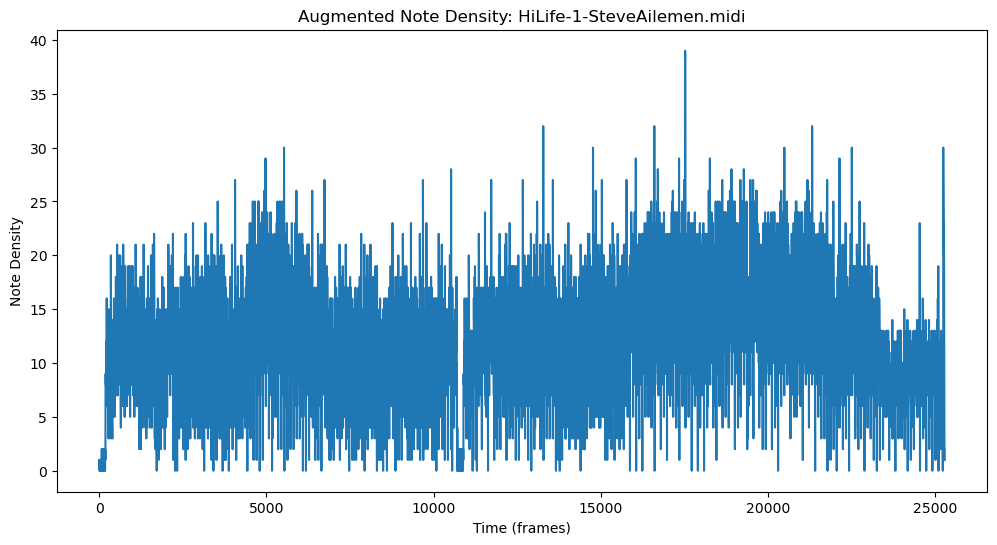

Visualizing original MIDI file: Halleljah_Soukous_SteveDeRock.midi


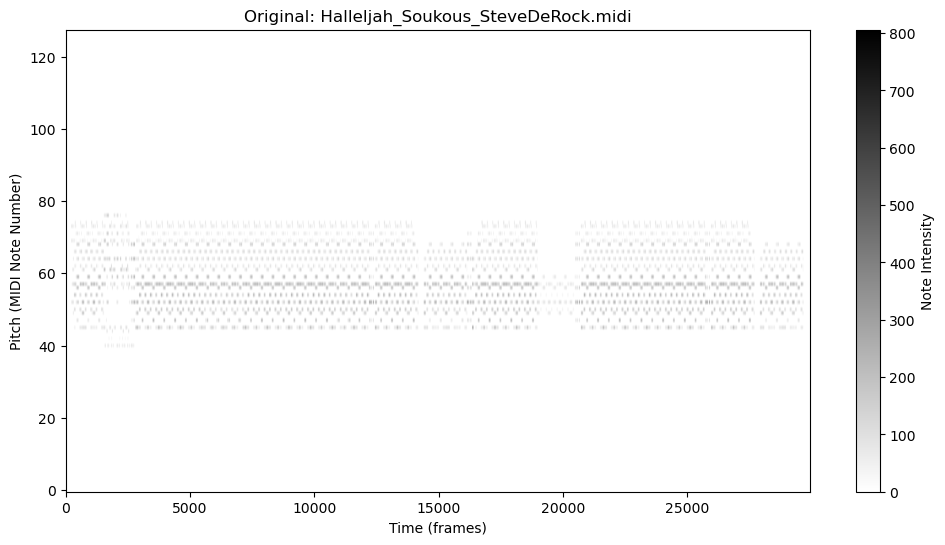

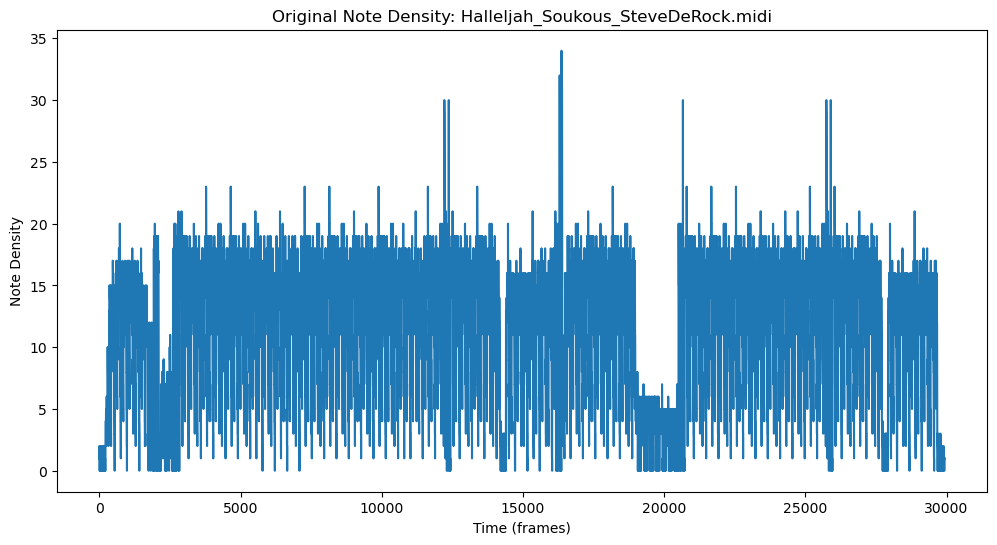

Visualizing augmented MIDI file: Halleljah_Soukous_SteveDeRock.midi


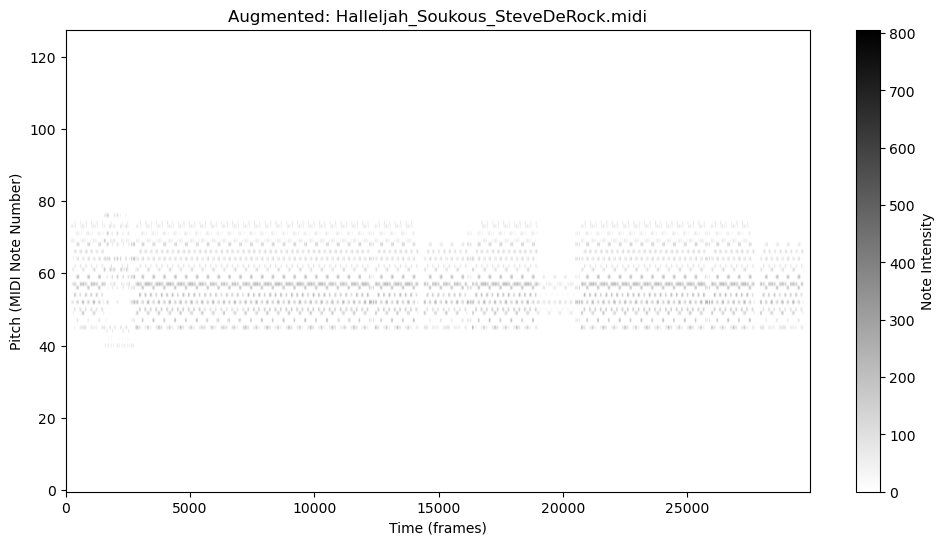

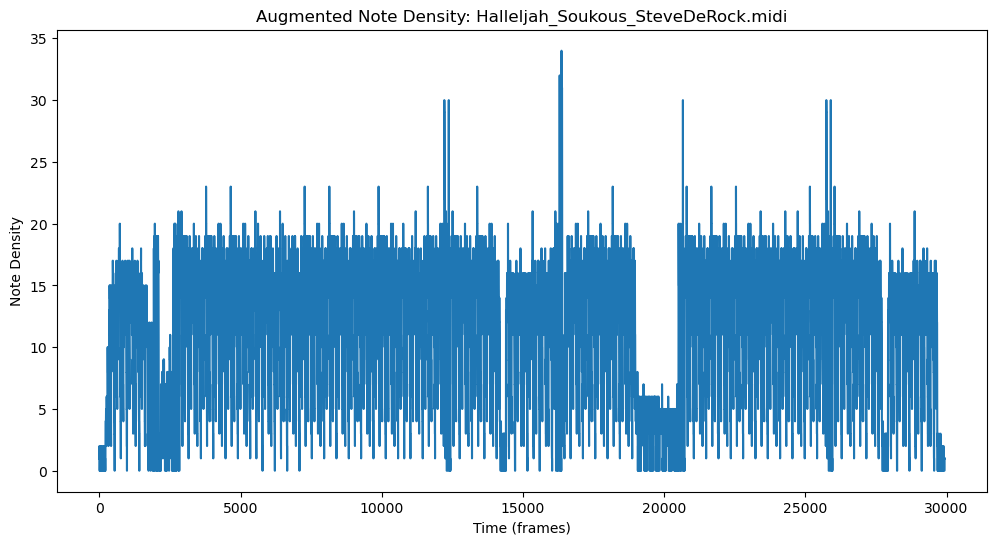

Visualizing original MIDI file: Chillout2-SteveAilemen.midi


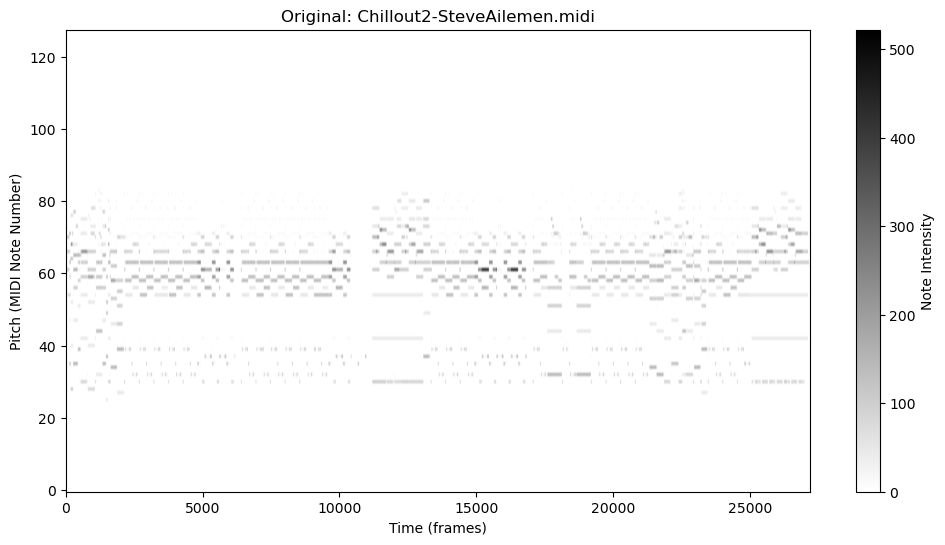

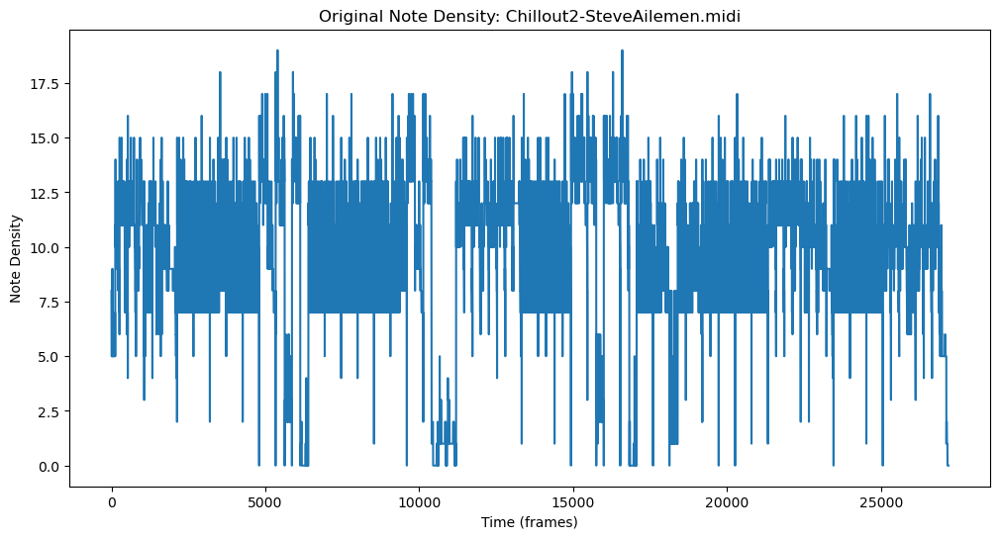

Visualizing augmented MIDI file: Chillout2-SteveAilemen.midi


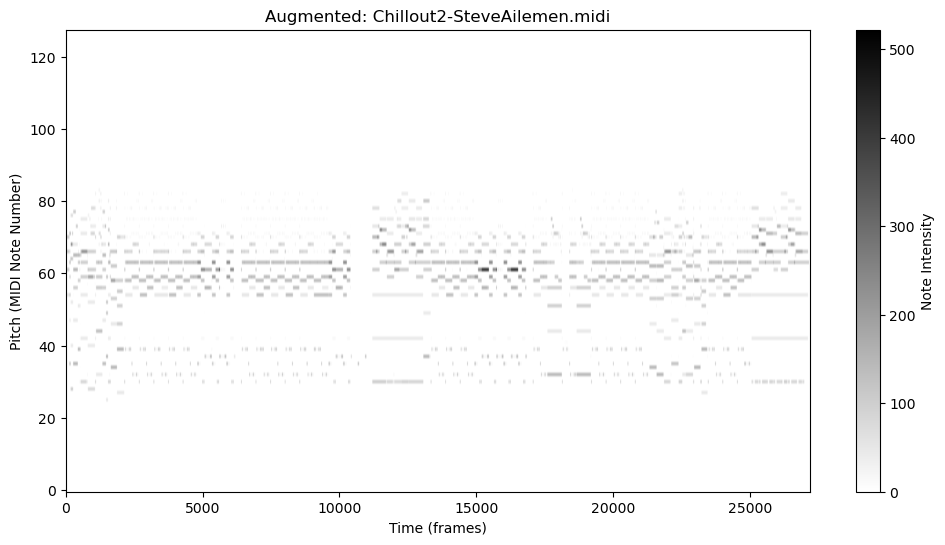

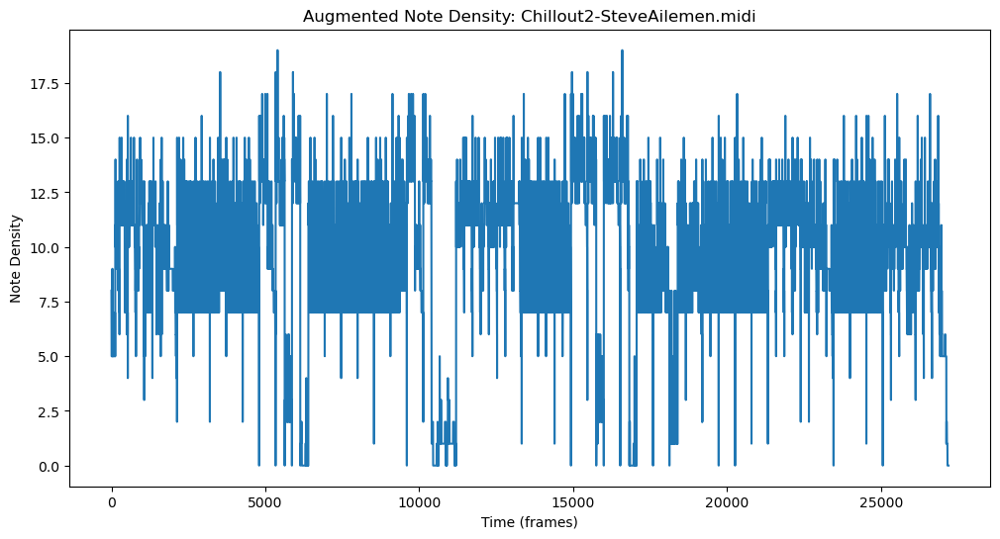

Visualizing original MIDI file: Makossa-Medley-SteveAilemen.midi


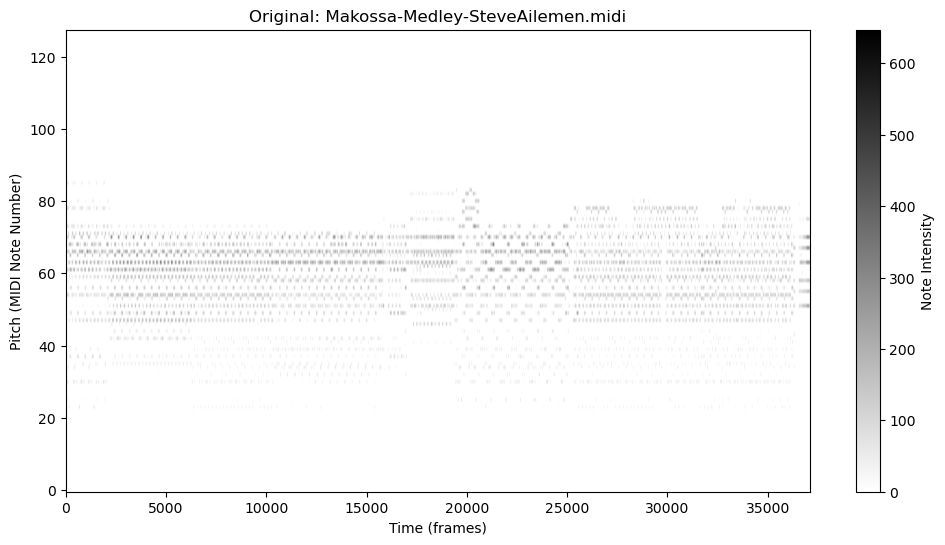

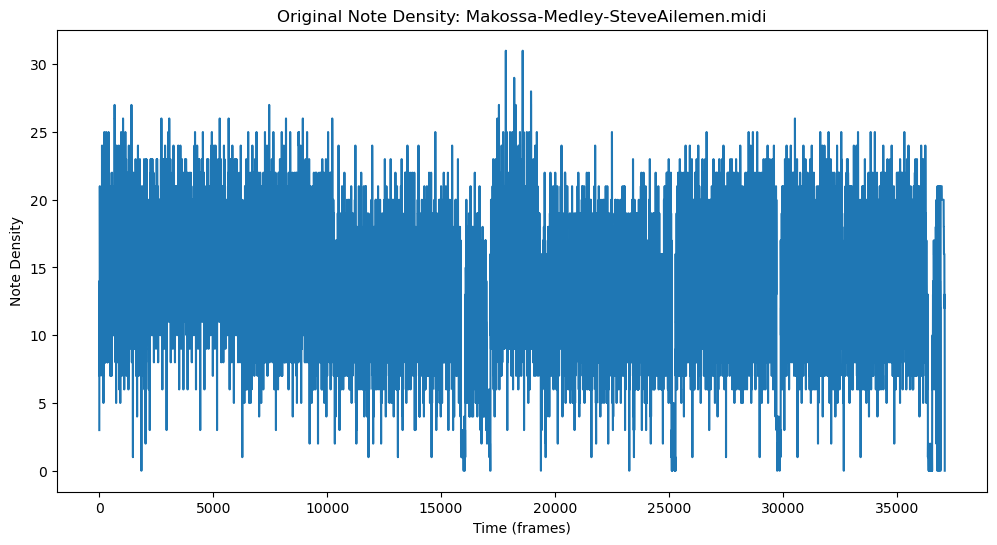

Visualizing augmented MIDI file: Makossa-Medley-SteveAilemen.midi


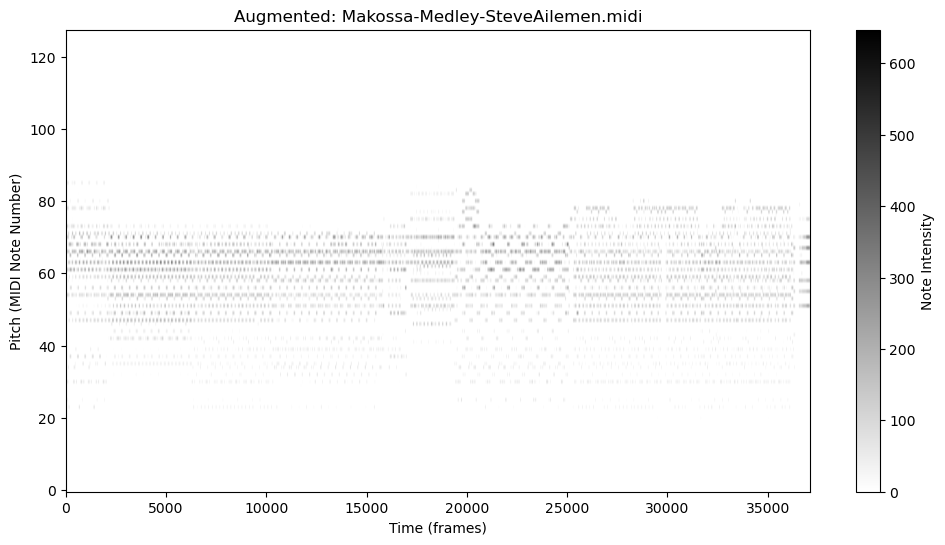

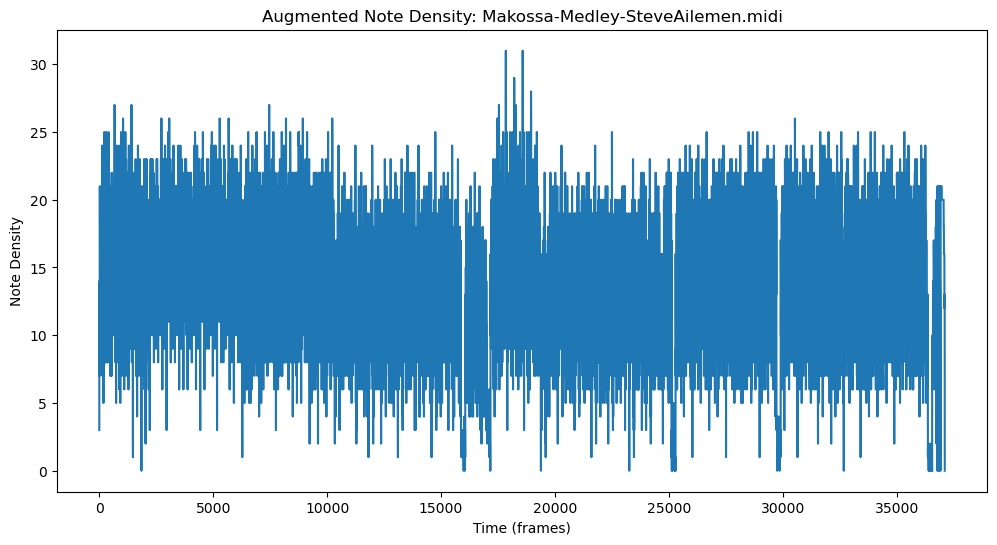

Visualizing original MIDI file: Who_Is_There_Like_You.mid


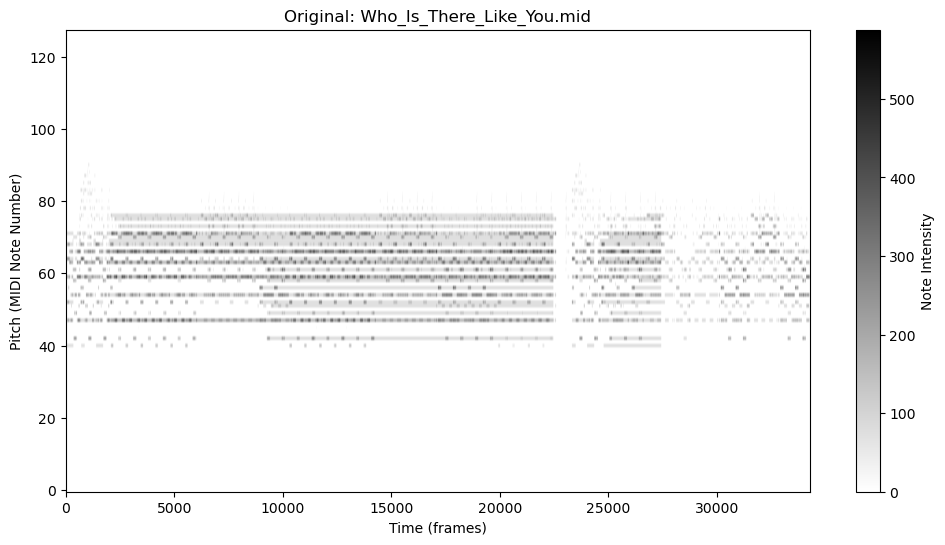

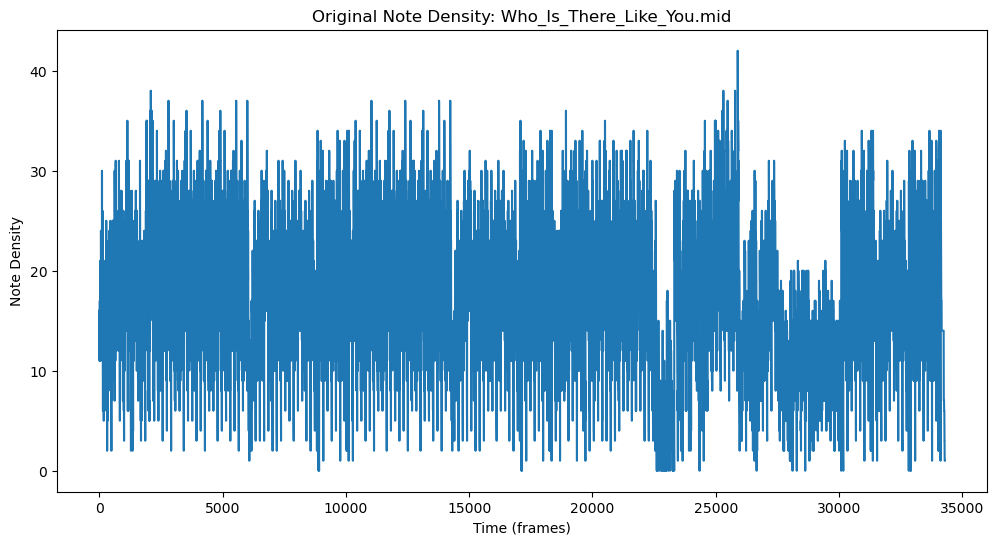

Visualizing augmented MIDI file: Who_Is_There_Like_You.mid


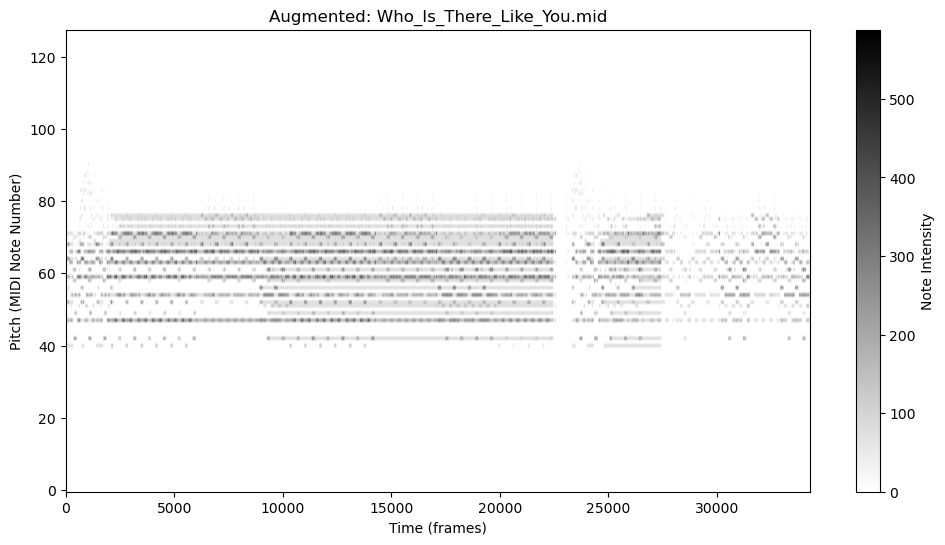

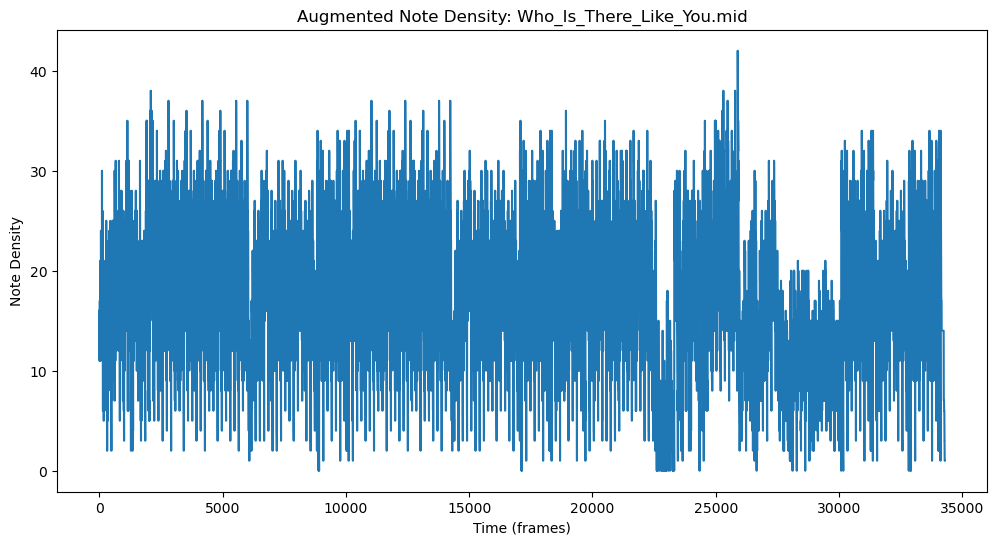

Visualizing original MIDI file: Omame-Retro-SteveAilemen.midi


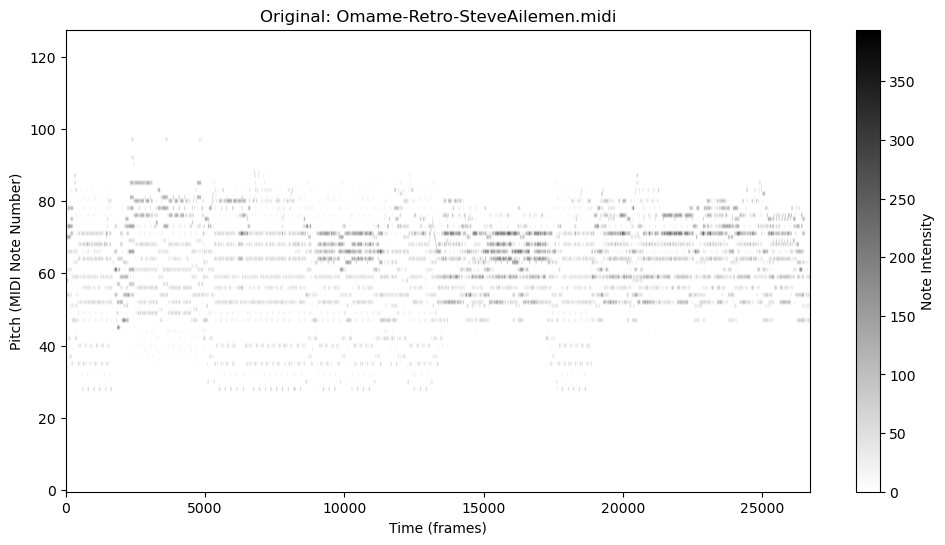

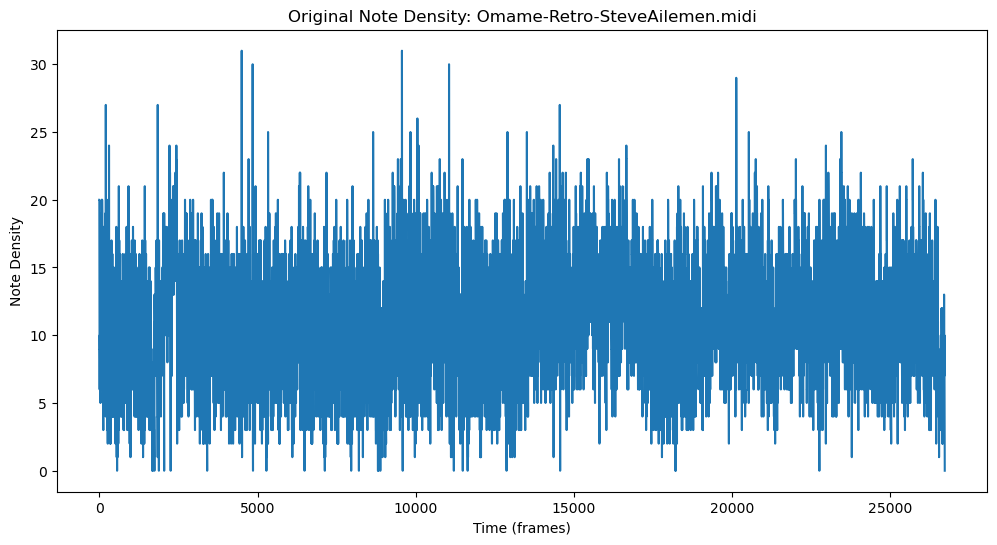

Visualizing augmented MIDI file: Omame-Retro-SteveAilemen.midi


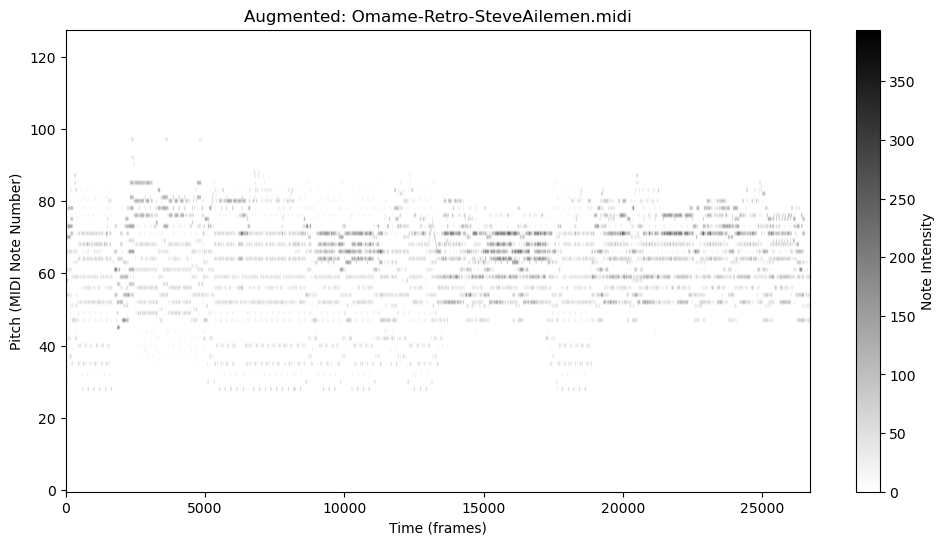

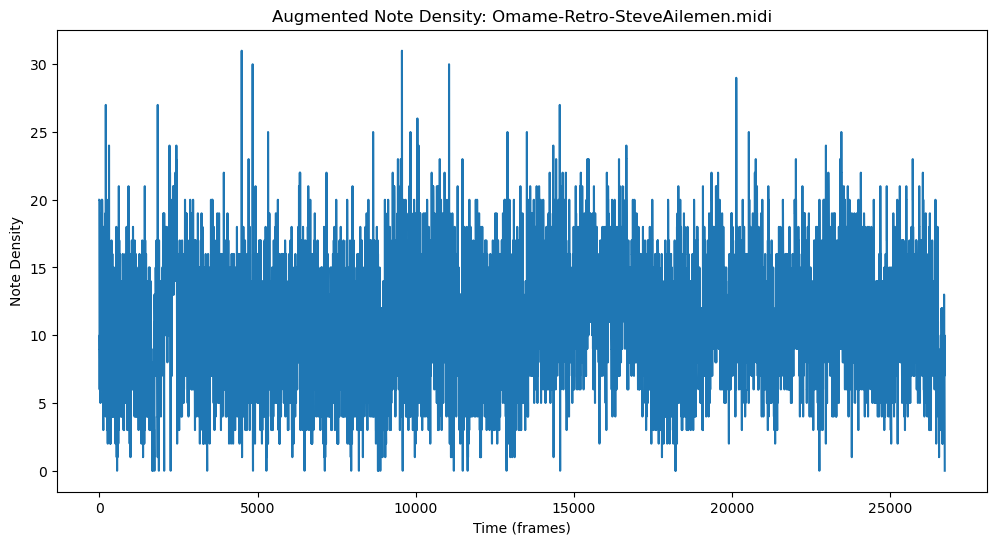

Visualizing original MIDI file: R&BSoulBalad-SteveAilemen.midi


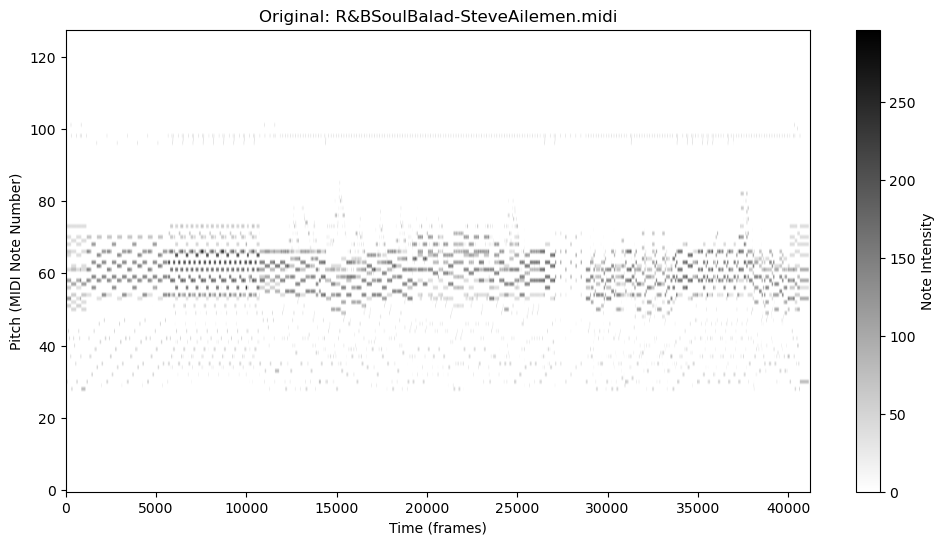

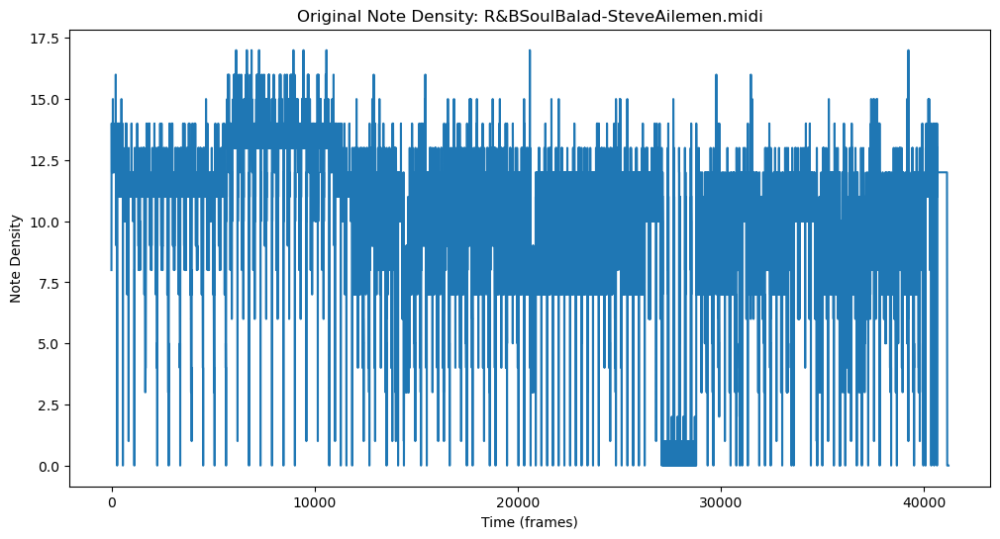

Visualizing augmented MIDI file: R&BSoulBalad-SteveAilemen.midi


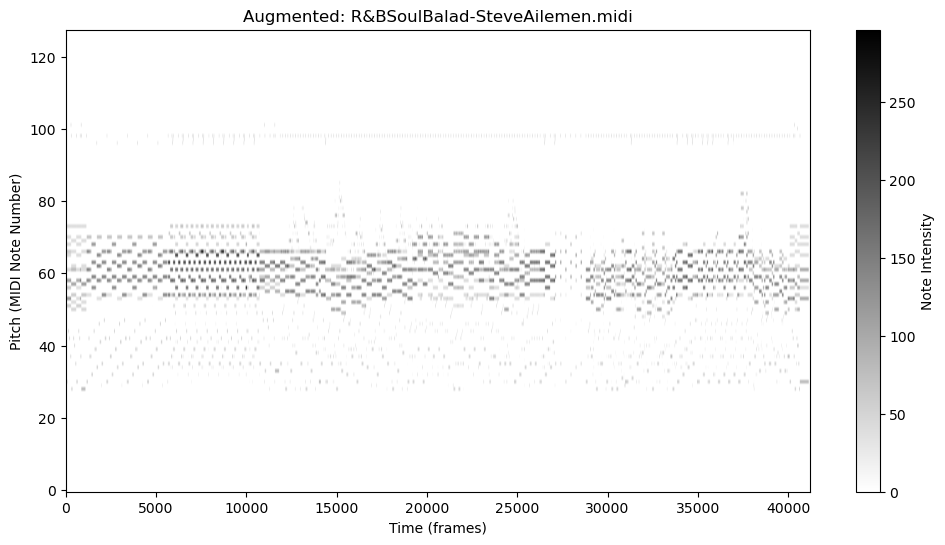

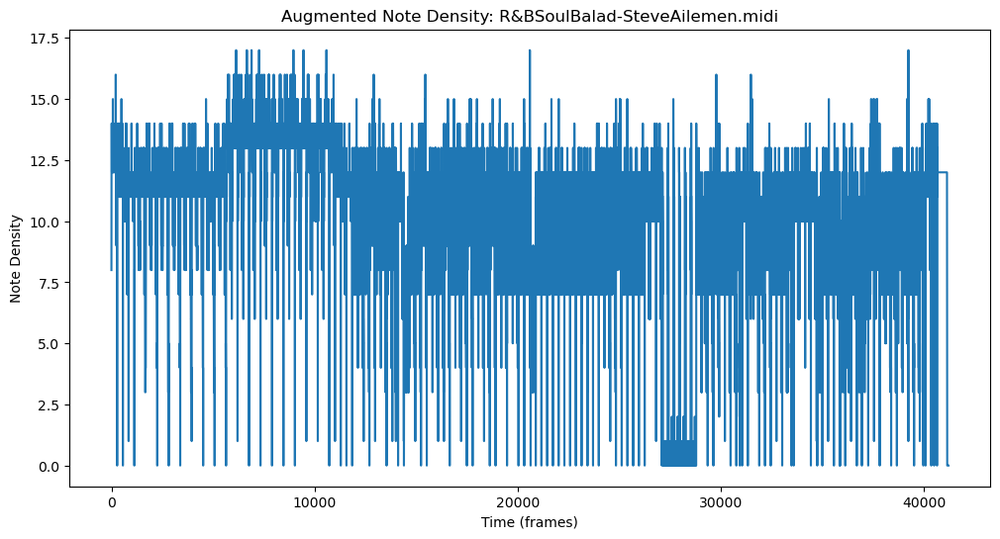

Visualizing original MIDI file: Je_Kijoba_Re_De_SteveDeRock.midi


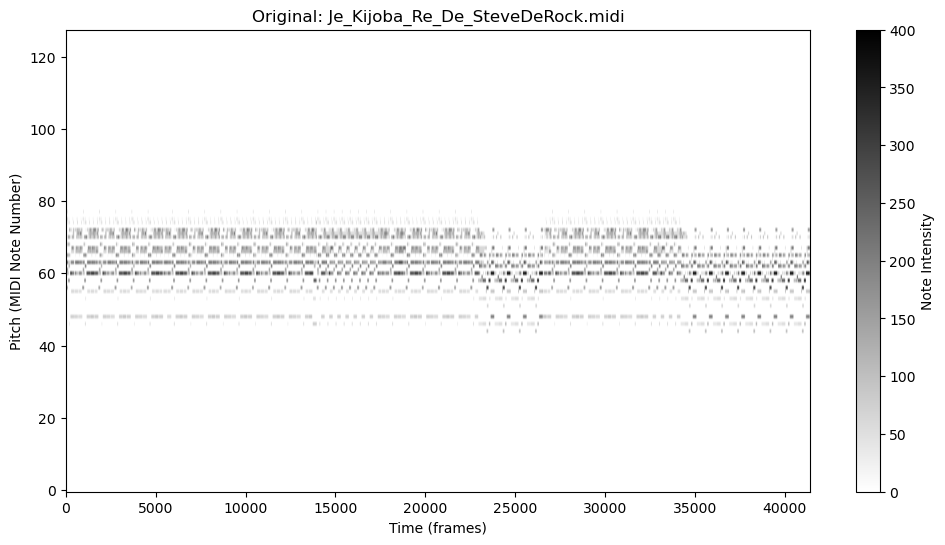

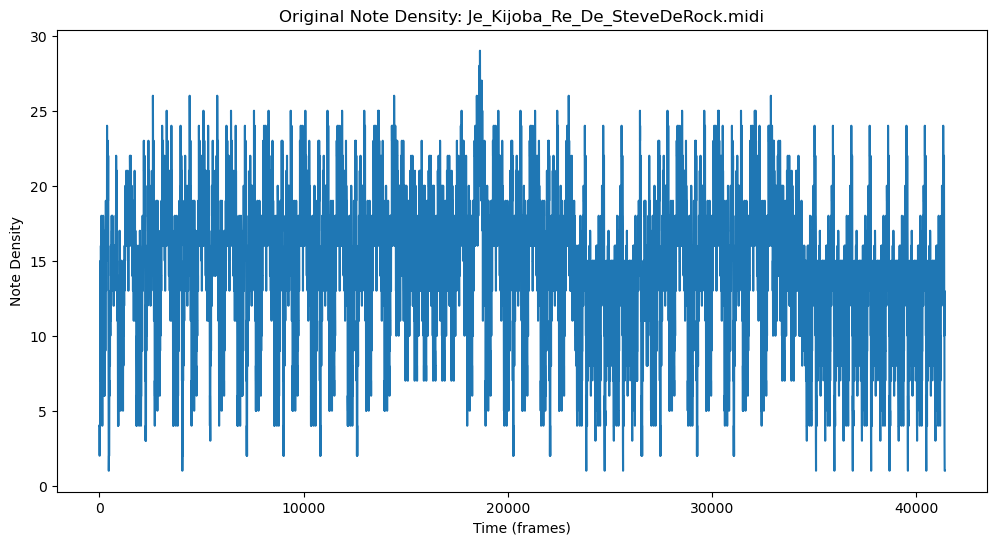

Visualizing augmented MIDI file: Je_Kijoba_Re_De_SteveDeRock.midi


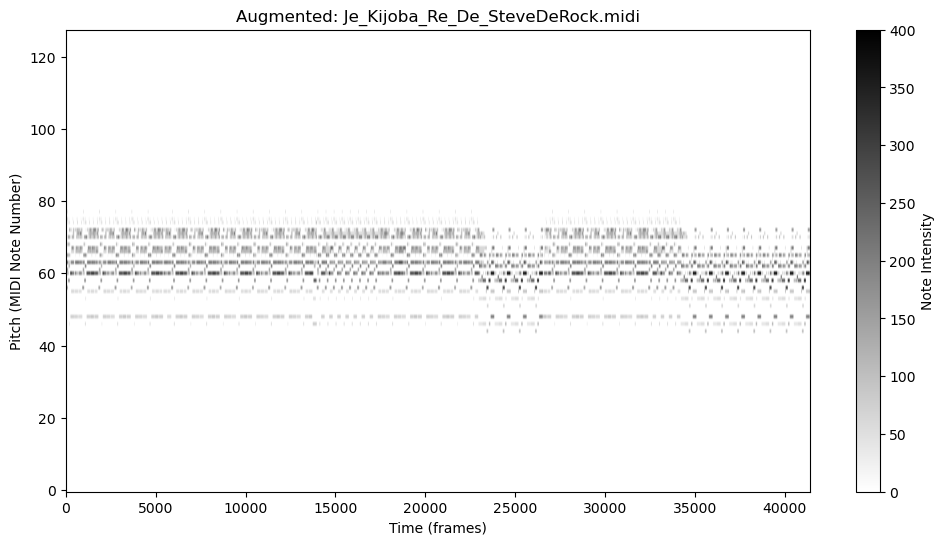

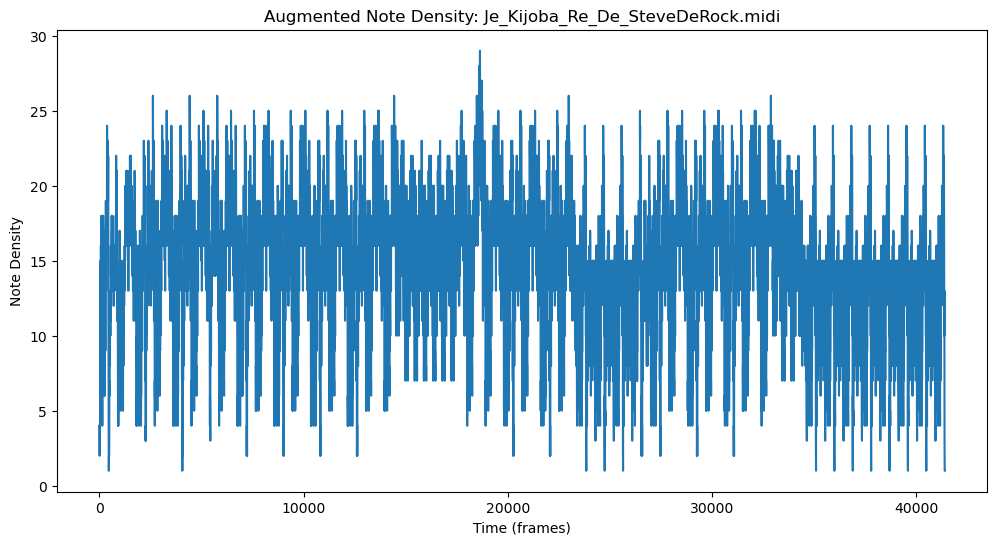

Visualizing original MIDI file: Tell_Me_The_Reason.mid


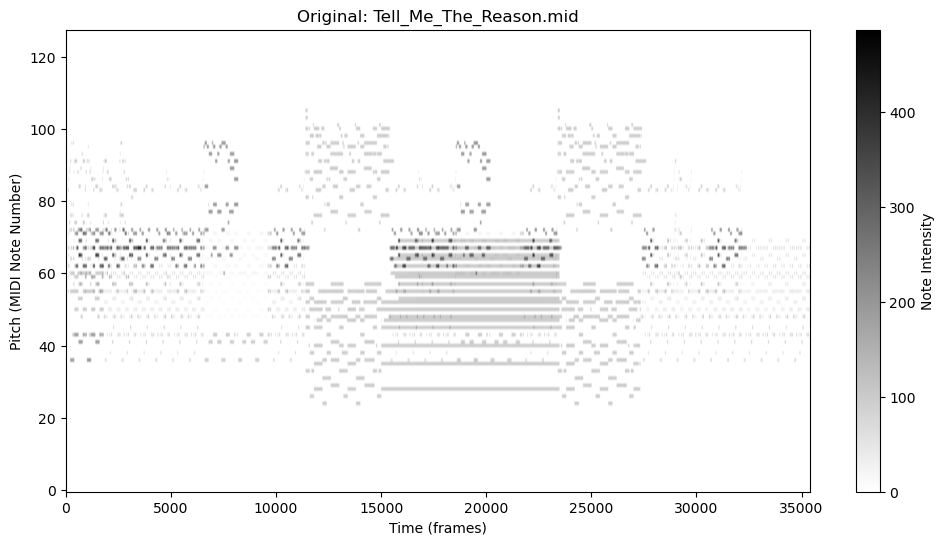

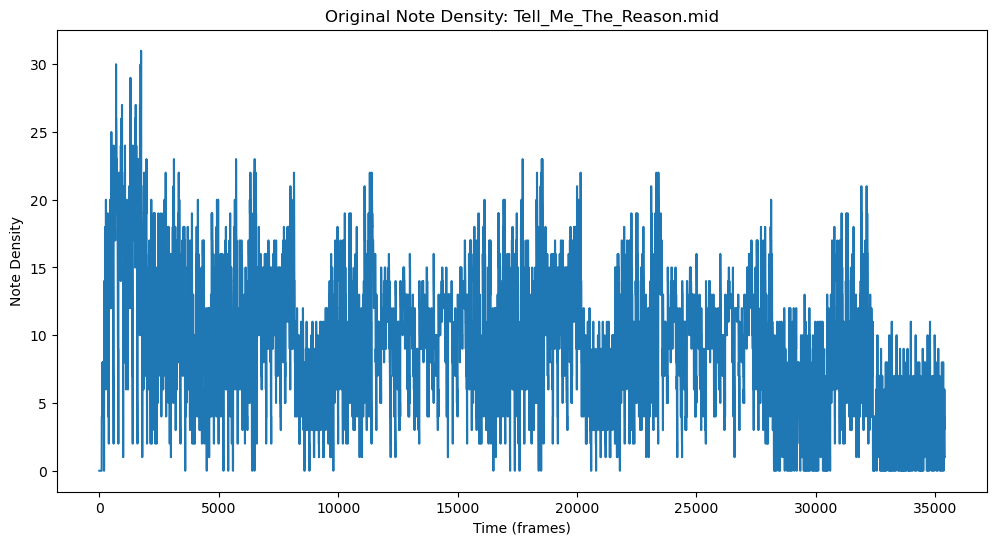

Visualizing augmented MIDI file: Tell_Me_The_Reason.mid


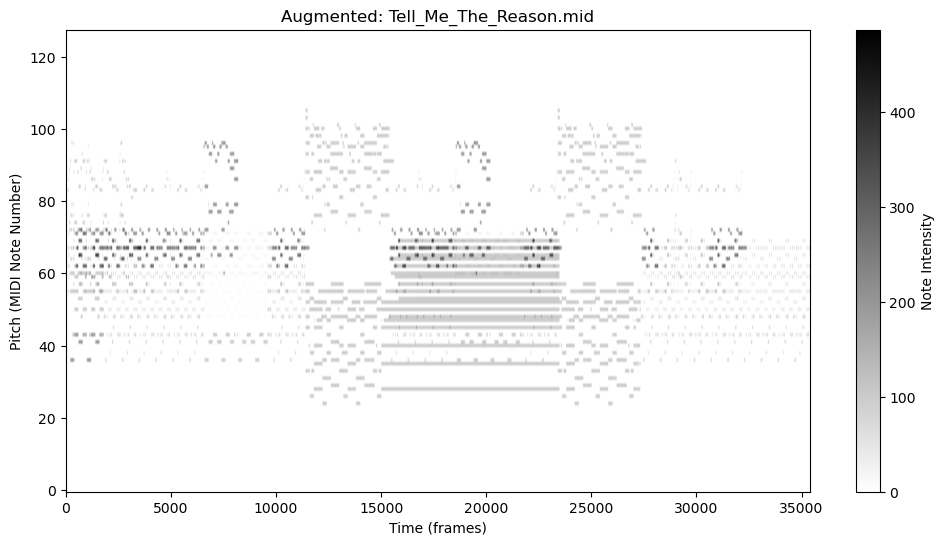

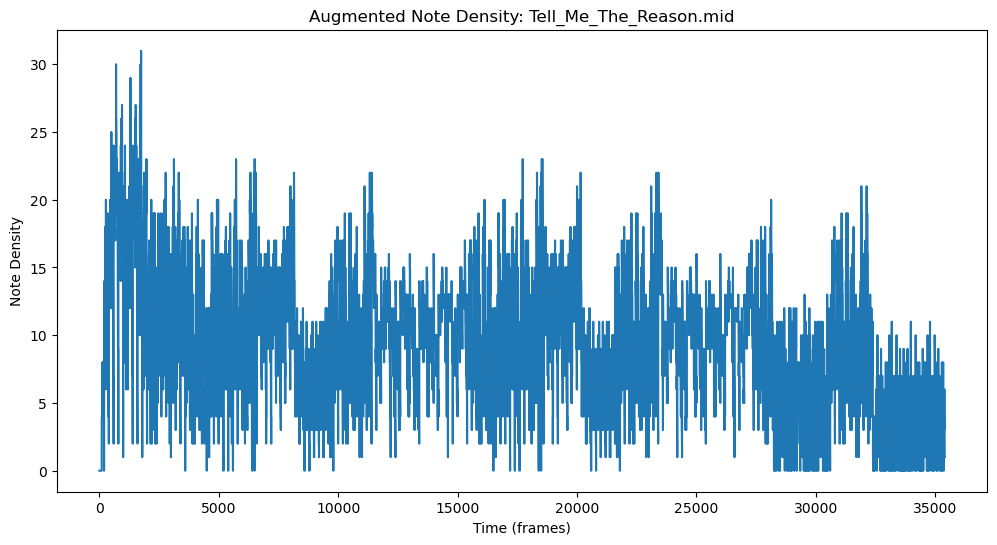

Visualizing original MIDI file: SchlagerFox-SteveAilemen.midi


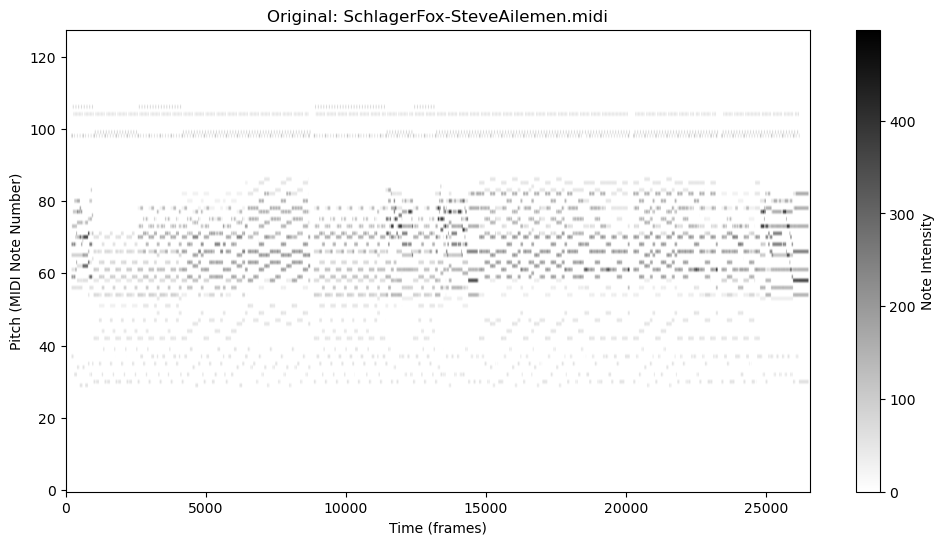

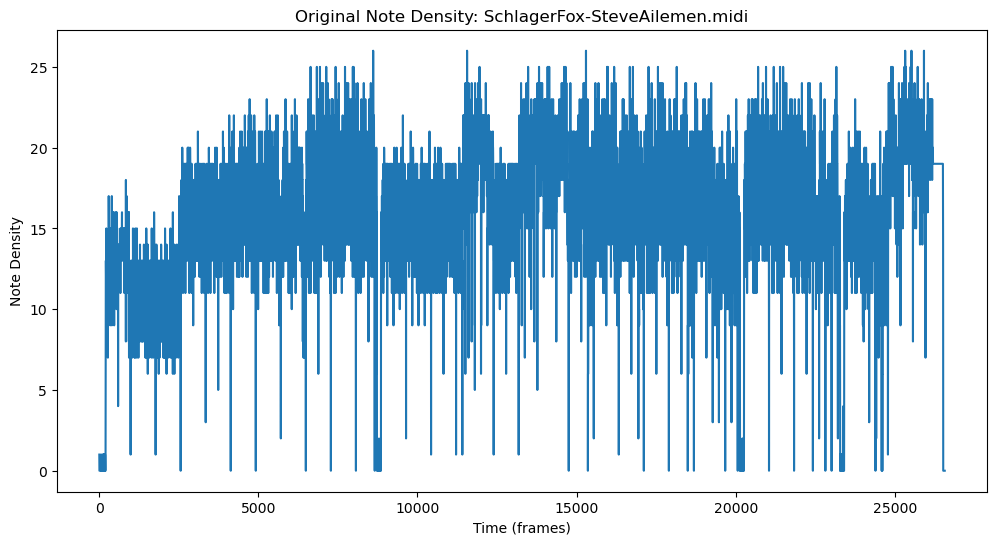

Visualizing augmented MIDI file: SchlagerFox-SteveAilemen.midi


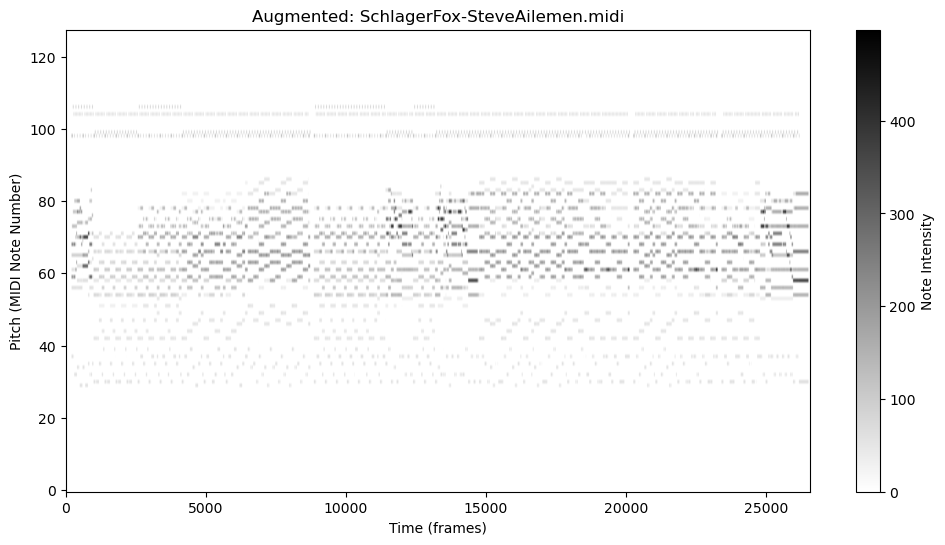

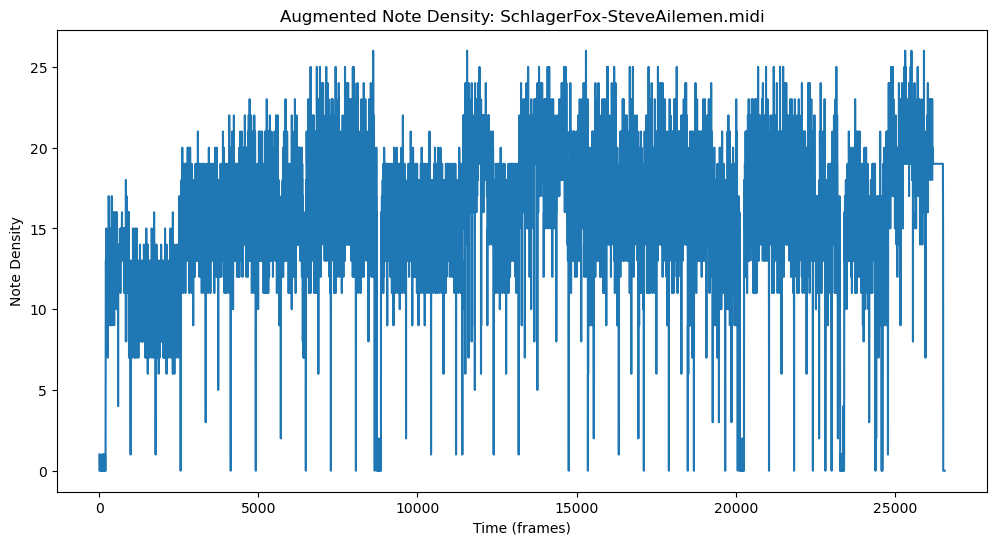

Visualizing original MIDI file: Chillout1-SteveAilemen.midi


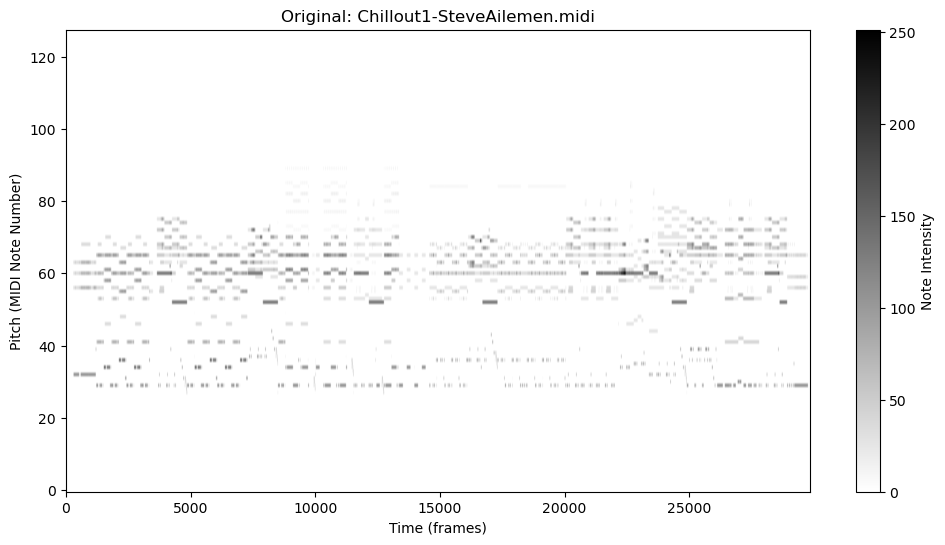

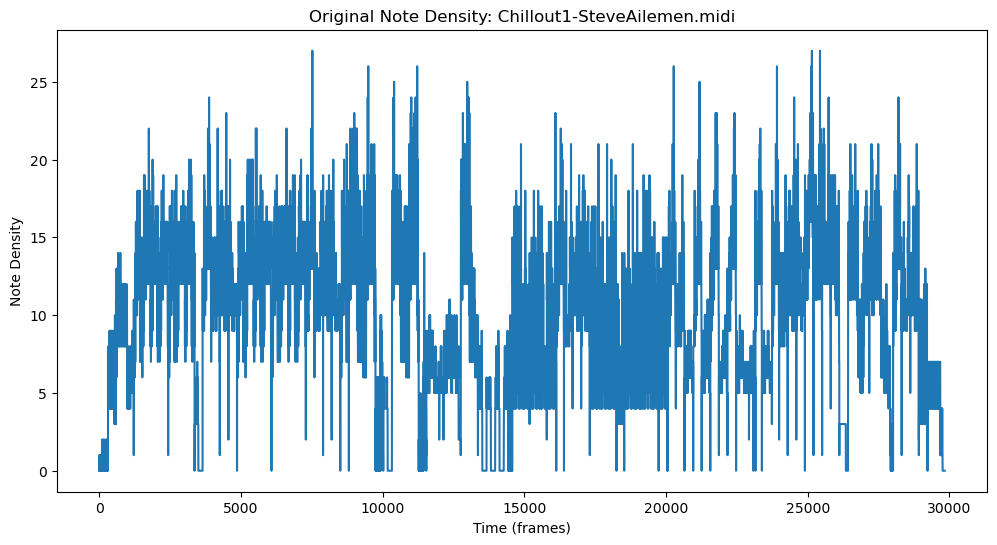

Visualizing augmented MIDI file: Chillout1-SteveAilemen.midi


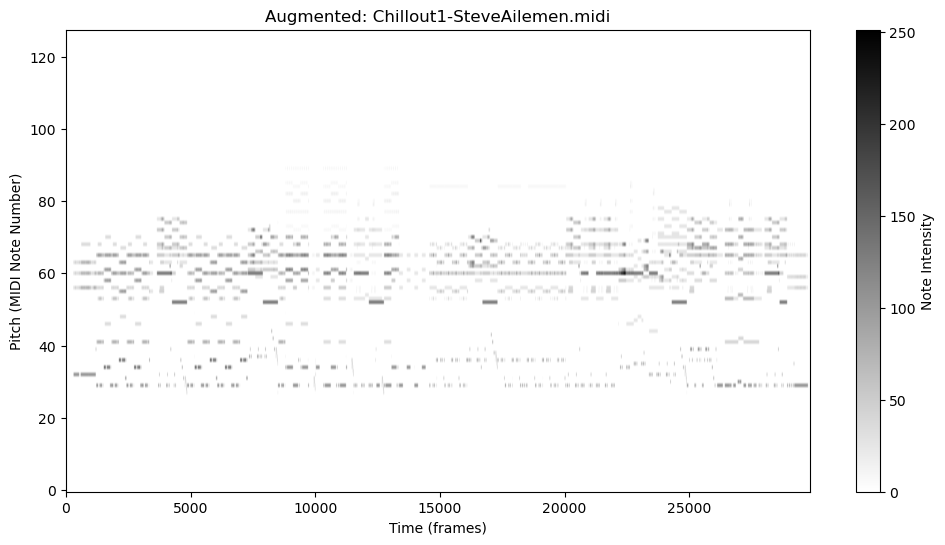

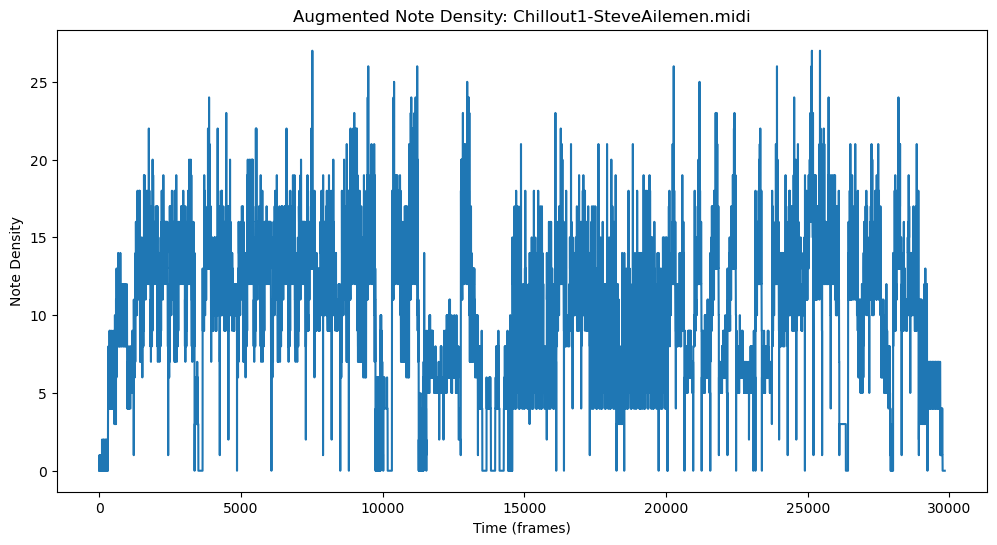

Visualizing original MIDI file: GermanRock-SteveAilemen.midi


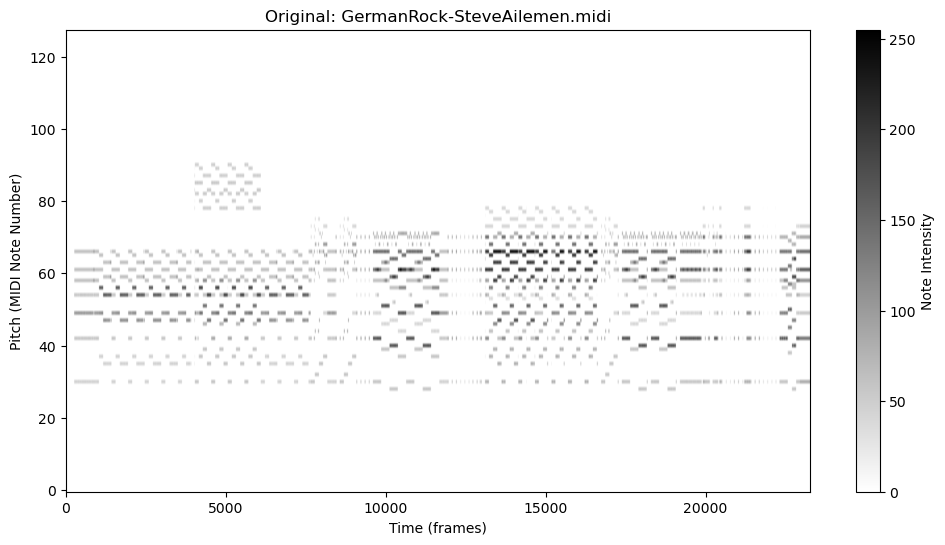

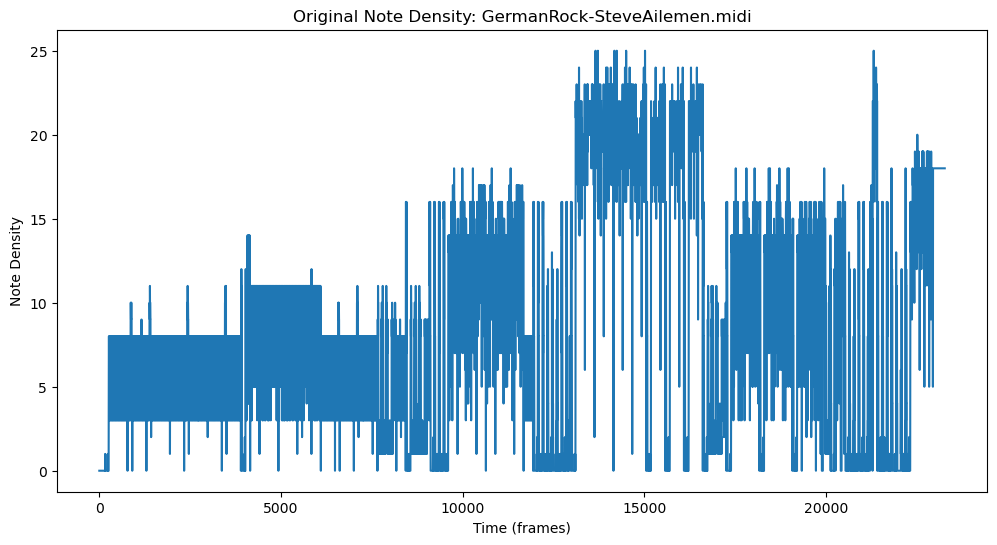

Visualizing augmented MIDI file: GermanRock-SteveAilemen.midi


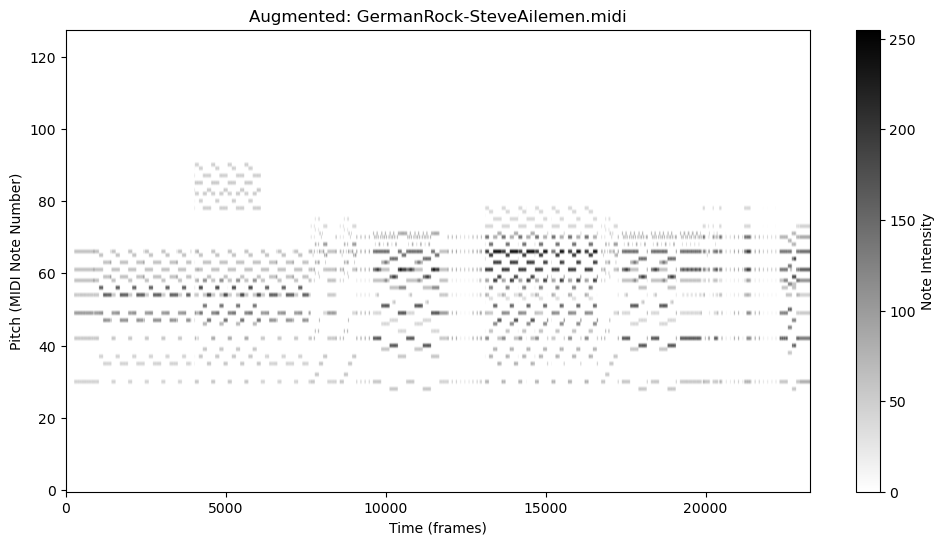

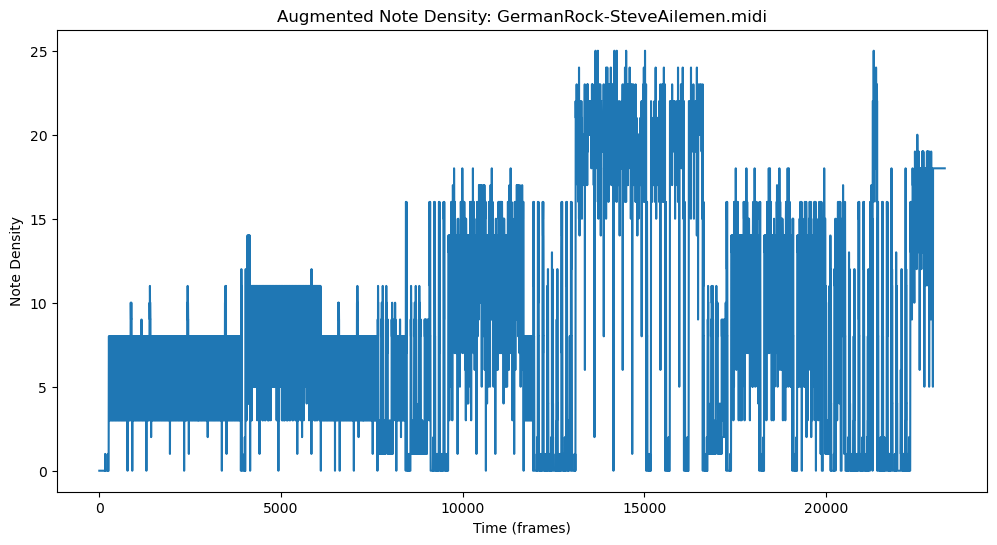

Visualizing original MIDI file: Agameburu-Hallelujah-SteveAilemen.midi


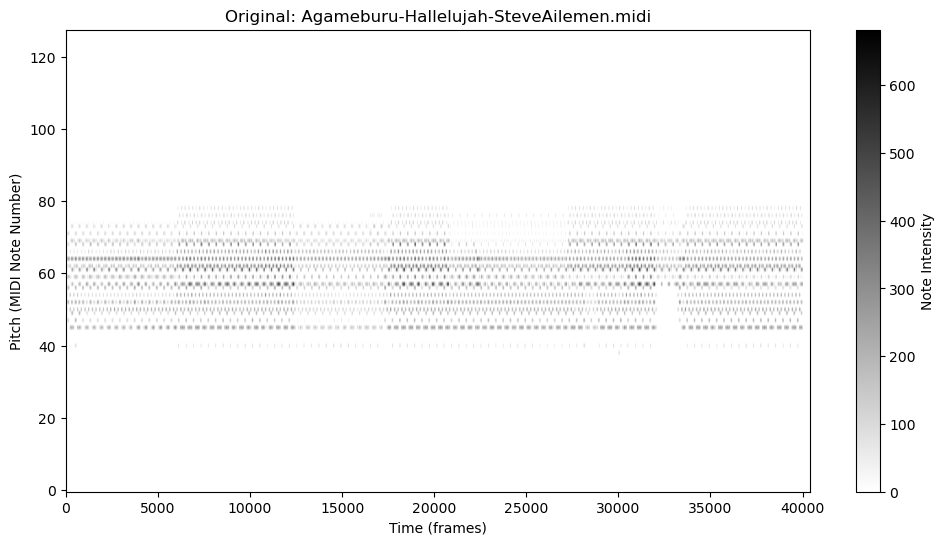

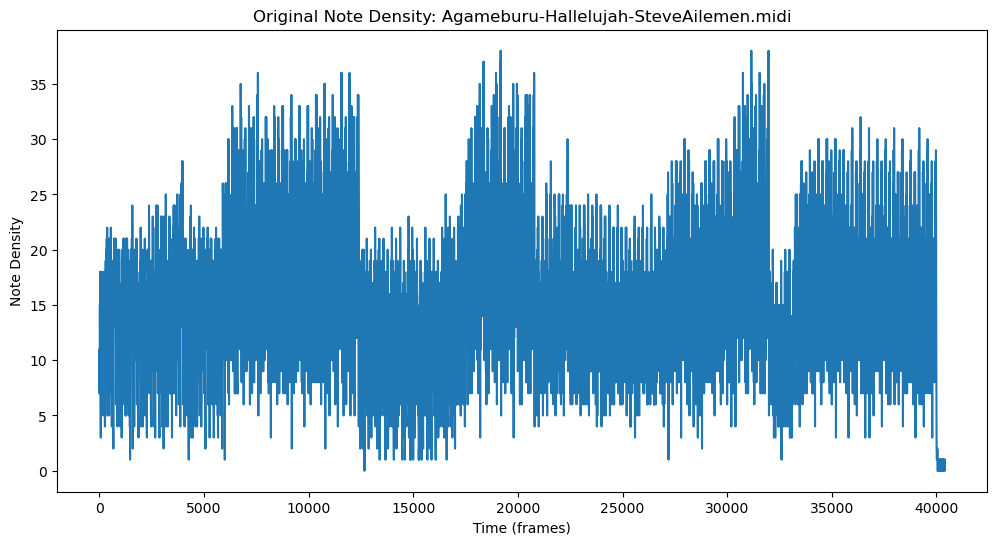

Visualizing augmented MIDI file: Agameburu-Hallelujah-SteveAilemen.midi


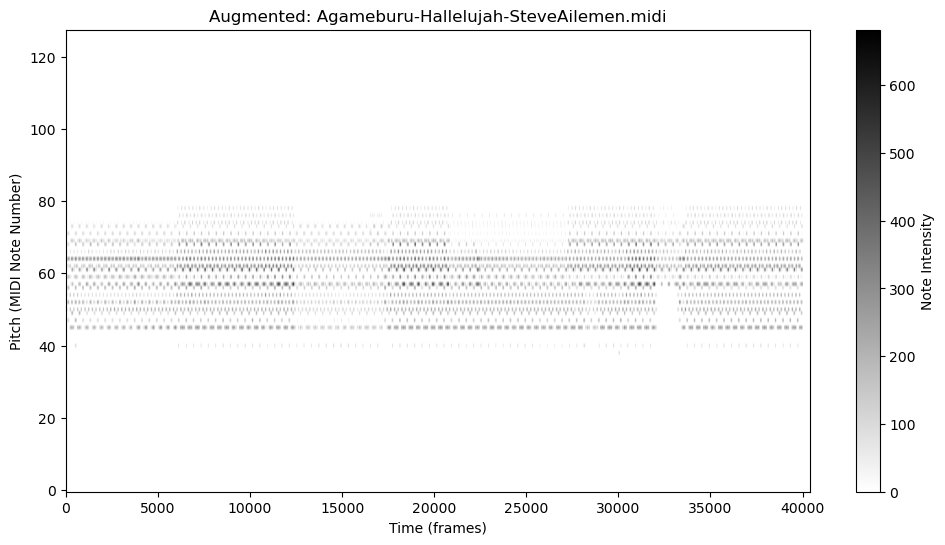

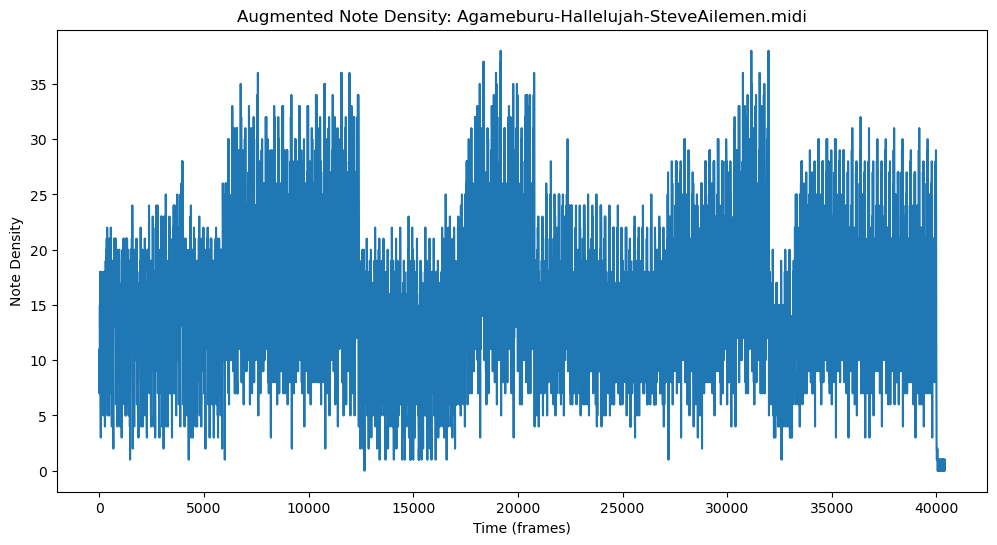

Visualizing original MIDI file: There-Is-No-god-SteveAilemen.mid


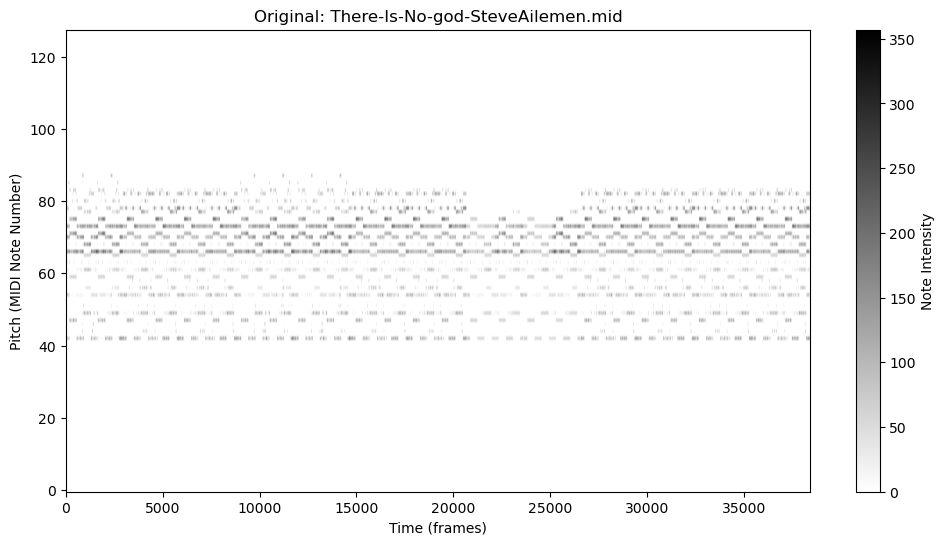

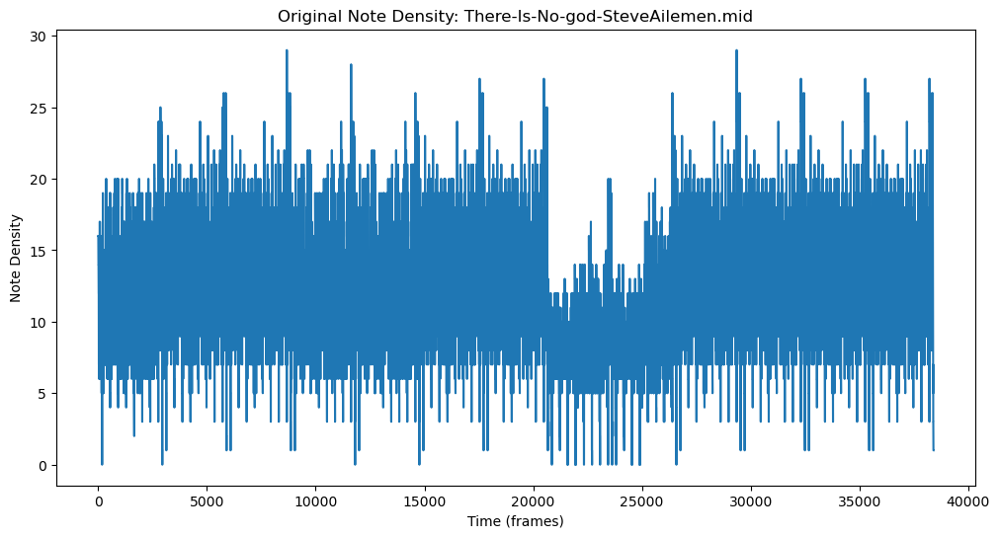

Visualizing augmented MIDI file: There-Is-No-god-SteveAilemen.mid


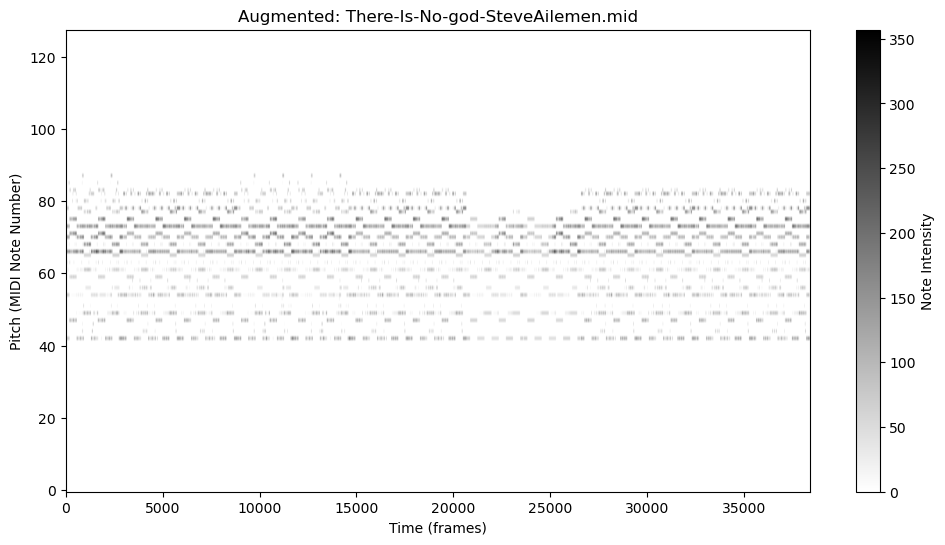

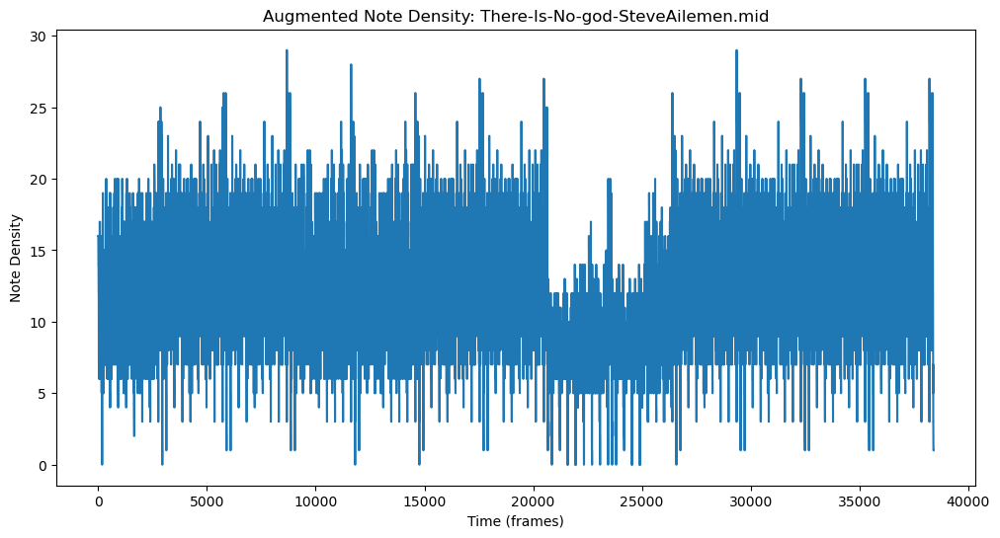

Visualizing original MIDI file: Woro-Medley1-SteveAilemen.midi


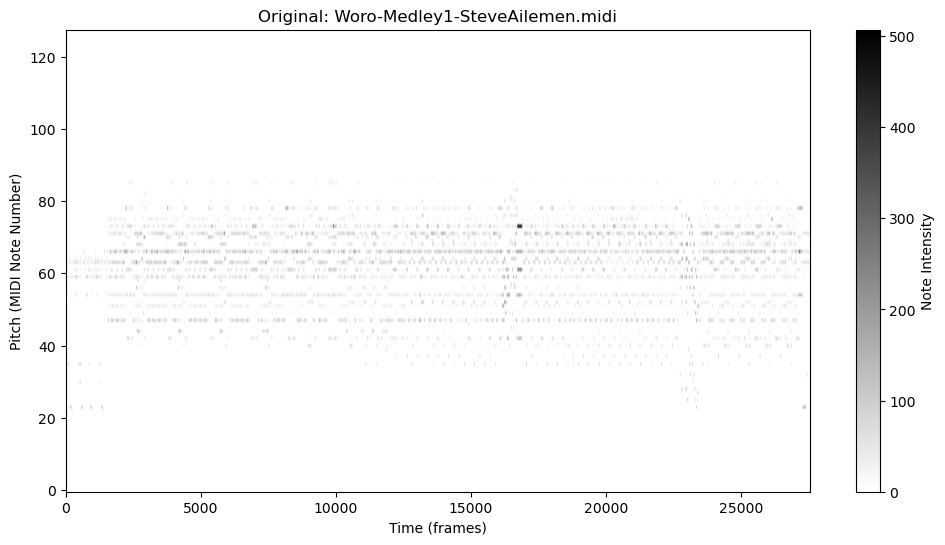

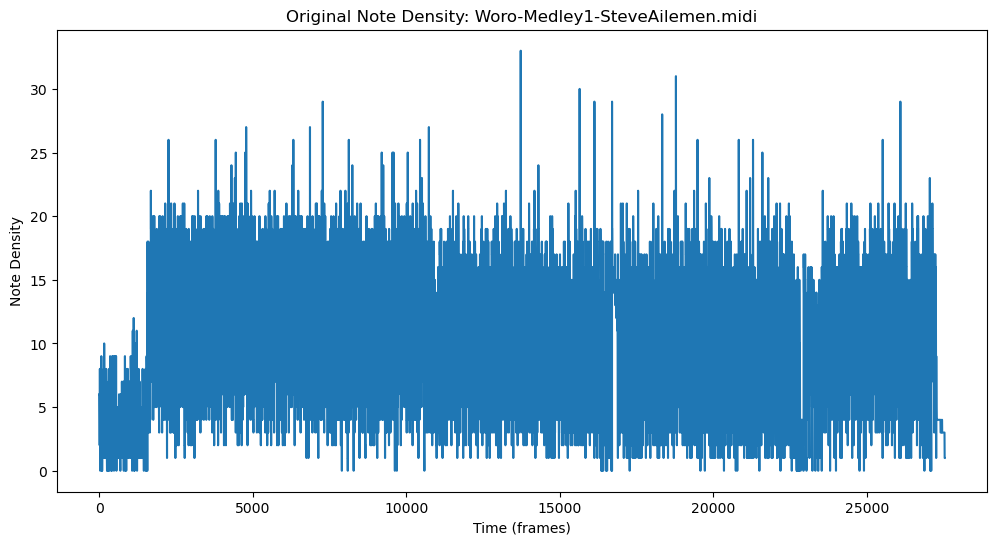

Visualizing augmented MIDI file: Woro-Medley1-SteveAilemen.midi


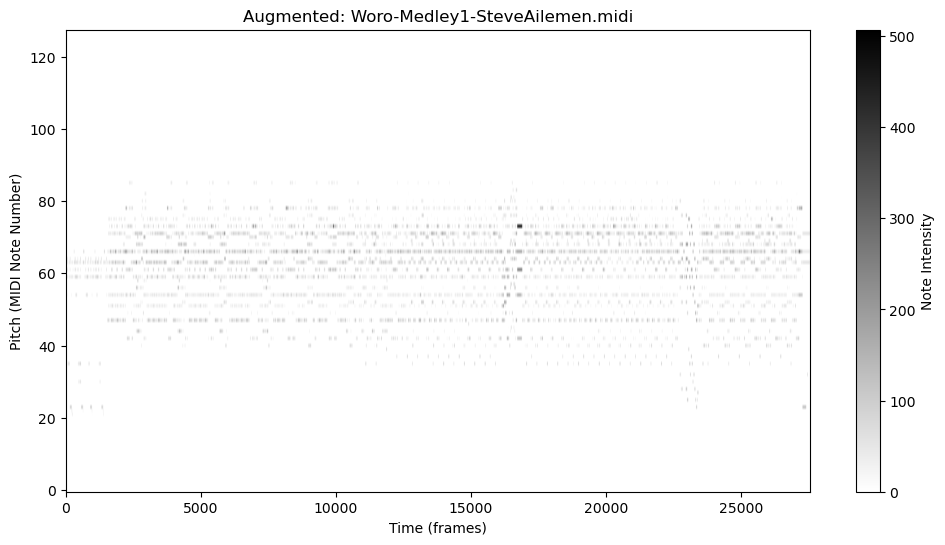

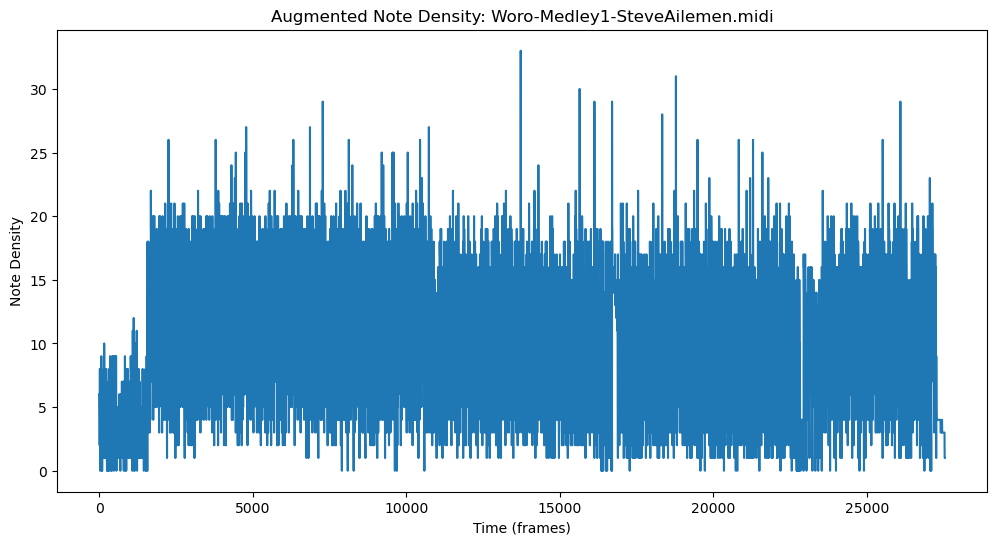

Visualizing original MIDI file: Wonderful-SteveAilemen.midi


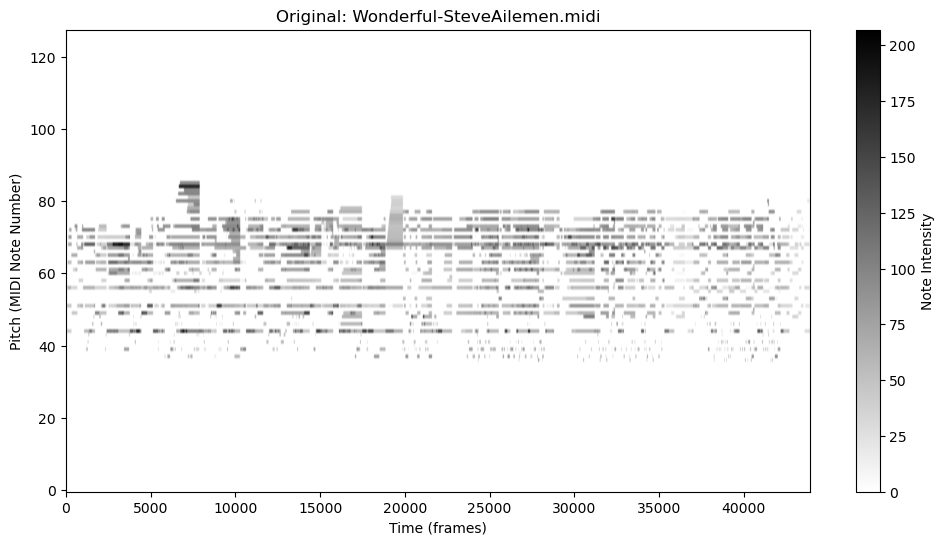

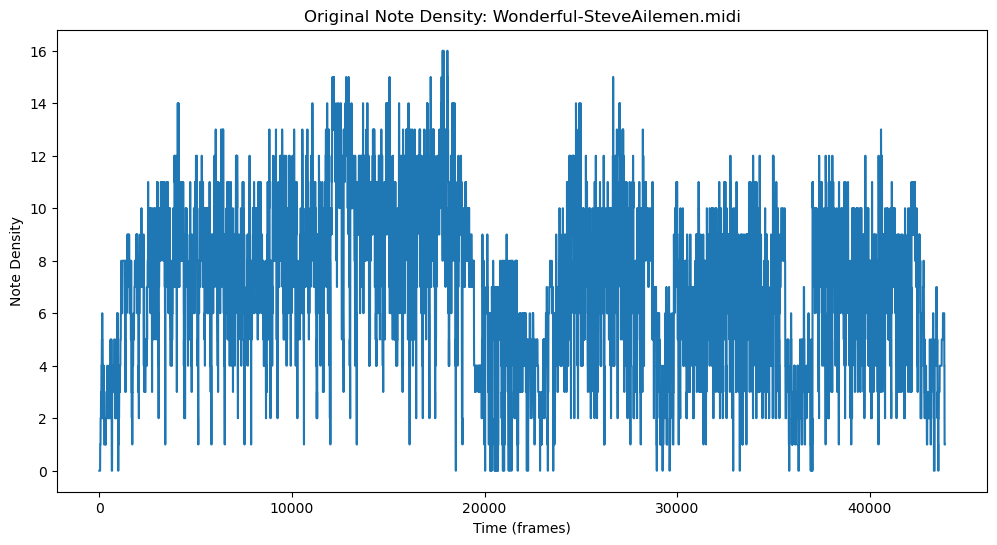

Visualizing augmented MIDI file: Wonderful-SteveAilemen.midi


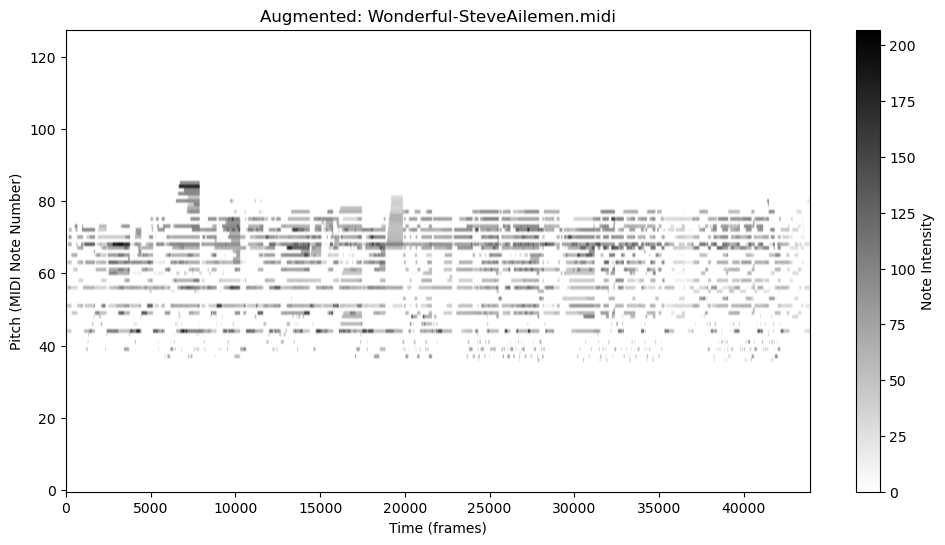

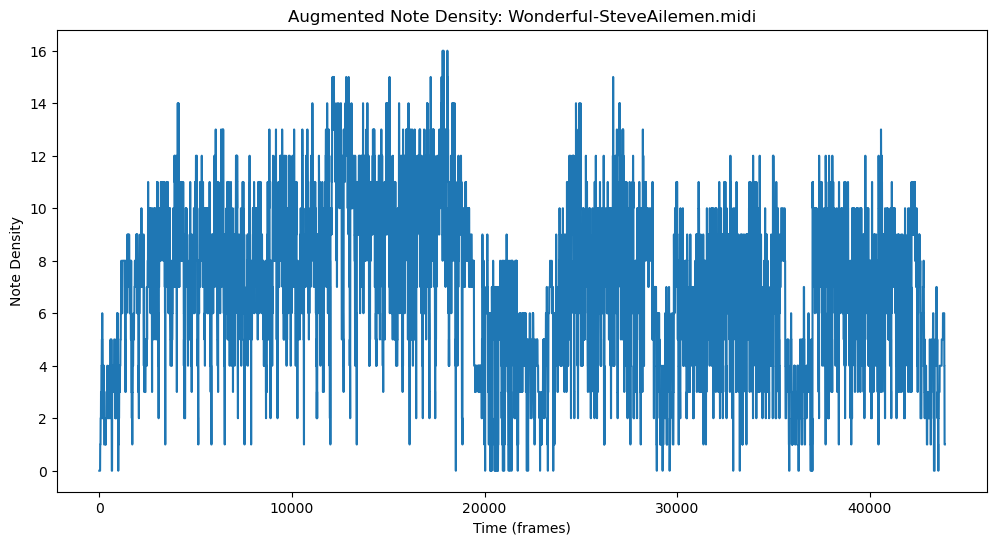

Visualizing original MIDI file: EuroPopOrgan-SteveAilemen.midi


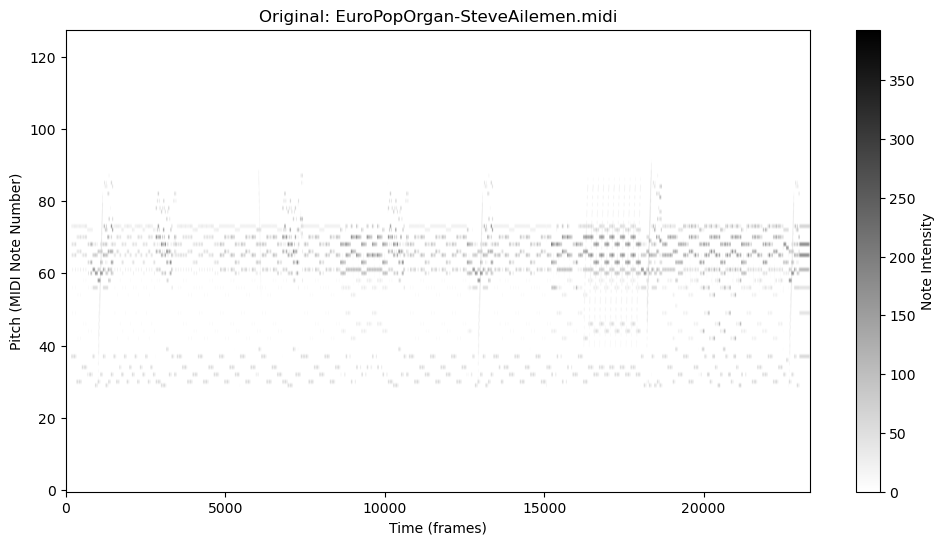

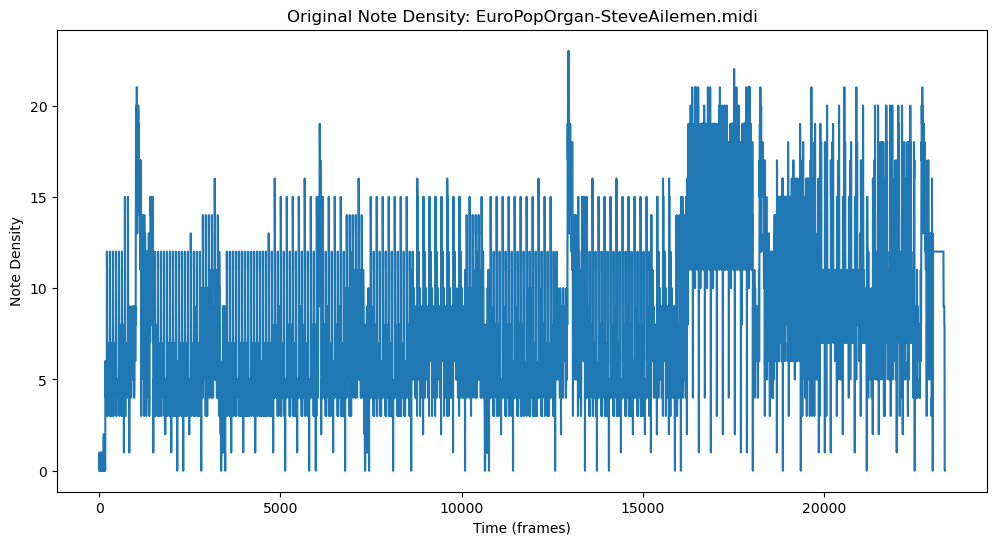

Visualizing augmented MIDI file: EuroPopOrgan-SteveAilemen.midi


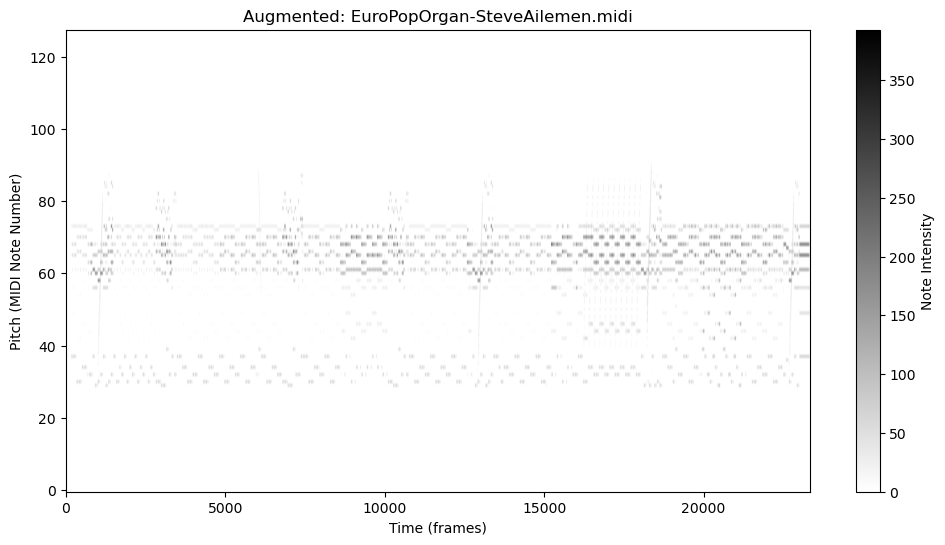

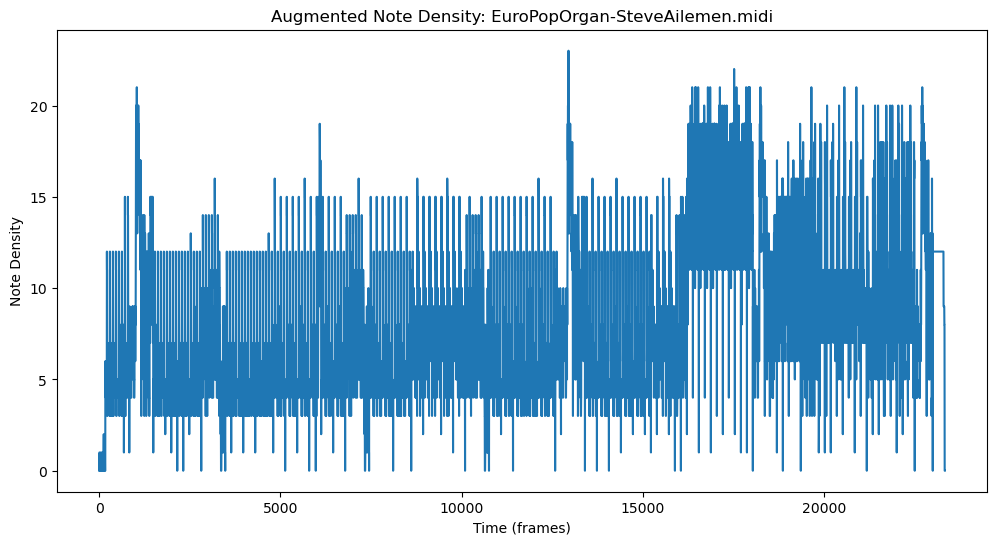

Visualizing original MIDI file: StandardPop-SteveAilemen.midi


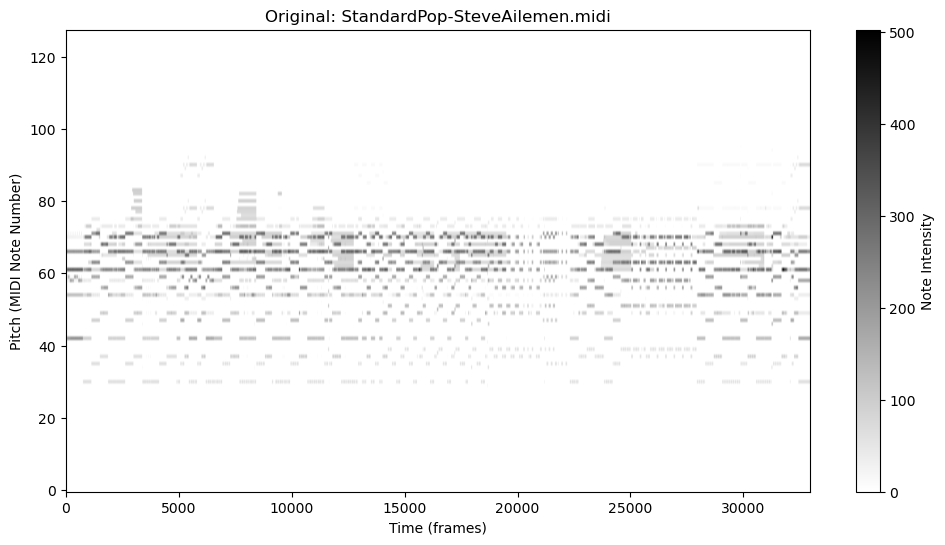

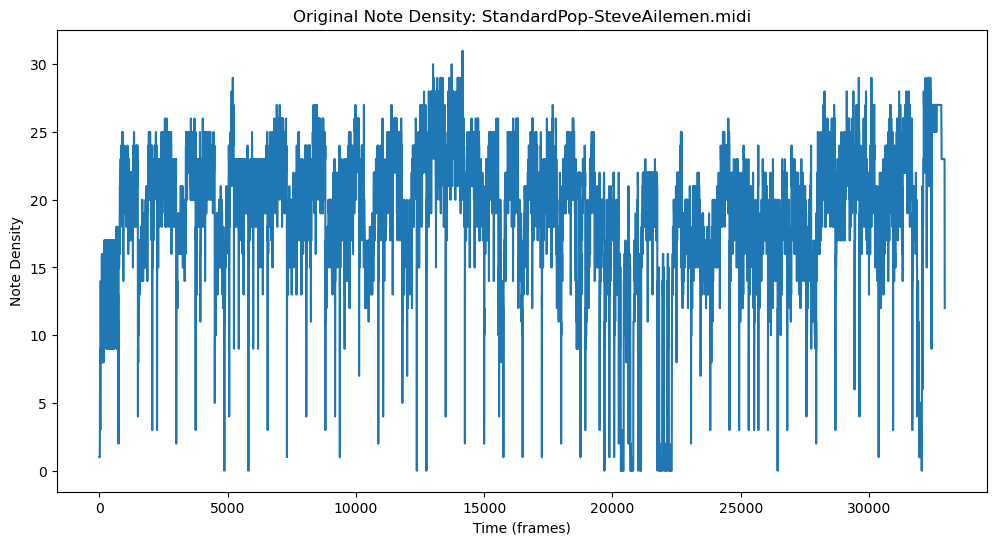

Visualizing augmented MIDI file: StandardPop-SteveAilemen.midi


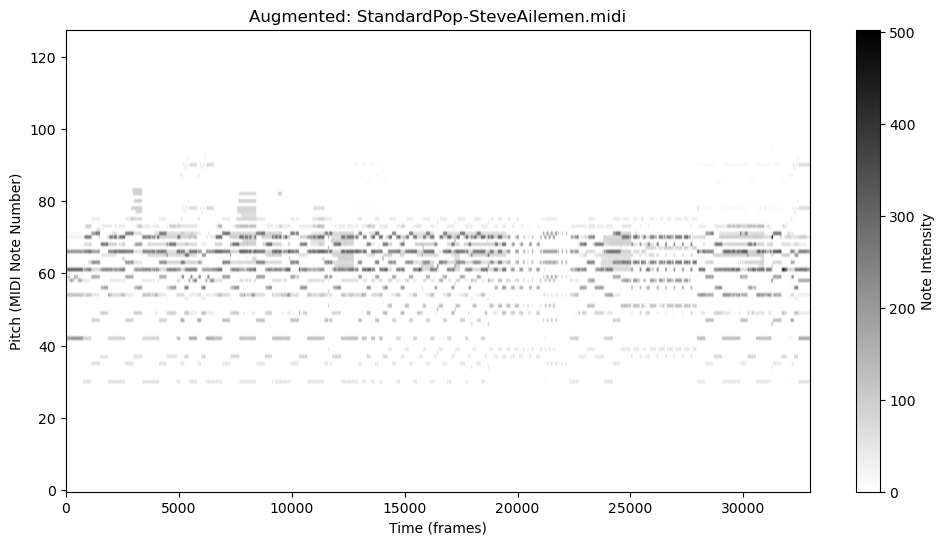

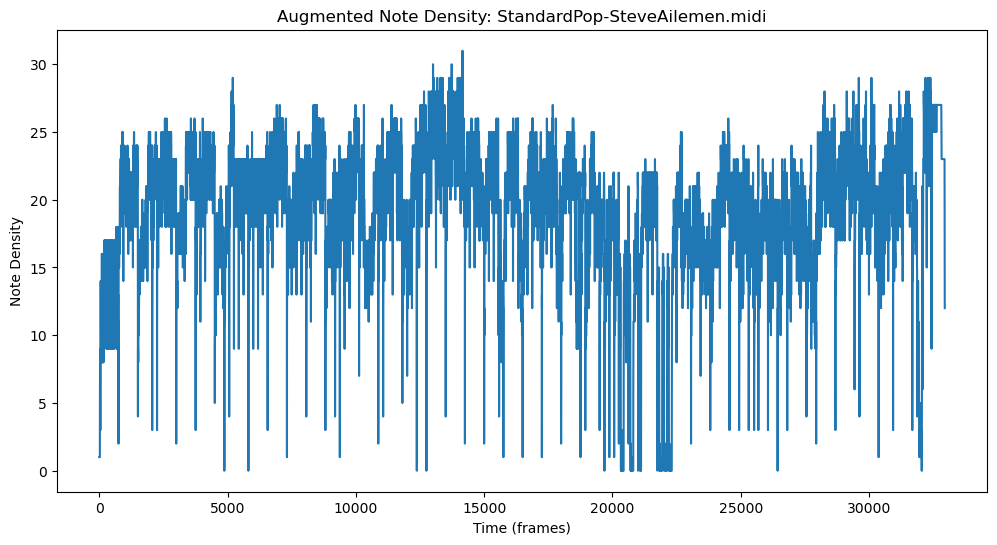

Visualizing original MIDI file: Kossa-SteveAilemen.midi


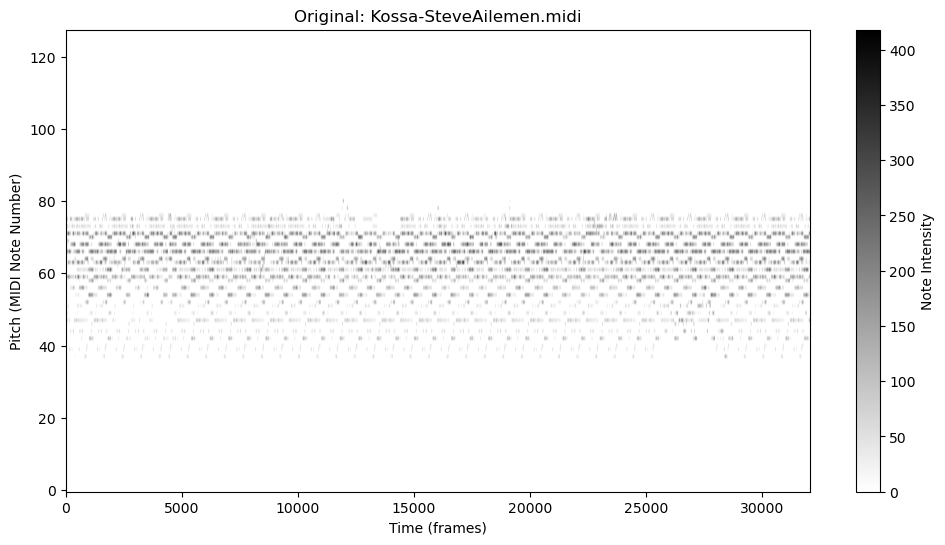

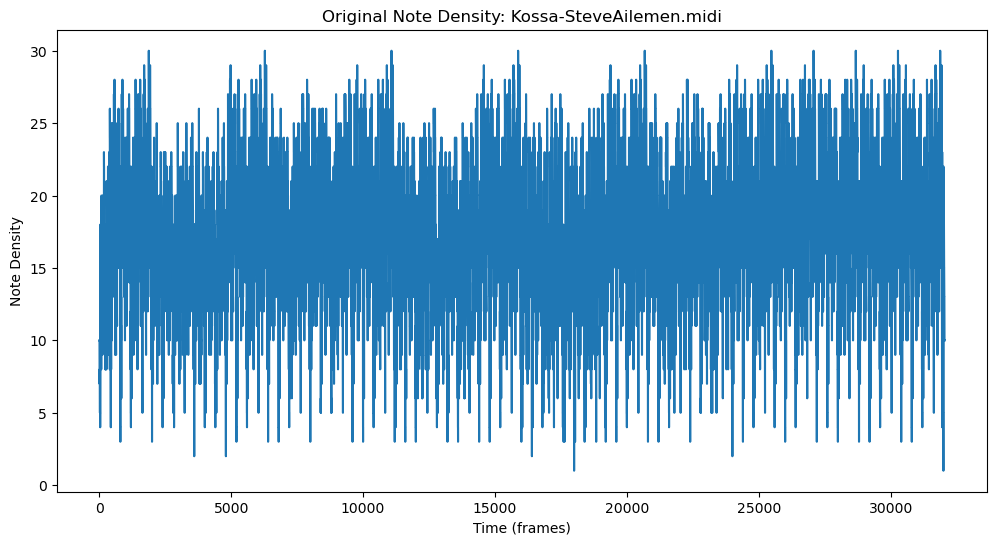

Visualizing augmented MIDI file: Kossa-SteveAilemen.midi


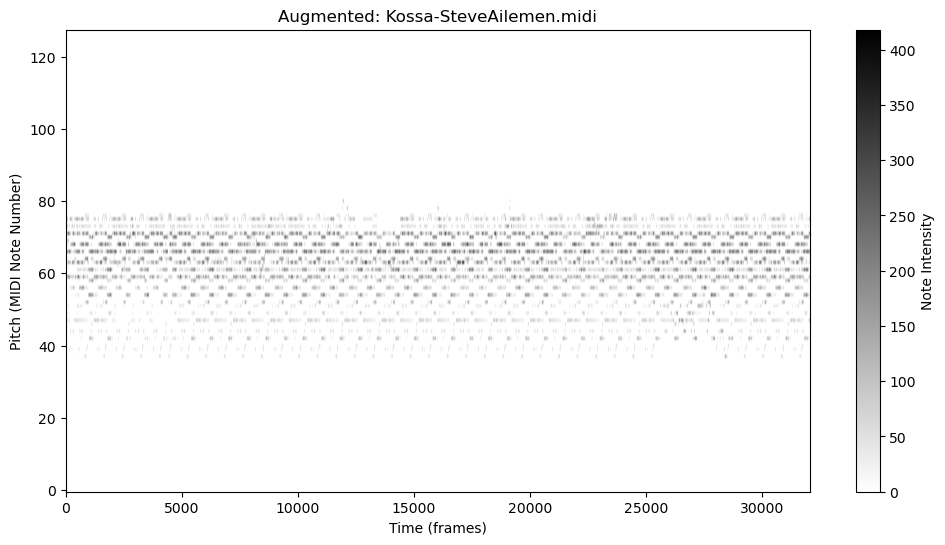

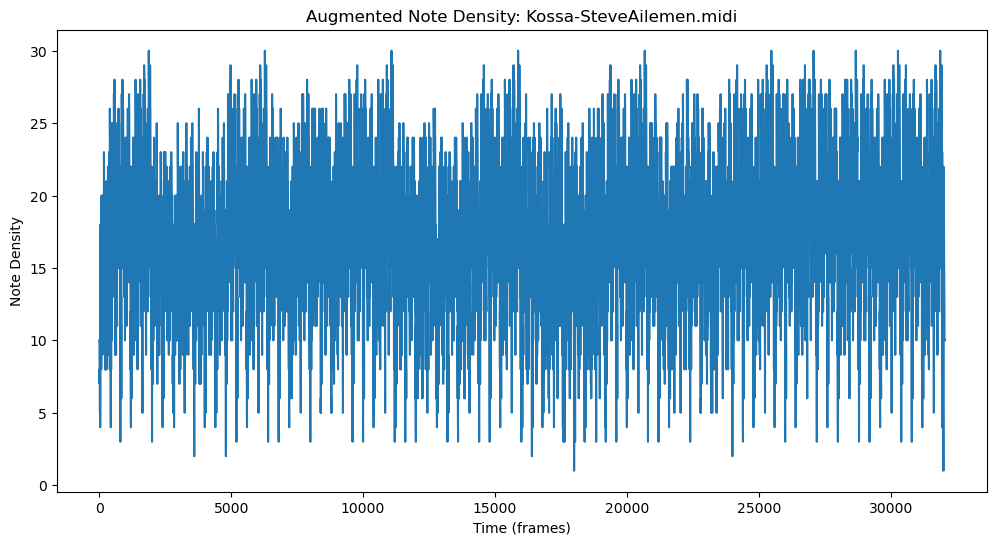

Visualizing original MIDI file: Oruko-Jesu-Lo-Morimi-Wu-SteveAilemen.midi


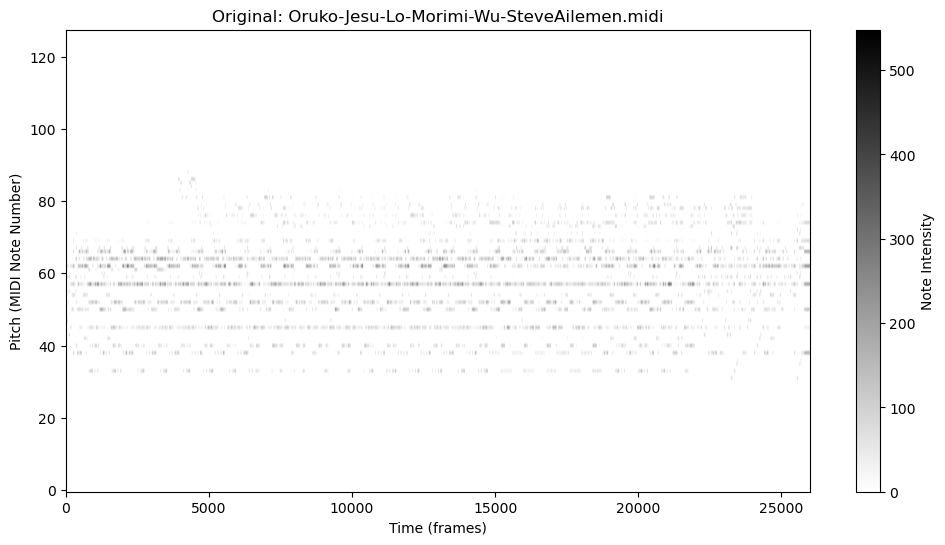

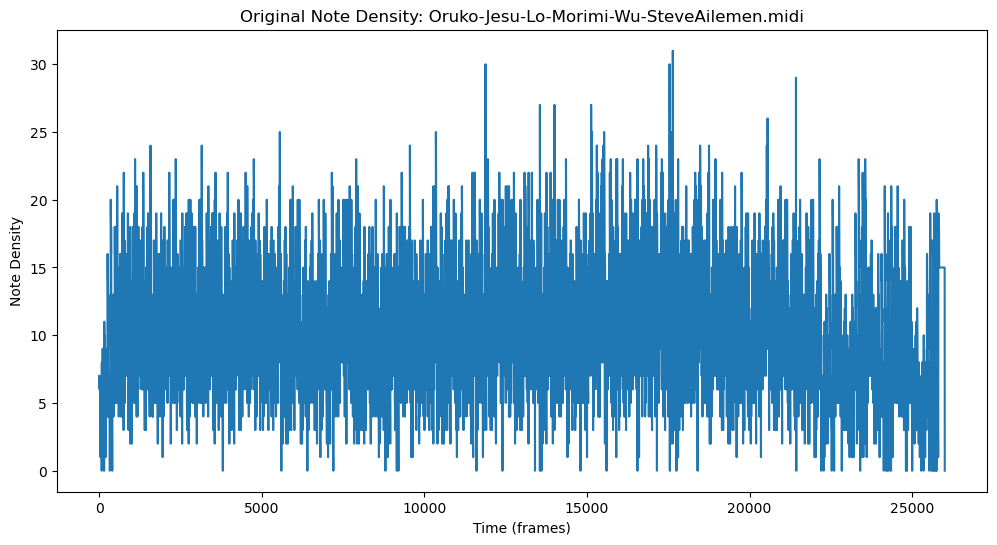

Visualizing augmented MIDI file: Oruko-Jesu-Lo-Morimi-Wu-SteveAilemen.midi


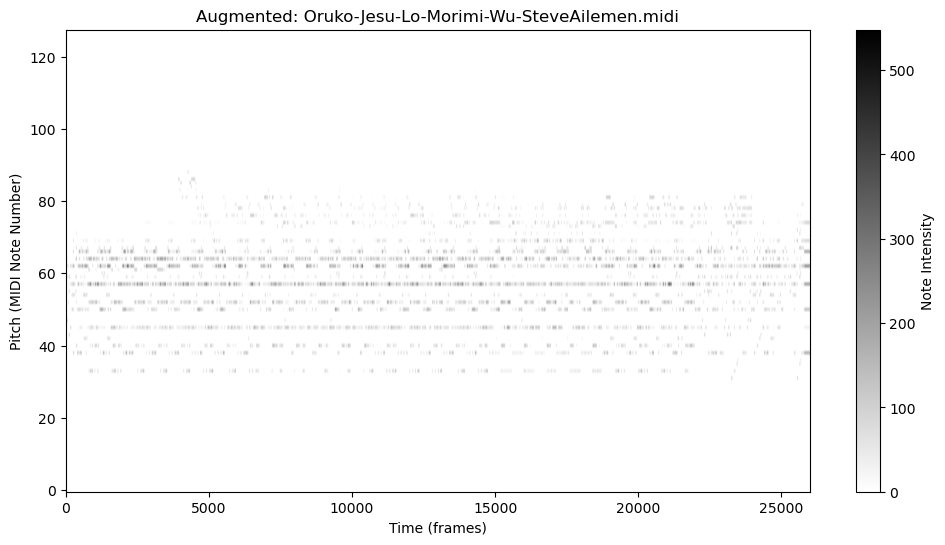

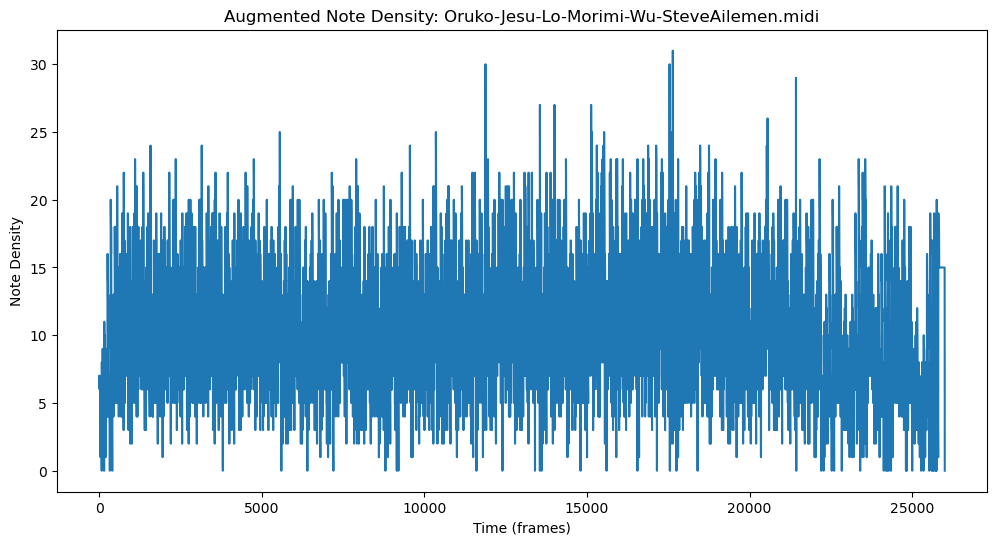

Visualizing original MIDI file: Marimba-SteveAilemen.midi


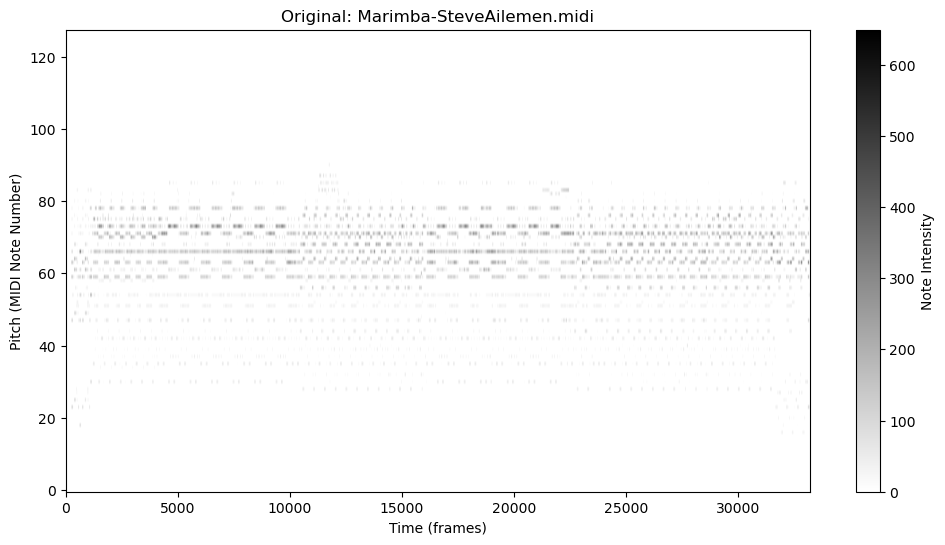

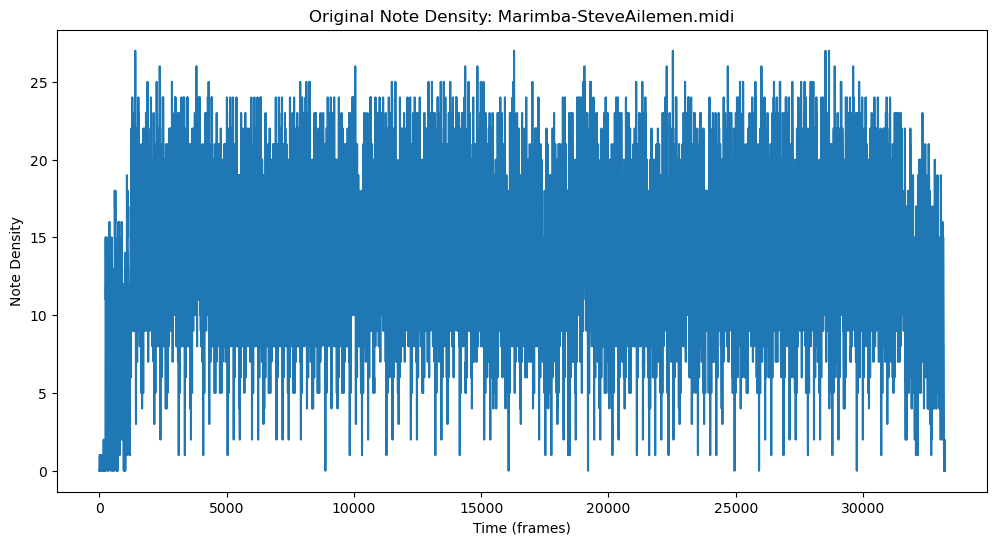

Visualizing augmented MIDI file: Marimba-SteveAilemen.midi


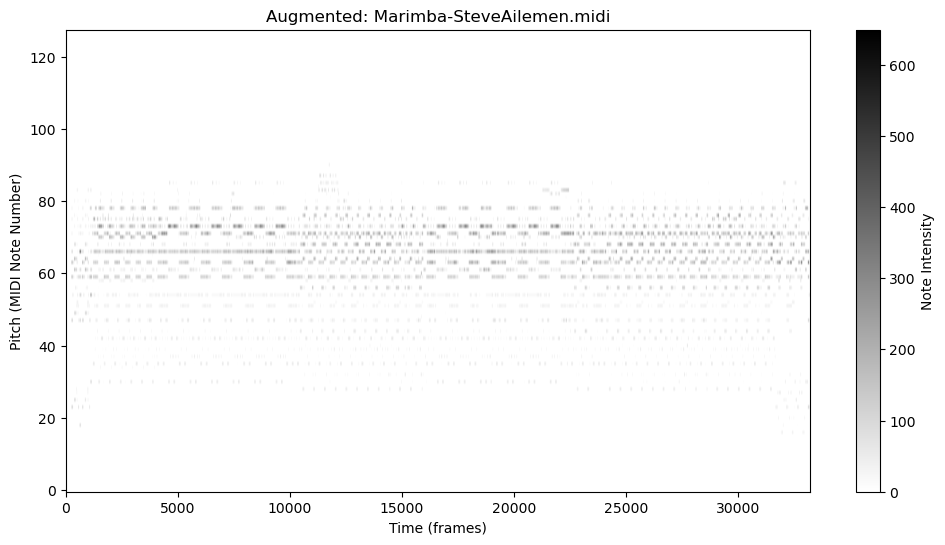

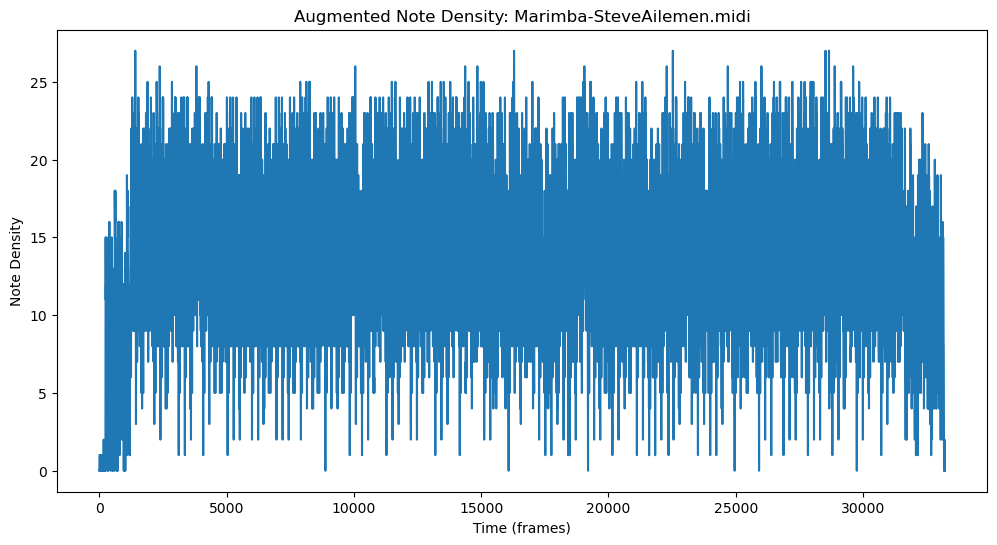

Visualizing original MIDI file: SambaRegae-2-SteveAilemen.midi


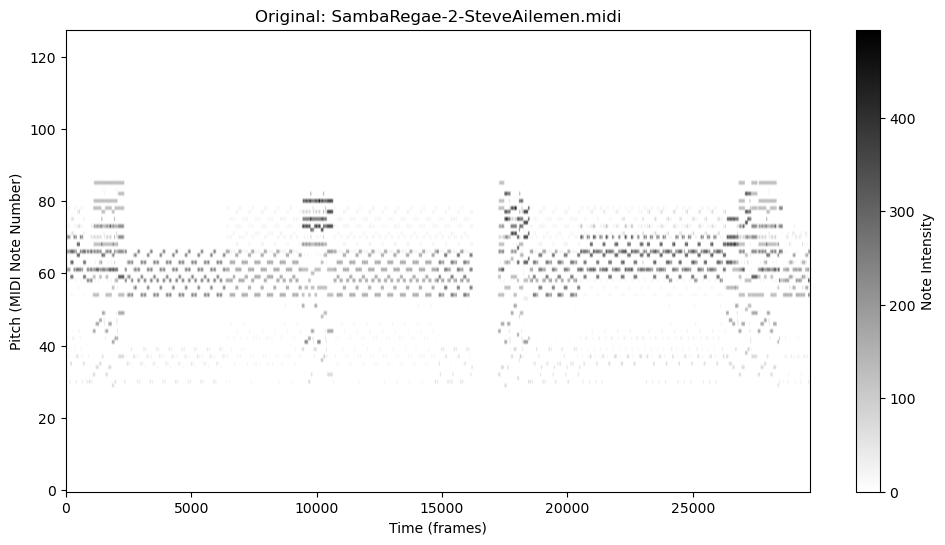

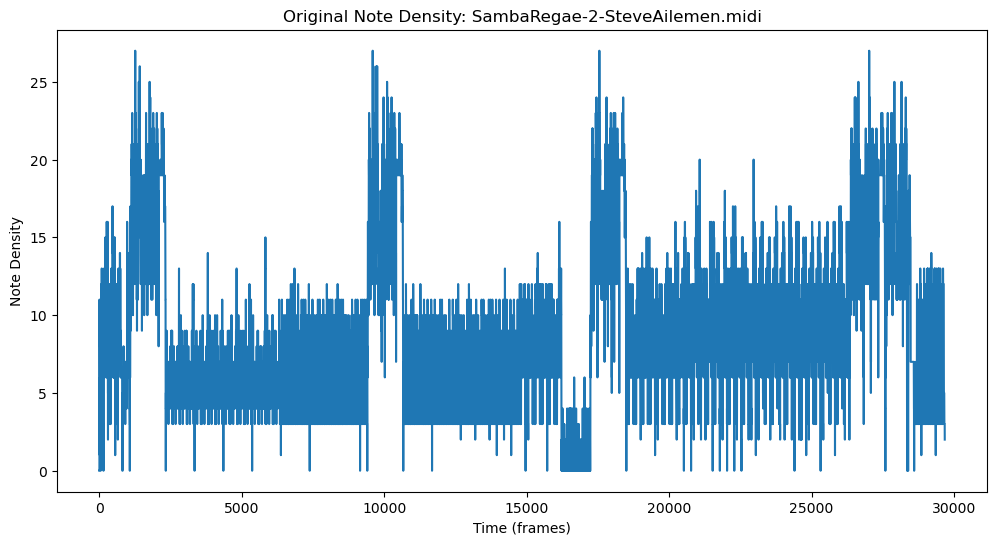

Visualizing augmented MIDI file: SambaRegae-2-SteveAilemen.midi


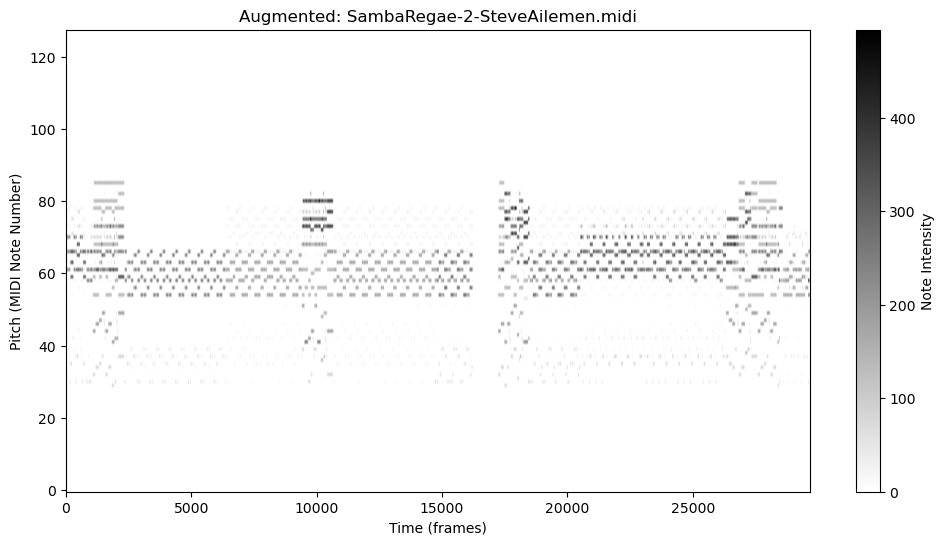

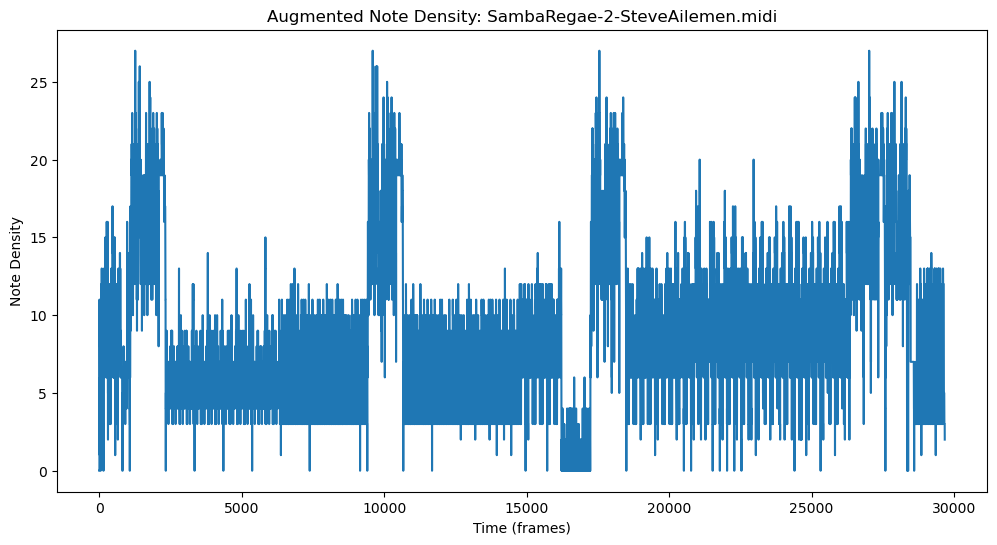

Visualizing original MIDI file: Banquet_Of_Praise_SteveDeRock.midi


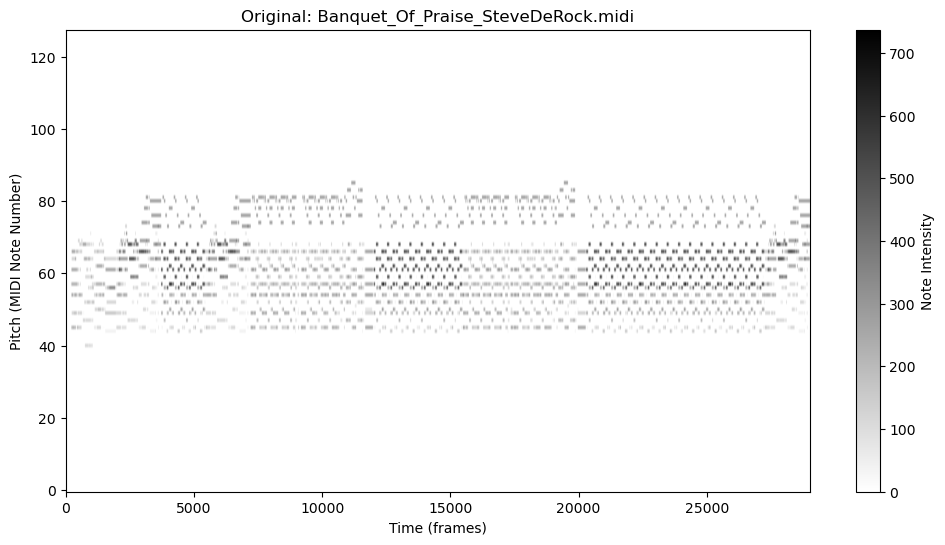

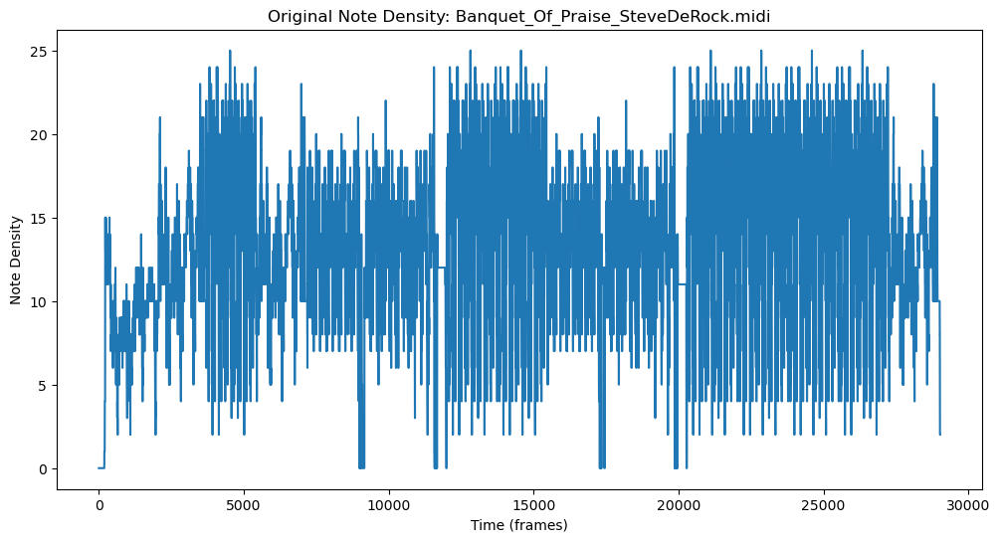

Visualizing augmented MIDI file: Banquet_Of_Praise_SteveDeRock.midi


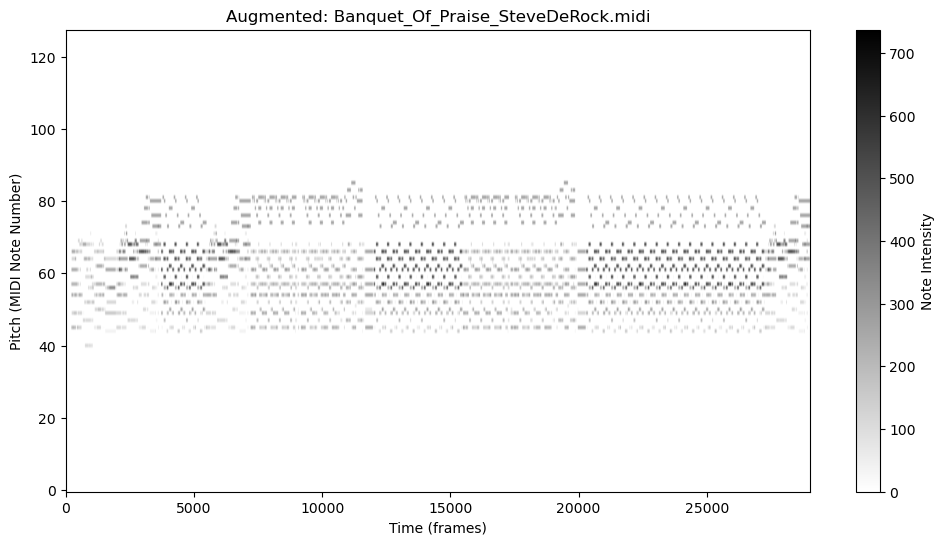

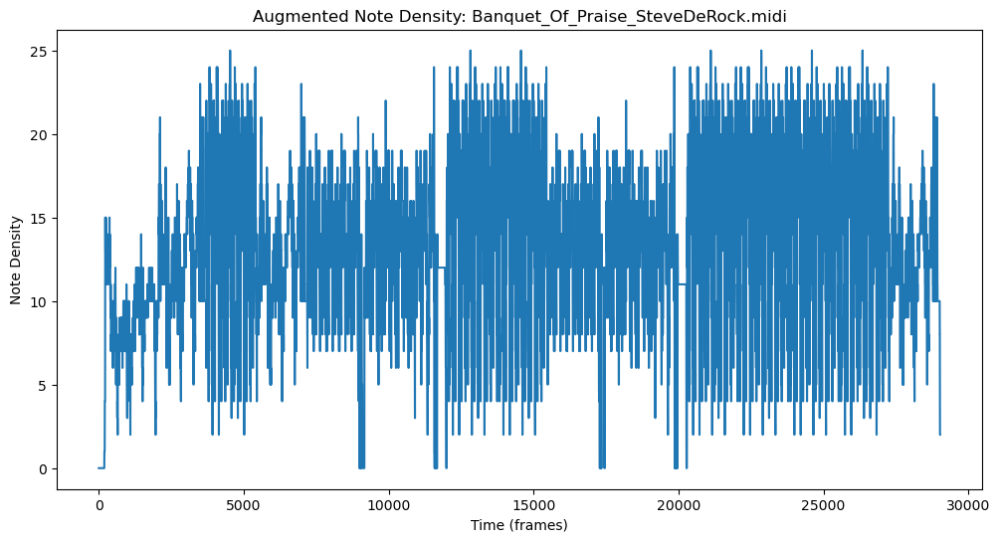

Visualizing original MIDI file: 90sCoolBallad-SteveAilemen.midi


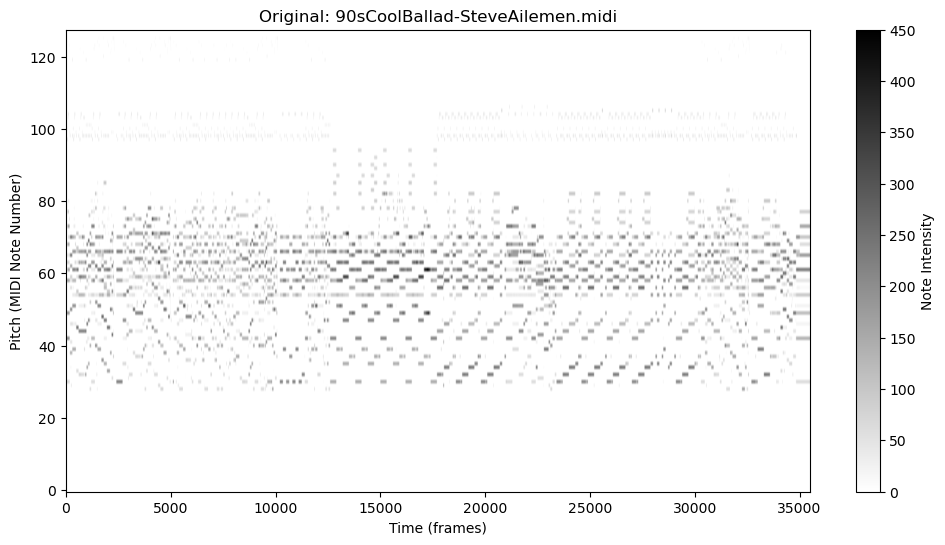

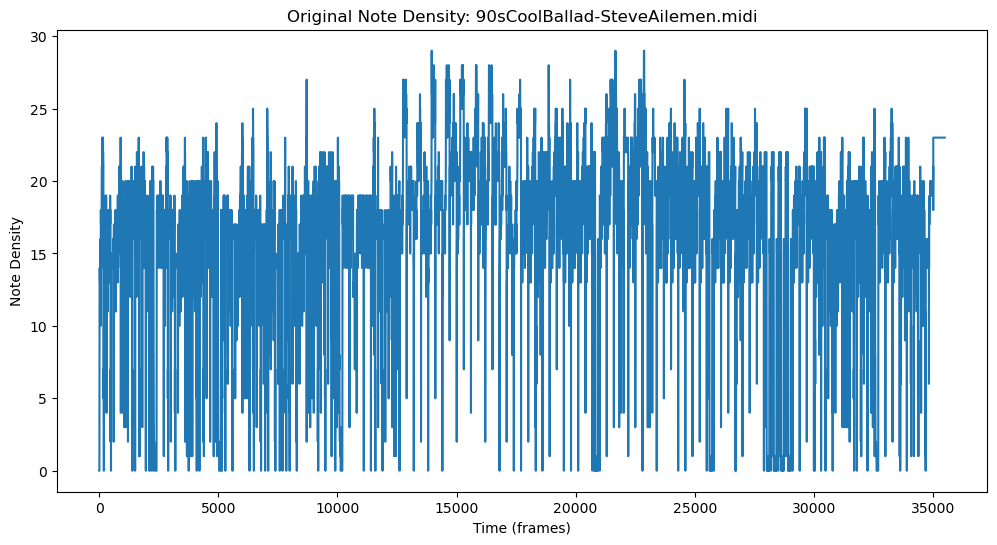

Visualizing augmented MIDI file: 90sCoolBallad-SteveAilemen.midi


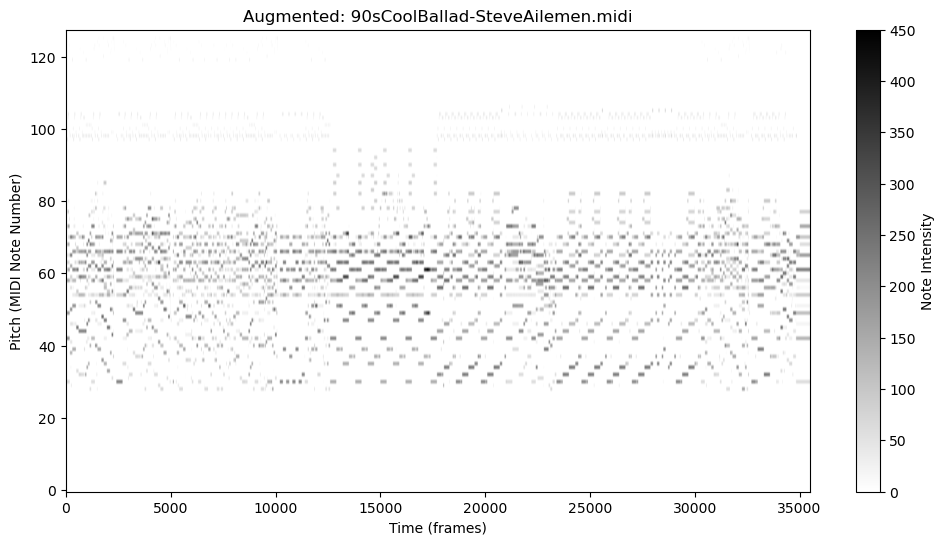

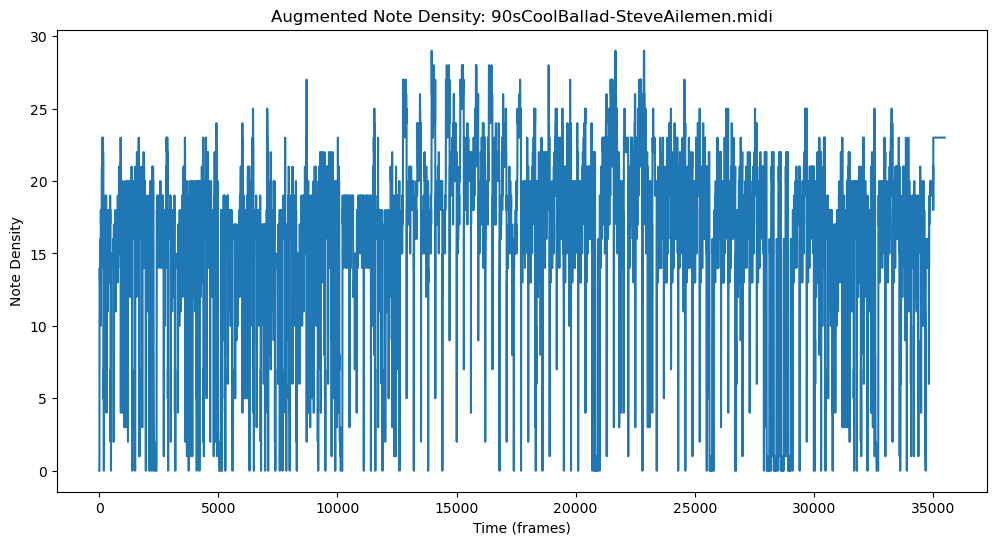

Visualizing original MIDI file: WorshipMedley-SteveAilemen.midi


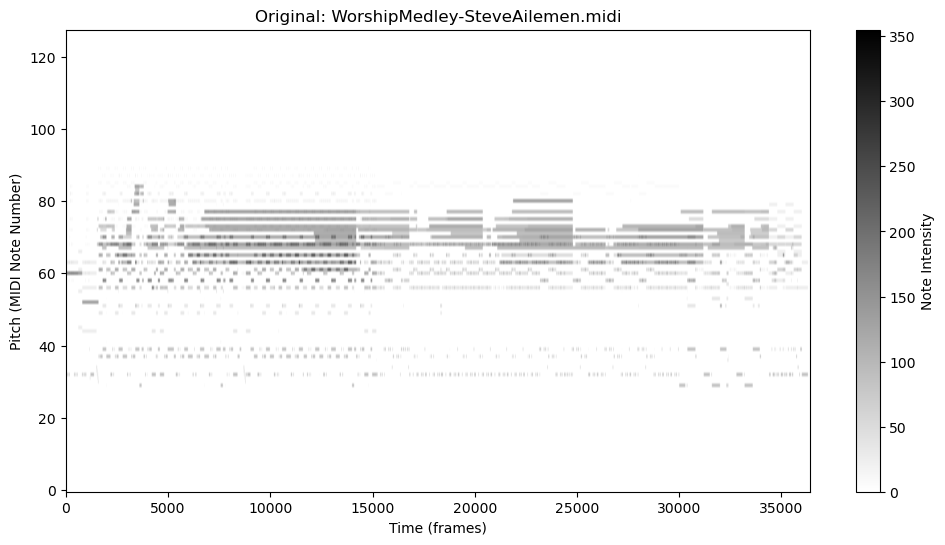

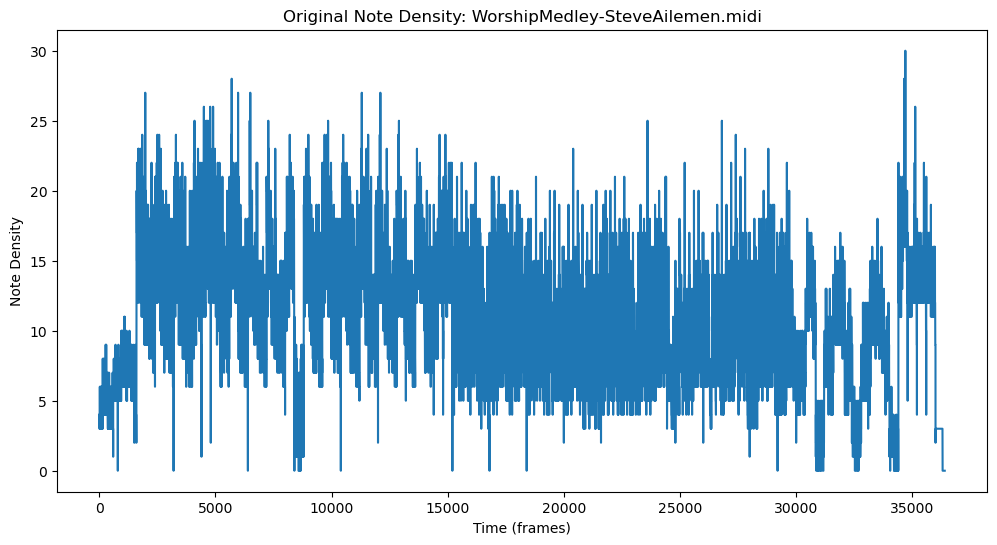

Visualizing augmented MIDI file: WorshipMedley-SteveAilemen.midi


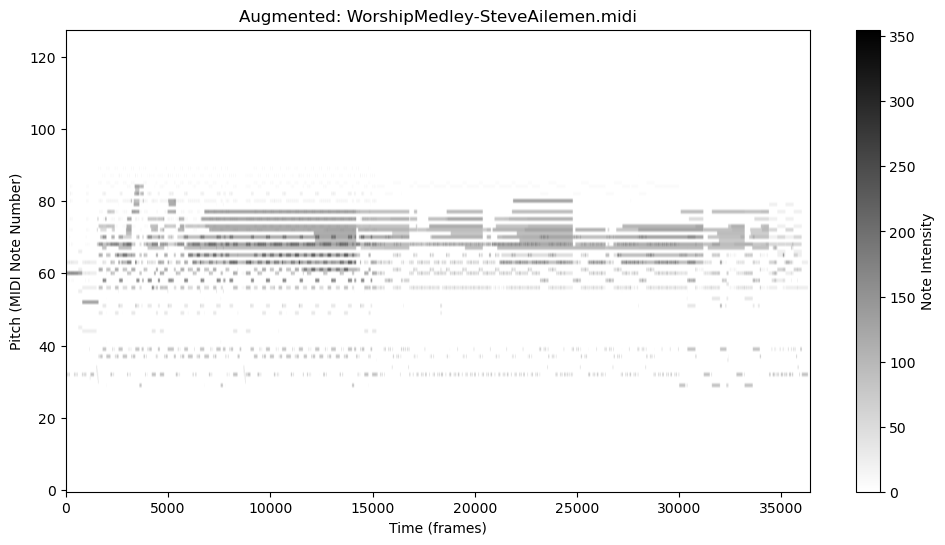

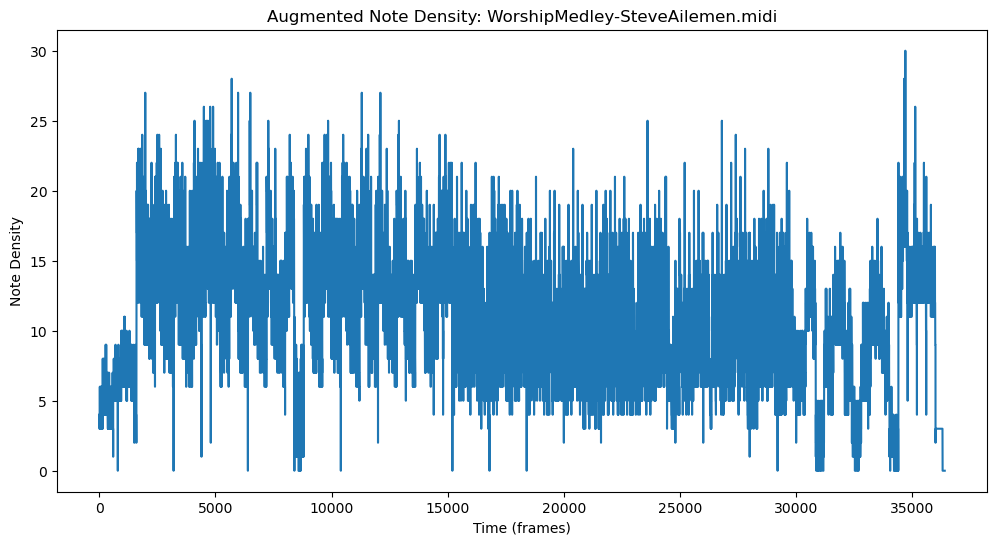

Visualizing original MIDI file: Hoedown-SteveAilemen.midi


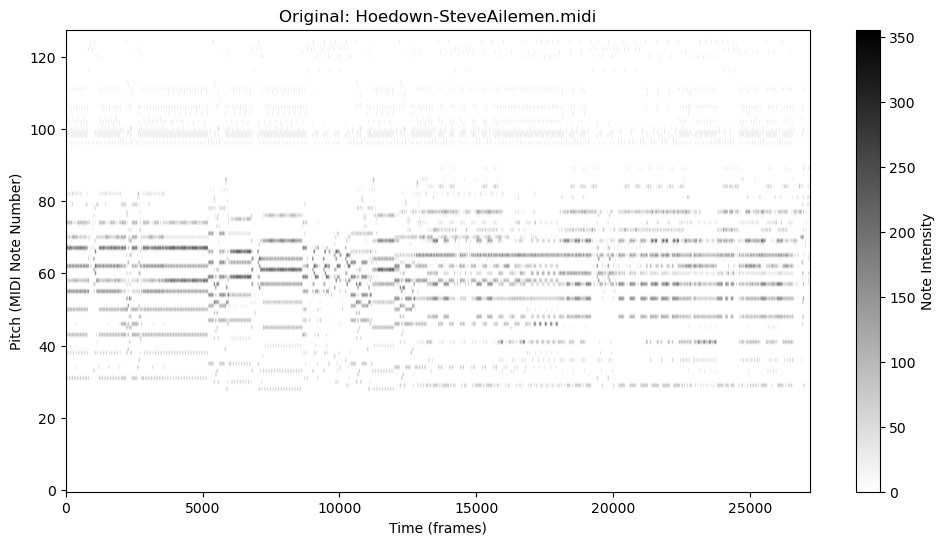

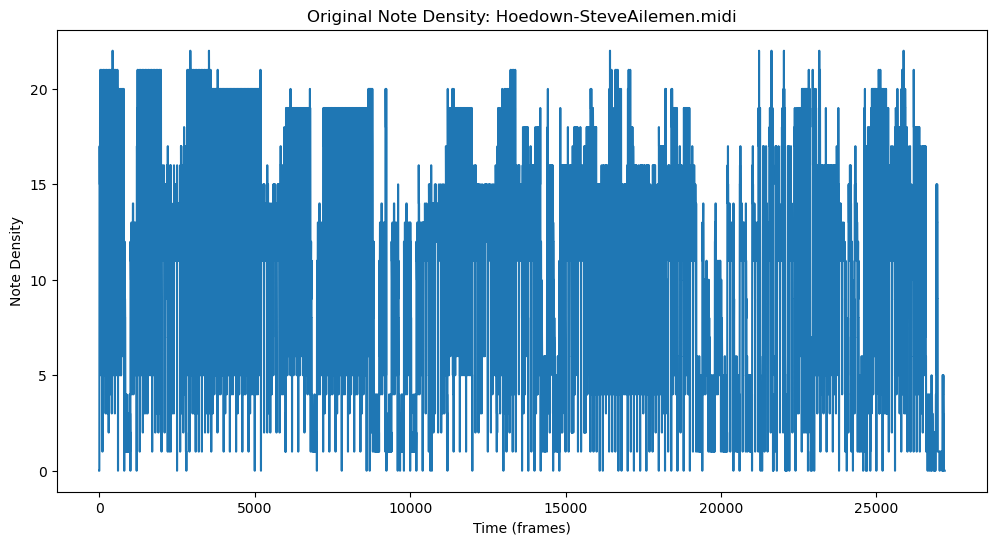

Visualizing augmented MIDI file: Hoedown-SteveAilemen.midi


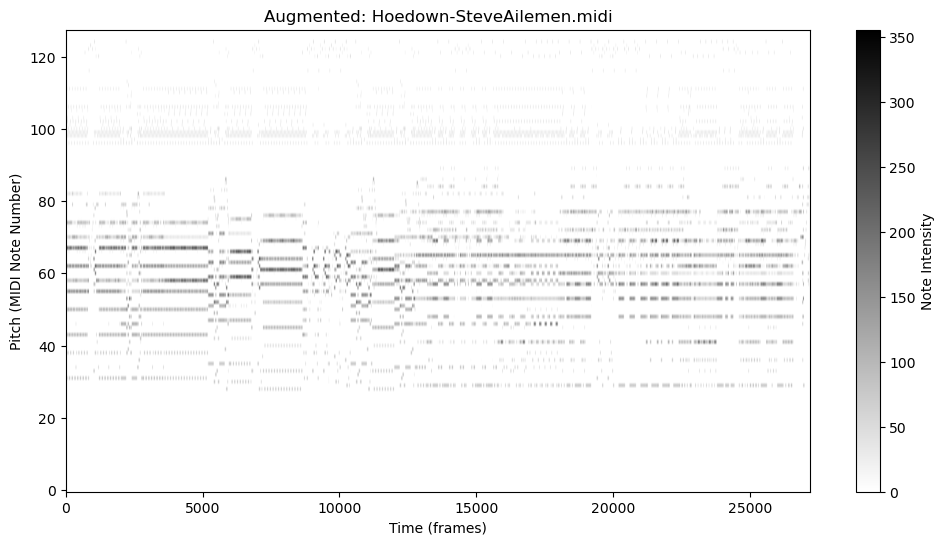

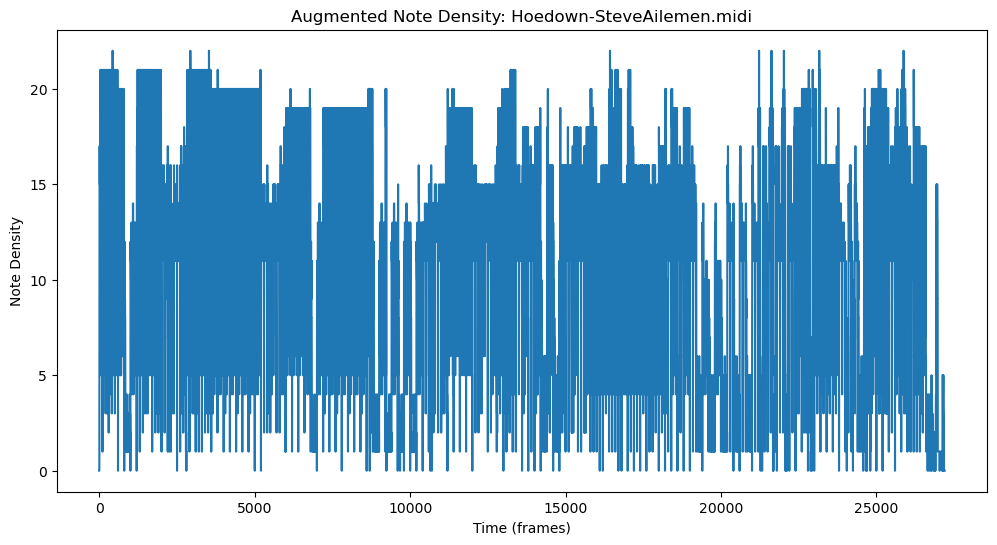

Visualizing original MIDI file: Bluegrass-SteveAilemen.midi


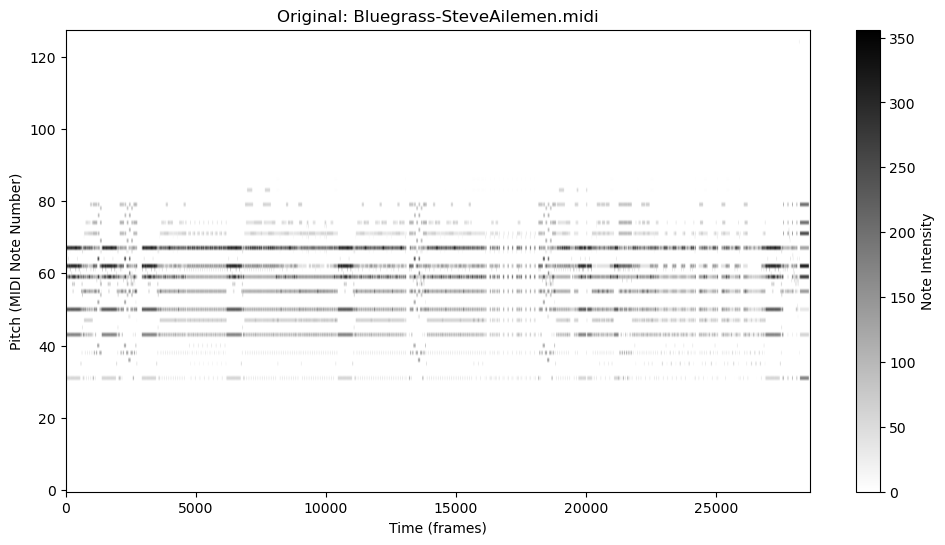

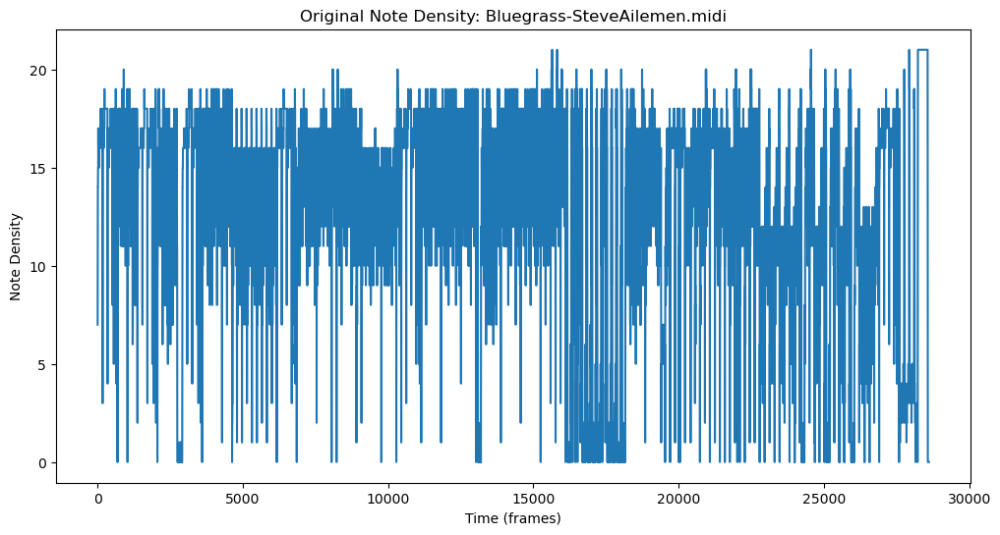

Visualizing augmented MIDI file: Bluegrass-SteveAilemen.midi


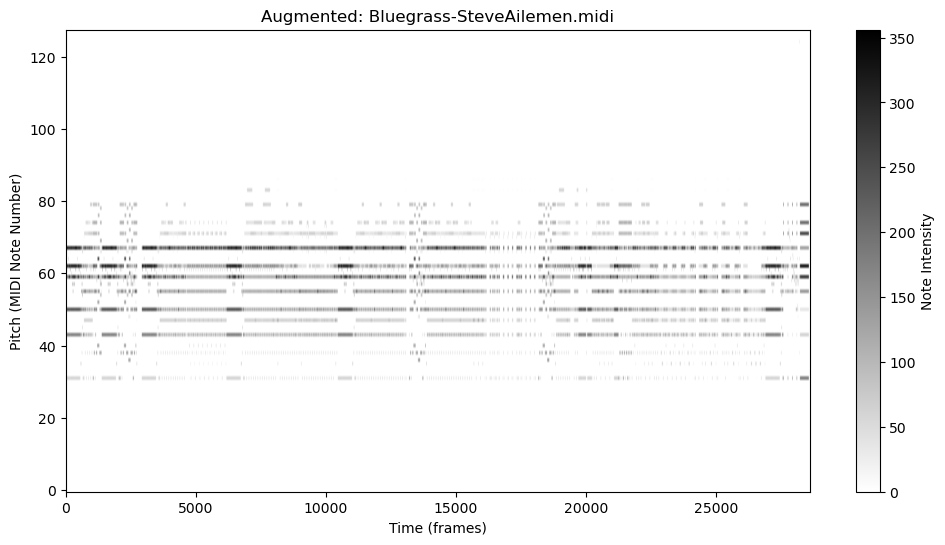

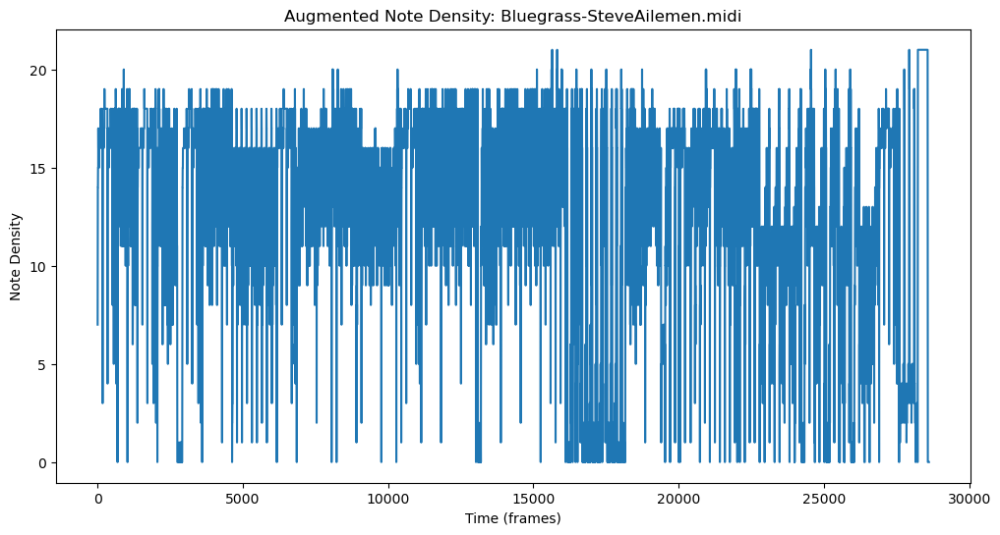

Visualizing original MIDI file: Musc-SteveAilemen.midi


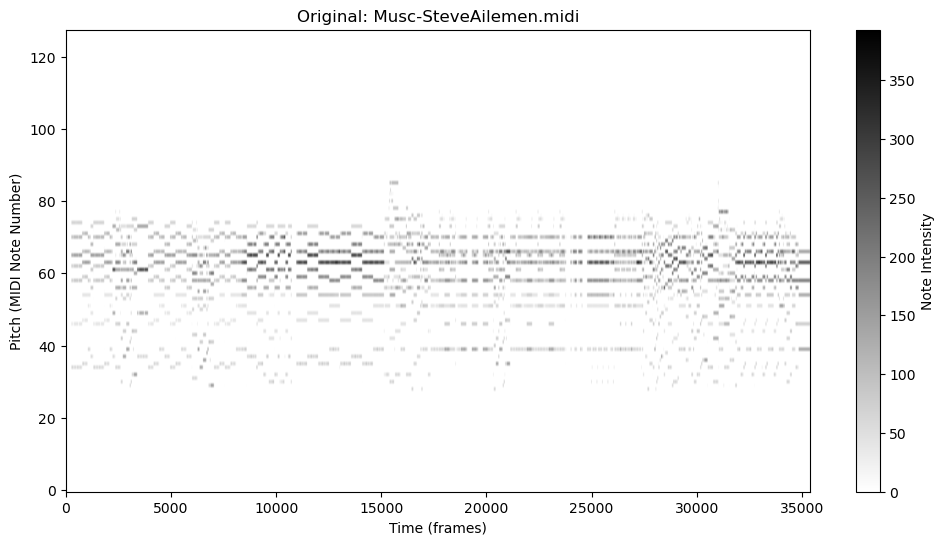

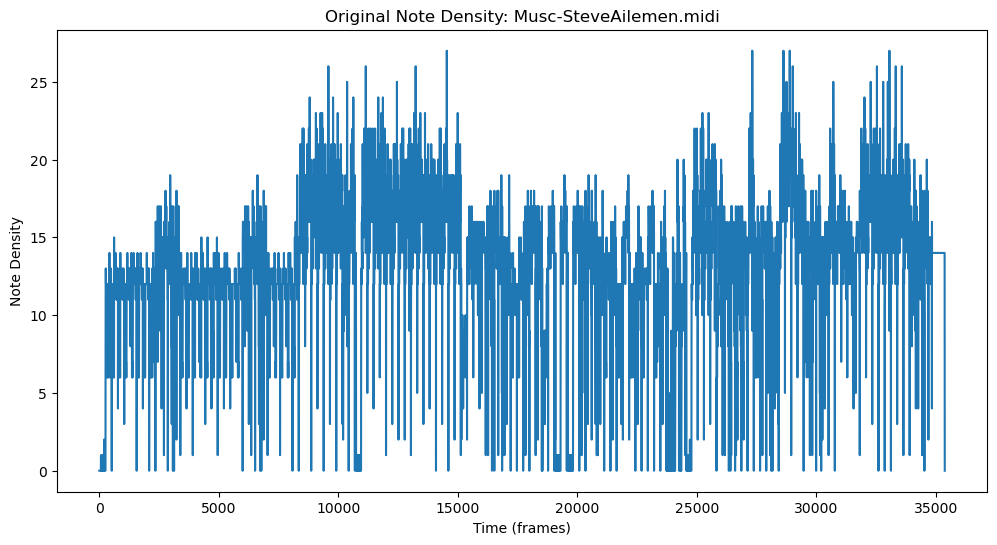

Visualizing augmented MIDI file: Musc-SteveAilemen.midi


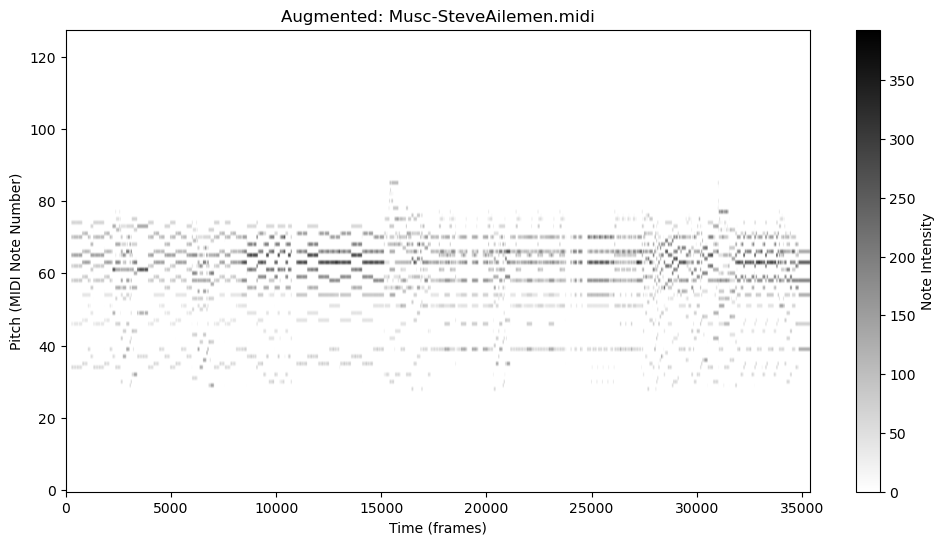

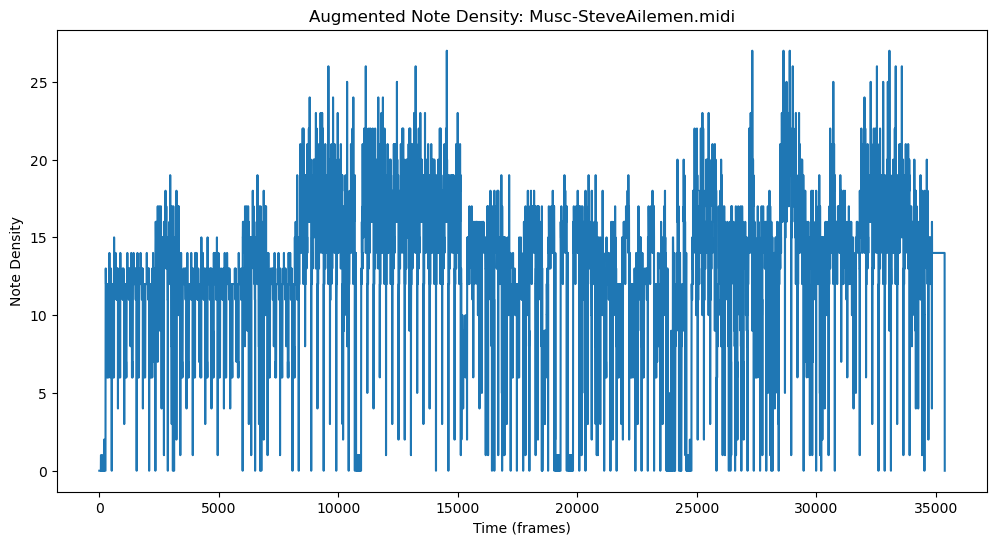

Visualizing original MIDI file: How-Many-Miles-More-SteveAilemen.mid


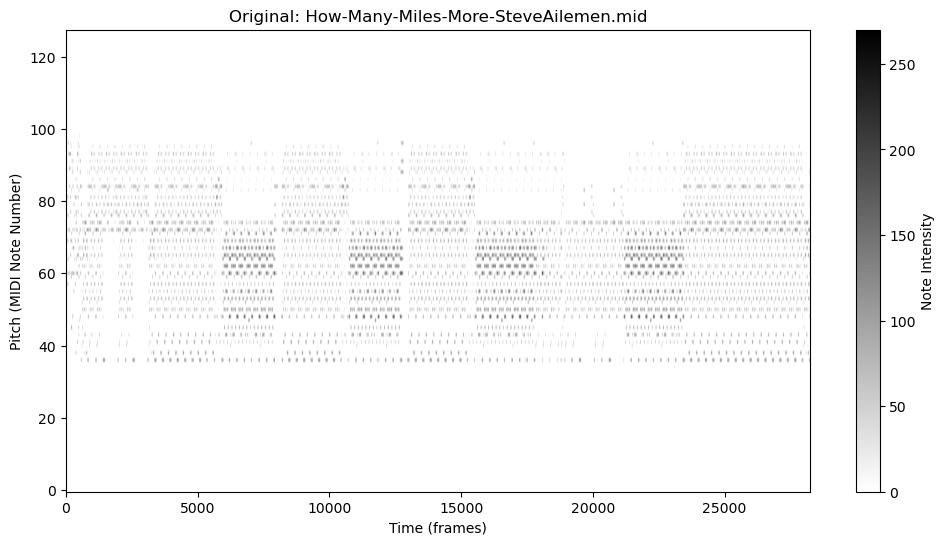

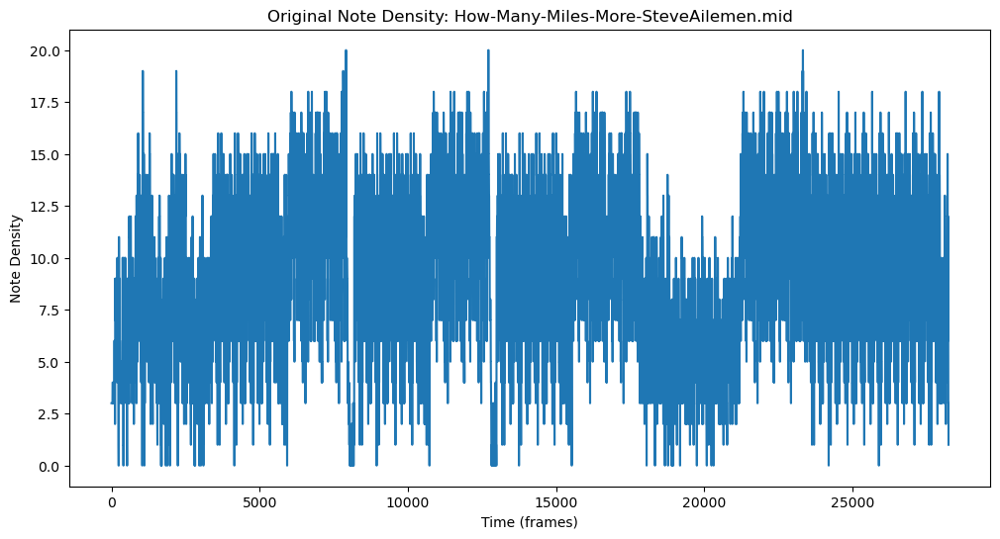

Visualizing augmented MIDI file: How-Many-Miles-More-SteveAilemen.mid


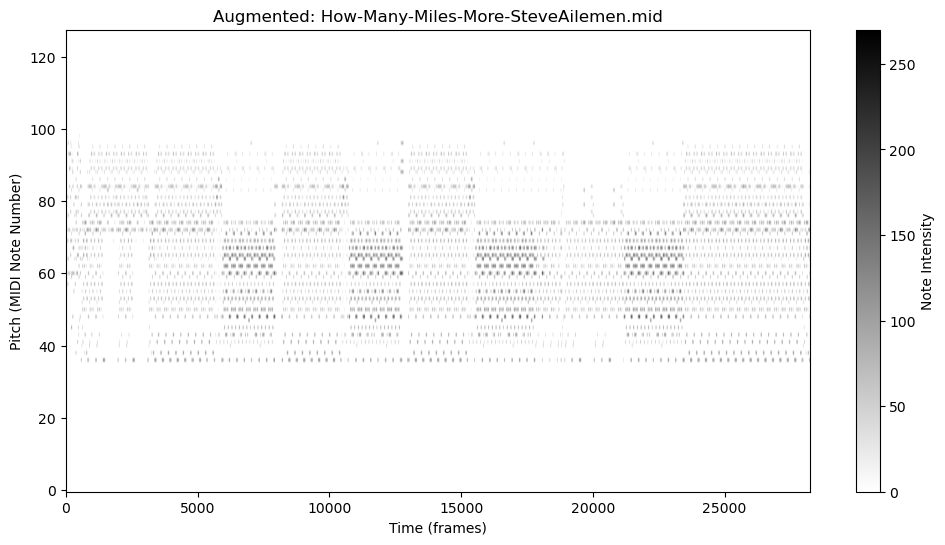

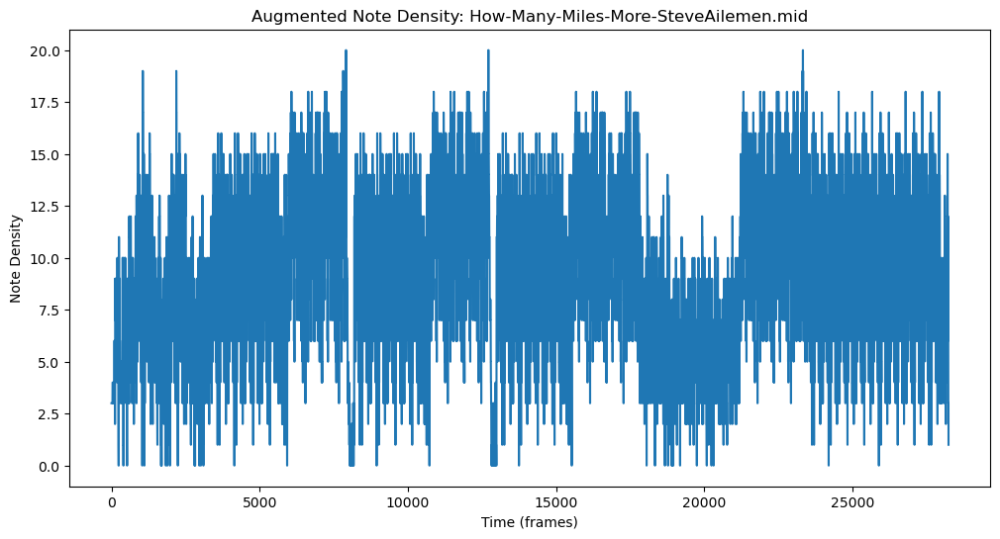

Visualizing original MIDI file: CalypsoMedley-SteveAilemen.midi


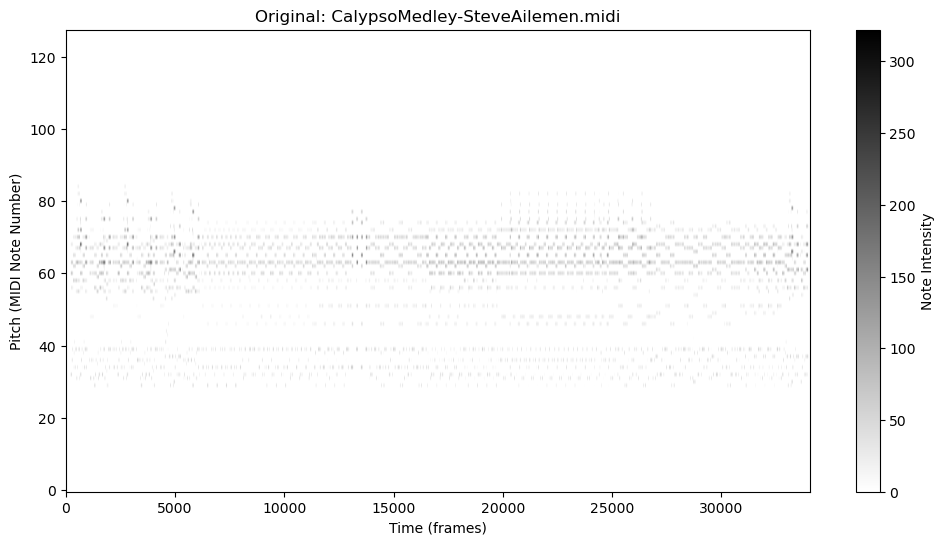

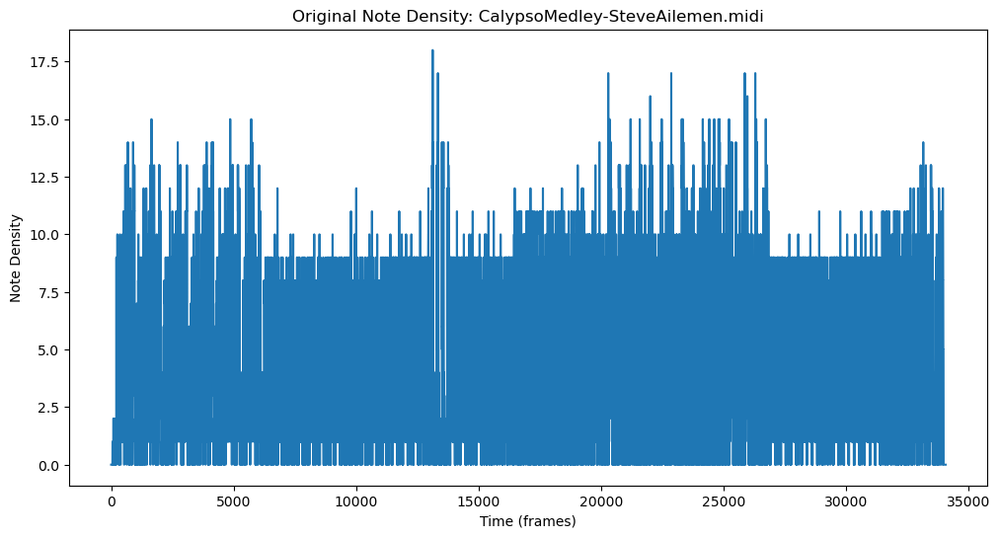

Visualizing augmented MIDI file: CalypsoMedley-SteveAilemen.midi


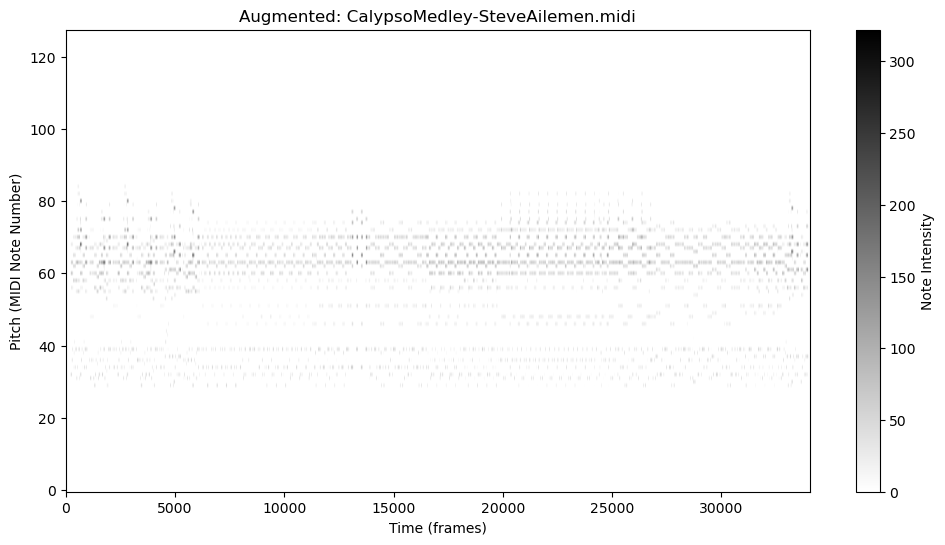

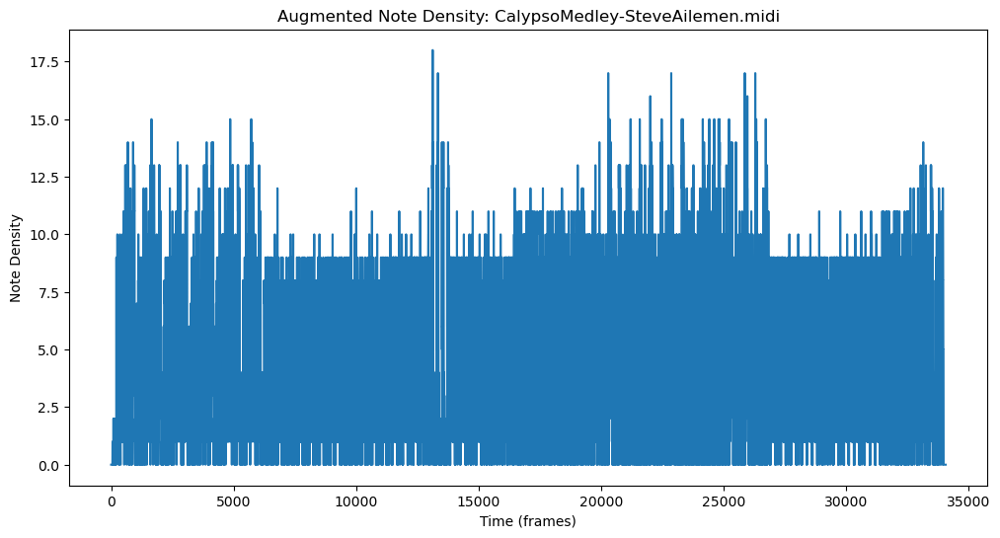

Visualizing original MIDI file: Thank-You-Jesus-SteveAilemen.midi


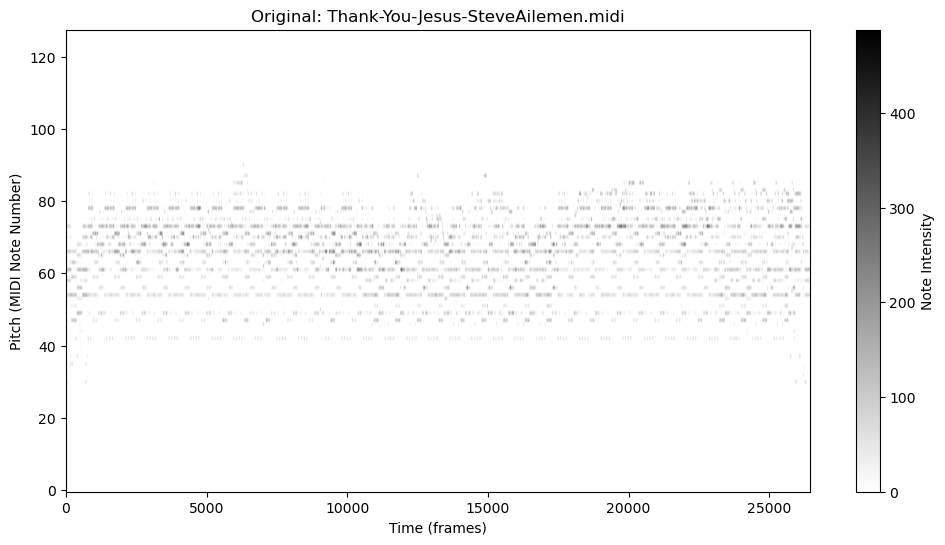

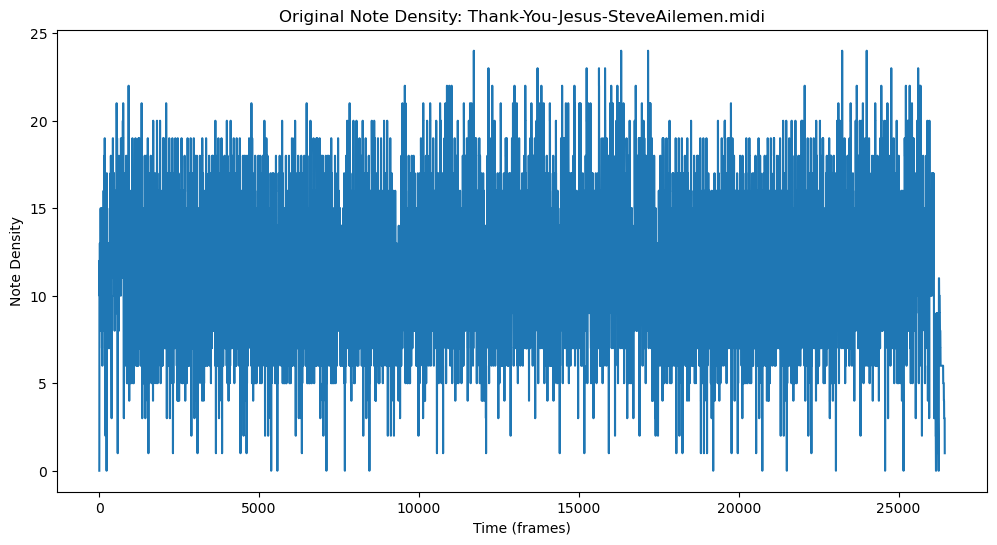

Visualizing augmented MIDI file: Thank-You-Jesus-SteveAilemen.midi


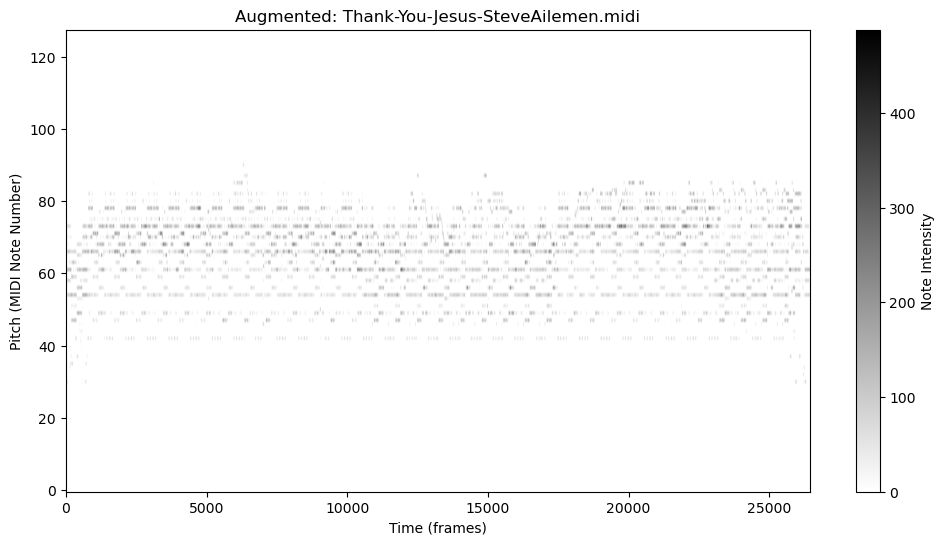

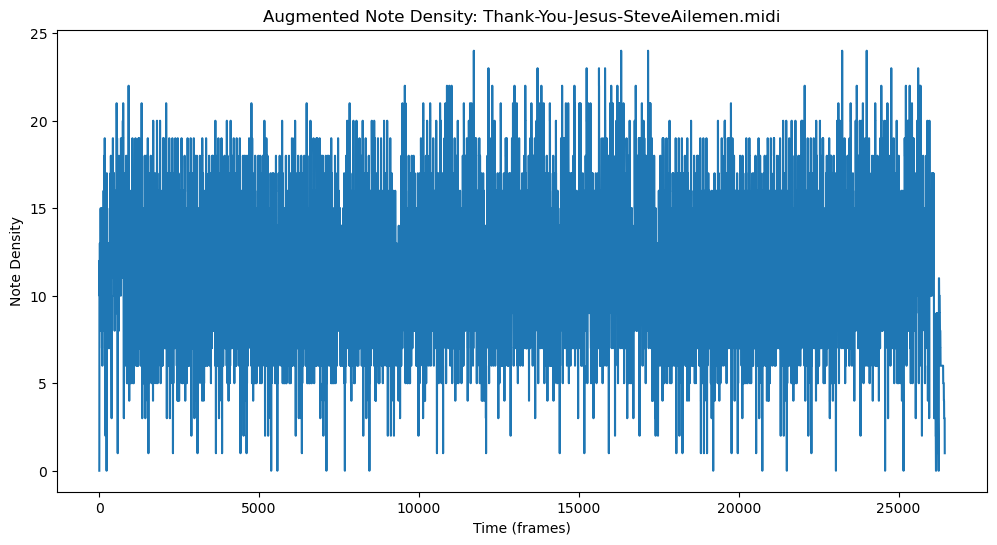

Visualizing original MIDI file: DanceAfro-SteveAilemen.midi


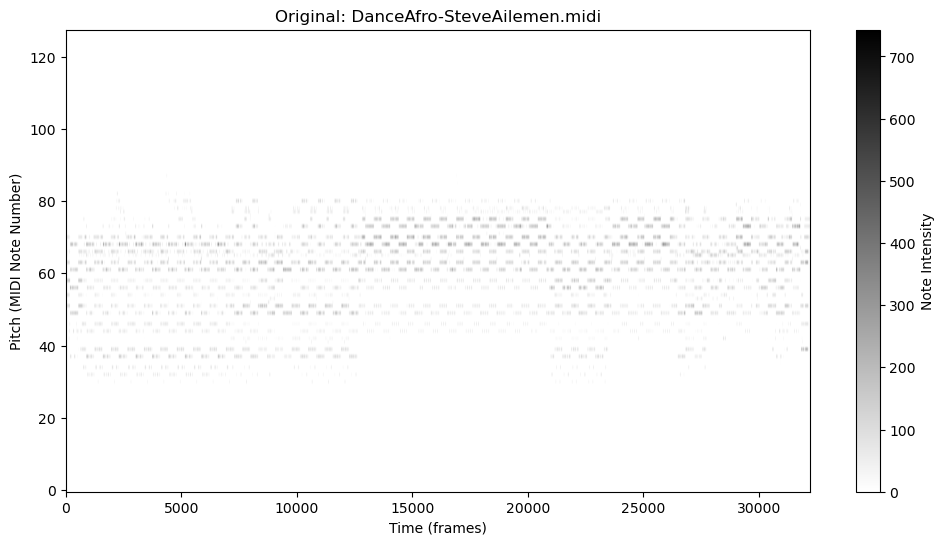

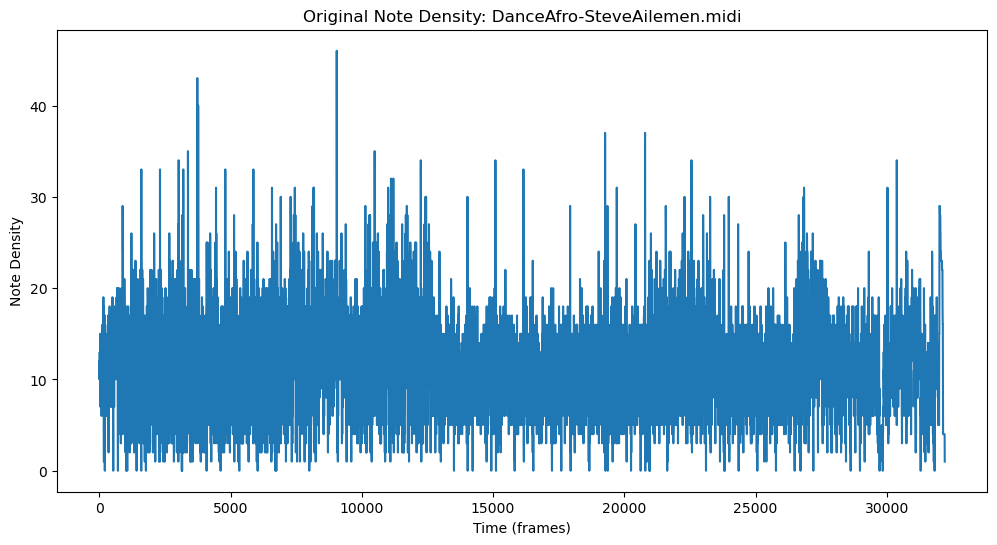

Visualizing augmented MIDI file: DanceAfro-SteveAilemen.midi


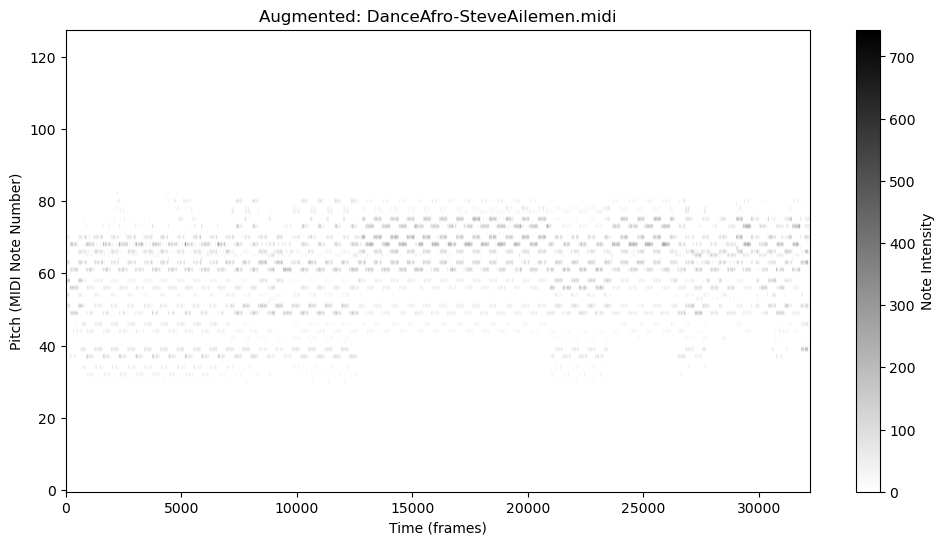

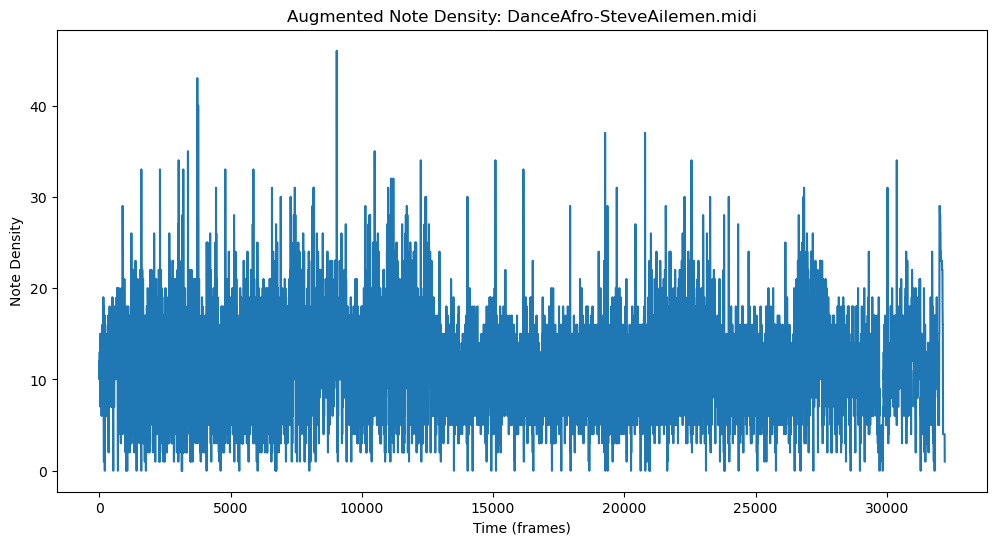

Visualizing original MIDI file: PolkaPop-SteveAilemen.midi


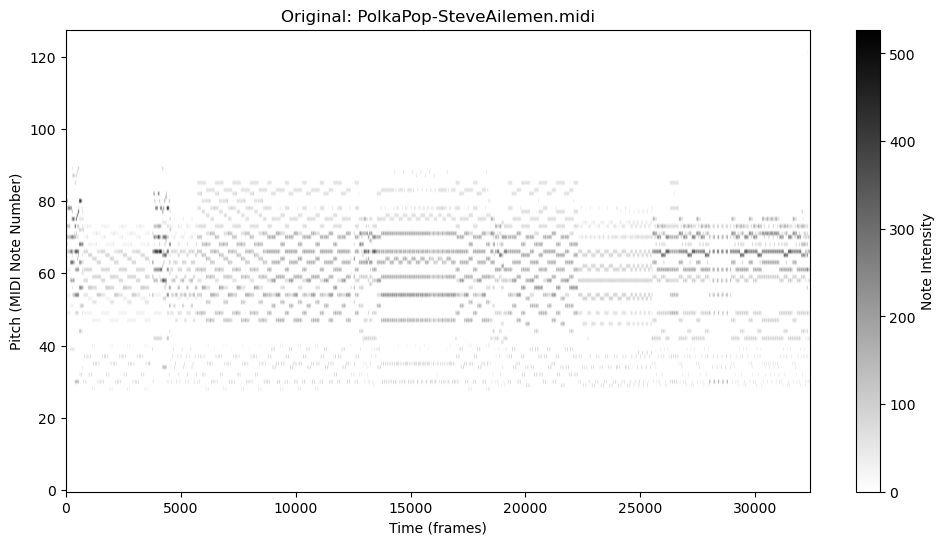

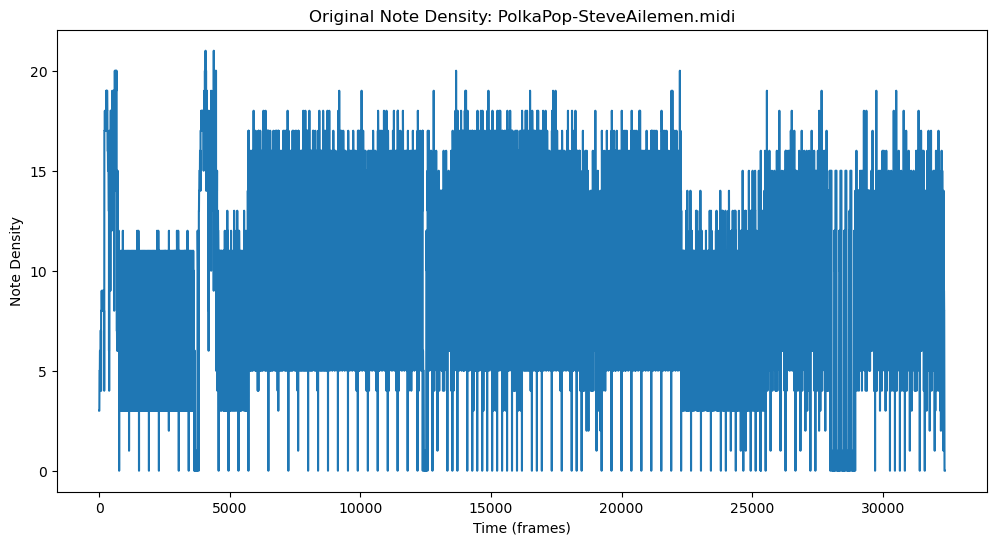

Visualizing augmented MIDI file: PolkaPop-SteveAilemen.midi


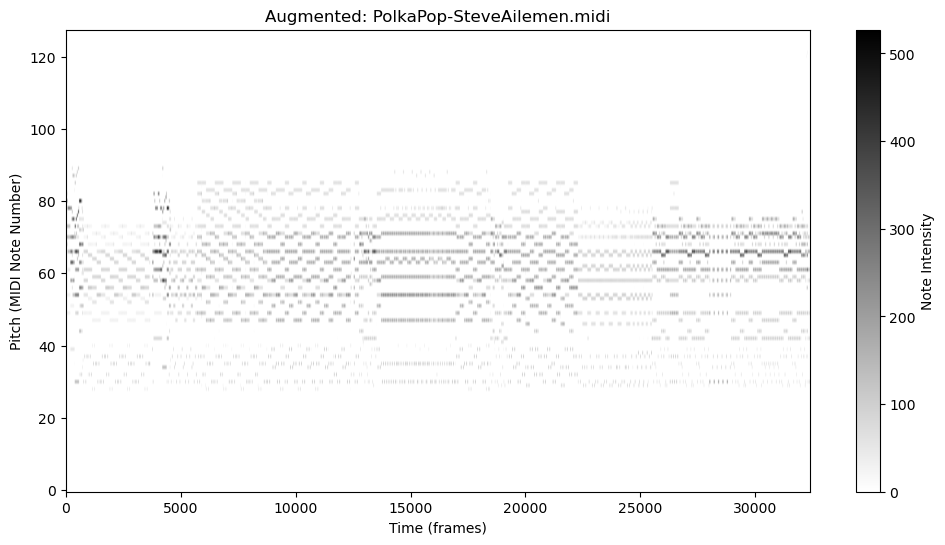

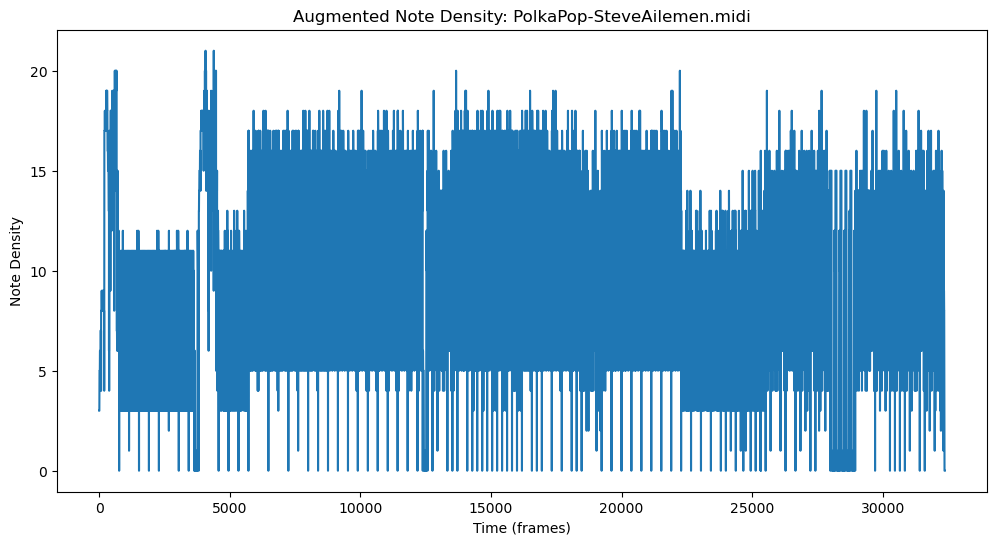

Visualizing original MIDI file: PowerToHeal-SteveAilemen.midi


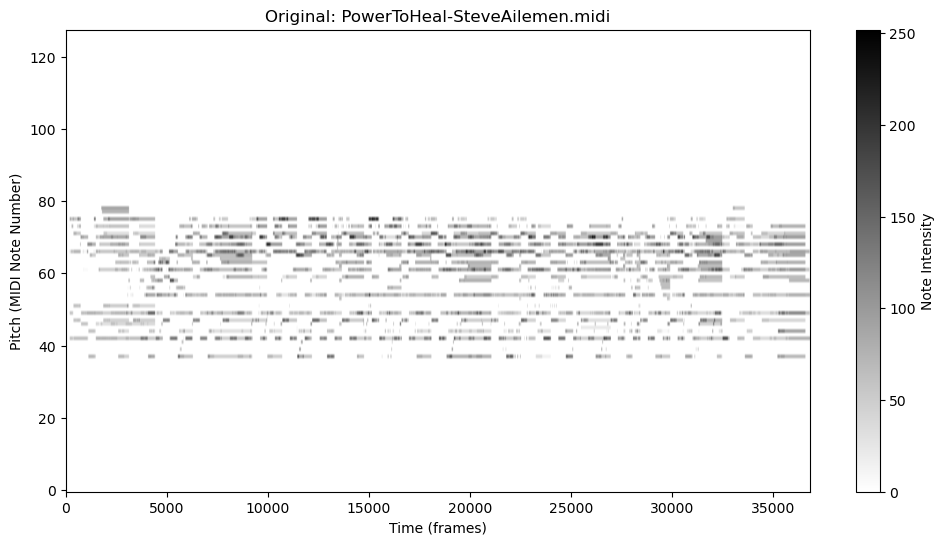

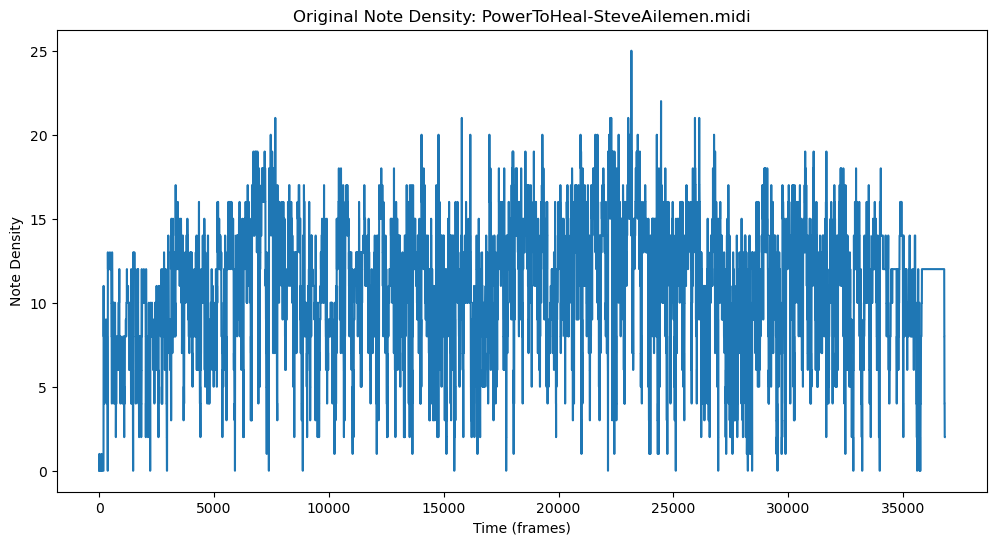

Visualizing augmented MIDI file: PowerToHeal-SteveAilemen.midi


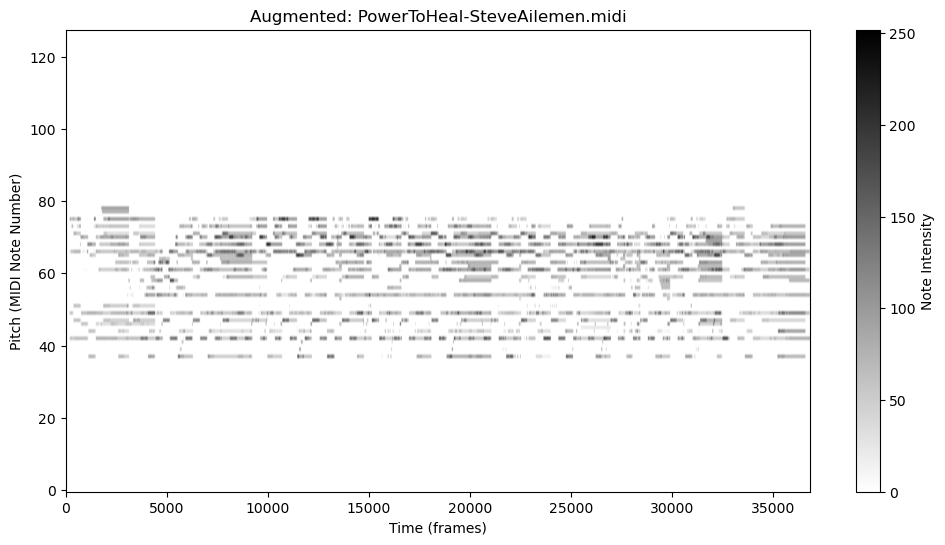

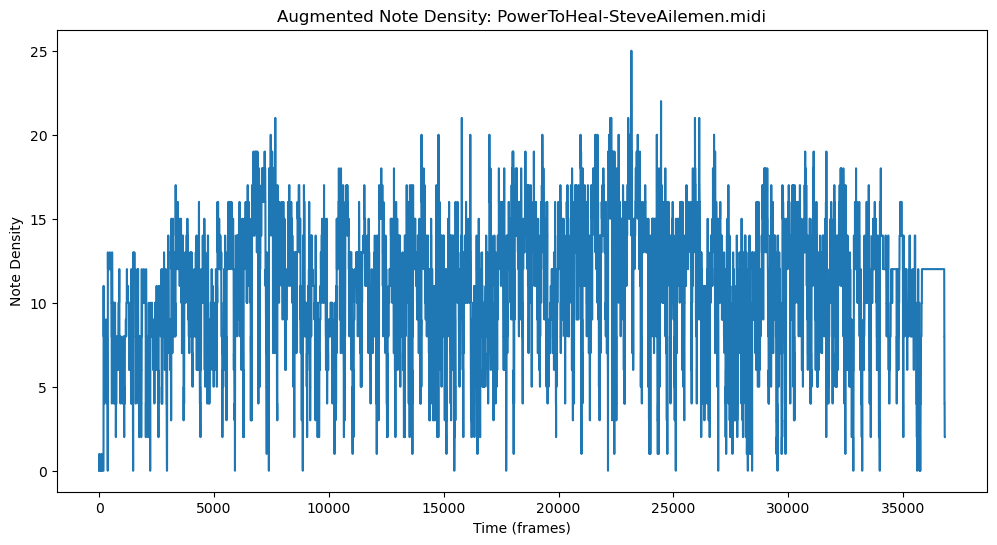

Visualizing original MIDI file: For_Your_Love_SteveDeRock.midi


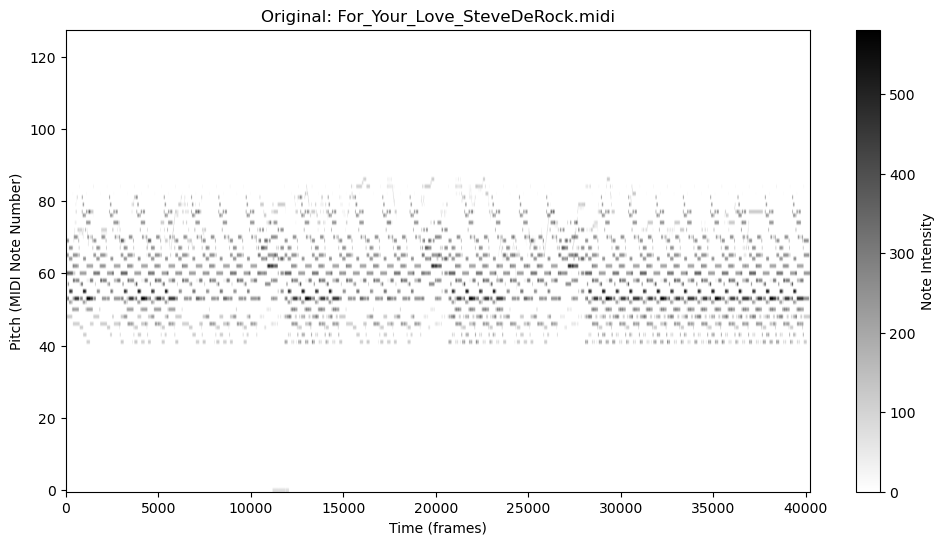

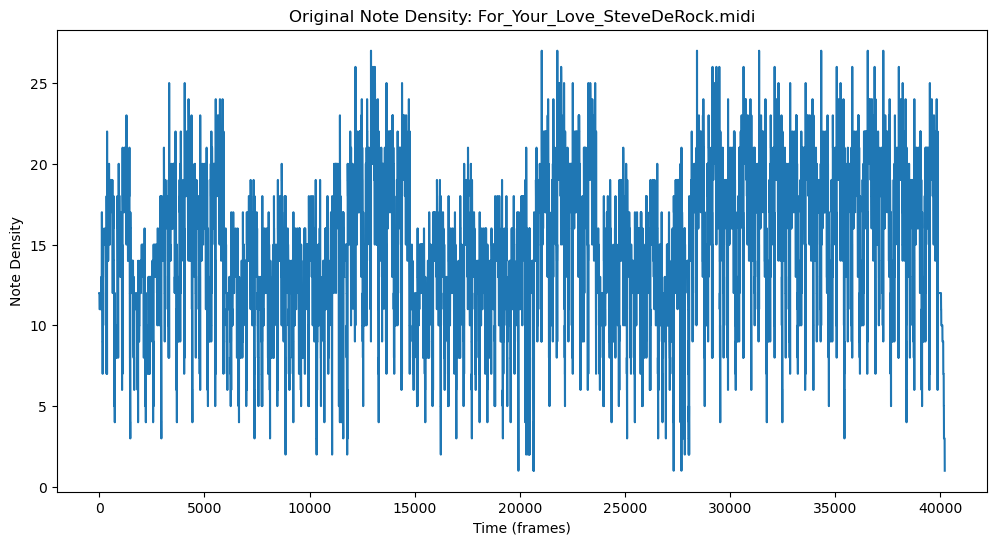

Visualizing augmented MIDI file: For_Your_Love_SteveDeRock.midi


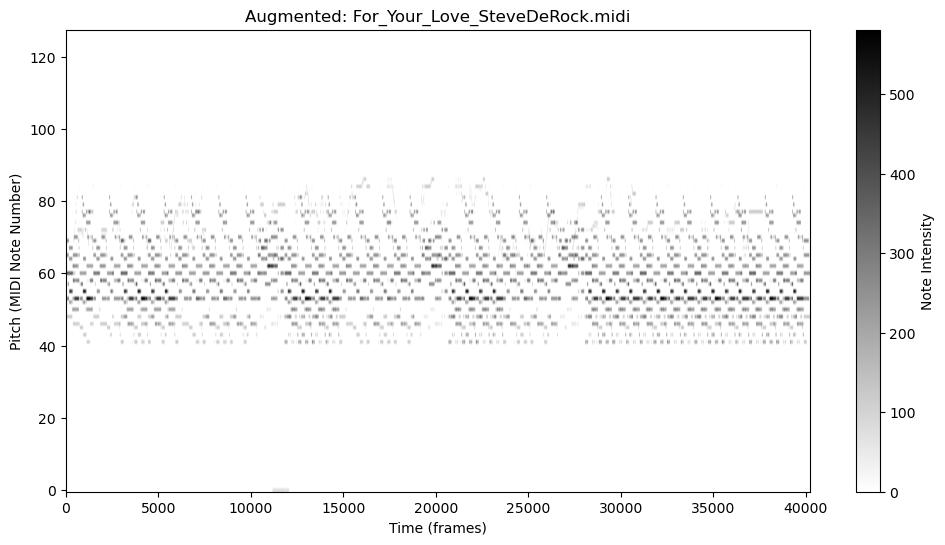

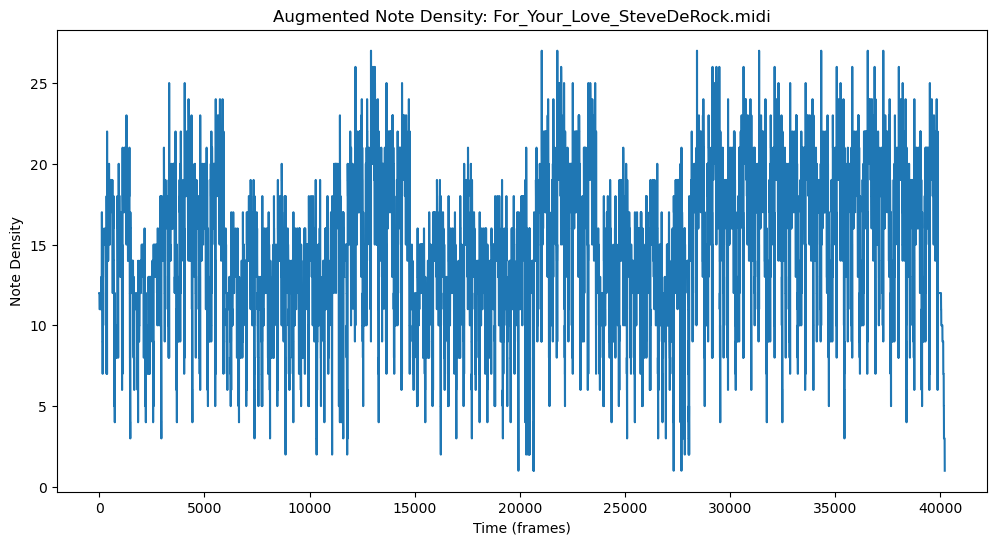

Visualizing original MIDI file: 70sFrenchHit-A1-SteveAilemen.midi


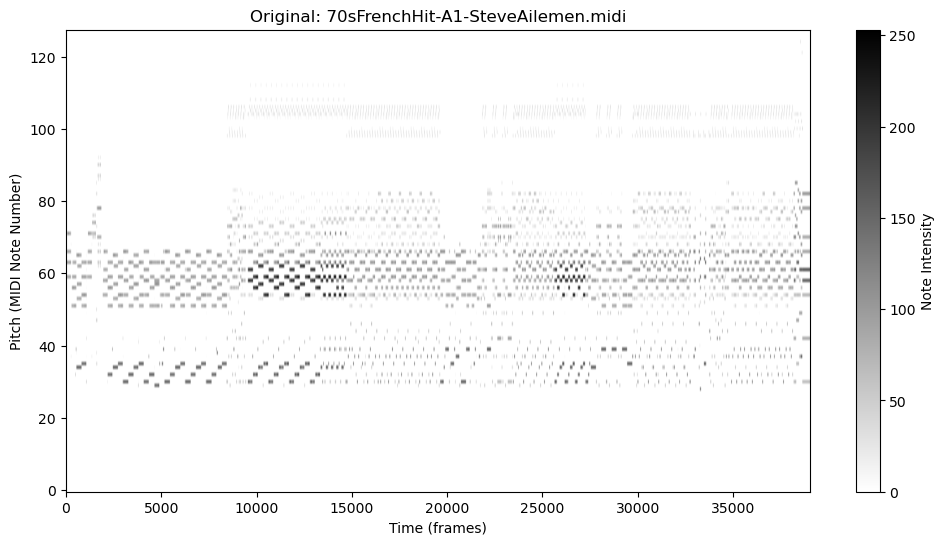

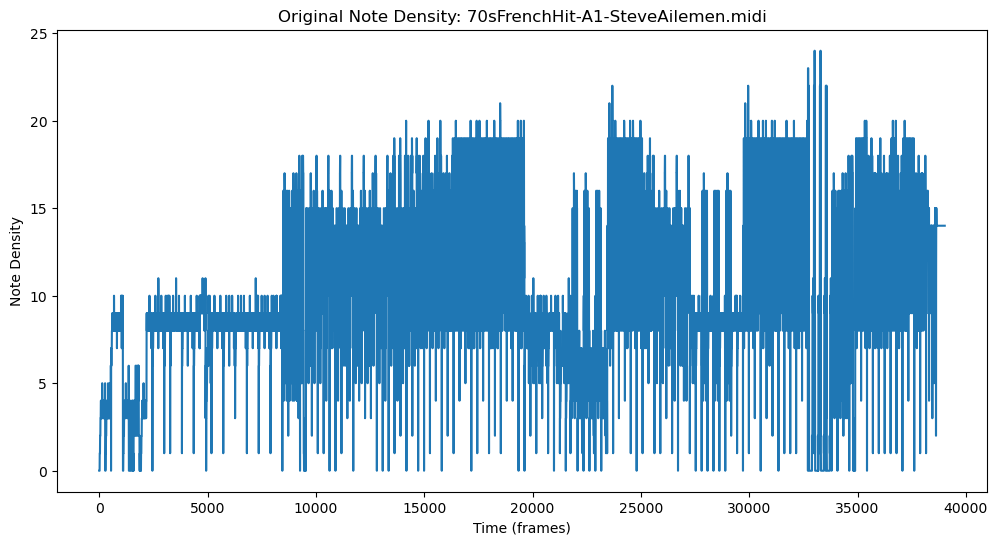

Visualizing augmented MIDI file: 70sFrenchHit-A1-SteveAilemen.midi


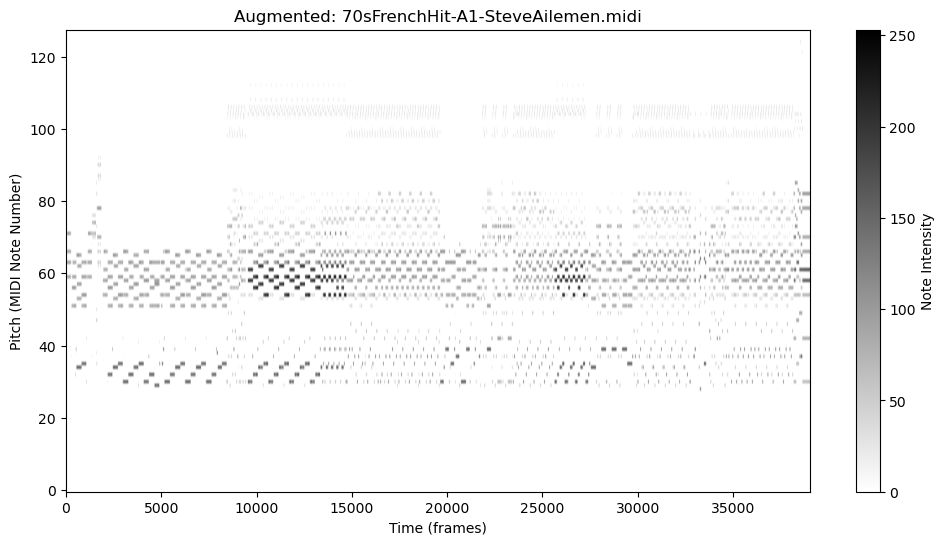

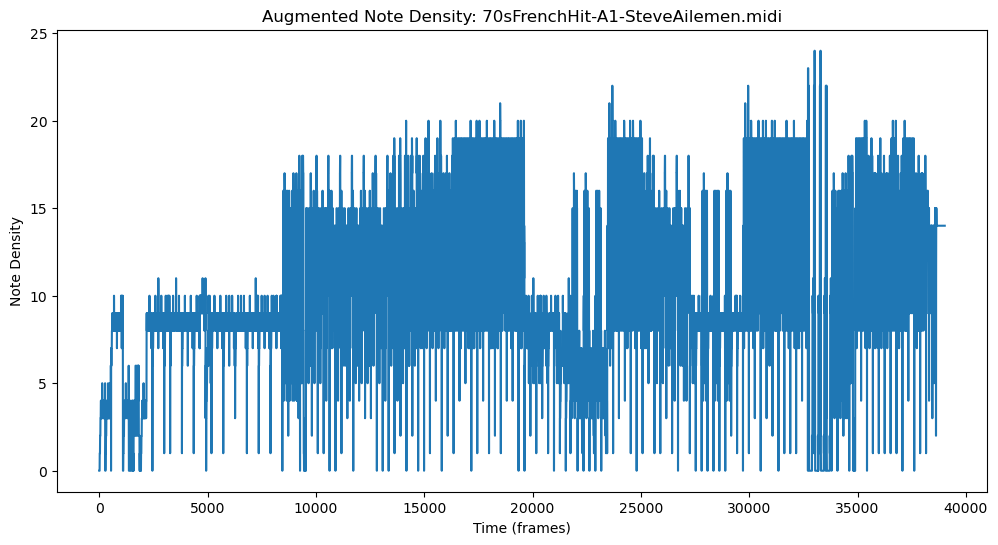

Visualizing original MIDI file: Great-SteveAilemen.midi


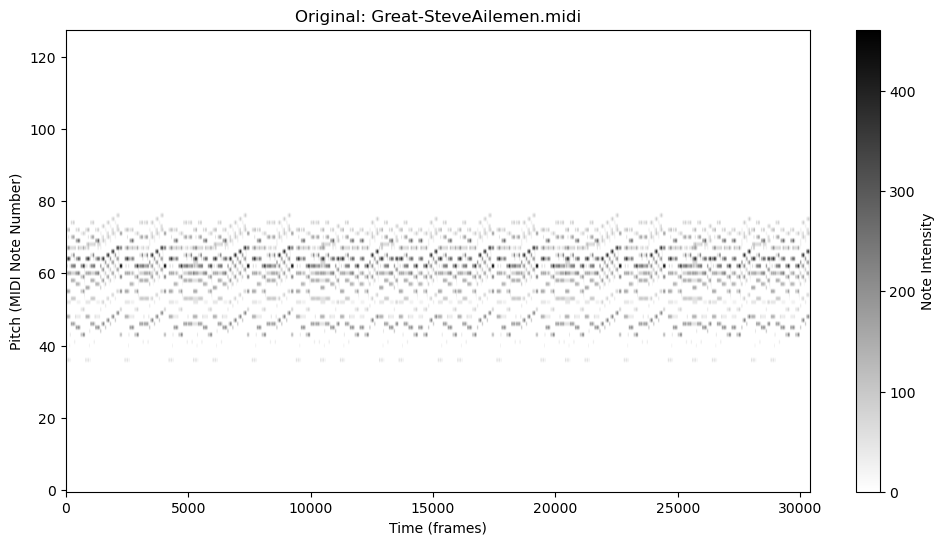

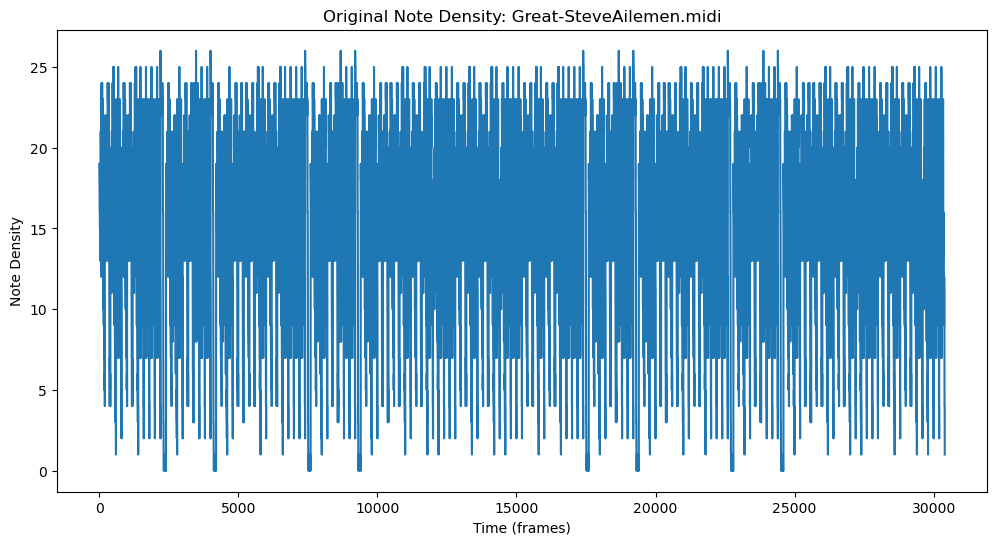

Visualizing augmented MIDI file: Great-SteveAilemen.midi


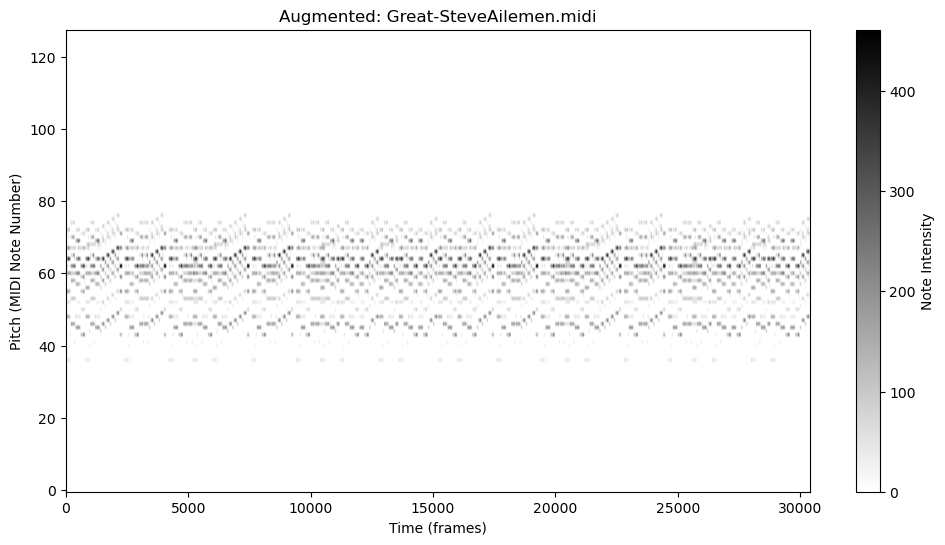

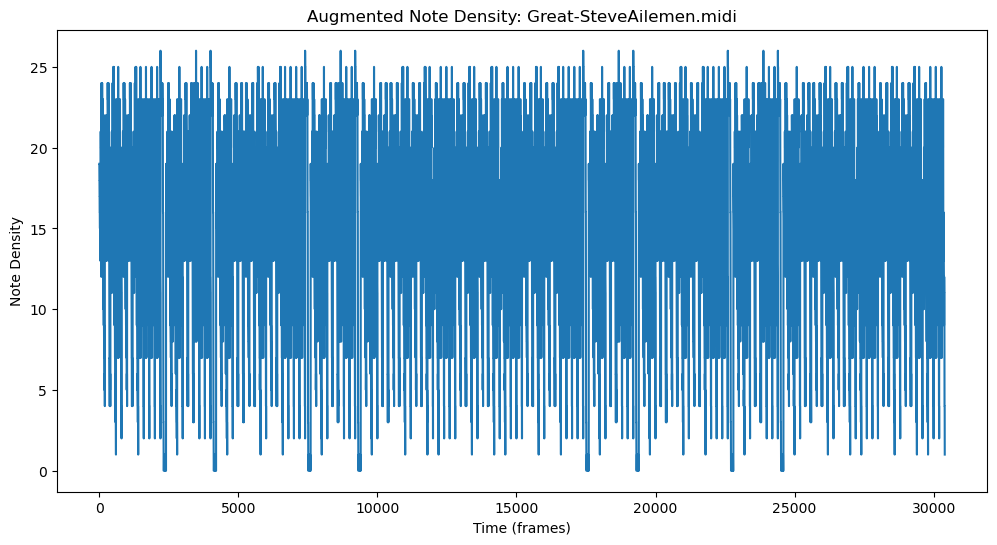

Visualizing original MIDI file: HiLife-Medley-SteveAilemen.midi


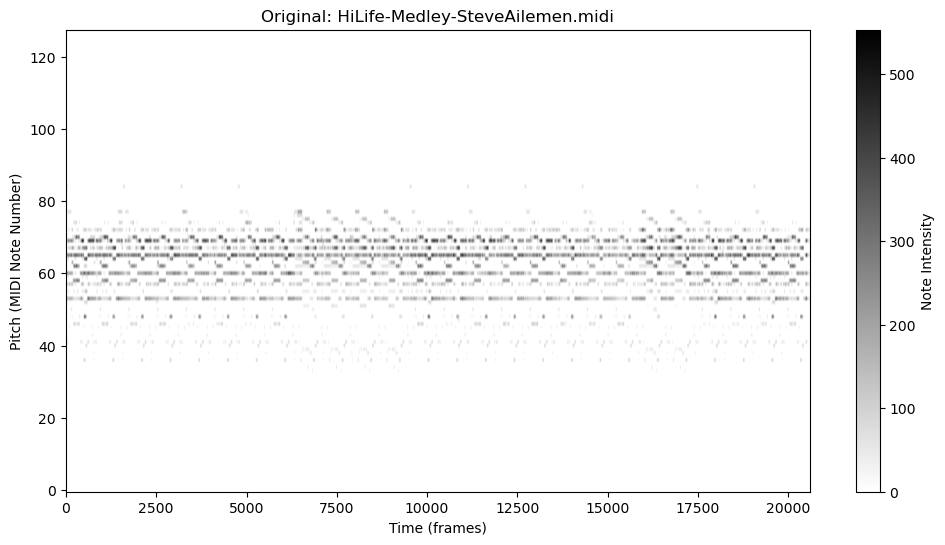

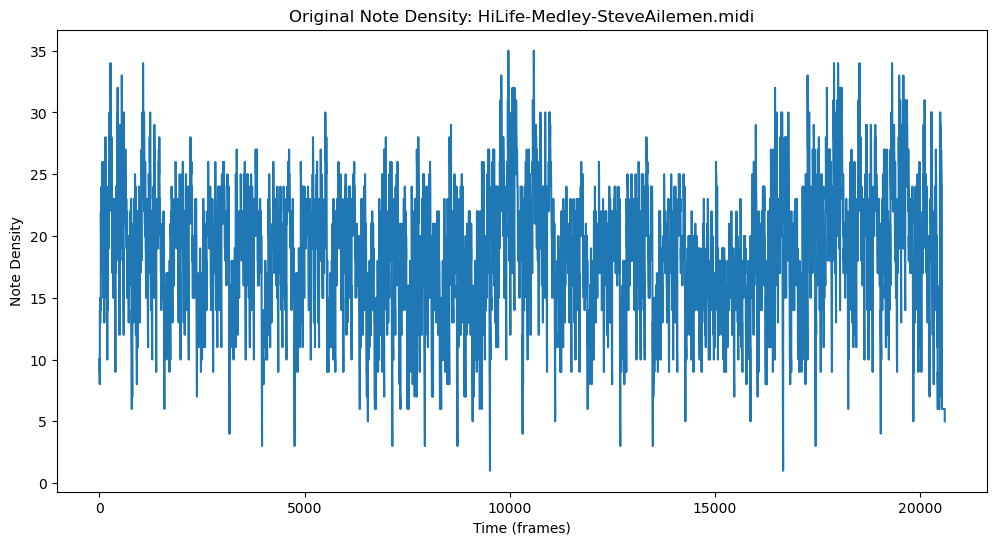

Visualizing augmented MIDI file: HiLife-Medley-SteveAilemen.midi


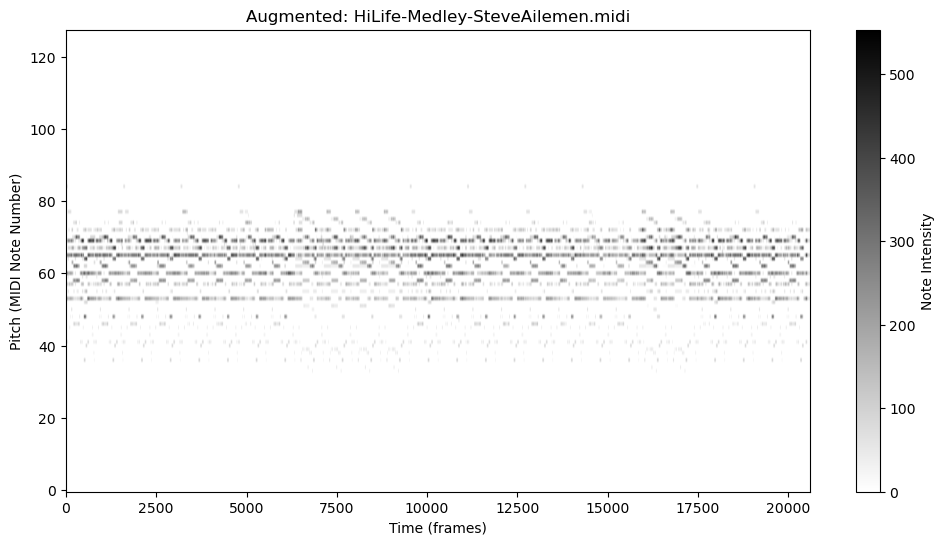

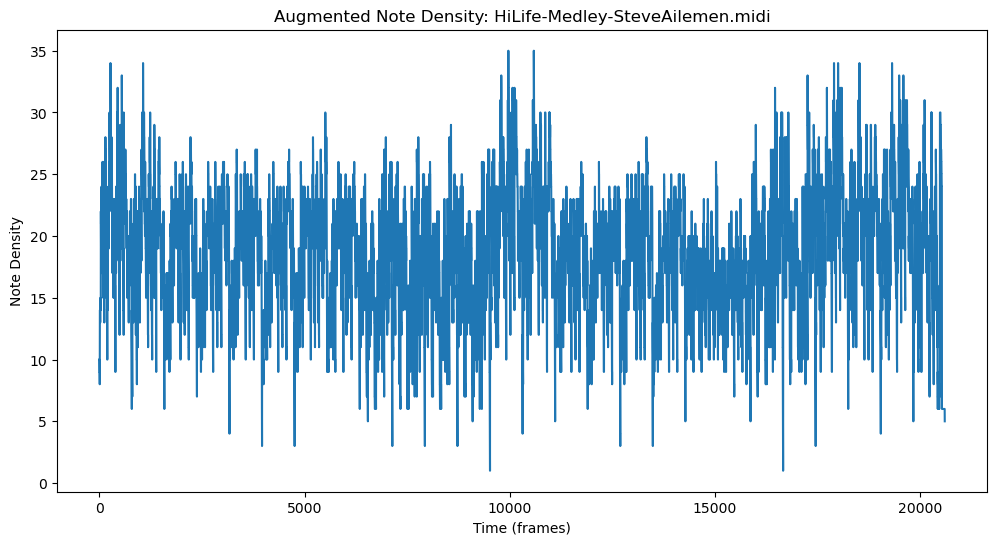

Visualizing original MIDI file: WayMaker-SteveAilemen.midi


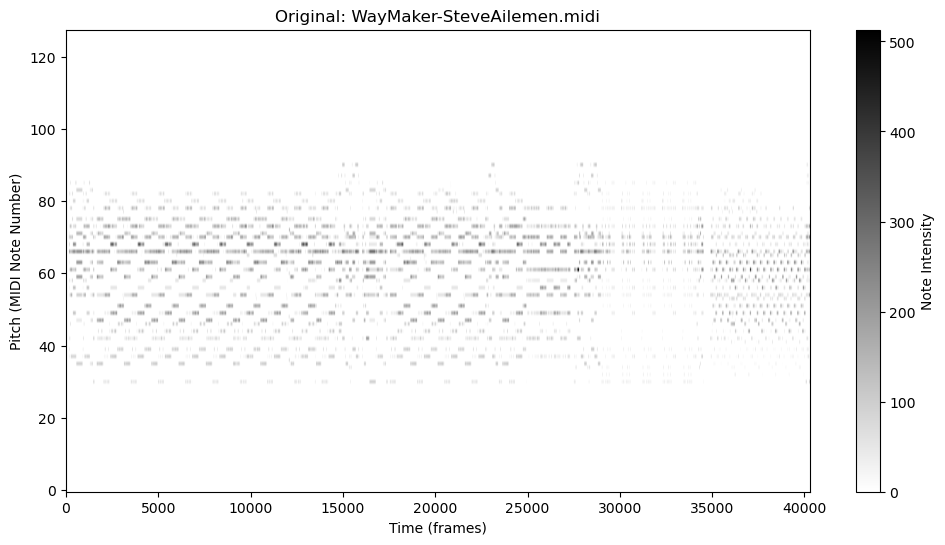

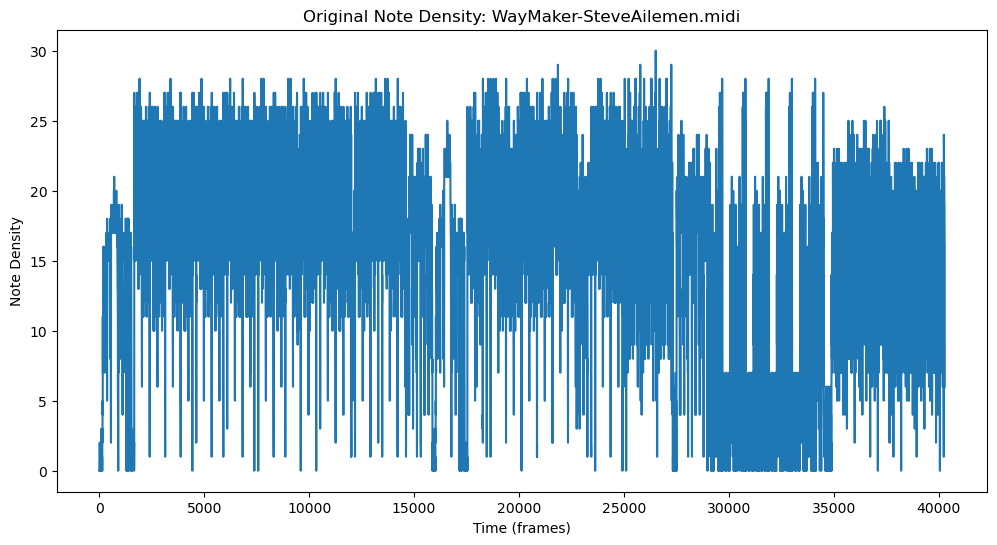

Visualizing augmented MIDI file: WayMaker-SteveAilemen.midi


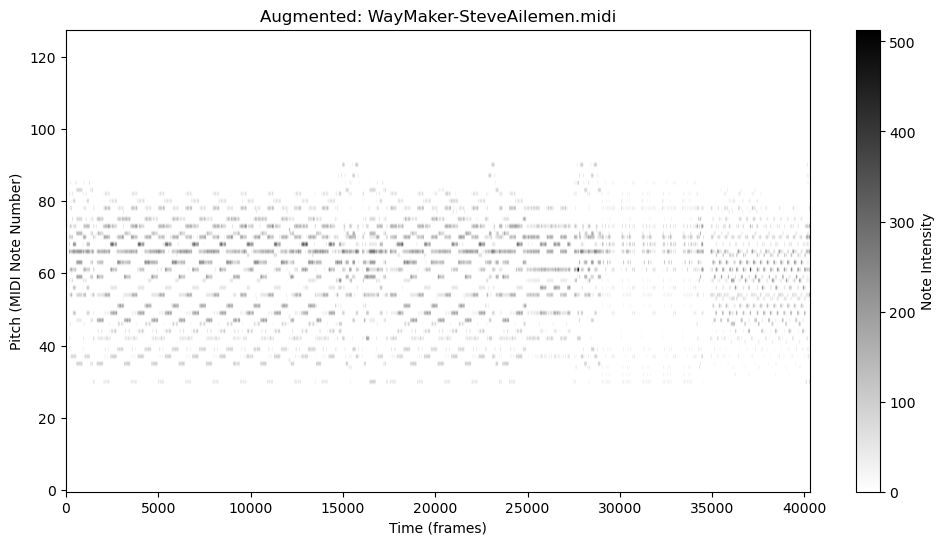

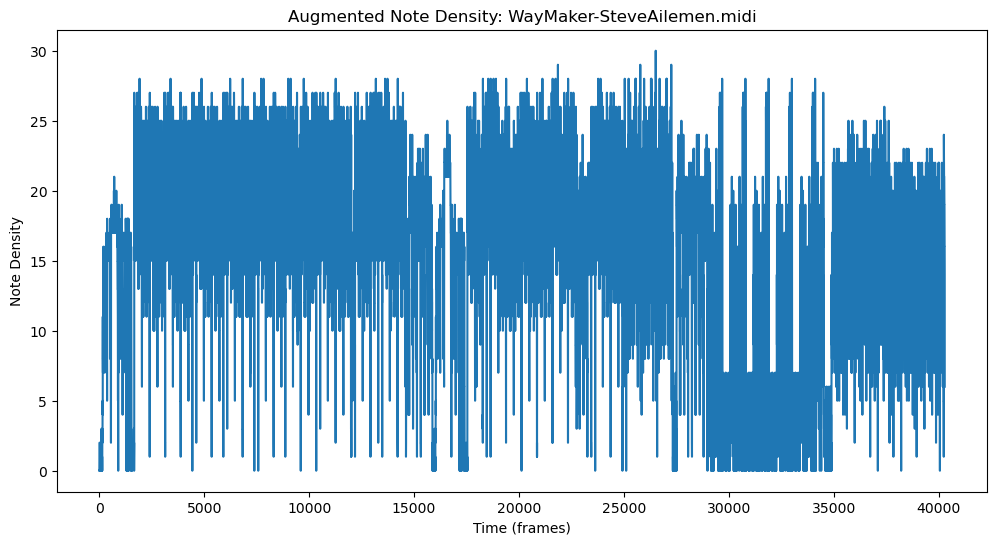

Visualizing original MIDI file: SoulR&B-SteveAilemen.midi


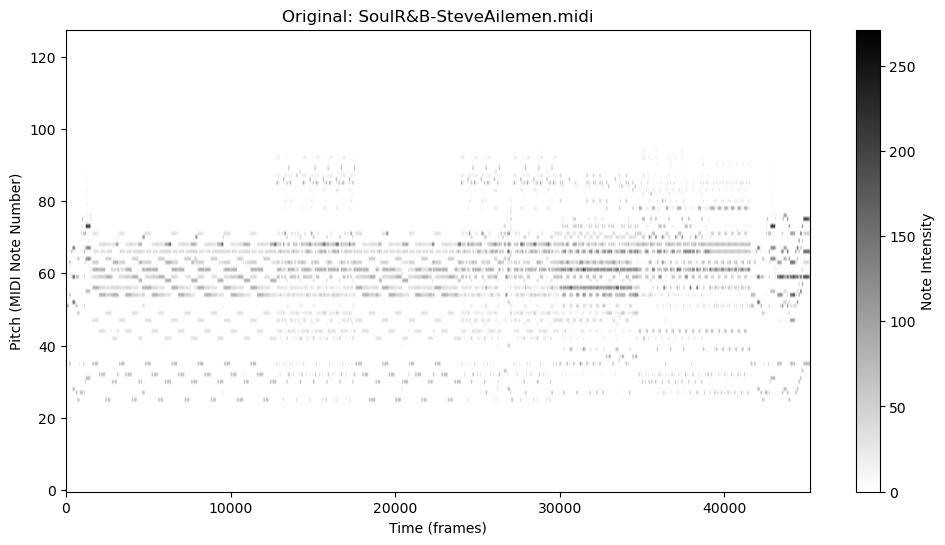

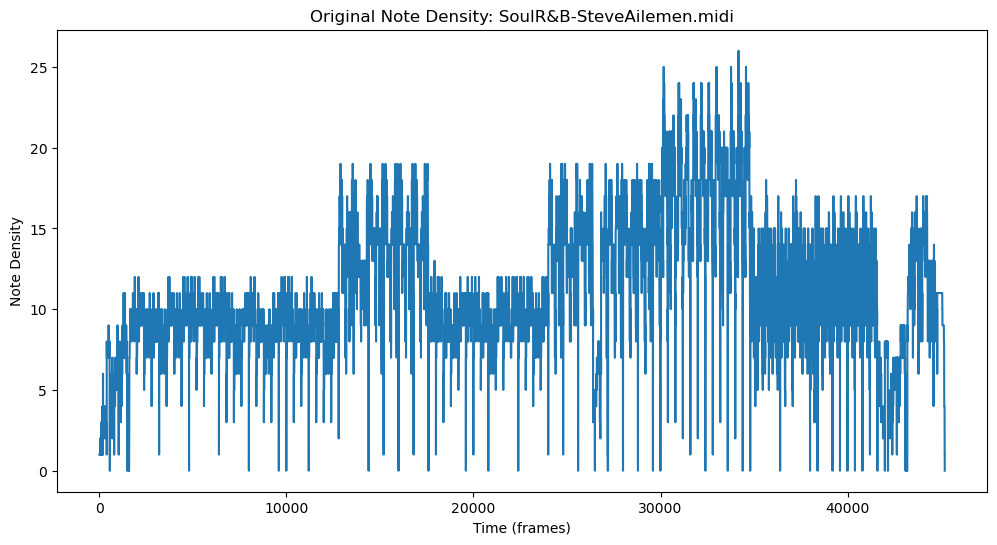

Visualizing augmented MIDI file: SoulR&B-SteveAilemen.midi


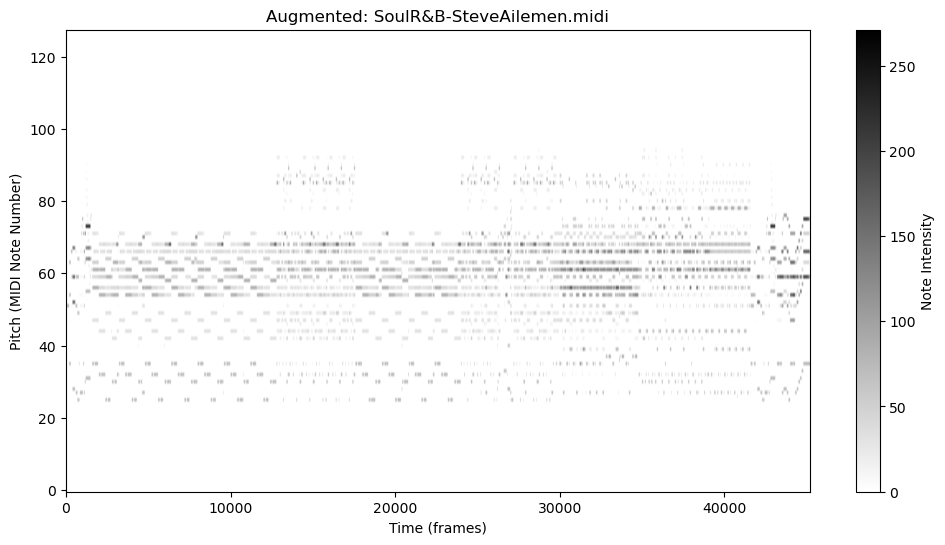

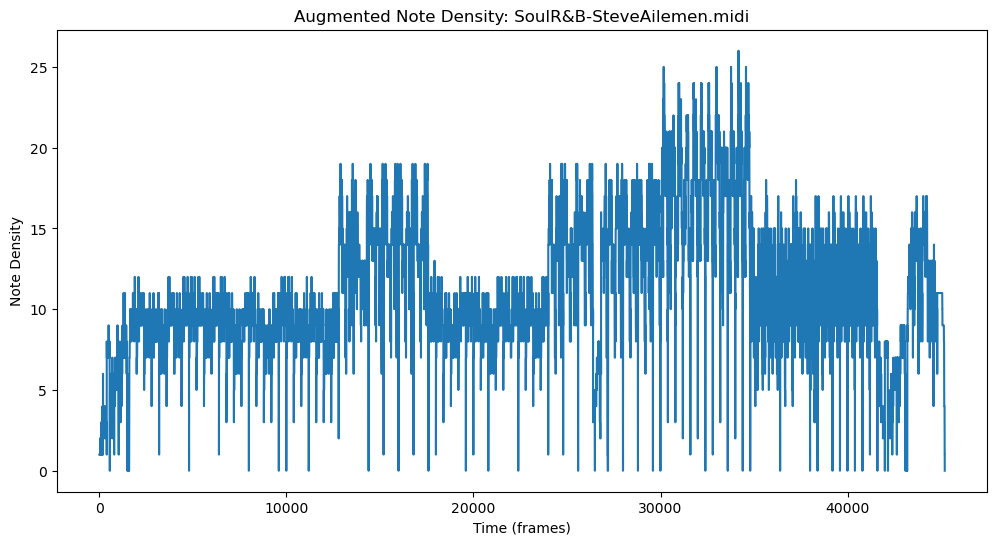

Visualizing original MIDI file: You Are The One I Love-SteveAilemen.mid


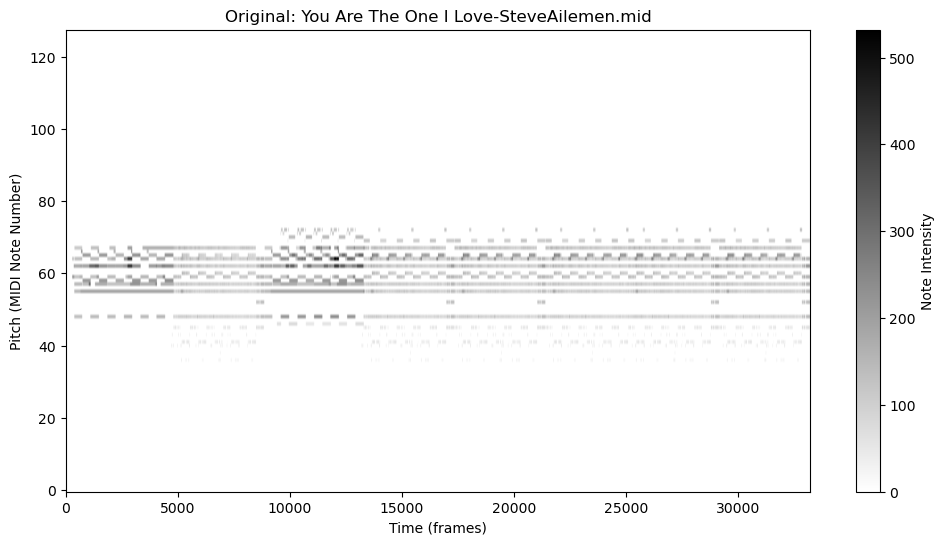

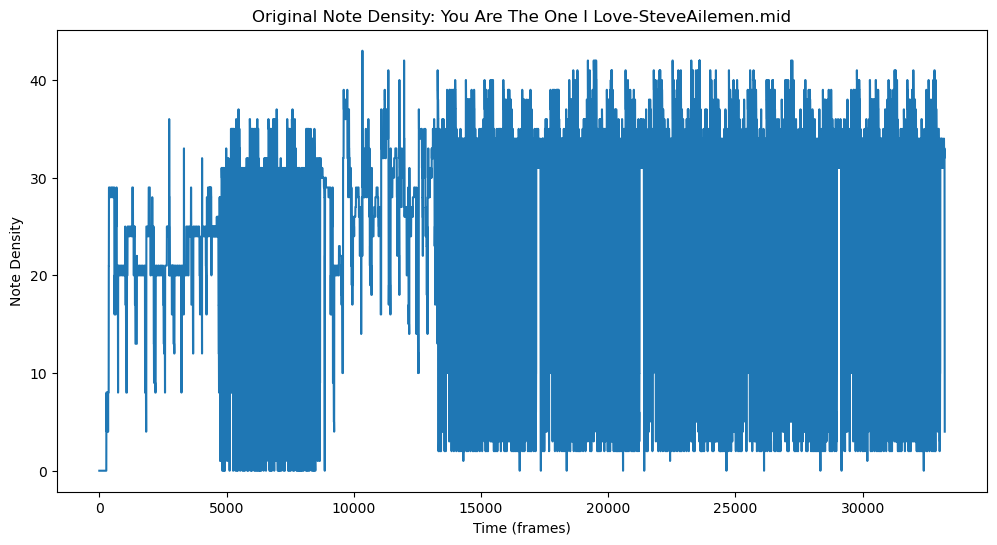

Visualizing augmented MIDI file: You Are The One I Love-SteveAilemen.mid


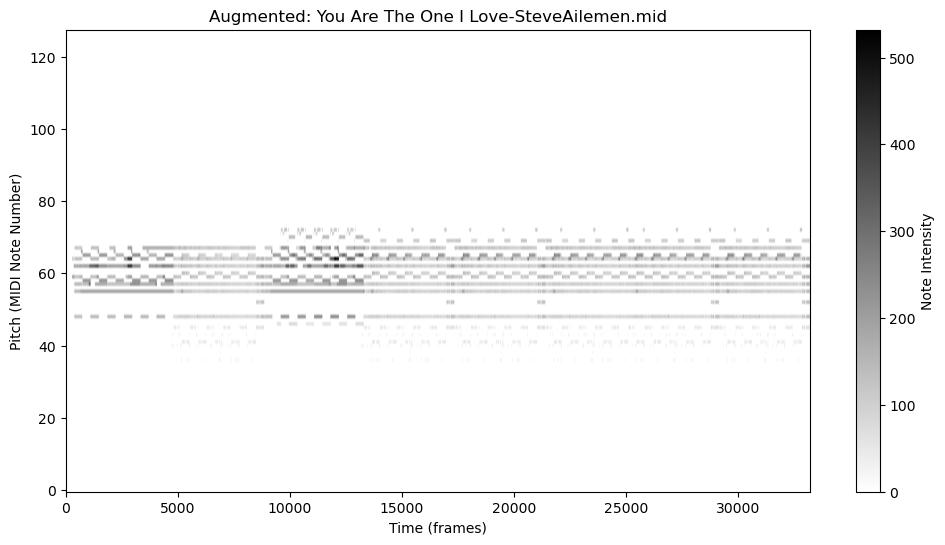

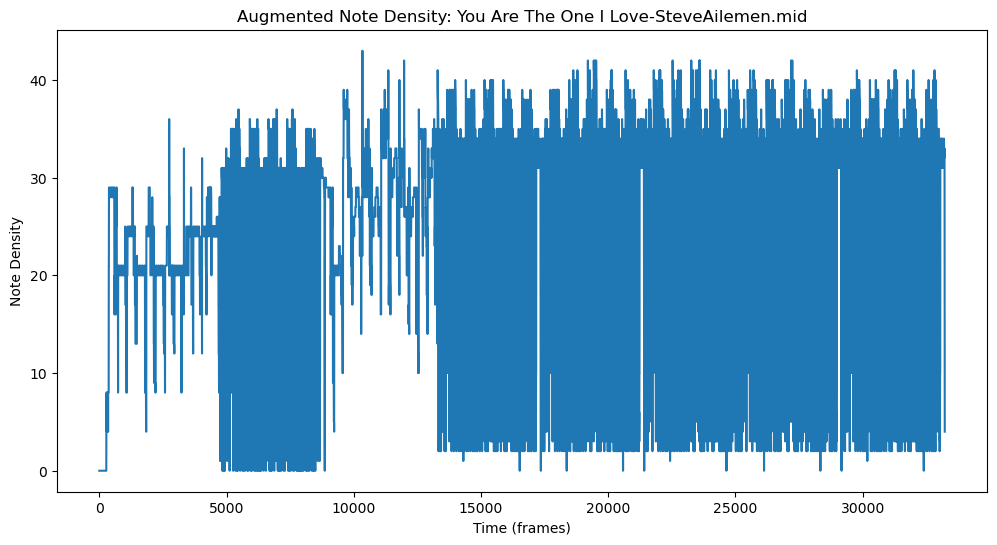

Visualizing original MIDI file: I_Said_It_Before.mid


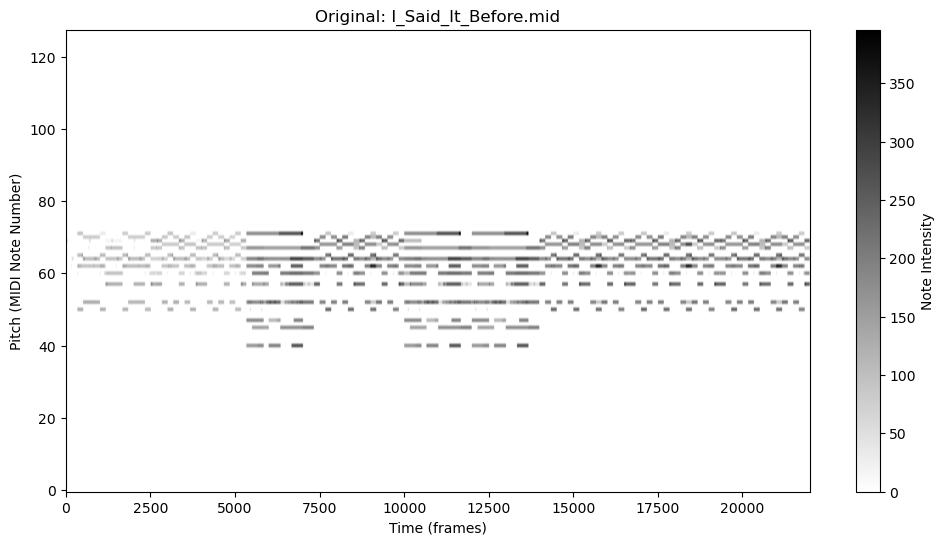

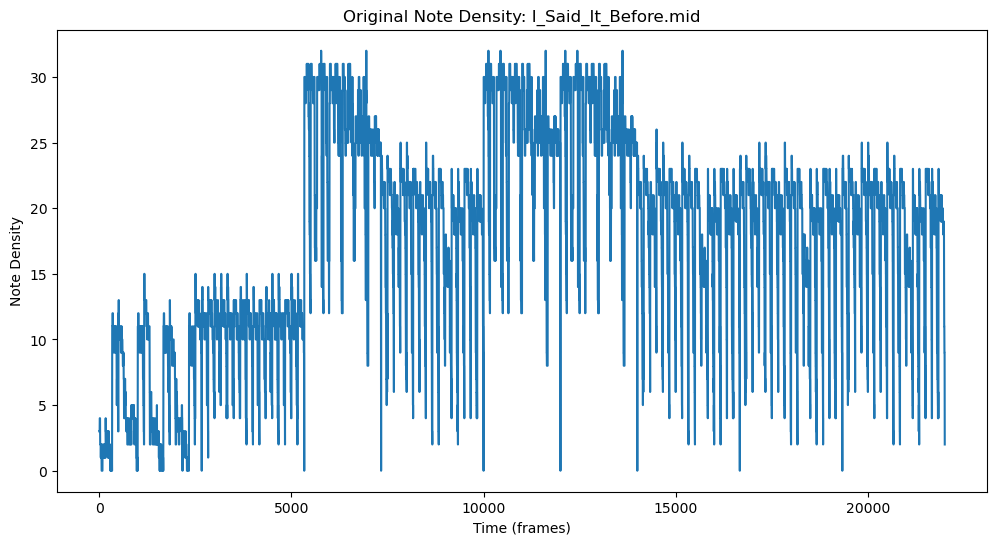

Visualizing augmented MIDI file: I_Said_It_Before.mid


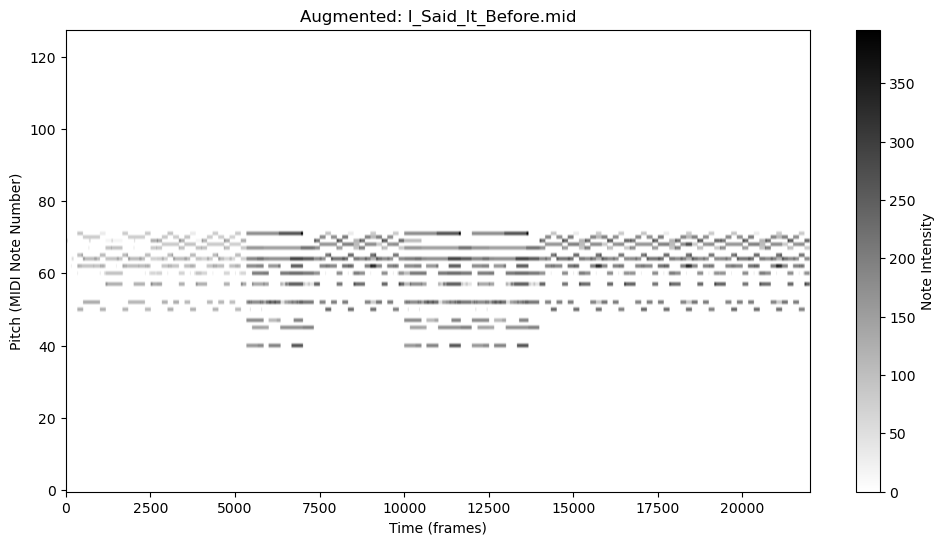

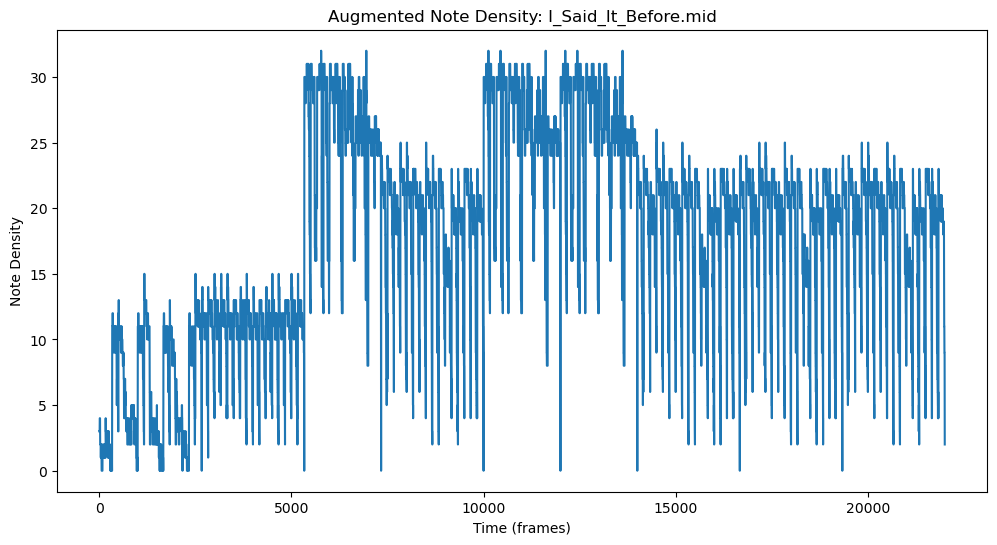

Visualizing original MIDI file: Omame-SteveAilemen.midi


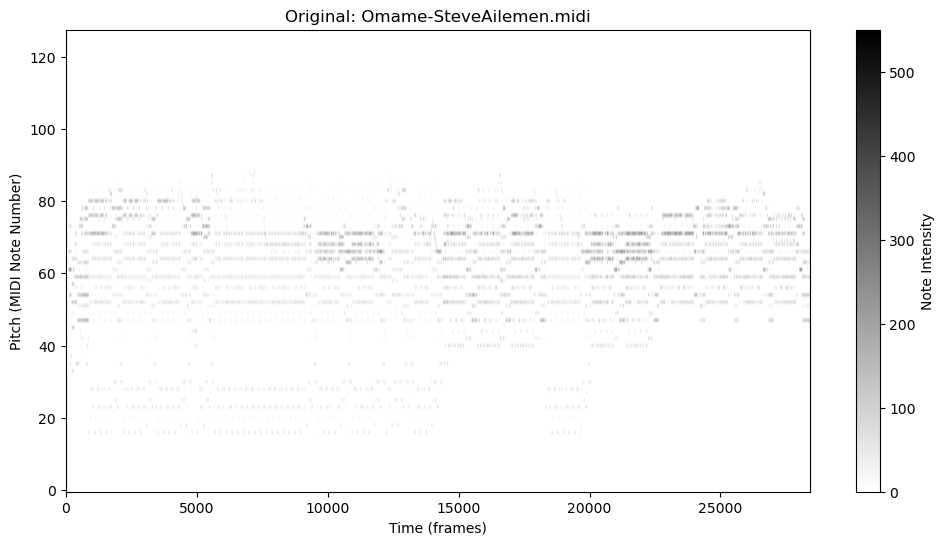

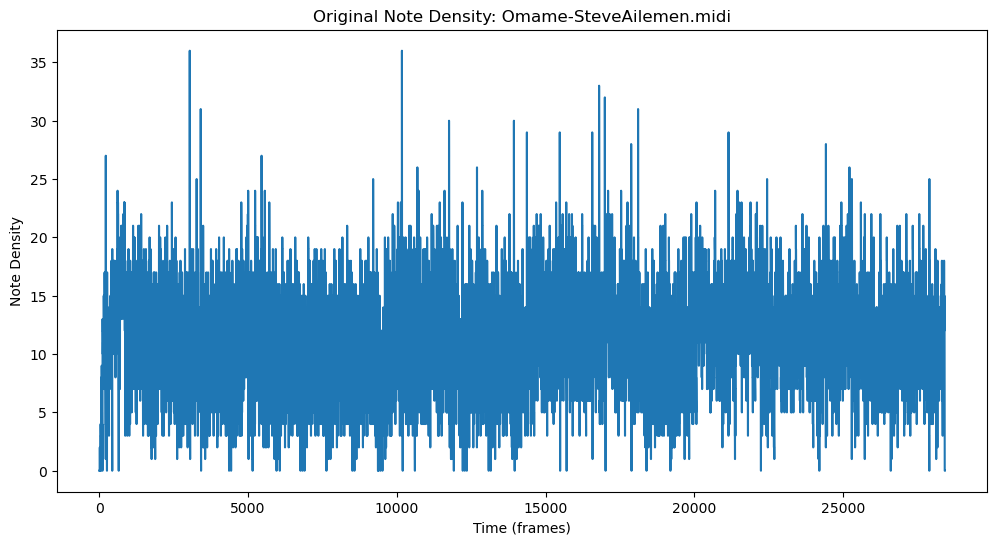

Visualizing augmented MIDI file: Omame-SteveAilemen.midi


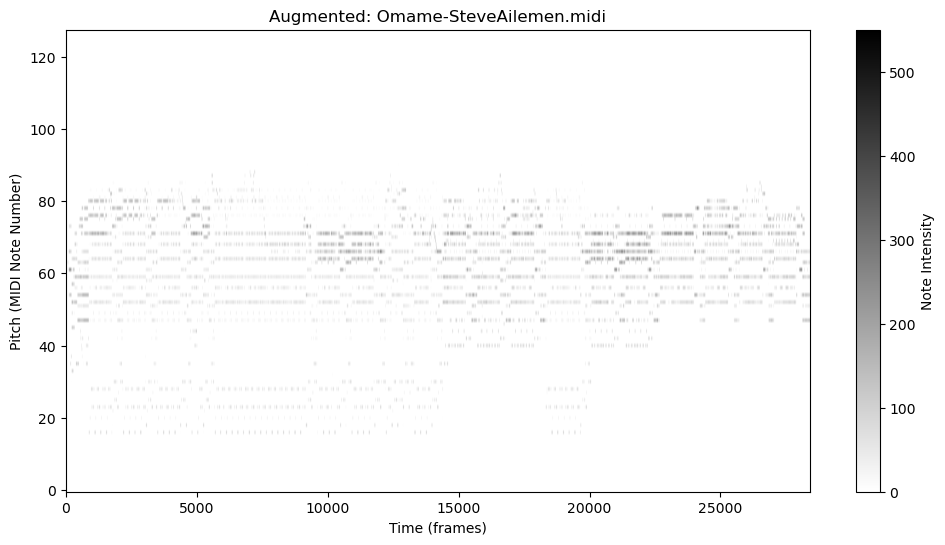

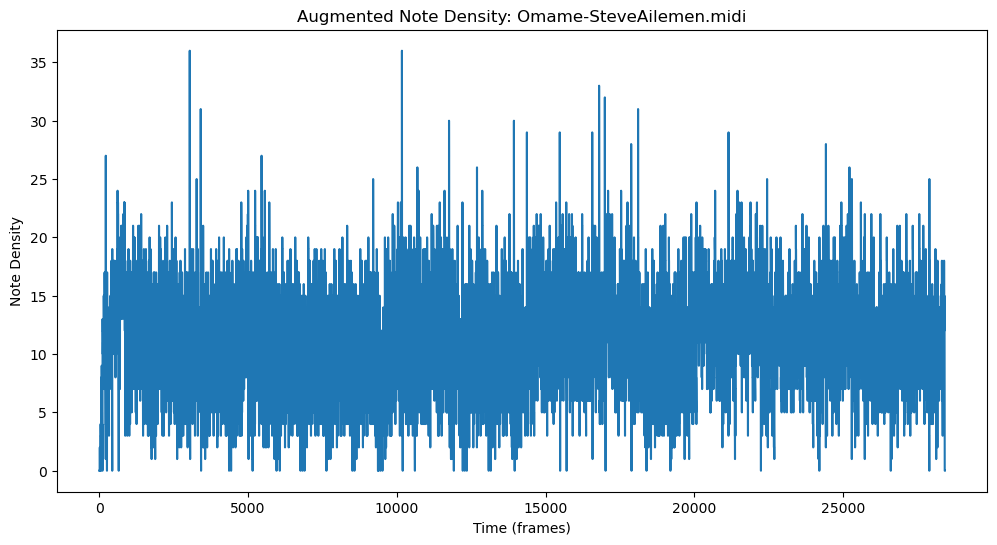

Visualizing original MIDI file: SambaRegae-SteveAilemen.midi


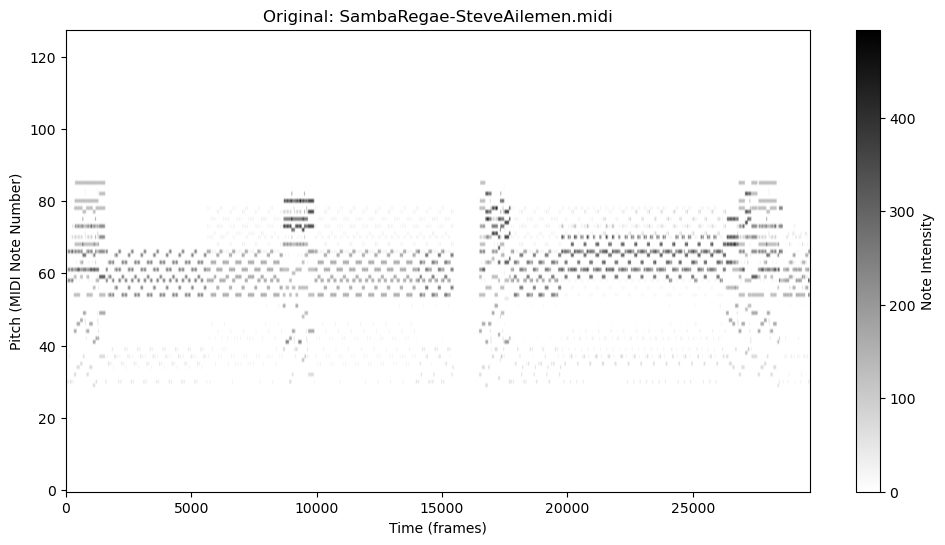

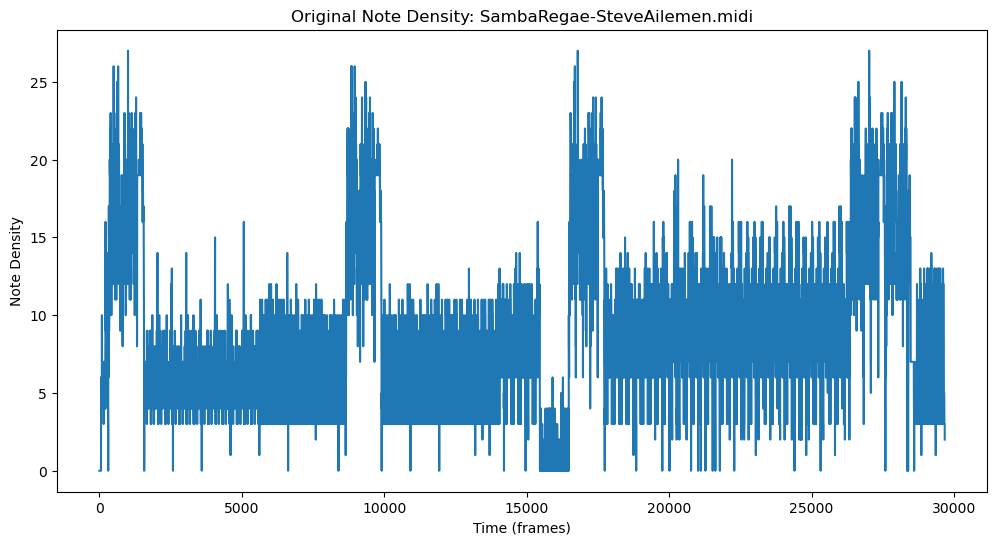

Visualizing augmented MIDI file: SambaRegae-SteveAilemen.midi


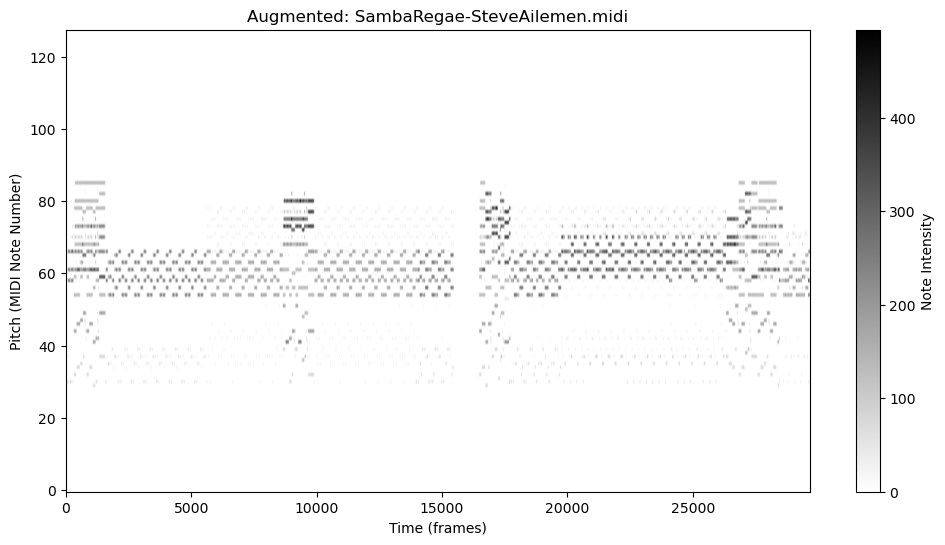

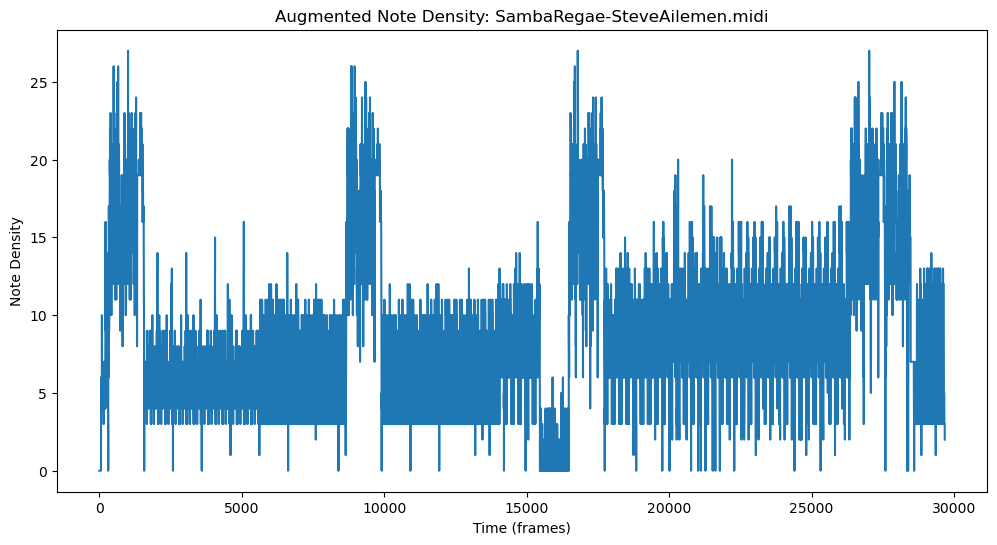

Visualizing original MIDI file: Airy-SteveAilemen.midi


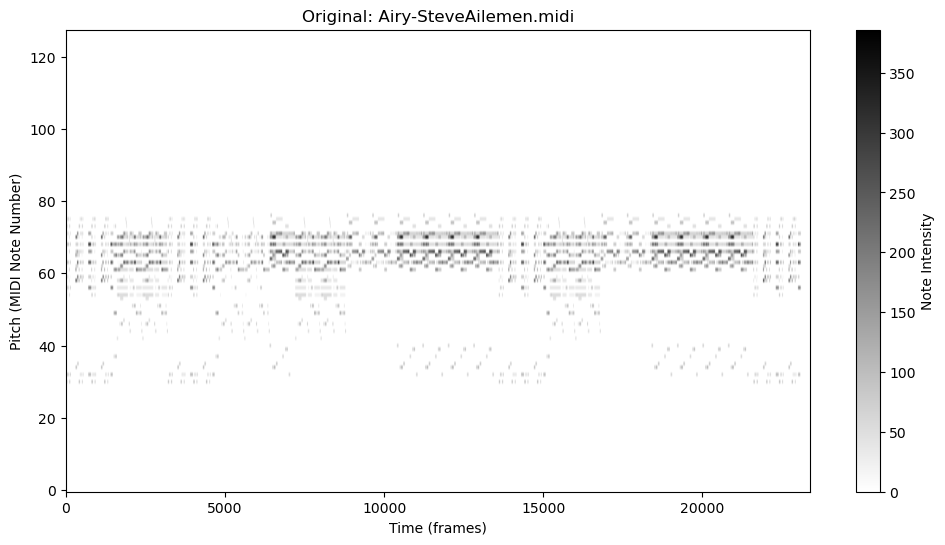

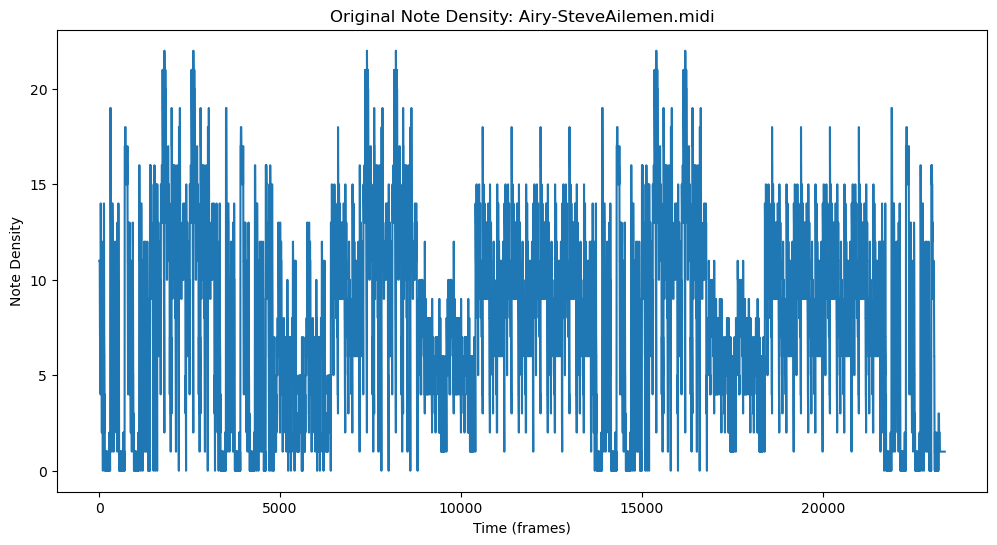

Visualizing augmented MIDI file: Airy-SteveAilemen.midi


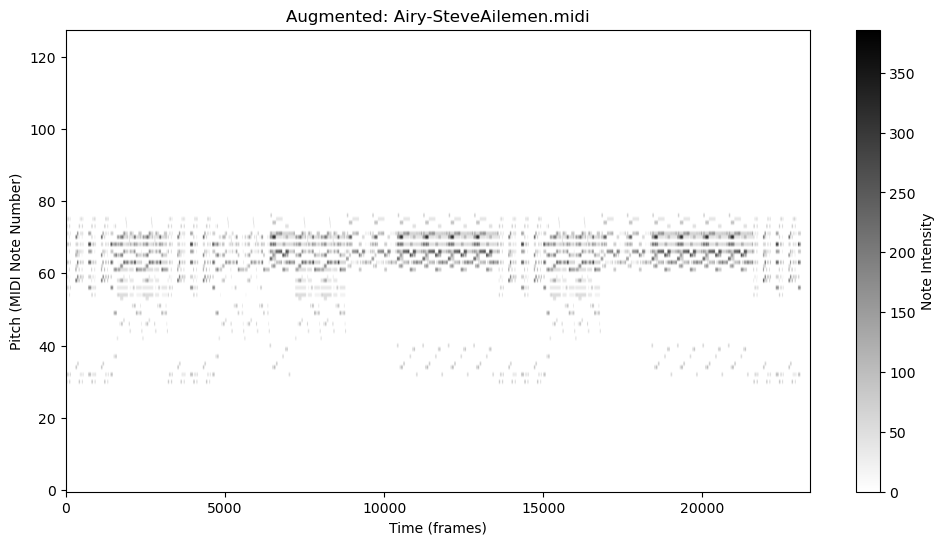

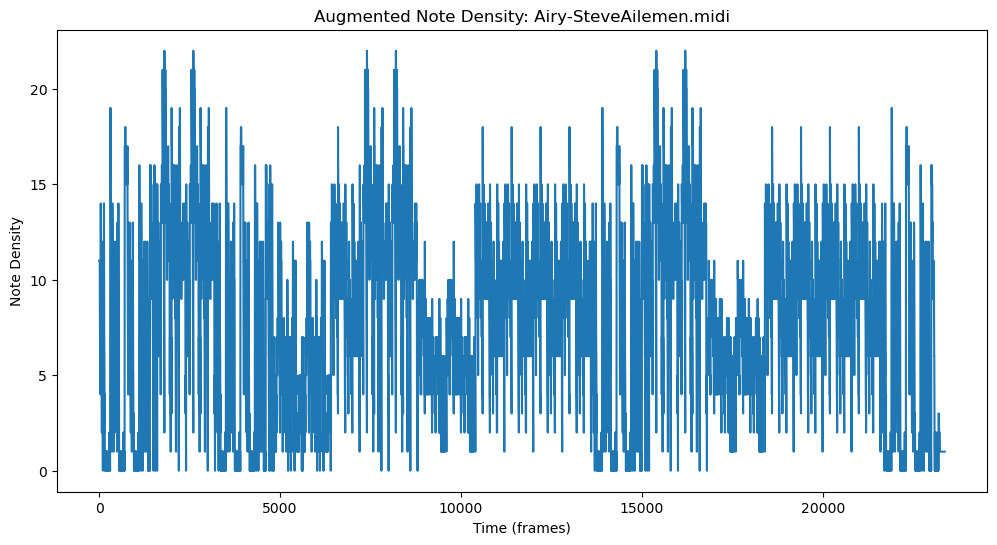

Visualizing original MIDI file: 70sTVTheme-SteveAilemen.midi


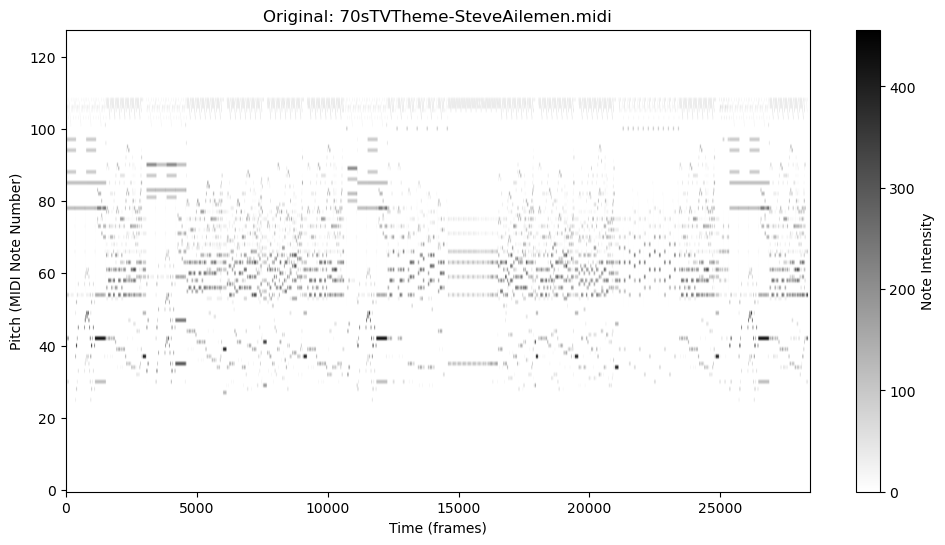

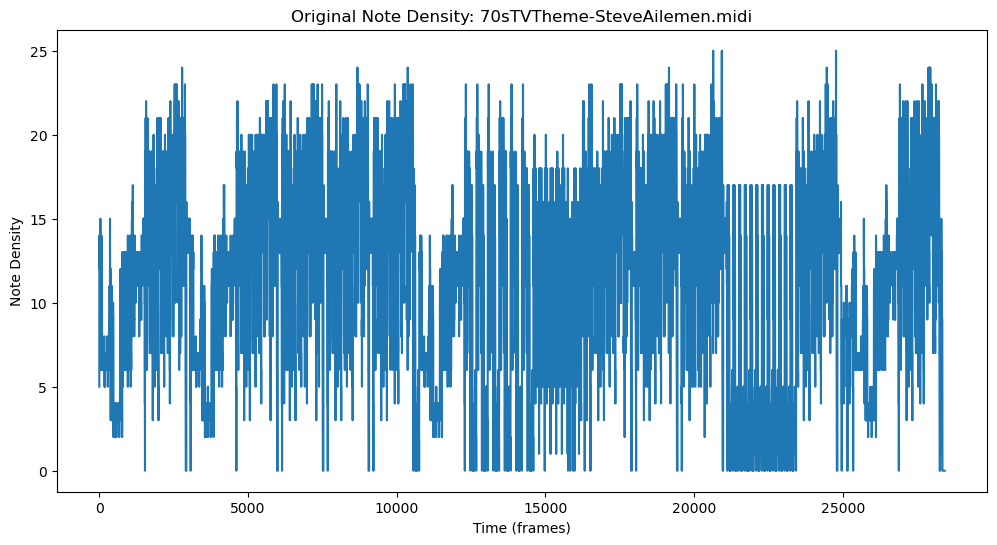

Visualizing augmented MIDI file: 70sTVTheme-SteveAilemen.midi


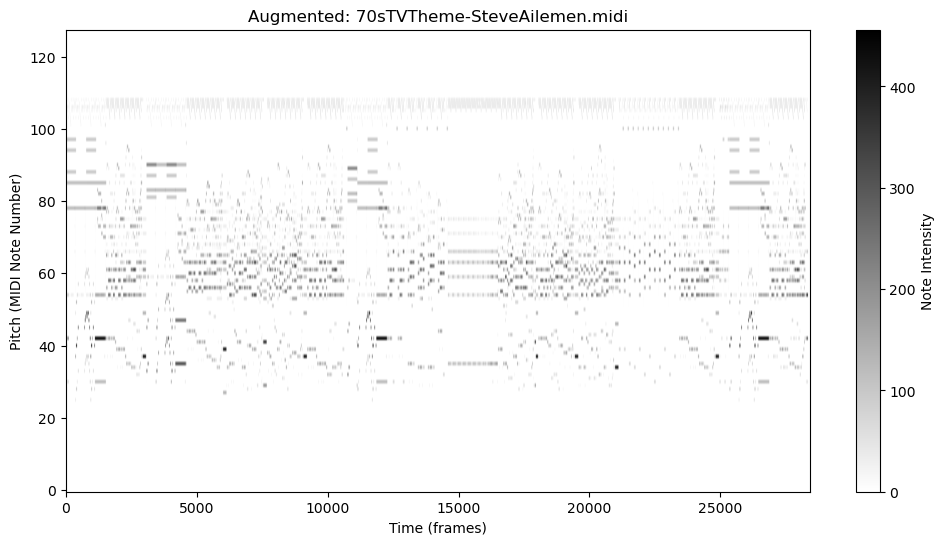

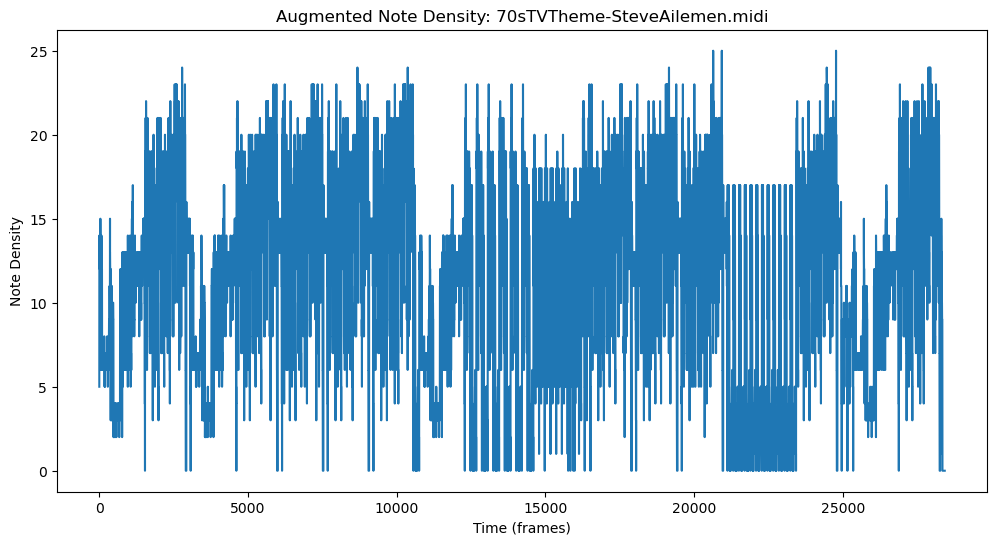

Visualizing original MIDI file: Movie-SteveAilemen.midi


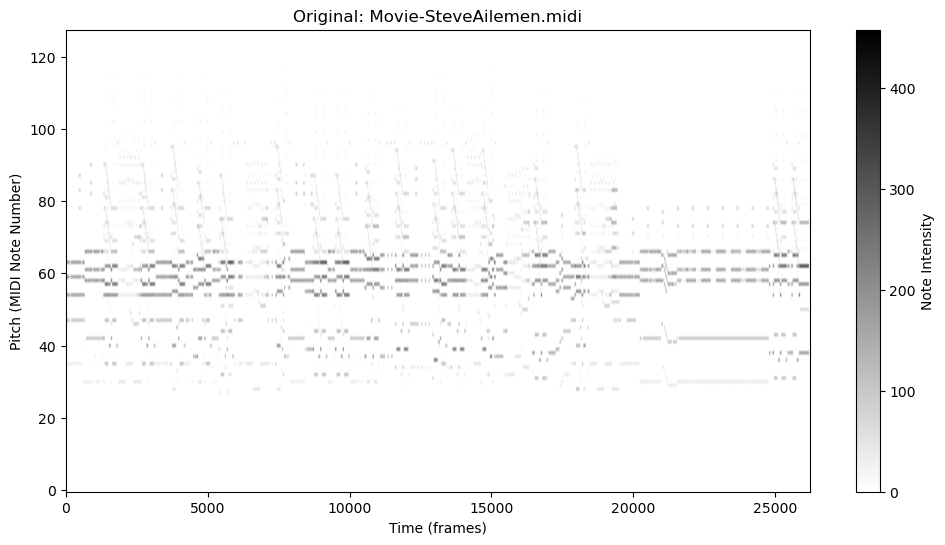

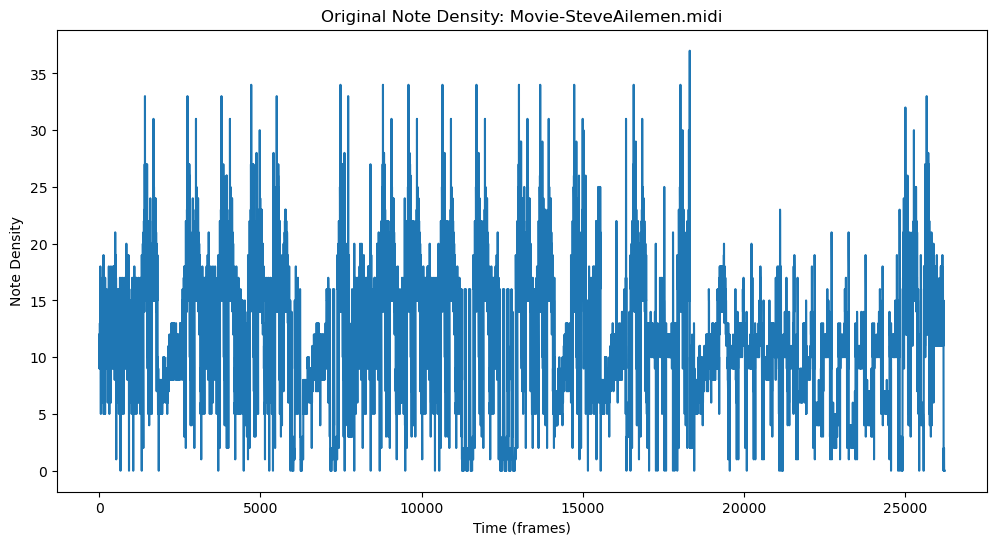

Visualizing augmented MIDI file: Movie-SteveAilemen.midi


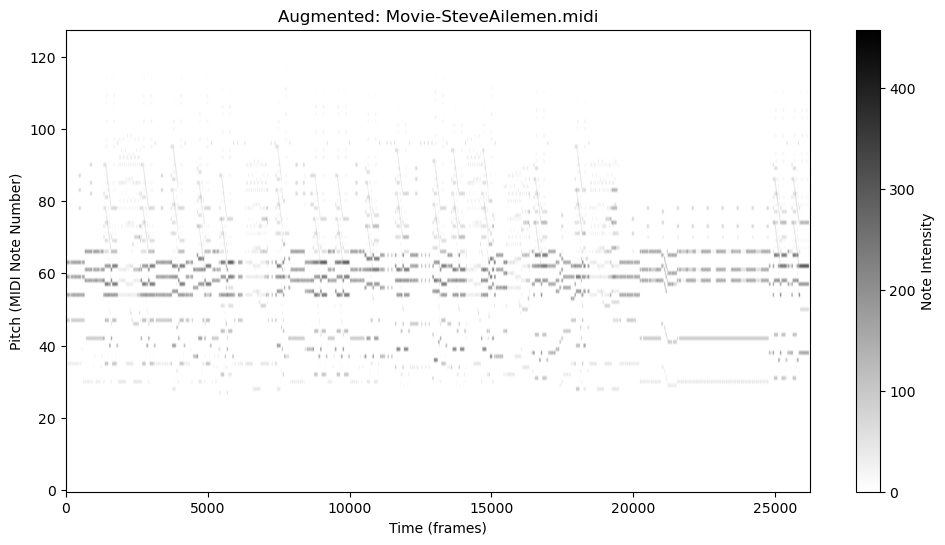

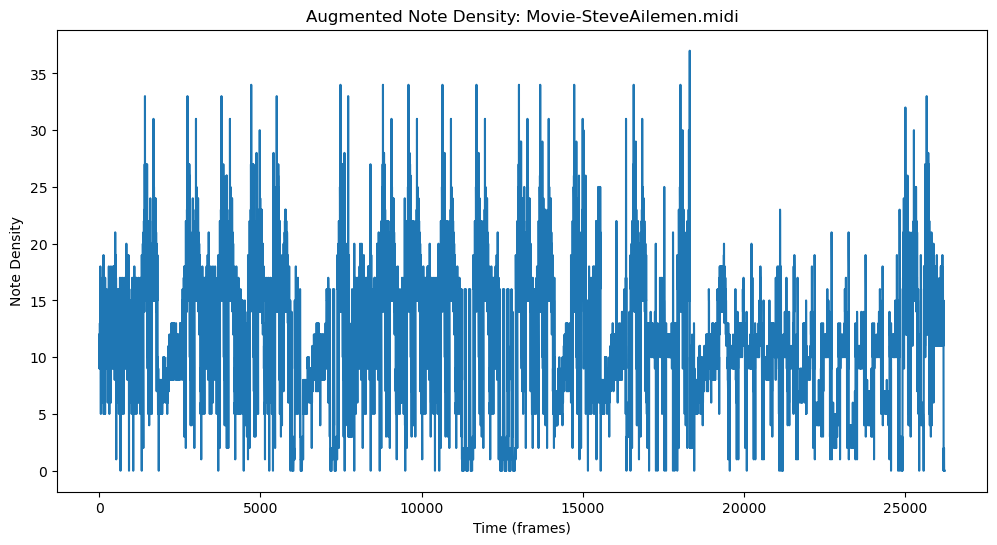

In [64]:
# Function to convert MIDI file to piano roll
def midi_to_piano_roll(midi_file):
    """Convert MIDI file to piano roll"""
    midi_data = pd.PrettyMIDI(midi_file)
    return midi_data.get_piano_roll(fs=100)

# Function to plot piano roll
def plot_piano_roll(piano_roll, title="Piano Roll"):
    """Plot a piano roll"""
    plt.figure(figsize=(12, 6))
    plt.imshow(piano_roll, aspect='auto', cmap='gray_r', origin='lower')
    plt.title(title)
    plt.xlabel('Time (frames)')
    plt.ylabel('Pitch (MIDI Note Number)')
    plt.colorbar(label='Note Intensity')
    plt.show()

# Function to plot note density
def plot_note_density(midi_file, title="Note Density"):
    """Plot note density"""
    midi_data = pd.PrettyMIDI(midi_file)
    note_density = np.zeros(int(midi_data.get_end_time() * 100))  # assuming 100 frames per second
    for instrument in midi_data.instruments:
        for note in instrument.notes:
            start = int(note.start * 100)
            end = int(note.end * 100)
            note_density[start:end] += 1
    plt.figure(figsize=(12, 6))
    plt.plot(note_density)
    plt.title(title)
    plt.xlabel('Time (frames)')
    plt.ylabel('Note Density')
    plt.show()

# Path for original and augmented folders
original_folder = './MIDI_folder'
augmented_folder = './MIDI_folder/augmented'

# List all MIDI files
midi_files = [f for f in os.listdir(original_folder) if f.endswith('.midi') or f.endswith('.mid')]

# Visualize original and augmented MIDI files
for midi_file in midi_files:
    original_path = os.path.join(original_folder, midi_file)
    augmented_path = os.path.join(augmented_folder, midi_file)

    # Visualize original
    print(f"Visualizing original MIDI file: {midi_file}")
    plot_piano_roll(midi_to_piano_roll(original_path), title=f"Original: {midi_file}")
    plot_note_density(original_path, title=f"Original Note Density: {midi_file}")

    # Visualize augmented
    print(f"Visualizing augmented MIDI file: {midi_file}")
    plot_piano_roll(midi_to_piano_roll(augmented_path), title=f"Augmented: {midi_file}")
    plot_note_density(augmented_path, title=f"Augmented Note Density: {midi_file}")


#### Validity Checks for MIDI Files

In [67]:
# Set the paths for the original and augmented folders
original_folder = './MIDI_folder'
augmented_folder = './MIDI_folder/augmented'

# Get the list of all MIDI files in both folders
original_files = [f for f in os.listdir(original_folder) if f.endswith('.midi') or f.endswith('.mid')]
augmented_files = [f for f in os.listdir(augmented_folder) if f.endswith('.midi') or f.endswith('.mid')]

# Check the validity of both original and augmented files
for midi_file in original_files + augmented_files:
    original_path = os.path.join(original_folder, midi_file)
    augmented_path = os.path.join(augmented_folder, midi_file)

    try:
        # Load the original MIDI file
        midi_file = md.MidiFile(original_path)
        # You can add your validity checks here for original files
        print(f"Original file {original_path} is valid.")

        # Load the augmented MIDI file (if exists)
        if os.path.exists(augmented_path):
            augmented_midi_file = md.MidiFile(augmented_path)
            # You can add validity checks for augmented files here
            print(f"Augmented file {augmented_path} is valid.")
        else:
            print(f"Augmented file {augmented_path} not found.")

    except Exception as e:
        print(f"Error with file {original_path}: {str(e)}")
        if os.path.exists(augmented_path):
            print(f"Error with augmented file {augmented_path}: {str(e)}")


Original file ./MIDI_folder/BrazillianSamba-SteveAilemen.midi is valid.
Augmented file ./MIDI_folder/augmented/BrazillianSamba-SteveAilemen.midi is valid.
Original file ./MIDI_folder/SheriffRegae2-SteveAilemen.midi is valid.
Augmented file ./MIDI_folder/augmented/SheriffRegae2-SteveAilemen.midi is valid.
Original file ./MIDI_folder/Bosanova-SteveAilemen.midi is valid.
Augmented file ./MIDI_folder/augmented/Bosanova-SteveAilemen.midi is valid.
Original file ./MIDI_folder/HappyRegae-SteveAilemen.midi is valid.
Augmented file ./MIDI_folder/augmented/HappyRegae-SteveAilemen.midi is valid.
Original file ./MIDI_folder/BreathlessHit-SteveAilemen.midi is valid.
Augmented file ./MIDI_folder/augmented/BreathlessHit-SteveAilemen.midi is valid.
Original file ./MIDI_folder/HL_SteveAilemen.midi is valid.
Augmented file ./MIDI_folder/augmented/HL_SteveAilemen.midi is valid.
Original file ./MIDI_folder/Feliz-SteveAilemen.midi is valid.
Augmented file ./MIDI_folder/augmented/Feliz-SteveAilemen.midi is 

#### Task 8: Load the CSV File with General MIDI Instruments and Their Program Numbers

In [70]:

# Load the CSV file
df = pdp.read_csv('gm_instruments.csv')

# Display the first few rows of the DataFrame to ensure it loaded correctly
print(df.head())


   Program Number   Instrument Name
0               0    Acoustic Grand
1               1   Bright Acoustic
2               2    Electric Grand
3               3        Honky-Tonk
4               4  Electric Piano 1


#### Create a Dictionary to Map Instrument Names to Program Numbers

In [73]:
# Create a dictionary to map instrument names to their program numbers
instrument_dict = pdp.Series(df['Program Number'].values, index=df['Instrument Name']).to_dict()

# Display the first few items of the dictionary to verify
print(list(instrument_dict.items())[:10])  # Displaying the first 10 items for inspection


[('Acoustic Grand', 0), ('Bright Acoustic', 1), ('Electric Grand', 2), ('Honky-Tonk', 3), ('Electric Piano 1', 4), ('Electric Piano 2', 5), ('Harpsichord', 6), ('Clav', 7), ('Celesta', 8), ('Glockenspiel', 9)]


#### Load and Process MIDI Files Using Mido

In [76]:
def load_and_process_midi(midi_folder_path):
    """
    Load and process MIDI files from the specified folder.
    This function will iterate through all the MIDI files in the folder and print basic information.
    """
    midi_files = [f for f in os.listdir(midi_folder_path) if f.endswith('.mid') or f.endswith('.midi')]

    for midi_file in midi_files:
        midi_file_path = os.path.join(midi_folder_path, midi_file)
        
        try:
            # Load the MIDI file using mido
            midi_data = md.MidiFile(midi_file_path)
            print(f"Loaded MIDI file: {midi_file}")

            # Print some basic details about the MIDI file (e.g., number of tracks)
            print(f"Number of tracks: {len(midi_data.tracks)}")
            for i, track in enumerate(midi_data.tracks):
                print(f"Track {i}: {track.name if track.name else 'Unnamed track'}")
        
        except Exception as e:
            print(f"Error loading {midi_file}: {e}")

# Use the function to load MIDI files from a folder (e.g., './MIDI_folder')
load_and_process_midi('./MIDI_folder')


Loaded MIDI file: BrazillianSamba-SteveAilemen.midi
Number of tracks: 9
Track 0: BrazillianSamba-SteveAilemen
Track 1: Electric Bass(finger)
Track 2: Electric Guitar(clean)
Track 3: Electric Piano 1
Track 4: Acoustic Guitar(nylon)
Track 5: Drum Kit
Track 6: Violin
Track 7: Electric Piano 1
Track 8: Electric Piano 2
Loaded MIDI file: SheriffRegae2-SteveAilemen.midi
Number of tracks: 8
Track 0: SheriffRegae2-SteveAilemen
Track 1: Fretless Bass
Track 2: Acoustic Guitar(nylon)
Track 3: Electric Piano 1
Track 4: Drawbar Organ
Track 5: Drum Kit
Track 6: Electric Guitar(jazz)
Track 7: Rock Organ
Loaded MIDI file: Bosanova-SteveAilemen.midi
Number of tracks: 8
Track 0: Bosanova-SteveAilemen
Track 1: Acoustic Bass
Track 2: Acoustic Guitar(steel)
Track 3: Honky-Tonk
Track 4: String Ensemble 1
Track 5: Drum Kit
Track 6: Tenor Sax
Track 7: Acoustic Grand
Loaded MIDI file: HappyRegae-SteveAilemen.midi
Number of tracks: 9
Track 0: HappyRegae-SteveAilemen
Track 1: Synth Bass 1
Track 2: Acoustic Guita

## Defining The Model

#### Task 9: Data Preprocessing

In [81]:
# Set up logging
logging.basicConfig(level=logging.INFO)
logger = logging.getLogger(__name__)

# Path to original and augmented MIDI folders
midi_folder_path = './MIDI_folder'
augmented_folder_path = './MIDI_folder/augmented'
processed_data_dir = './processed_data'  # Directory to save the processed data
output_log_file = 'processed_files.json'  # A JSON file to store the list of processed files

# List all MIDI files from both folders
midi_files = [
    f for folder in [midi_folder_path, augmented_folder_path]
    for f in os.listdir(folder)
    if f.endswith('.mid') or f.endswith('.midi')
]

# Create the directory for saving processed data if it doesn't exist
if not os.path.exists(processed_data_dir):
    os.makedirs(processed_data_dir)

# Function to load the list of processed files
def load_processed_files():
    if os.path.exists(output_log_file):
        with open(output_log_file, 'r') as f:
            processed_files = json.load(f)
    else:
        # If the file doesn't exist, create it with an empty list
        processed_files = []
        save_processed_files(processed_files)
    return processed_files

# Function to save the list of processed files
def save_processed_files(processed_files):
    with open(output_log_file, 'w') as f:
        json.dump(processed_files, f)

# Function to save the preprocessed data
def save_preprocessed_data(midi_file, piano_roll):
    """
    Save the preprocessed data (piano roll) as a numpy file (.npy) and also 
    store the corresponding MIDI file name.
    """
    # Save the piano roll as a .npy file
    npy_file = os.path.join(processed_data_dir, f"{midi_file}.npy")
    np.save(npy_file, piano_roll)
    logger.info(f"Saved preprocessed data for {midi_file} to {npy_file}")

# Preprocessing function
def preprocess_file(midi_file_path, midi_file_name):
    try:
        # Attempt to load the MIDI file
        midi_data = pd.PrettyMIDI(midi_file_path)

        # Convert to piano roll (or any other preprocessing you need)
        piano_roll = midi_data.get_piano_roll()

        # Save the processed data (e.g., piano roll)
        save_preprocessed_data(midi_file_name, piano_roll)
        
        # Return True to indicate successful processing
        return True
        
    except Exception as e:
        # Log the error and skip the file
        logger.error(f"Error processing MIDI file {midi_file_path}: {str(e)}")
        
        # Delete the corrupted file if possible
        try:
            os.remove(midi_file_path)
            logger.info(f"Deleted corrupted file {midi_file_path}")
        except Exception as delete_error:
            logger.error(f"Error deleting corrupted file {midi_file_path}: {str(delete_error)}")
        
        return False  # Return False in case of error

# Function to process all files and show progress, resuming from where we left off
def preprocess_files_with_progress(batch_size=50):
    # Load the list of already processed files
    processed_files = load_processed_files()
    
    total_files = len(midi_files)
    logger.info(f"Starting preprocessing for {total_files} files...")
    
    for idx, midi_file in enumerate(midi_files):
        # If the file has already been processed, skip it
        if midi_file in processed_files:
            logger.info(f"Skipping already processed file {midi_file}")
            continue
        
        # Determine the full path for each file
        if midi_file in os.listdir(midi_folder_path):
            midi_file_path = os.path.join(midi_folder_path, midi_file)
        else:
            midi_file_path = os.path.join(augmented_folder_path, midi_file)

        logger.info(f"Processing file {idx+1}/{total_files}: {midi_file_path}")

        # Process the MIDI file
        if preprocess_file(midi_file_path, midi_file):
            # Add successfully processed file to the list
            processed_files.append(midi_file)

            # Log progress every batch
            if (idx + 1) % batch_size == 0 or (idx + 1) == total_files:
                logger.info(f"Processed {idx+1}/{total_files} files.")

            # Save the list of processed files to avoid re-processing them in the future
            save_processed_files(processed_files)

    logger.info("Preprocessing complete.")

# Run the preprocessing with progress tracking
preprocess_files_with_progress(batch_size=50)


INFO:__main__:Starting preprocessing for 275 files...
INFO:__main__:Processing file 1/275: ./MIDI_folder/BrazillianSamba-SteveAilemen.midi
INFO:__main__:Saved preprocessed data for BrazillianSamba-SteveAilemen.midi to ./processed_data/BrazillianSamba-SteveAilemen.midi.npy
INFO:__main__:Processing file 2/275: ./MIDI_folder/SheriffRegae2-SteveAilemen.midi
INFO:__main__:Saved preprocessed data for SheriffRegae2-SteveAilemen.midi to ./processed_data/SheriffRegae2-SteveAilemen.midi.npy
INFO:__main__:Processing file 3/275: ./MIDI_folder/Bosanova-SteveAilemen.midi
INFO:__main__:Saved preprocessed data for Bosanova-SteveAilemen.midi to ./processed_data/Bosanova-SteveAilemen.midi.npy
INFO:__main__:Processing file 4/275: ./MIDI_folder/HappyRegae-SteveAilemen.midi
INFO:__main__:Saved preprocessed data for HappyRegae-SteveAilemen.midi to ./processed_data/HappyRegae-SteveAilemen.midi.npy
INFO:__main__:Processing file 5/275: ./MIDI_folder/BreathlessHit-SteveAilemen.midi
INFO:__main__:Saved preproces

#### Task 10: Data Verification

In [84]:

# Set up logging for verification
logging.basicConfig(level=logging.INFO)
logger = logging.getLogger(__name__)

# Path to the directory where preprocessed data is saved
processed_data_dir = 'processed_data'  # This is the directory containing your preprocessed files

# Function to verify processed data files in the directory
def verify_processed_data(processed_data_dir):
    """
    Verifies that the processed data is correctly saved in the specified directory and the structure is intact.
    Args:
    - processed_data_dir (str): Directory containing the processed data files.
    """
    logger.info(f"Verifying processed data from directory: {processed_data_dir}")

    # Check if the directory exists
    if not os.path.exists(processed_data_dir):
        logger.error(f"Error: The processed data directory {processed_data_dir} does not exist!")
        return

    # List all files in the directory
    processed_files = os.listdir(processed_data_dir)
    logger.info(f"Found {len(processed_files)} files in {processed_data_dir}.")

    # Ensure there are files to verify
    if len(processed_files) == 0:
        logger.warning(f"The directory {processed_data_dir} is empty.")
        return

    # Loop through the files and verify each one
    for file_name in processed_files:
        file_path = os.path.join(processed_data_dir, file_name)
        
        # Only process .npy files
        if file_name.endswith('.npy'):
            try:
                # Load the processed data file
                processed_data = np.load(file_path, allow_pickle=True)
                logger.info(f"Successfully loaded {file_name}.")

                # Check if the data is empty or has unexpected structure
                if processed_data.size == 0:
                    logger.warning(f"The file {file_name} is empty.")
                else:
                    logger.info(f"Shape of data in {file_name}: {processed_data.shape}")

                    # Optionally: Log the first few entries in the file to understand its structure
                    logger.info(f"First entry of {file_name}: {processed_data[0]}")

            except Exception as e:
                logger.error(f"Error while loading or verifying {file_name}: {str(e)}")

# Run verification
verify_processed_data(processed_data_dir)


INFO:__main__:Verifying processed data from directory: processed_data
INFO:__main__:Found 220 files in processed_data.
INFO:__main__:Successfully loaded Bluegrass-SteveAilemen.midi.npy.
INFO:__main__:Shape of data in Bluegrass-SteveAilemen.midi.npy: (128, 28617)
INFO:__main__:First entry of Bluegrass-SteveAilemen.midi.npy: [0. 0. 0. ... 0. 0. 0.]
INFO:__main__:Successfully loaded Woro-Medley1-SteveAilemen.midi.npy.
INFO:__main__:Shape of data in Woro-Medley1-SteveAilemen.midi.npy: (128, 27542)
INFO:__main__:First entry of Woro-Medley1-SteveAilemen.midi.npy: [0. 0. 0. ... 0. 0. 0.]
INFO:__main__:Successfully loaded time_stretch_R&BSoulBalad-SteveAilemen.midi.npy.
INFO:__main__:Shape of data in time_stretch_R&BSoulBalad-SteveAilemen.midi.npy: (128, 42531)
INFO:__main__:First entry of time_stretch_R&BSoulBalad-SteveAilemen.midi.npy: [0. 0. 0. ... 0. 0. 0.]
INFO:__main__:Successfully loaded time_stretch_Bluegrass-SteveAilemen.midi.npy.
INFO:__main__:Shape of data in time_stretch_Bluegrass-

#### Split the Dataset into Training, Validation, and Test Sets
##### Loading the processed data

In [87]:

# Directory where processed data files are saved
processed_data_dir = './processed_data'

# List all files in the directory with .npy extension
processed_files = [f for f in os.listdir(processed_data_dir) if f.endswith('.npy')]

# Initialize an empty list to store the data
processed_data = []

# Loop over the processed files and load them into the list
for file_name in processed_files:
    file_path = os.path.join(processed_data_dir, file_name)
    
    try:
        # Load each .npy file
        data = np.load(file_path, allow_pickle=True)
        processed_data.append(data)
        print(f"Loaded data from {file_name}")
    except Exception as e:
        print(f"Error loading {file_name}: {e}")

# Check how many files were loaded
print(f"Total number of processed data entries: {len(processed_data)}")


Loaded data from Bluegrass-SteveAilemen.midi.npy
Loaded data from Woro-Medley1-SteveAilemen.midi.npy
Loaded data from time_stretch_R&BSoulBalad-SteveAilemen.midi.npy
Loaded data from time_stretch_Bluegrass-SteveAilemen.midi.npy
Loaded data from time_stretch_Omame-Retro-SteveAilemen.midi.npy
Loaded data from time_stretch_Airy-SteveAilemen.midi.npy
Loaded data from time_stretch_I_Said_It_Before.mid.npy
Loaded data from pitch_shift_Great-SteveAilemen.midi.npy
Loaded data from pitch_shift_WorshipMedley-SteveAilemen.midi.npy
Loaded data from time_offset_SambaRegae-SteveAilemen.midi.npy
Loaded data from time_stretch_SambaRegae-SteveAilemen.midi.npy
Loaded data from time_offset_R&BSoulBalad-SteveAilemen.midi.npy
Loaded data from time_stretch_PowerToHeal-SteveAilemen.midi.npy
Loaded data from pitch_shift_Wonderful-SteveAilemen.midi.npy
Loaded data from time_offset_HiLife-Medley-SteveAilemen.midi.npy
Loaded data from time_offset_BreathlessHit-SteveAilemen.midi.npy
Loaded data from pitch_shift_C

##### Data Splitting

In [90]:

# Initialize logger
logging.basicConfig(level=logging.INFO)
logger = logging.getLogger(__name__)

def pad_or_truncate_data(data_list, target_shape=(128, 34702)):
    """Ensure that all data arrays have the same shape."""
    padded_data = []
    for data in data_list:
        if data.shape != target_shape:
            # If the data is larger than the target shape, truncate it
            if data.shape[1] > target_shape[1]:
                logger.info(f"Truncating data of shape {data.shape} to {target_shape}")
                data = data[:, :target_shape[1]]  # Truncate the second dimension
            # If the data is smaller than the target shape, pad it
            elif data.shape[1] < target_shape[1]:
                logger.info(f"Padding data of shape {data.shape} to {target_shape}")
                padding = ((0, 0), (0, target_shape[1] - data.shape[1]))
                data = np.pad(data, padding, mode='constant')
            # If the shape is already correct, leave it unchanged
            padded_data.append(data)
        else:
            padded_data.append(data)
    return padded_data

def load_data_in_batches(file_names, batch_size=10):
    """Load data in smaller batches to avoid memory overload."""
    processed_data = []
    for i in range(0, len(file_names), batch_size):
        batch_files = file_names[i:i + batch_size]
        for file_name in batch_files:
            try:
                data = np.load(file_name, mmap_mode='r')  # Memory-mapped loading
                logger.info(f"Loaded data from {file_name}")
                processed_data.append(data)
            except Exception as e:
                logger.error(f"Error loading {file_name}: {e}")
        gc.collect()  # Force garbage collection to free up memory after each batch
    return processed_data

# Path to the directory containing your .npy files
data_dir = './processed_data/'

# Get list of all .npy files in the directory
file_names = [os.path.join(data_dir, f) for f in os.listdir(data_dir) if f.endswith('.npy')]

# Verify the list of files
logger.info(f"Files found: {file_names}")

# Load the processed data from the .npy files in batches
processed_data = load_data_in_batches(file_names, batch_size=10)

# Verify total number of processed files
logger.info(f"Total number of processed data entries: {len(processed_data)}")

# Split the data into training, validation, and test sets
train_data, temp_data = train_test_split(processed_data, test_size=0.2, random_state=42)
val_data, test_data = train_test_split(temp_data, test_size=0.5, random_state=42)

# Now apply padding/truncation to the split datasets
target_shape = (128, 34702)  # Example target shape
train_data = pad_or_truncate_data(train_data, target_shape)
val_data = pad_or_truncate_data(val_data, target_shape)
test_data = pad_or_truncate_data(test_data, target_shape)

# Save the datasets as .npy files
try:
    np.save('./train_data.npy', train_data)
    np.save('./val_data.npy', val_data)
    np.save('./test_data.npy', test_data)
    logger.info("Data saved successfully.")
except Exception as e:
    logger.error(f"Error saving data: {e}")


INFO:__main__:Files found: ['./processed_data/Bluegrass-SteveAilemen.midi.npy', './processed_data/Woro-Medley1-SteveAilemen.midi.npy', './processed_data/time_stretch_R&BSoulBalad-SteveAilemen.midi.npy', './processed_data/time_stretch_Bluegrass-SteveAilemen.midi.npy', './processed_data/time_stretch_Omame-Retro-SteveAilemen.midi.npy', './processed_data/time_stretch_Airy-SteveAilemen.midi.npy', './processed_data/time_stretch_I_Said_It_Before.mid.npy', './processed_data/pitch_shift_Great-SteveAilemen.midi.npy', './processed_data/pitch_shift_WorshipMedley-SteveAilemen.midi.npy', './processed_data/time_offset_SambaRegae-SteveAilemen.midi.npy', './processed_data/time_stretch_SambaRegae-SteveAilemen.midi.npy', './processed_data/time_offset_R&BSoulBalad-SteveAilemen.midi.npy', './processed_data/time_stretch_PowerToHeal-SteveAilemen.midi.npy', './processed_data/pitch_shift_Wonderful-SteveAilemen.midi.npy', './processed_data/time_offset_HiLife-Medley-SteveAilemen.midi.npy', './processed_data/time

#### Verification of Saved Data

In [93]:

# Load the saved datasets to verify
train_data = np.load('./train_data.npy', allow_pickle=True)
val_data = np.load('./val_data.npy', allow_pickle=True)
test_data = np.load('./test_data.npy', allow_pickle=True)

# Check the shapes before adjusting
print(f"Training data shape: {train_data.shape}")
print(f"Validation data shape: {val_data.shape}")
print(f"Test data shape: {test_data.shape}")

# Check if the validation and test data have an extra dimension and reshape them
if len(val_data.shape) == 3 and val_data.shape[0] == 128:  # Checking for extra dimension
    print(f"Reshaping validation data from {val_data.shape} to {train_data.shape[1:]}")
    val_data = val_data[0]  # Slice to remove the extra dimension

if len(test_data.shape) == 3 and test_data.shape[0] == 128:  # Checking for extra dimension
    print(f"Reshaping test data from {test_data.shape} to {train_data.shape[1:]}")
    test_data = test_data[0]  # Slice to remove the extra dimension

# Check the shape after reshaping
print(f"Training data shape: {train_data.shape}")
print(f"Validation data shape: {val_data.shape}")
print(f"Test data shape: {test_data.shape}")


Training data shape: (176, 128, 34702)
Validation data shape: (22, 128, 34702)
Test data shape: (22, 128, 34702)
Training data shape: (176, 128, 34702)
Validation data shape: (22, 128, 34702)
Test data shape: (22, 128, 34702)


#### Create DataLoader to convert data to Pytorch tensors

In [96]:
# Load the datasets to verify (make sure these files exist and are correct)
train_data = np.load('./train_data.npy', allow_pickle=True)
val_data = np.load('./val_data.npy', allow_pickle=True)
test_data = np.load('./test_data.npy', allow_pickle=True)

# Check the shape of the datasets (print to ensure everything is correct)
print(f"Training data shape: {train_data.shape}")
print(f"Validation data shape: {val_data.shape}")
print(f"Test data shape: {test_data.shape}")

# Transpose data to [num_samples, sequence_length, input_size] for LSTM
train_data_tensor = torch.tensor(train_data.transpose(0, 2, 1), dtype=torch.float32)  # Shape: [174, 34702, 128]
val_data_tensor = torch.tensor(val_data.transpose(0, 2, 1), dtype=torch.float32)  # Shape: [22, 34702, 128]
test_data_tensor = torch.tensor(test_data.transpose(0, 2, 1), dtype=torch.float32)  # Shape: [22, 34702, 128]

# Wrap data in TensorDataset
train_dataset = TensorDataset(train_data_tensor)
val_dataset = TensorDataset(val_data_tensor)
test_dataset = TensorDataset(test_data_tensor)

# Define the batch size (you can adjust this based on your hardware and model)
batch_size = 32

# Create DataLoader for each dataset
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)

# Check DataLoader sizes
print(f"Training data batch size: {len(train_loader)} batches")
print(f"Validation data batch size: {len(val_loader)} batches")
print(f"Test data batch size: {len(test_loader)} batches")

# Check the first batch from the train_loader
for data_batch in train_loader:
    print(f"First batch shape: {data_batch[0].shape}")
    break

# Define the model class
class MusicGenerationModel(nn.Module):
    def __init__(self, input_size, hidden_size, output_size, num_layers=2):
        super(MusicGenerationModel, self).__init__()

        # Define the LSTM layer(s)
        self.lstm = nn.LSTM(input_size, hidden_size, num_layers, batch_first=True)
        
        # Define a fully connected layer for each output dimension (pitch, velocity, duration, program number)
        self.fc_pitch = nn.Linear(hidden_size, output_size['pitch'])       # Output size: 128 possible MIDI pitches
        self.fc_velocity = nn.Linear(hidden_size, output_size['velocity']) # Output size: 128 possible velocities
        self.fc_duration = nn.Linear(hidden_size, output_size['duration']) # Output size: duration bins
        self.fc_program = nn.Linear(hidden_size, output_size['program'])   # Output size: 128 possible program numbers (instruments)

    def forward(self, x):
        # Pass the input through the LSTM
        lstm_out, (hn, cn) = self.lstm(x)

        # Use the last hidden state for the predictions
        pitch_out = self.fc_pitch(lstm_out[:, -1, :])
        velocity_out = self.fc_velocity(lstm_out[:, -1, :])
        duration_out


Training data shape: (176, 128, 34702)
Validation data shape: (22, 128, 34702)
Test data shape: (22, 128, 34702)
Training data batch size: 6 batches
Validation data batch size: 1 batches
Test data batch size: 1 batches
First batch shape: torch.Size([32, 34702, 128])


### Model Architecture

In [99]:
class MusicGenerationModel(nn.Module):
    def __init__(self, input_size, hidden_size, output_size, num_layers=2):
        super(MusicGenerationModel, self).__init__()

        # Define the LSTM layer(s)
        self.lstm = nn.LSTM(input_size, hidden_size, num_layers, batch_first=True)
        
        # Define a fully connected layer for each output dimension (pitch, velocity, duration, program number)
        self.fc_pitch = nn.Linear(hidden_size, output_size['pitch'])       # Output size: 128 possible MIDI pitches
        self.fc_velocity = nn.Linear(hidden_size, output_size['velocity']) # Output size: 128 possible velocities
        self.fc_duration = nn.Linear(hidden_size, output_size['duration']) # Output size: duration bins
        self.fc_program = nn.Linear(hidden_size, output_size['program'])   # Output size: 128 possible program numbers (instruments)

    def forward(self, x):
        # Pass the input through the LSTM
        lstm_out, (hn, cn) = self.lstm(x)

        # Use the last hidden state for the predictions
        pitch_out = self.fc_pitch(lstm_out[:, -1, :])
        velocity_out = self.fc_velocity(lstm_out[:, -1, :])
        duration_out = self.fc_duration(lstm_out[:, -1, :])
        program_out = self.fc_program(lstm_out[:, -1, :])

        return pitch_out, velocity_out, duration_out, program_out


### Define the Loss Function

In [102]:

# Define the loss functions (MSE for regression tasks)
criterion_pitch = nn.MSELoss()
criterion_velocity = nn.MSELoss()
criterion_duration = nn.MSELoss()
criterion_program = nn.CrossEntropyLoss()  # For categorical data like program number

# Example: If the output is a one-hot vector for program (categorical), CrossEntropyLoss is more appropriate.


### Set up Optimzer

In [105]:


# Initialize the model
model = MusicGenerationModel(input_size=4, hidden_size=512, output_size={'pitch': 128, 'velocity': 128, 'duration': 100, 'program': 128})

# Define the optimizer (Adam)
optimizer = optim.Adam(model.parameters(), lr=0.001)


### Implement The raining Loop

In [108]:

# Load the datasets (make sure these files exist and are correct)
train_data = np.load('./train_data.npy', allow_pickle=True)
val_data = np.load('./val_data.npy', allow_pickle=True)
test_data = np.load('./test_data.npy', allow_pickle=True)

# Check the shape and type of the loaded data
print(f"Train data type: {type(train_data)} | Shape: {train_data.shape}")
print(f"Validation data type: {type(val_data)} | Shape: {val_data.shape}")
print(f"Test data type: {type(test_data)} | Shape: {test_data.shape}")

# Assuming train_data[0] is input features and train_data[1:], etc., are targets
# Unpack the data into the separate components (ensure each data part is a tensor)
x_train = torch.tensor(train_data[0], dtype=torch.float32)  # Input features
y_pitch_train = torch.tensor(train_data[1], dtype=torch.float32)  # Target pitch
y_velocity_train = torch.tensor(train_data[2], dtype=torch.float32)  # Target velocity
y_duration_train = torch.tensor(train_data[3], dtype=torch.float32)  # Target duration
y_program_train = torch.tensor(train_data[4], dtype=torch.long)  # Target program

x_val = torch.tensor(val_data[0], dtype=torch.float32)
y_pitch_val = torch.tensor(val_data[1], dtype=torch.float32)
y_velocity_val = torch.tensor(val_data[2], dtype=torch.float32)
y_duration_val = torch.tensor(val_data[3], dtype=torch.float32)
y_program_val = torch.tensor(val_data[4], dtype=torch.long)

x_test = torch.tensor(test_data[0], dtype=torch.float32)
y_pitch_test = torch.tensor(test_data[1], dtype=torch.float32)
y_velocity_test = torch.tensor(test_data[2], dtype=torch.float32)
y_duration_test = torch.tensor(test_data[3], dtype=torch.float32)
y_program_test = torch.tensor(test_data[4], dtype=torch.long)

# Reshaping x to be compatible with LSTM
# Assuming your current x data is of shape [N, 4] (batch_size, input_size),
# and you need it to be [N, 1, 4] to simulate time-steps for LSTM (sequence length = 1)
x_train = x_train.unsqueeze(1)  # Shape: [batch_size, 1, input_size]
x_val = x_val.unsqueeze(1)
x_test = x_test.unsqueeze(1)

# Now, we will create the TensorDataset for each dataset
train_dataset = TensorDataset(x_train, y_pitch_train, y_velocity_train, y_duration_train, y_program_train)
val_dataset = TensorDataset(x_val, y_pitch_val, y_velocity_val, y_duration_val, y_program_val)
test_dataset = TensorDataset(x_test, y_pitch_test, y_velocity_test, y_duration_test, y_program_test)

# Define the batch size
batch_size = 32

# Create DataLoader instances for each dataset
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)

# Check DataLoader sizes
print(f"Training data batch size: {len(train_loader)} batches")
print(f"Validation data batch size: {len(val_loader)} batches")
print(f"Test data batch size: {len(test_loader)} batches")

# Optional: Check the first batch from the train_loader
for data_batch in train_loader:
    print(f"First batch shape: {[d.shape for d in data_batch]}")
    break


Train data type: <class 'numpy.ndarray'> | Shape: (176, 128, 34702)
Validation data type: <class 'numpy.ndarray'> | Shape: (22, 128, 34702)
Test data type: <class 'numpy.ndarray'> | Shape: (22, 128, 34702)
Training data batch size: 4 batches
Validation data batch size: 4 batches
Test data batch size: 4 batches
First batch shape: [torch.Size([32, 1, 34702]), torch.Size([32, 34702]), torch.Size([32, 34702]), torch.Size([32, 34702]), torch.Size([32, 34702])]


## Training the Model

In [ ]:
# Training loop
num_epochs = 10  # Specify the number of epochs (adjust as needed)

for epoch in range(num_epochs):
    model.train()  # Set the model to training mode
    total_loss = 0  # To accumulate the loss for the epoch

    for batch in train_loader:  # Loop over batches in the train loader
        # Unpack the batch (assuming the batch contains only x data, shape: [batch_size, sequence_length, input_size])
        x = batch[0]  # x should have shape [batch_size, sequence_length, input_size]

        # Extract target labels from the input (assuming pitch, velocity, duration, program are stored in the 1st to 4th channels/features)
        y_pitch = x[:, :, 0]  # Pitch is assumed to be the first feature
        y_velocity = x[:, :, 1]  # Velocity is assumed to be the second feature
        y_duration = x[:, :, 2]  # Duration is assumed to be the third feature
        y_program = x[:, :, 3]  # Program (instrument) is assumed to be the fourth feature
        
        # Flatten the targets to match the shape of model predictions for loss calculation
        y_pitch = y_pitch.view(-1)  # Flatten to [batch_size * sequence_length]
        y_velocity = y_velocity.view(-1)  # Flatten to [batch_size * sequence_length]
        y_duration = y_duration.view(-1)  # Flatten to [batch_size * sequence_length]
        y_program = y_program.view(-1)  # Flatten to [batch_size * sequence_length]

        # Zero the gradients to prepare for the next backward pass
        optimizer.zero_grad()

        # Forward pass: Get predictions from the model
        pitch_pred, velocity_pred, duration_pred, program_pred = model(x)

        # Reshape the model outputs to match target shape for loss calculation
        pitch_pred = pitch_pred.view(-1)  # Flatten predictions
        velocity_pred = velocity_pred.view(-1)  # Flatten predictions
        duration_pred = duration_pred.view(-1)  # Flatten predictions
        program_pred = program_pred.view(-1, 128)  # Flatten for CrossEntropyLoss (output shape: [batch_size * sequence_length, num_classes])

        # Compute the loss for each output dimension
        loss_pitch = criterion_pitch(pitch_pred, y_pitch)
        loss_velocity = criterion_velocity(velocity_pred, y_velocity)
        loss_duration = criterion_duration(duration_pred, y_duration)
        loss_program = criterion_program(program_pred, y_program)

        # Total loss is the sum of all individual losses
        total_loss_batch = loss_pitch + loss_velocity + loss_duration + loss_program
        total_loss += total_loss_batch.item()

        # Backward pass: Compute gradients
        total_loss_batch.backward()

        # Update the model parameters
        optimizer.step()

    # Print the average loss for the epoch
    avg_loss = total_loss / len(train_loader)
    print(f"Epoch [{epoch+1}/{num_epochs}], Loss: {avg_loss:.4f}")


#### Model Evaluation

In [ ]:
# Model Evaluation (PyTorch)

# Set the model to evaluation mode
model.eval()

# Initialize total loss for the validation set
total_loss = 0.0

# Disable gradient calculation during evaluation for efficiency (saves memory and computations)
with torch.no_grad():
    # Loop over batches in the validation loader
    for batch in val_loader:
        # Unpack the batch (assuming x has shape: [batch_size, sequence_length, input_size])
        x = batch[0]
        
        # Extract target labels (assuming pitch, velocity, duration, and program are in the channels)
        y_pitch = x[:, :, 0]
        y_velocity = x[:, :, 1]
        y_duration = x[:, :, 2]
        y_program = x[:, :, 3]

        # Forward pass: Get predictions from the model
        pitch_pred, velocity_pred, duration_pred, program_pred = model(x)

        # Reshape predictions to match target shape for loss calculation
        pitch_pred = pitch_pred.view(-1)
        velocity_pred = velocity_pred.view(-1)
        duration_pred = duration_pred.view(-1)
        program_pred = program_pred.view(-1, 128)  # Assuming 128 classes for program

        # Compute loss for each output (using the same loss functions as during training)
        loss_pitch = criterion_pitch(pitch_pred, y_pitch.view(-1))
        loss_velocity = criterion_velocity(velocity_pred, y_velocity.view(-1))
        loss_duration = criterion_duration(duration_pred, y_duration.view(-1))
        loss_program = criterion_program(program_pred, y_program.view(-1))

        # Accumulate the total loss
        total_loss += (loss_pitch + loss_velocity + loss_duration + loss_program).item()

# Calculate the average validation loss
avg_val_loss = total_loss / len(val_loader)
print(f"Validation Loss: {avg_val_loss:.4f}")


#### Visual Inspection and Overfitting/Underfitting Check

#### Visualize Predicted vs Actual Pitch

In [ ]:
# Visualize Predicted vs Actual Pitch for a Sample Batch

# Let's assume we have a sample batch from the validation set
x_sample = batch[0]  # Sample input data from the last batch
y_sample_pitch = y_pitch.view(-1).cpu().numpy()  # Flatten target pitch
pitch_pred_sample = pitch_pred.cpu().numpy()  # Flatten predicted pitch

# Plot the predictions vs actual pitch
plt.figure(figsize=(10, 6))
plt.plot(y_sample_pitch[:100], label="Actual Pitch", color="blue")
plt.plot(pitch_pred_sample[:100], label="Predicted Pitch", color="red", linestyle='dashed')
plt.xlabel('Sample Index')
plt.ylabel('Pitch')
plt.legend()
plt.title('Predicted vs Actual Pitch for Validation Set')
plt.show()


#### Check for Overfitting/Underfitting

In [ ]:
# Check for Overfitting or Underfitting by plotting the training vs validation loss

plt.figure(figsize=(10, 6))
plt.plot(train_losses, label="Training Loss", color="blue")
plt.plot(val_losses, label="Validation Loss", color="red")
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.title('Training vs Validation Loss')
plt.show()


## Model Testing

#### Test the Model on Test Set

In [ ]:
#  Model Testing (on Test Set)

# Set the model to evaluation mode for inference
model.eval()

# Initialize total loss for the test set
total_loss = 0.0

# Disable gradient calculation during evaluation to save memory and computation
with torch.no_grad():
    for batch in test_loader:
        # Unpack the batch (assuming x has shape: [batch_size, sequence_length, input_size])
        x = batch[0]
        
        # Extract target labels (assuming pitch, velocity, duration, and program are in the channels)
        y_pitch = x[:, :, 0]
        y_velocity = x[:, :, 1]
        y_duration = x[:, :, 2]
        y_program = x[:, :, 3]

        # Forward pass: Get predictions from the model
        pitch_pred, velocity_pred, duration_pred, program_pred = model(x)

        # Reshape predictions to match target shape for loss calculation
        pitch_pred = pitch_pred.view(-1)
        velocity_pred = velocity_pred.view(-1)
        duration_pred = duration_pred.view(-1)
        program_pred = program_pred.view(-1, 128)  # Assuming 128 classes for program

        # Compute loss for each output (using the same loss functions as during training)
        loss_pitch = criterion_pitch(pitch_pred, y_pitch.view(-1))
        loss_velocity = criterion_velocity(velocity_pred, y_velocity.view(-1))
        loss_duration = criterion_duration(duration_pred, y_duration.view(-1))
        loss_program = criterion_program(program_pred, y_program.view(-1))

        # Accumulate the total loss
        total_loss += (loss_pitch + loss_velocity + loss_duration + loss_program).item()

# Calculate the average test loss
avg_test_loss = total_loss / len(test_loader)
print(f"Test Loss: {avg_test_loss:.4f}")


#### Visual Inspection of Model Predictions (on Test Set)

In [ ]:
# Visual Inspection of Model Predictions (on Test Set)

# Use the last batch from the test set for illustration
x_sample = batch[0]  # Sample input data from the last batch
y_sample_pitch = y_pitch.view(-1).cpu().numpy()  # Flatten target pitch
pitch_pred_sample = pitch_pred.cpu().numpy()  # Flatten predicted pitch

# Plot the predictions vs actual pitch for the first 100 samples
plt.figure(figsize=(10, 6))
plt.plot(y_sample_pitch[:100], label="Actual Pitch", color="blue")
plt.plot(pitch_pred_sample[:100], label="Predicted Pitch", color="red", linestyle='dashed')
plt.xlabel('Sample Index')
plt.ylabel('Pitch')
plt.legend()
plt.title('Predicted vs Actual Pitch for Test Set')
plt.show()


#### Performance Metrics

In [ ]:
# Performance Metrics (e.g., Accuracy on Test Set)

# Initialize variables for tracking accuracy
correct_pitch = 0
total_pitch = 0

# Run through the test set
with torch.no_grad():
    for batch in test_loader:
        x = batch[0]
        y_pitch = x[:, :, 0]
        
        # Get the model's predictions for pitch
        pitch_pred, _, _, _ = model(x)

        # Convert predictions to class labels (e.g., for regression, consider a threshold if needed)
        pitch_pred_class = torch.round(pitch_pred)  # If pitch is continuous, round to nearest integer
        correct_pitch += (pitch_pred_class == y_pitch).sum().item()  # Count correct predictions
        total_pitch += y_pitch.numel()  # Count total predictions

# Compute accuracy for pitch
accuracy_pitch = correct_pitch / total_pitch
print(f"Pitch Accuracy on Test Set: {accuracy_pitch * 100:.2f}%")


## Sending Generated Music to External MIDI Device

#### Basic Setup for Music Generation

In [ ]:

# Assuming the logger is already set up in the project (in the first cells) to avoid redundancy
logger = logging.getLogger('midi_parser_logger')  # Referencing the already set logger

# 1. Load Instrument Programs from CSV
def load_instrument_programs(csv_path):
    """
    Load the GM instruments and their corresponding program numbers from a CSV.

    csv_path: Path to the gm_instruments.csv file
    
    Returns: A dictionary mapping track names to program numbers.
    """
    try:
        # Load the CSV into a DataFrame using pandas (pdp)
        df = pdp.read_csv(csv_path)

        # Create a dictionary mapping track name (instrument) to program number
        track_to_program = {row['Instrument']: row['Program'] for _, row in df.iterrows()}

        logger.info(f"Loaded instrument programs from {csv_path}")
        return track_to_program
    
    except Exception as e:
        logger.error(f"Error loading instrument programs from {csv_path}: {str(e)}")
        raise e


# 2. Generate MIDI from Model's Output
def generate_midi(model, track_names, sequence_length=100, num_tracks=8, gm_instruments_csv='gm_instruments.csv'):
    """
    Generate a MIDI file from the trained model output, assigning program numbers dynamically.
    
    model: Trained model that generates pitch, velocity, duration for each track
    track_names: List of track names (parsed from original MIDI)
    sequence_length: The number of time steps to generate for each track
    num_tracks: The maximum number of tracks to generate (up to 8)
    gm_instruments_csv: Path to the General MIDI instruments CSV
    
    Returns: A MidiFile object
    """
    try:
        # 2.1 Load the instrument programs from the CSV
        track_to_program = load_instrument_programs(gm_instruments_csv)

        # 2.2 Create a MIDI file using mido (md)
        midi = md.MidiFile(ticks_per_beat=480)  # Standard MIDI ticks per beat

        # 2.3 Generate tracks for the given track names (limit to `num_tracks`)
        for i, track_name in enumerate(track_names[:num_tracks]):  # Limit to num_tracks (max 8)
            track = md.MidiTrack()  # Create a new MIDI track using mido
            midi.tracks.append(track)

            # Lookup the program number for the track based on its name
            program_number = track_to_program.get(track_name, 0)  # Default to 0 (Acoustic Grand Piano) if not found

            # Set the program (instrument) for this track
            track.append(md.Message('program_change', program=program_number))

            # 2.4 Generate music for this track (pitch, velocity, duration) from the model
            pitch, velocity, duration = model.generate_track(track_name, sequence_length)

            # 2.5 Add the generated notes to the track
            for t in range(sequence_length):
                # Create a 'note_on' message for each note
                note_on = md.Message('note_on', channel=0, note=int(pitch[t]), velocity=int(velocity[t]))
                track.append(note_on)

                # Create a 'note_off' message after the duration for each note
                note_off = md.Message('note_off', channel=0, note=int(pitch[t]), velocity=0, time=int(duration[t]))
                track.append(note_off)

        logger.info("MIDI generation completed successfully.")
        return midi

    except Exception as e:
        logger.error(f"Error generating MIDI: {str(e)}")
        raise e


#### Saving Generated MIDI to a File

In [ ]:

def save_midi(midi, output_dir='generated_midi', filename_prefix='Generation'):
    """
    Save the generated MIDI to a file with a unique filename.
    
    midi: The mido MidiFile object to save
    output_dir: Directory where the MIDI file will be saved
    filename_prefix: Prefix for the generated filename
    
    Returns: The full path to the saved MIDI file
    """
    # Ensure the output directory exists
    if not os.path.exists(output_dir):
        os.makedirs(output_dir)
    
    # Generate a unique filename by appending a counter
    counter = 1
    while True:
        filename = f"{filename_prefix}_{counter}.midi"
        filepath = os.path.join(output_dir, filename)
        
        # If the file doesn't exist, break the loop and save the file
        if not os.path.exists(filepath):
            break
        
        counter += 1  # Increment counter if file already exists

    # Save the MIDI file to the disk
    midi.save(filepath)
    
    # Log the successful saving of the MIDI file
    logger.info(f"Generated MIDI file saved to: {filepath}")
    
    return filepath


# Generate the MIDI file using the trained model and track names (already available in your setup)
# Assuming 'model' is your trained model and 'track_names' is the list of track names for generation
midi = generate_midi(model, track_names)

# Save the generated MIDI file with a unique filename
saved_filepath = save_midi(midi)

# The path to the saved MIDI file
print(f"Saved MIDI file: {saved_filepath}")


#### Send MIDI Messages to External Device

In [ ]:

def list_available_ports():
    """
    List all available MIDI output ports.
    
    Returns: List of MIDI output port names.
    """
    ports = md.get_output_names()  # Get available output ports
    if not ports:
        print("No MIDI output ports available.")
        return []
    print("Available MIDI output ports:")
    for idx, port in enumerate(ports):
        print(f"{idx + 1}: {port}")
    return ports

def send_midi_to_device(midi, timeout=10):
    """
    Send the generated MIDI to an external MIDI device through a specified output port.
    
    midi: The mido MidiFile object to send
    timeout: Time (in seconds) to wait for the output port to open
    
    Returns: None
    """
    # List available output ports and allow the user to select one
    ports = list_available_ports()
    if not ports:
        return  # Exit if no ports are available

    # Ask the user to select a port by index
    try:
        port_index = int(input(f"Select an output port (1-{len(ports)}): ")) - 1
        if port_index < 0 or port_index >= len(ports):
            print("Invalid port selected.")
            return
    except ValueError:
        print("Invalid input. Please enter a number.")
        return
    
    selected_port = ports[port_index]
    print(f"Selected port: {selected_port}")

    try:
        # Open the MIDI output port
        with md.open_output(selected_port) as output_port:
            print(f"Sending MIDI to {selected_port}...")

            # Iterate over the MIDI messages in the file and send them to the device
            for message in midi.play():
                output_port.send(message)

            print("MIDI sent successfully!")
    
    except IOError as e:
        print(f"Error: Could not open the MIDI output port '{selected_port}'. {e}")
    except Exception as e:
        print(f"An error occurred while sending MIDI: {e}")


#### -------------------------------------------------------------------------- ####

###### Project written by Steve Ailemen for AMT5005MX Programming in Python (24/AU/SB/M) Assessment
###### Stage 2 (December 2024)
###### Module Leader: Dharmendra Selvaratnam
###### University of Plymouth 

#### -------------------------------------------------------------------------- ####